### LSE Data Analytics Online Career Accelerator 

# DA301:  Advanced Analytics for Organisational Impact

## Assignment template

### Scenario
You are a data analyst working for Turtle Games, a game manufacturer and retailer. They manufacture and sell their own products, along with sourcing and selling products manufactured by other companies. Their product range includes books, board games, video games and toys. They have a global customer base and have a business objective of improving overall sales performance by utilising customer trends. In particular, Turtle Games wants to understand: 
- how customers accumulate loyalty points (Week 1)
- how useful are remuneration and spending scores data (Week 2)
- can social data (e.g. customer reviews) be used in marketing campaigns (Week 3)
- what is the impact on sales per product (Week 4)
- the reliability of the data (e.g. normal distribution, Skewness, Kurtosis) (Week 5)
- if there is any possible relationship(s) in sales between North America, Europe, and global sales (Week 6).

# Week 1 assignment: Linear regression using Python
The marketing department of Turtle Games prefers Python for data analysis. As you are fluent in Python, they asked you to assist with data analysis of social media data. The marketing department wants to better understand how users accumulate loyalty points. Therefore, you need to investigate the possible relationships between the loyalty points, age, remuneration, and spending scores. Note that you will use this data set in future modules as well and it is, therefore, strongly encouraged to first clean the data as per provided guidelines and then save a copy of the clean data for future use.

## Instructions
1. Load and explore the data.
    1. Create a new DataFrame (e.g. reviews).
    2. Sense-check the DataFrame.
    3. Determine if there are any missing values in the DataFrame.
    4. Create a summary of the descriptive statistics.
2. Remove redundant columns (`language` and `platform`).
3. Change column headings to names that are easier to reference (e.g. `renumeration` and `spending_score`).
4. Save a copy of the clean DataFrame as a CSV file. Import the file to sense-check.
5. Use linear regression and the `statsmodels` functions to evaluate possible linear relationships between loyalty points and age/renumeration/spending scores to determine whether these can be used to predict the loyalty points.
    1. Specify the independent and dependent variables.
    2. Create the OLS model.
    3. Extract the estimated parameters, standard errors, and predicted values.
    4. Generate the regression table based on the X coefficient and constant values.
    5. Plot the linear regression and add a regression line.
6. Include your insights and observations.

## 1. Load and explore the data

In [2]:
# Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm 
from statsmodels.formula.api import ols
from scipy.stats import zscore
from scipy.stats import shapiro, anderson
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize

In [6]:
# Load the CSV file(s) as reviews.
reviews = pd.read_csv("turtle_reviews.csv")
# Load the CSV file(s) as reviews.
t_sales = pd.read_csv("turtle_sales.csv")
t_sales.rename(columns={'Product': 'product'}, inplace = True)


# View the DataFrames.
reviews.head()

,gender,age,remuneration (k£),spending_score (1-100),loyalty_points,education,language,platform,product,review,summary
0,Male,18,12.30,39,210,graduate,EN,Web,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...
1,Male,23,12.30,81,524,graduate,EN,Web,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...
2,Female,22,13.12,6,40,graduate,EN,Web,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless"
3,Female,25,13.12,77,562,graduate,EN,Web,263,Amazing buy! Bought it as a gift for our new d...,Five Stars
4,Female,33,13.94,40,366,graduate,EN,Web,291,As my review of GF9's previous screens these w...,Money trap


In [7]:
# make a copy of the reviews dataframe that is untouched
REVIEWS = reviews

In [8]:
t_sales.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72


In [9]:
# Any missing values?
reviews.info()
# No missing values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 11 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   gender                  2000 non-null   object 
 1   age                     2000 non-null   int64  
 2   remuneration (k£)       2000 non-null   float64
 3   spending_score (1-100)  2000 non-null   int64  
 4   loyalty_points          2000 non-null   int64  
 5   education               2000 non-null   object 
 6   language                2000 non-null   object 
 7   platform                2000 non-null   object 
 8   product                 2000 non-null   int64  
 9   review                  2000 non-null   object 
 10  summary                 2000 non-null   object 
dtypes: float64(1), int64(4), object(6)
memory usage: 172.0+ KB


In [10]:
t_sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 352 entries, 0 to 351
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Ranking       352 non-null    int64  
 1   product       352 non-null    int64  
 2   Platform      352 non-null    object 
 3   Year          350 non-null    float64
 4   Genre         352 non-null    object 
 5   Publisher     352 non-null    object 
 6   NA_Sales      352 non-null    float64
 7   EU_Sales      352 non-null    float64
 8   Global_Sales  352 non-null    float64
dtypes: float64(4), int64(2), object(3)
memory usage: 24.9+ KB


## 2. Drop columns

The language and platfrom columns contain no vairation therefore can't provide insight here. Drop them. 
However the fact that the language of the reviews is all in english, TG being an international company, suggests that we might recommend to them that they open their reviews process up to a range of languages, if indeed they do not already. Also, we can recommend to them that they make reviewing possible via an app, if it isn't already.   

In [11]:
# Drop unnecessary columns.
reviews = reviews.drop(['language', 'platform'], axis = 1)

# View column names.
print(reviews.columns)

Index(['gender', 'age', 'remuneration (k£)', 'spending_score (1-100)',
       'loyalty_points', 'education', 'product', 'review', 'summary'],
      dtype='object')


## 3. Rename columns

In [12]:
# Rename the column headers.
reviews = reviews.rename(columns = {'remuneration (k£)': 'income', 'spending_score (1-100)':'score', \
                                    'loyalty_points':'points'})

# View column names.
print(reviews.columns)

Index(['gender', 'age', 'income', 'score', 'points', 'education', 'product',
       'review', 'summary'],
      dtype='object')


In [13]:
# Descriptive statistics.
reviews.describe()

,age,income,score,points,product
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500
std,13.573212,23.123984,26.094702,1283.239705,3148.938839
min,17.000000,12.300000,1.000000,25.000000,107.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000


In [14]:
t_sales.describe()

,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales
count,352.000000,352.000000,350.000000,352.000000,352.000000,352.000000
mean,1428.017045,3607.227273,2006.985714,2.515966,1.643778,5.334688
std,2743.580936,2360.239834,6.750343,3.409479,2.025752,6.264962
min,1.000000,107.000000,1982.000000,0.000000,0.000000,0.010000
25%,88.750000,1945.000000,2003.000000,0.477500,0.390000,1.115000
50%,176.500000,3340.000000,2009.000000,1.820000,1.170000,4.320000
75%,1439.750000,5435.750000,2012.000000,3.125000,2.160000,6.435000
max,16096.000000,9080.000000,2016.000000,34.020000,23.800000,67.850000


## Consequent Dataframes

It may not be conventional to include the code for the data wrangling that results in new dataframes, here at the beginning of the analysis. But the iterative nature of data analysis is such, that discoveries made later in the analysis can be usefull applied to earlier questions, if the datasets are available. 

The approach I've taken is to include the code for the datasets here in a kind of 'table of contents' of dataframes. The intentions are that: 
- the wrangled data is available throughout the analysis
- the manipulation of data sets to create new dataframes is transparently laid out in one place, for technical readers to scrutinise
- in an extended analysis such as this, there is a risk of duplicating data manipulations unnnecessarily. Hopefully this can be avoided by collating the dataframes created by wrangling, here.


In [15]:
# Create a new comumn in the new df, indicating the spend score bracket (0-40, 41-60, 61-100)
score_bins = [0, 40, 60, 100]
score_labels = ['0-40', '41-60', '61-100']

# Assign spend score values to their bracket in the new column. 
reviews['score_bracket'] = pd.cut(reviews['score'], bins = score_bins, labels = score_labels, include_lowest = True)
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40


In [16]:
# Create a new comumn in the new df, indicating the spend score decades(0-10, etc)
score_bins = [0, 40, 60, 100]
score_labels = ['0-40', '41-60', '61-100']

# Assign spend score values to their bracket in the new column. 
reviews['score_bracket'] = pd.cut(reviews['score'], bins = score_bins, labels = score_labels, include_lowest = True)
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40


In [17]:
# Chekpoint 
# Group the dataframe, where all customer data the same. 
customers = reviews.groupby(['gender', 'income','education'])
customers.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40
...,...,...,...,...,...,...,...,...,...,...
1991,Female,34,16.40,13,142,diploma,466,addicted to this game.,Five Stars,0-40
1992,Male,35,84.46,17,969,PhD,254,Great game to keep the mind active. We play i...,Great game to keep the mind active,0-40
1996,Female,43,92.66,8,539,PhD,979,Great game. Did not think I would like it whe...,Super fun,0-40
1997,Male,34,92.66,91,5614,graduate,1012,Great game for all.........\nKeeps the mind ni...,Great Game,61-100


In [18]:
# Add a column for income_bracket
bins = [0, 10, 20, 30,40, 50, 60, 70, 80, 200]
labels = ['0 -10','11-20', '21-30','31-40','41- 50','51- 60','61- 70','71 - 80', '80+']
reviews['income_bracket'] = pd.cut(reviews['income'], bins = bins, labels = labels, right = False )

In [19]:
# Checkpoint
reviews1 = reviews
reviews1['customer_id'] = customers.ngroup()
reviews1 = reviews1.reset_index()
reviews1.head()

,index,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,11-20,178
1,1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,11-20,178
2,2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,11-20,2
3,3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,11-20,2
4,4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,11-20,5


In [20]:
# Checkpoint  
customer_id = customers.first().reset_index()
customer_id.head()

,gender,income,education,age,score,points,product,review,summary,score_bracket,income_bracket,customer_id
0,Female,12.30,graduate,18,81,436,7384,This you never seems to get old. Such a great ...,Such a great toy for all ages,61-100,11-20,0
1,Female,12.30,postgraduate,62,39,335,3498,This is a GREAT game for 2 players or more. I...,"Easy, FUN!, fast and thoroughly enjoyable for ...",0-40,11-20,1
2,Female,13.12,graduate,22,6,40,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,11-20,2
3,Female,13.94,PhD,24,76,573,977,Grandson loves,Five Stars,61-100,11-20,3
4,Female,13.94,diploma,37,76,733,1940,I was excited to get this based on the reviews...,Not as good as expected,61-100,11-20,4


## Explore the data by columns

1. Categorical vairables
2. Numerical variables

In [21]:
# Gender
gender_count = reviews.groupby('gender').count()
gender_count

,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
gender,,,,,,,,,,,
Female,1120,1120,1120,1120,1120,1120,1120,1120,1120,1120,1120
Male,880,880,880,880,880,880,880,880,880,880,880


This imbalance emphasises that the data is not normally distributed / representative of the popultation. It could be that it is representative of TG's customres base, if the customer base is three fifths female. There is no reason why this wouldn't be the case- except that we have no indication that the company intends this. Globally, [more males game than females](https://explodingtopics.com/blog/number-of-gamers), even if [the gender gap is not large](https://www.statista.com/statistics/326420/console-gamers-gender/)
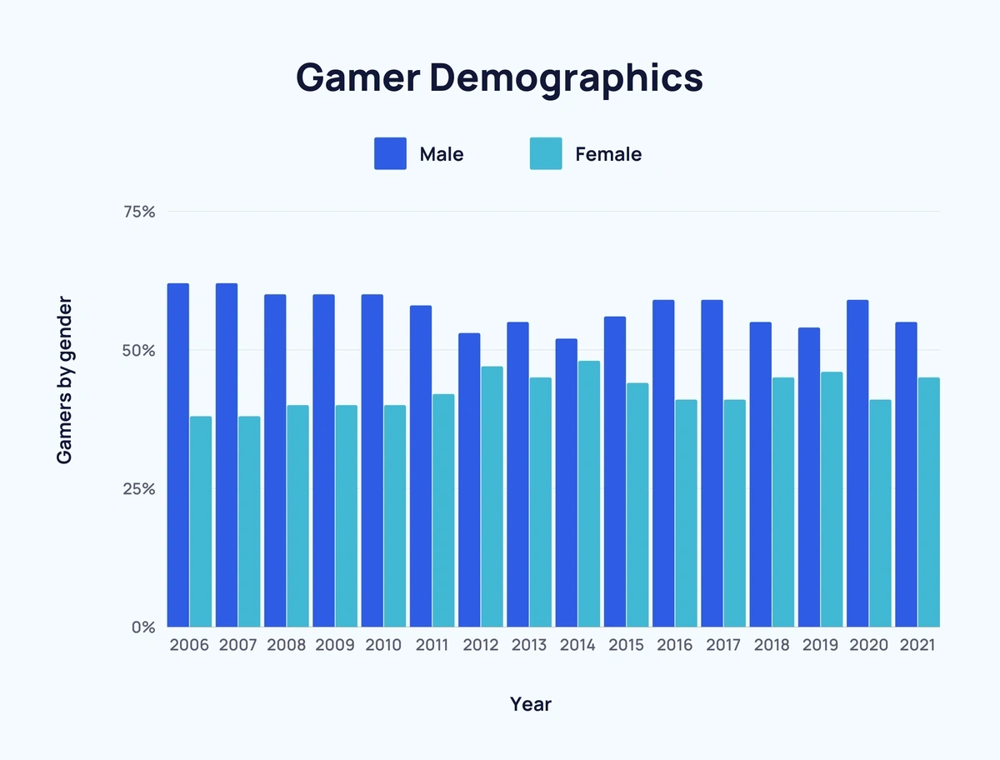


Ultimately, however, "The majority of gamers in the US are male". As we will touch on later in this analysis, the largest market that constitutes Turtle Games global sales, is North America. Although North America and the US are not the same entities, the US does make up [more than half the poulation of North America](https://www.theworldcounts.com/populations/continents/north-america), [Canadian gender rates for gaming are not dissimilar](https://www.statista.com/statistics/274906/gender-split-of-gamers-in-canada/), and [neither are rates in Mexico](https://www.statista.com/statistics/1167202/mobile-gaming-penetration-gender-mexico/#:~:text=During%20a%20survey%20carried%20out,best%20mobile%20internet%20gaming%20experience.). So we can reasonably go ahead with the assumption that unless Turtle Games' sales are indeed 3/5ths to females, the reviews data does not represent the customer base, and needs some transformation. We will start with transforming the data to represent males and females equally, and then we will attend to other categorical variables.


We will transform the data so that there is a 55/45 split between men and women respectively. This is based on global figures of of female and male populations (because the company is a global company): [Globally there are more men than women](https://statisticstimes.com/demographics/world-sex-ratio.php#:~:text=Gender%20ratio%20in%20the%20World&text=The%20population%20of%20females%20in,101.68%20males%20per%20100%20females.). This is especially true in younger age groups, and Turtle Games' younger cutomers tend to be wealthier, which is a variable that Turtle Games values (see analysis below, in which income is a factor in calculating loyalty points). Therefore we do not want to under-represent younger customers. 

However, we will check the gender distribution of the customer_id df first. 

We will also note that although Turtle Games does sell non video games, all the product numbers in these reviews are associated with video game products. We do not have any data about customers re: board games and toys. 

In [22]:
# Gender
customer_gender_count = customer_id.groupby('gender').count()
customer_gender_count

,income,education,age,score,points,product,review,summary,score_bracket,income_bracket,customer_id
gender,,,,,,,,,,,
Female,176,176,176,176,176,176,176,176,176,176,176
Male,149,149,149,149,149,149,149,149,149,149,149


It's much closer to even. But females still predominate - the gender disrtibution of both these datasets suggests that women are more likekly to submit reviews than men. This is concerning and needs to be addressed. Why? Because if men are not reviewing, and men are at least half (and likely more than half) of the customer base, their opinions are not being gathered and cannot adequately inform the marketing and other decision based on customer input: 
- adapt the reviews process: use stars (ie simplify), make it mandatory, use playing time to inform TG of customer enjoyment, offer men increased rewards for submitting reviews, and make it possible to submit reviews other than on the website. 

However because we want to have access to the reviews variable itself, we are going to transform the dataset that includes multiple reviews for many of the customer ids. 

I'm going to doble the female rows and triple the male rows, for the following figures: 

In [23]:
print("There will be", (1120 * 2), "female rows in the transformer dataset and", (880 * 3), "male rows.")

There will be 2240 female rows in the transformer dataset and 2640 male rows.


In [24]:
# Because we are normalising the data, the new dataframes will use the suffix "N"
reviews1N = reviews1
females = reviews1N[reviews1N['gender'] == 'Female']
females_df = pd.concat([females] *2, ignore_index = True)
males = reviews1N[reviews1N['gender'] == 'Male']
males_df = pd.concat([males] *3, ignore_index = True)

# Concatenate the new dfs
reviews1N = pd.concat([females_df, males_df], ignore_index = True)
reviews1N.head()

,index,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,11-20,2
1,3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,11-20,2
2,4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,11-20,5
3,5,Female,24,13.94,76,573,PhD,977,Grandson loves,Five Stars,61-100,11-20,3
4,6,Female,37,14.76,6,61,diploma,979,"I have bought many gm screens over the years, ...",Best gm screen ever,0-40,11-20,8


In [25]:
# View the descriptive statistics of the df
reviews1N.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4880 entries, 0 to 4879
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   index           4880 non-null   int64   
 1   gender          4880 non-null   object  
 2   age             4880 non-null   int64   
 3   income          4880 non-null   float64 
 4   score           4880 non-null   int64   
 5   points          4880 non-null   int64   
 6   education       4880 non-null   object  
 7   product         4880 non-null   int64   
 8   review          4880 non-null   object  
 9   summary         4880 non-null   object  
 10  score_bracket   4880 non-null   category
 11  income_bracket  4880 non-null   category
 12  customer_id     4880 non-null   int64   
dtypes: category(2), float64(1), int64(6), object(4)
memory usage: 429.5+ KB


In [26]:
# Check the gender distribution
gender_countN = reviews1N.groupby('gender').count()
gender_countN

,index,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
gender,,,,,,,,,,,,
Female,2240,2240,2240,2240,2240,2240,2240,2240,2240,2240,2240,2240
Male,2640,2640,2640,2640,2640,2640,2640,2640,2640,2640,2640,2640


In [27]:
# Calculate the percentage of males to females in the new df
b = ((2640 / 4800) * 100)

print("Males account for", b, "of the new dataframe.")

Males account for 55.00000000000001 of the new dataframe.


### Spend Score

Metadata states: "A score is assigned to the customer by Turtle Games based on the customer’s spending nature and behaviour. The value ranges between 1 and 100."

**Checking the structure of the dataset** (normality, artificiality, etc)

Because we know that the score ranges from 1-100 it is interesting that the mean is 50 and the std deviation is not far from 25 - indicating that there may be an effort at play, to put the cutomers into quartiles that see them evenly spread across the score range, in which case we may expect that even the deciles have an even count of customers. Or perhaps that distribution in this dataset is due to these reviews being selected deliberatly from an even range of all scores? Investigate this further. 

Sort by score (descending) to get a sense for the spending range associated with a top score, and any other easiy observable patterns (points, but also: age, gender, language, etc).

Querying why loyalty points are being chosen over spending score, when the goal is to increase overall sales: ie, why not just use spending score, or indeed, why not just use overall spend? 

This query will require much more exploration, and may need to be approached diplomatically. For example, one person on the team may have developed the idea of loyalty points, and may be invested in said loyalty points as a personal / ego project. Provide options, depending on team dynamic of TG. 

In [28]:
# Are there an equal number of reviews for each spend score? 

score_counts = reviews['score'].value_counts().tolist()
print(score_counts)

[76, 73, 64, 57, 51, 49, 49, 46, 45, 44, 42, 41, 40, 37, 37, 37, 36, 35, 35, 32, 31, 31, 30, 29, 28, 26, 26, 26, 24, 24, 24, 23, 22, 22, 22, 22, 21, 21, 21, 20, 20, 20, 19, 19, 18, 18, 18, 18, 18, 18, 17, 17, 16, 16, 16, 16, 16, 15, 14, 14, 14, 13, 13, 13, 13, 13, 11, 11, 11, 11, 10, 10, 10, 10, 9, 8, 8, 8, 7, 7, 7, 7, 7, 7]


In [29]:

score_counts = reviews1N['score'].value_counts().tolist()
print(score_counts)

[184, 166, 163, 155, 126, 122, 120, 117, 109, 107, 105, 96, 96, 94, 93, 90, 89, 85, 84, 80, 79, 77, 75, 75, 67, 66, 64, 60, 59, 57, 57, 55, 54, 53, 52, 52, 52, 51, 49, 49, 49, 48, 48, 47, 44, 44, 44, 44, 44, 43, 42, 42, 41, 41, 40, 38, 37, 36, 35, 35, 33, 31, 30, 30, 30, 28, 28, 27, 27, 25, 25, 23, 22, 21, 21, 21, 21, 19, 17, 17, 16, 14, 14, 14]


There are not an equal number of  rows with each score. 

However to be sure that the values aren't equally distributed we're going to introduce a column that we create later in this analysis, but which we can make use of here also. (The code is commented out because it proved fruitless - see comment that follows). 

It is not necessary to run this code again as we have learned from running it once that even when the data is aggregated to indivudal customer ids, there are not an equal number of each score. Let's look at a histogram of scores to see how the scores are spread. 

<Axes: xlabel='score', ylabel='Count'>

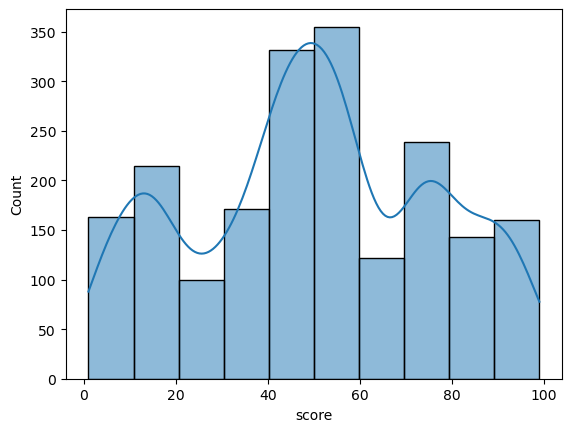

In [30]:
# Histogram of the score data - original data
sns.histplot(data = reviews, x = 'score', bins = 10, kde = True)

<Axes: xlabel='score', ylabel='Count'>

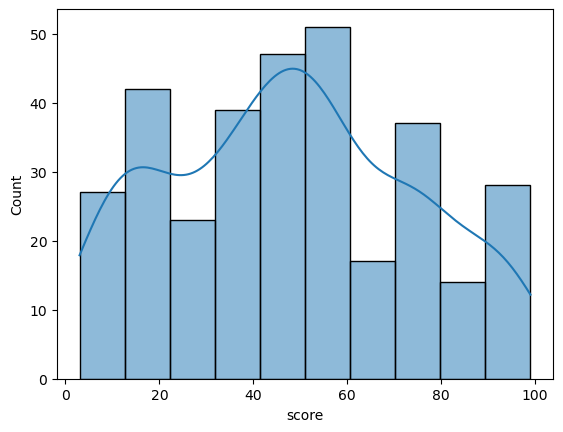

In [31]:
# Create a histplot of the customer_id scores - original (aggregated) data
# See checkpoint for df construction info 
sns.histplot(data = customer_id, x = 'score', bins = 10, kde = True)

The data is still not normally distributed. but significantly we now have a left tail, and the middle of the range, ie the 60-70 bin, is far too small for a normal distribution. 

This indicates that for individual customers represented in the reviews dataset, most have low scores, and there are lots missing who have a 60-70 score range. And yet when we look at the actual reviews we see that those with that score are offering lots of reviews, so the data appears relatively normal for that mid-range score group.

If we use the reviews df as a starting point, we can manipulate the score values to be normal, for all the products reviewed.

If we use the customer_id dataframe we would no longer have access to reviews information, or product information. But it may be more reflective of the whole population of customers in terms of demographics (ie because individual customers are not over-represented), in terms of proportion of females, of PhDs.

However this being a reviews data set, means that we can assume the product is reviewed at a later date to the actual purchase date. It is likely voluntary (although it may be that customers incease their score, for exmple, by offering reviews).

If we compare the dataset we have to a normalised one, we could potentially discover who is offering reviews, compared to who is not. We coud also analyse, of those who are reviewing, who is offering more reviews compared to fewer.


<Axes: xlabel='score', ylabel='Count'>

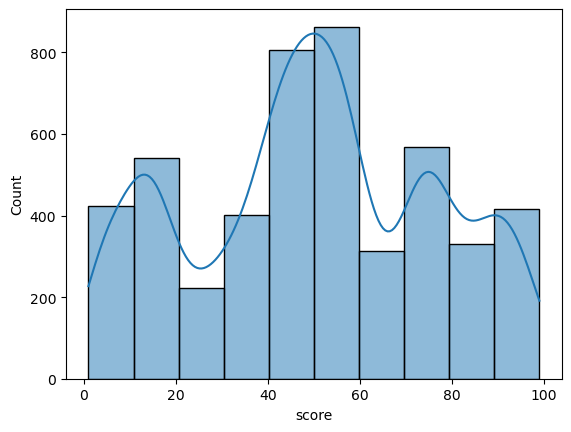

In [32]:
# Histplot to view the score distribution of the gender-normalised dataset 
sns.histplot(data = reviews1N, x = 'score', bins = 10, kde = True)

We probably can't say that this is normally distrubuted yet, for spend score. But we can say that it appears roughly symmetrical. Below is the original dataset fpor comparison
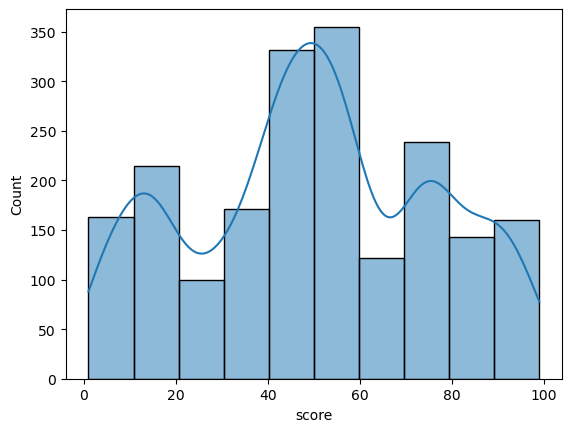

From analysis which appears later in this notebook, comparing data by score and income, we know that there is an anomaly in the calculation of customer scores, within the 40-60 score bracket. It appears from that analysis that customers within a certain narrow income bracket are 'forced' into the 40-60 score range, whereas customers in other income groups, have full access to all spend scores. So what we are looking at here with the dips on eitehr side of the middle of the data, is likely, largely, to be caused by that effect. Can we do anything about that? 

Unfortunately despite many efforts (documented throughout this analysis, including the accompanying R script and technical report), the factors which determine spend score have remained elusive. Therefore is it is difficult to ascertain the significance of spend score. This is disappointing as hard to answer the question 'how signifcant is spend score and loyalty points' without knowing what spend score is. More discussion of this topic, later. 


In [33]:
# Determine the normality of the score data with the Shapiro Wilk and Anderson-Darling tests
# The original dataset
data = reviews['score']
shapiro_test = shapiro(data)
anderson_test = anderson(data)
print("Low scores test statistic:", shapiro_test.statistic)
print("Low scores p-value:", shapiro_test.pvalue)
print("Anderson: test statistic:", anderson_test.statistic)
print("Anderson: critical values:", anderson_test.critical_values)
print("Anderson: significance levels:", anderson_test.significance_level)

Low scores test statistic: 0.9683461785316467
Low scores p-value: 1.454314864102208e-20
Anderson: test statistic: 14.095074337173855
Anderson: critical values: [0.575 0.655 0.785 0.916 1.09 ]
Anderson: significance levels: [15.  10.   5.   2.5  1. ]


Shapiro-Wilk: 
- The test statistic is close to one, and the p-value is far below 0.05. Together indicate normal distributions. 
Anderson-Darling: 
- The tests statistic is significantly higher than the critical values, providing strong evidence against the null hypothesis that this is a normal distribution. However, the Anderson-Darling test is __[highly senstive to tails](https://www.gigacalculator.com/calculators/normality-test-calculator.php)__, and this dataset has unusual tails. 

We'll investigate the normal distribution of this data further, in R, later. For now we will look at the larger, gender-normalised dataset, using the same test to look at score.  

In [34]:
# Determine the normality of the score data with the Shapiro Wilk and Anderson-Darling tests
# The original dataset
dataN = reviews1N['score']
shapiro_test1 = shapiro(dataN)
anderson_test1 = anderson(dataN)
print("Low scores test statistic:", shapiro_test1.statistic)
print("Low scores p-value:", shapiro_test1.pvalue)
print("Anderson: test statistic:", anderson_test1.statistic)
print("Anderson: critical values:", anderson_test1.critical_values)
print("Anderson: significance levels:", anderson_test1.significance_level)

Low scores test statistic: 0.9667268395423889
Low scores p-value: 3.7141906923835687e-32
Anderson: test statistic: 36.656227756315275
Anderson: critical values: [0.576 0.655 0.786 0.917 1.091]
Anderson: significance levels: [15.  10.   5.   2.5  1. ]


Unfortunately we cannot say that this data is normally distribute for score. However, we do know (from metadata) that score is a somewhat artifical component of the dataset. We also suspect (from analysis below) that the calyculation of score is problematic. 

Therefore, be we transform the dataset further to accommodate this problematic variable, we will look briefly at th distribution of income and loyalty points for gender, before continuing on to other categorical variables in the data.

Just one final note on gender and scores before we continue: the transformation we have conducted on the dataset has had the effect of raising the mean female score slightly, and in relation to female score (see the two barplots below - note that the hues are inconsistent between the barplots, so please pay attention to the x-ticks). This was not intentional, but is important to note because it signifies that overall men are earning a higher score than women, assuming this dataset represents the wider customer population. There may yet be more transformations to conduct before we can be sure of this, however!

<Axes: xlabel='gender', ylabel='score'>

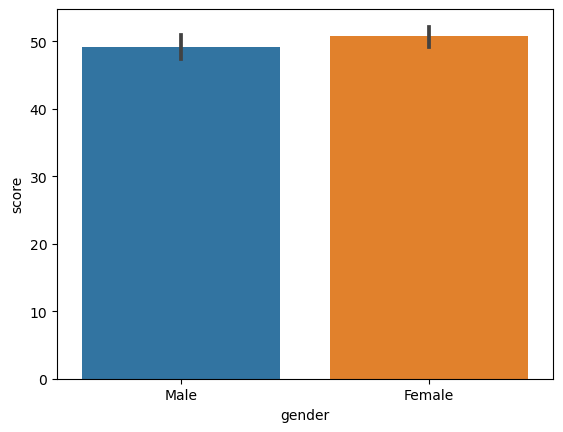

In [35]:
# Check gender distribution of scores. 
sns.barplot(data = reviews, x = 'gender', y = 'score')

<Axes: xlabel='gender', ylabel='score'>

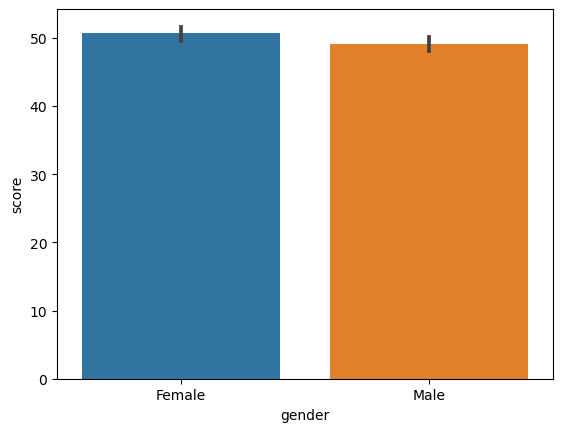

In [36]:
# Check gender distribution of scores. 
sns.barplot(data = reviews1N, x = 'gender', y = 'score')

<Axes: xlabel='gender', ylabel='points'>

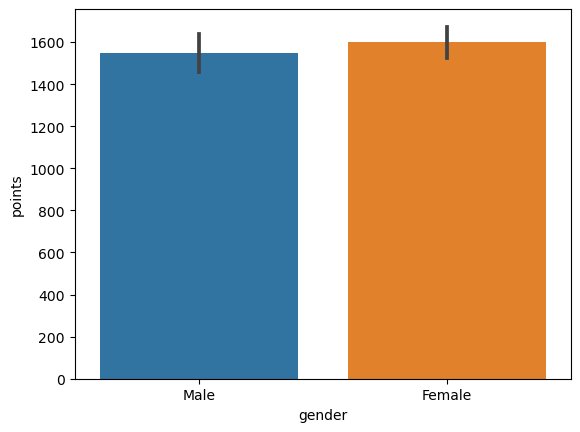

In [37]:
# Gender and points
# Check gender distribution of scores. 
sns.barplot(data = reviews, x = 'gender', y = 'points')

<Axes: xlabel='gender', ylabel='points'>

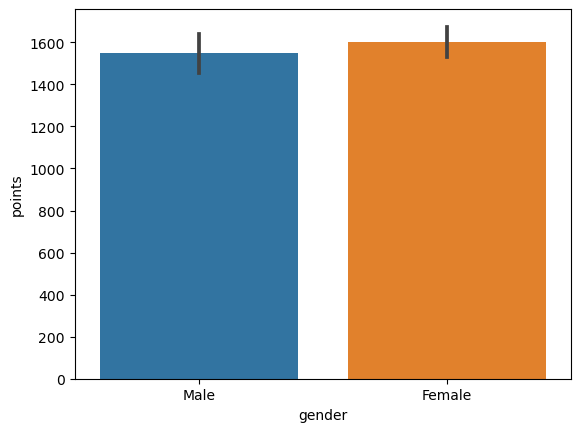

In [38]:
# Gender and points
# Check gender distribution of scores. 
sns.barplot(data = reviews, x = 'gender', y = 'points')

### Income

<Axes: xlabel='gender', ylabel='income'>

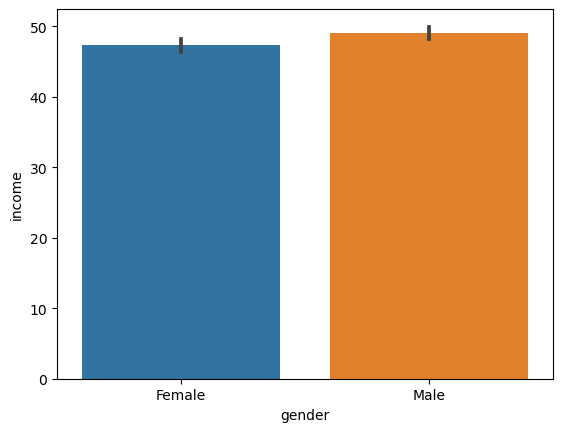

In [39]:
# Gender and income
# Gender and points
# Check gender distribution of scores. 
sns.barplot(data = reviews1N, x = 'gender', y = 'income')

Points don't appear to change much between the two datasets, which suggests a stickiness of higher points for women, and/or that the points were already gender-distributed normally in the original dataset. 

A slightly different dynamic however is seen with gender and income. Increasing the number of male rows in the dataset increases the mean income of males, reflecting a widely-known population dynamic of [males earning more than women](https://news.un.org/en/story/2022/09/1126901#:~:text=On%20average%2C%20women%20globally%20are%20paid%20about%2020,Organization%20said%20on%20Sunday%2C%20International%20Equal%20Pay%20Day.). Regardless of how we feel about this dynamic at a societal level, it is reassuring from a statistical point of view to see this population dynamic reflected in the dataset because it gives us confidence that the dataset reflects the population.  

Let's dig into this a bit further by grouping customers by income bracket

<Axes: xlabel='gender', ylabel='income'>

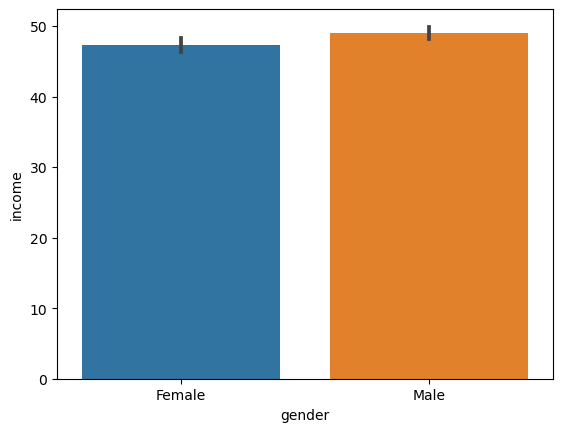

In [40]:
# Gender and income
# Gender and points
# Check gender distribution of scores. 
sns.barplot(data = reviews1N, x = 'gender', y = 'income')

<Axes: xlabel='income_bracket', ylabel='income'>

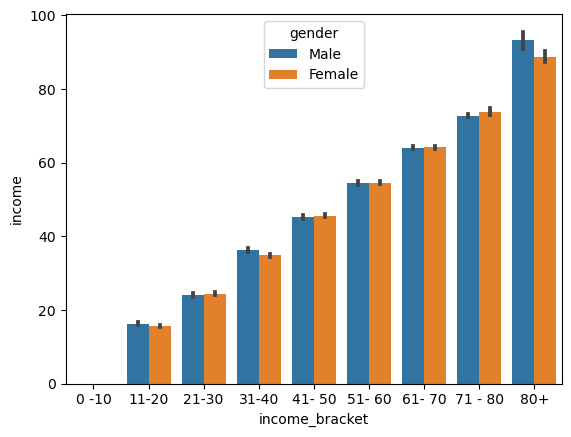

In [41]:
# Check gender distribution of scores using income brackets - original data
sns.barplot(data = reviews, y = 'income', x = 'income_bracket', hue = 'gender')

In [42]:
reviews1N.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4880 entries, 0 to 4879
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   index           4880 non-null   int64   
 1   gender          4880 non-null   object  
 2   age             4880 non-null   int64   
 3   income          4880 non-null   float64 
 4   score           4880 non-null   int64   
 5   points          4880 non-null   int64   
 6   education       4880 non-null   object  
 7   product         4880 non-null   int64   
 8   review          4880 non-null   object  
 9   summary         4880 non-null   object  
 10  score_bracket   4880 non-null   category
 11  income_bracket  4880 non-null   category
 12  customer_id     4880 non-null   int64   
dtypes: category(2), float64(1), int64(6), object(4)
memory usage: 429.5+ KB


<Axes: xlabel='income_bracket', ylabel='income'>

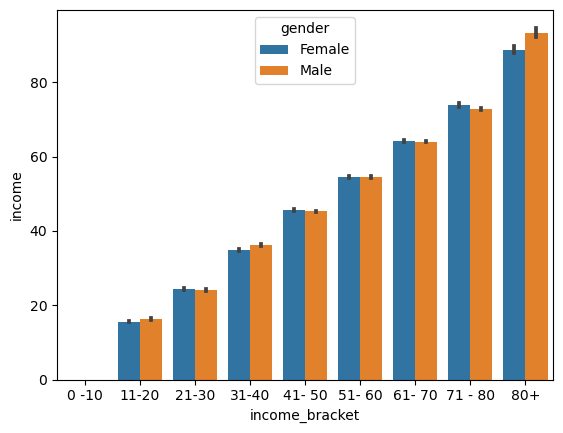

In [43]:
# Check gender distribution of scores using income brackets - gender normalised dta
sns.barplot(data = reviews1N, y = 'income', x = 'income_bracket', hue = 'gender')

Men generally earn more than women across all income brakcets. This is is good (from the point of view of the reliability of the data).

<Axes: xlabel='income', ylabel='Count'>

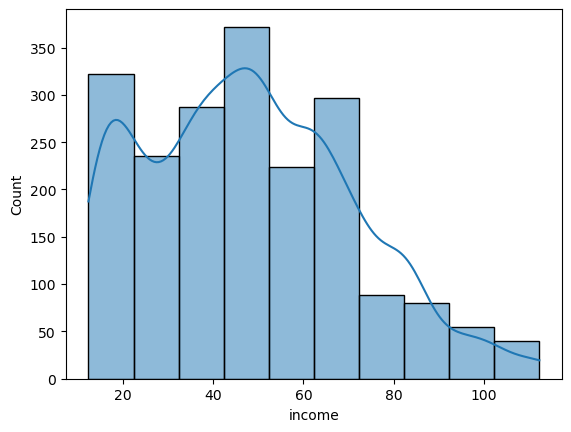

In [44]:
# Histogram of the income data - original dataset

sns.histplot(data = reviews, x = 'income', bins = 10, kde = True)

<Axes: xlabel='income', ylabel='Count'>

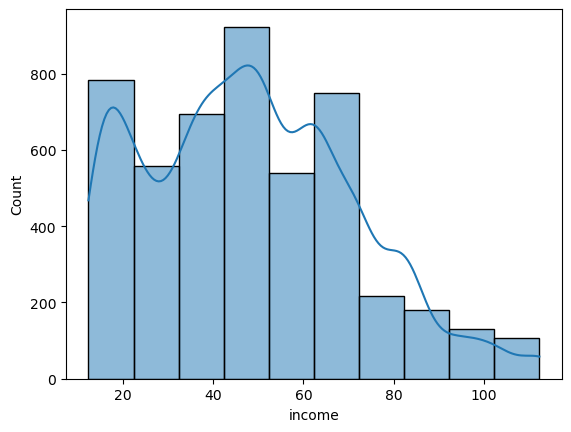

In [45]:
# Histogram of the income data - gender normalised dataset

sns.histplot(data = reviews1N, x = 'income', bins = 10, kde = True)

<Axes: xlabel='income', ylabel='Count'>

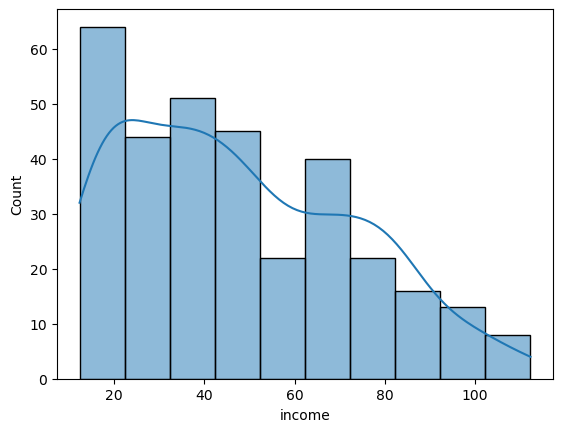

In [46]:
# Create a histplot of the customer_id aggregation of incomes, for comparison 
sns.histplot(data = customer_id, x = 'income', bins = 10, kde = True)

The nature of the dataset, collected in a commercial exchange, explains why we are seeeing this shape of distribution, and also gives us reasonable confidence that it may be representative of future customer datasets. That is, customers need money to engage with (purchase through) this platform. __[Many countries have minimum wages](https://www.minimum-wage.org/international#:~:text=Minimum-Wage.org%20tracks%20minimum%20wage%20rates,in%20195%20countries%20around%20the%20world.)__ and this is reflected in the absence of figures below 12k. 


Reflections: 

- At this stage, we have three datasets to play with: the original, one wrangels for normalised gender, and one that is the individual customers in the reviews dataset. 
- We can use and further transform these datasets for different purposes 
- at this stage we are completing gender and moving on to the other categorical variables

In [47]:
# Education - by original dataset
education_count = reviews['education'].value_counts()
education_count

graduate        900
PhD             460
postgraduate    400
diploma         190
Basic            50
Name: education, dtype: int64

In [48]:
# Education - by customer_ids
customer_education_count = customer_id['education'].value_counts()
customer_education_count

graduate        109
PhD              78
postgraduate     73
diploma          51
Basic            14
Name: education, dtype: int64

In [49]:
# Education - by gender normalised dataset
education_countN = reviews1N['education'].value_counts()
education_countN

graduate        2170
PhD             1160
postgraduate     960
diploma          460
Basic            130
Name: education, dtype: int64

Across the datasets, the customers who are submitting reviews are generally well educated. At first gance this does appear to reflect what we'd expect to see in the genberal population. 

We could be seeing the effects of:
- more educated people being more likey to submit reviews (the literacy factor)
- TG's customers may be more educated than the average population
- these exclusively being reviews of video games and not reflecting 
- these being english speaking customers only


Normalising this aspect of the dataste is more complicated. For example, consider (the following graphic from the US Bureau of Labour Statistics)[https://www.bls.gov/emp/chart-unemployment-earnings-education.htm], which shows that higher qualified people are more likey to be employed. This is significant here because of the proprotional importance of N.A. sales, for Turtle Game overall, and also because we can reasonably assume that employed customers have income  (income is indeed a consideration in the accumulation of loyalty points, as we will show below, which indiactes that TG considers it to be important).
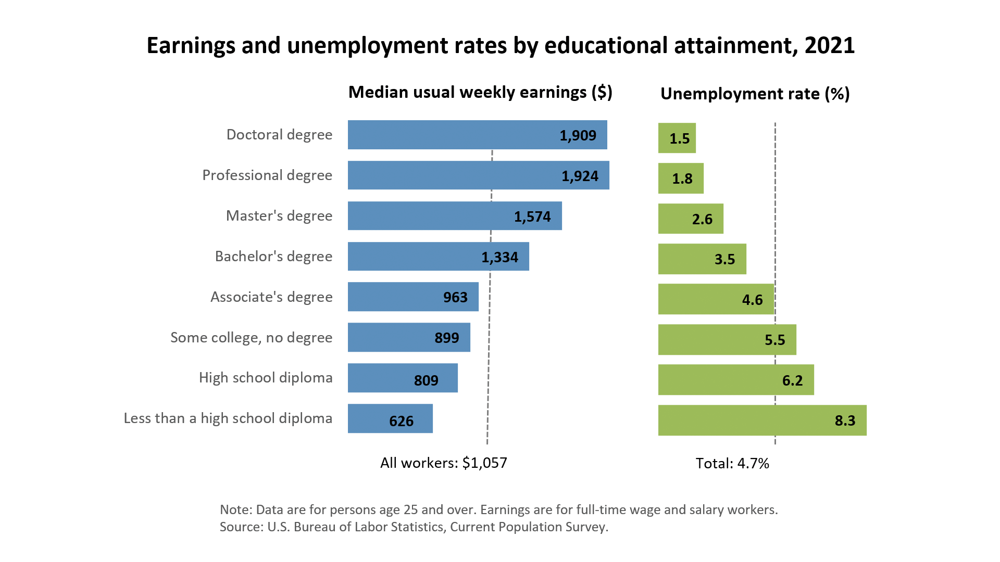

The approach we can take, is to leave the dataframes we have made, and add two more to the mix. These will be based on the gender-normalised dataframe: 
- a df with even numbers for each education level
- a df with a number of rows for each education level, that reflect the general population, based on the US (because NA is a significant proportion of the global sales, and becuase the data is past data. That is, though we may want to expland into more markets, this reviews data does not reflect that intention but what has already happened. The percentages for this transformation come from the [US Census Bureau](https://data.census.gov/profile?q=United+States&g=010XX00US#education) and teh [World Population Review](https://worldpopulationreview.com/country-rankings/phd-percentage-by-country)

In [50]:
reviews1N['education'].value_counts()

graduate        2170
PhD             1160
postgraduate     960
diploma          460
Basic            130
Name: education, dtype: int64

In [51]:
# Create a DF with even numbers for each education level.
# remember to check the gender (and other) distributions afterwards. 

reviews1N_equalEd = reviews1N
g  = reviews1N_equalEd[reviews1N_equalEd['education']== 'graduate']
PhD  = reviews1N_equalEd[reviews1N_equalEd['education']== 'PhD']
pg  = reviews1N_equalEd[reviews1N_equalEd['education']== 'postgraduate']
d  = reviews1N_equalEd[reviews1N_equalEd['education']== 'diploma']
B  = reviews1N_equalEd[reviews1N_equalEd['education']== 'Basic']



In [52]:
# duplicate rows as necessary, to about 2000 each
g = g
PhD = pd.concat([PhD] *2, ignore_index = True)
pg = pd.concat([pg] *2, ignore_index = True)
d = pd.concat([d] *4, ignore_index = True)
B = pd.concat([B] *16, ignore_index = True)
# could not multiply the dfs by floats, only integers, which will affect accuracy

According to the sources listed above, the following figures represent more closely the percentages in the population:

Basic: 22.4
High School Diploma: 45.6
Graduate: 21
postgraduate: 9
PhD: 2

We won't be able to reach these figures exacltly but we can get closer to them. 

In [53]:
# output the current fraction each variable represents of the whole 
reviews1N['education'].value_counts(normalize = True)

graduate        0.444672
PhD             0.237705
postgraduate    0.196721
diploma         0.094262
Basic           0.026639
Name: education, dtype: float64

In [54]:
# Duplicate rows for a proprtional df
# Copy the variables
gg = g
PPhD = PhD
ppg = pg
dd = d
BB = B

# Duplicate rows to be double the percentage figures (as the existing ones are approximatly double what they should be)
gg = gg
PPhD = pd.concat([PPhD] * 2, ignore_index = True)
ppg = ppg
dd = pd.concat([dd] *10, ignore_index = True)
BB = pd.concat([dd] *20, ignore_index = True)

In [55]:
# Concat the education dfs - roughly population-normalised figures
reviewsNE=pd.concat([gg, PPhD, ppg, dd, BB], ignore_index = True)
reviewsNE.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 395130 entries, 0 to 395129
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   index           395130 non-null  int64   
 1   gender          395130 non-null  object  
 2   age             395130 non-null  int64   
 3   income          395130 non-null  float64 
 4   score           395130 non-null  int64   
 5   points          395130 non-null  int64   
 6   education       395130 non-null  object  
 7   product         395130 non-null  int64   
 8   review          395130 non-null  object  
 9   summary         395130 non-null  object  
 10  score_bracket   395130 non-null  category
 11  income_bracket  395130 non-null  category
 12  customer_id     395130 non-null  int64   
dtypes: category(2), float64(1), int64(6), object(4)
memory usage: 33.9+ MB


This is a very large dataset, which is not ideal, but if it helps TG understand their customers better, then it's what we need to do.  

In [56]:
# Check dfs before concat
#g.info()
#PhD.info()
#pg.info()
#d.info()
#B.info()

These figures are far from perfect, but the issue of not being able to multiply by a float restricts our accuracy here. 

Concatenate the normilsed education data to make a df that is normalised for gender and has roughly equal numbers of rows, for each education value. 

In [57]:
# Concat the education dfs - roughly equal numbers
reviewsNEq=pd.concat([g, PhD, pg, d, B], ignore_index = True)
reviewsNEq.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10330 entries, 0 to 10329
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   index           10330 non-null  int64   
 1   gender          10330 non-null  object  
 2   age             10330 non-null  int64   
 3   income          10330 non-null  float64 
 4   score           10330 non-null  int64   
 5   points          10330 non-null  int64   
 6   education       10330 non-null  object  
 7   product         10330 non-null  int64   
 8   review          10330 non-null  object  
 9   summary         10330 non-null  object  
 10  score_bracket   10330 non-null  category
 11  income_bracket  10330 non-null  category
 12  customer_id     10330 non-null  int64   
dtypes: category(2), float64(1), int64(6), object(4)
memory usage: 908.5+ KB


In [58]:
reviews.describe()

,age,income,score,points,product,customer_id
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000


In [59]:
# Descriptive stats
reviewsNEq.describe()

,index,age,income,score,points,product,customer_id
count,10330.000000,10330.000000,10330.000000,10330.000000,10330.000000,10330.000000,10330.000000
mean,1005.949661,41.407551,50.177411,48.929042,1652.422362,4565.339400,185.588190
std,577.361700,13.223410,23.015200,26.844866,1326.202986,3182.636823,93.391288
min,0.000000,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,509.000000,32.000000,32.800000,27.000000,827.000000,1940.000000,103.000000
50%,999.500000,38.000000,49.200000,48.000000,1328.000000,3887.000000,204.000000
75%,1509.000000,49.000000,64.780000,73.000000,1757.000000,6721.000000,273.000000
max,1999.000000,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000


We haven't massively changed the means: age income and points are all slightly higher. 

In [60]:
reviewsNE.describe()

,index,age,income,score,points,product,customer_id
count,395130.000000,395130.000000,395130.000000,395130.000000,395130.000000,395130.000000,395130.000000
mean,988.761117,48.111609,43.648220,41.655883,1346.024825,4150.342545,165.428041
std,577.513408,12.309736,22.489871,22.850086,1143.459749,3158.308987,92.143079
min,0.000000,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,485.000000,37.000000,27.060000,18.000000,498.000000,1463.000000,78.000000
50%,999.500000,46.000000,40.180000,46.000000,1233.000000,3629.000000,188.000000
75%,1485.000000,56.000000,59.860000,58.000000,1601.000000,6504.000000,250.000000
max,1999.000000,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000


As we may have expected, by increasing the lower education customers' rows, we haven't changed the mean age but we'd lowered the mean income, and also score and points. We can only conclude that score does depnd on eduction and we should share that with TG in answer to their question about the significance of score. 

<Axes: xlabel='score', ylabel='Count'>

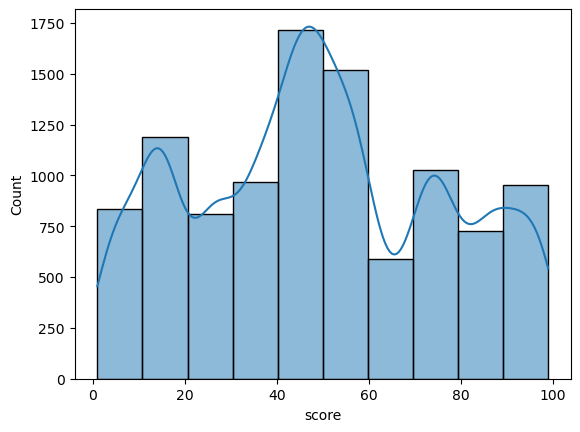

In [61]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNEq, x = 'score', bins = 10, kde = True)

<Axes: xlabel='score', ylabel='Count'>

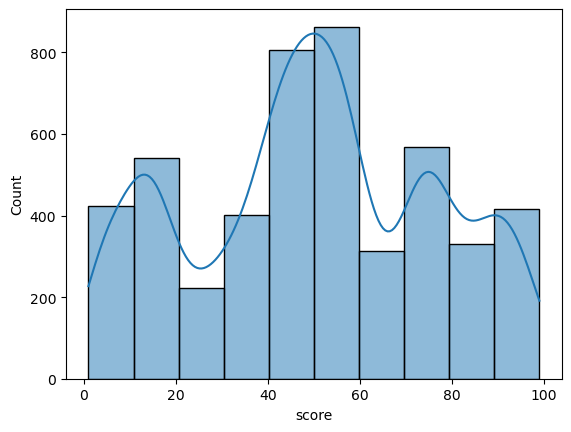

In [62]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviews1N, x = 'score', bins = 10, kde = True)

<Axes: xlabel='score', ylabel='Count'>

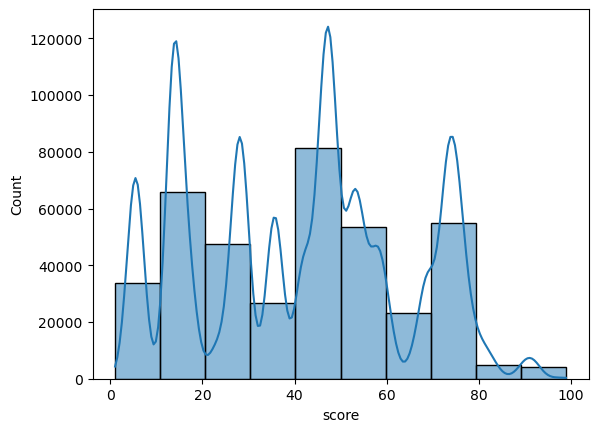

In [63]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNE, x = 'score', bins = 10, kde = True)

We have definitely affected the score distribution. In fact the tails are more normally distrubuted now. 
If we manipulate the data further it may be difficult to maintain the normalisation that we have acheived so far, so we will likely leave it here. 

<Axes: xlabel='income', ylabel='Count'>

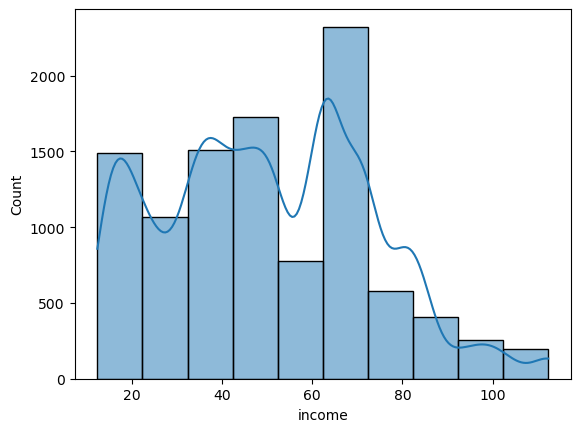

In [64]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNEq, x = 'income', bins = 10, kde = True)

<Axes: xlabel='income', ylabel='Count'>

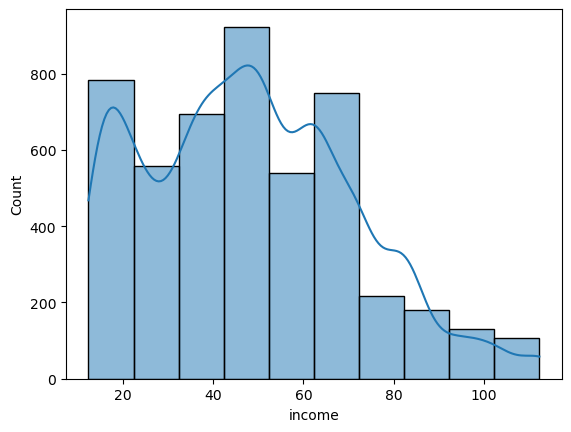

In [65]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviews1N, x = 'income', bins = 10, kde = True)

<Axes: xlabel='income', ylabel='Count'>

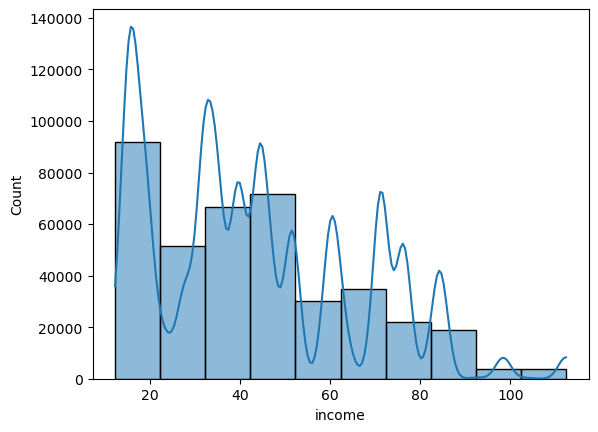

In [66]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNE, x = 'income', bins = 10, kde = True)

<Axes: xlabel='points', ylabel='Count'>

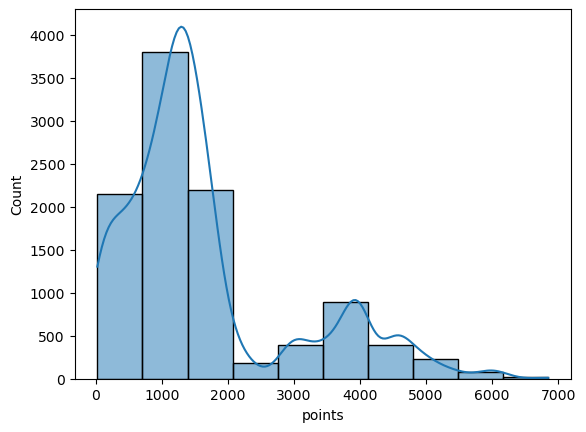

In [67]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNEq, x = 'points', bins = 10, kde = True)

<Axes: xlabel='points', ylabel='Count'>

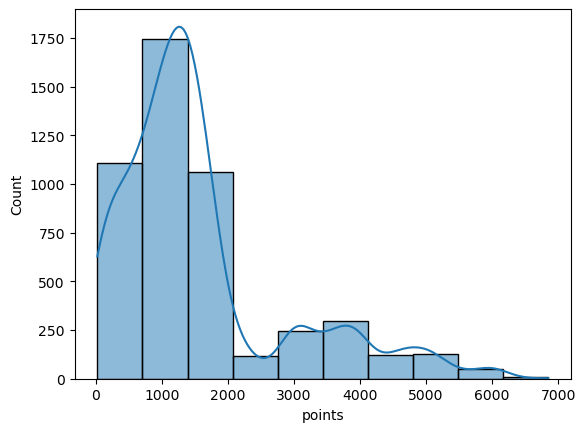

In [68]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviews1N, x = 'points', bins = 10, kde = True)

This manipulation has exacerbated the isue of score distribution. Our last step for normalisation will be to allocate more rows for those scores that are not represented normally, in the distribution. Before we do this we will check the gender counts of the new df. 

<Axes: xlabel='points', ylabel='Count'>

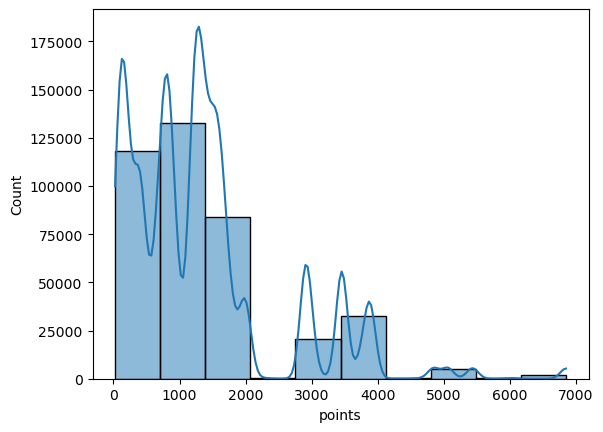

In [69]:
# Check distributions again as above. 
# Histogram of the score data 
sns.histplot(data = reviewsNE, x = 'points', bins = 10, kde = True)

It's important to remember that income and education aren't perfectly correlated in any population. But points depend on both income and score, so by redistributing data into the lower eduction variables we have drastically affected points distribution. The anomalies in terms of the gaps in the data are interesting as the suggest bottle necks in achieving higher points. 

In [70]:
# Check gender numbers of new df
reviewsNEq['gender'].value_counts()

Male      5910
Female    4420
Name: gender, dtype: int64

Men are now 57% of the dataset. This is not significantly different from our desired value of 55%.
However it is intersting that raising the numbers of lower education customers has increased the number of males in the dataset.

In [71]:
reviewsNEq.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10330 entries, 0 to 10329
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   index           10330 non-null  int64   
 1   gender          10330 non-null  object  
 2   age             10330 non-null  int64   
 3   income          10330 non-null  float64 
 4   score           10330 non-null  int64   
 5   points          10330 non-null  int64   
 6   education       10330 non-null  object  
 7   product         10330 non-null  int64   
 8   review          10330 non-null  object  
 9   summary         10330 non-null  object  
 10  score_bracket   10330 non-null  category
 11  income_bracket  10330 non-null  category
 12  customer_id     10330 non-null  int64   
dtypes: category(2), float64(1), int64(6), object(4)
memory usage: 908.5+ KB


A final consideratin is that tt's possible that TG doesn't want the scores to be normally distributed. ie, they may want equal numbers of customers spread out across the range. When we look at how many custmomers are in each score brakcet (see below) we know that there are roughtly spread out (if we have successfuly normalised for gender and education)

## Concatenate the dfs 

Concatenating the dfs would make more information available, for example relationships between the ranking of a product and the positivity of its review data. Doing at this stage in the analysis means we can access those insights during the rest of the analysis. That is, the reviews data tells us how people feel about particular products, but not what those products are. 

In [72]:
# check for duplicates
t_sales_duplicates = t_sales.duplicated()
print(t_sales_duplicates)

0      False
1      False
2      False
3      False
4      False
       ...  
347    False
348    False
349    False
350    False
351    False
Length: 352, dtype: bool


In [73]:
if t_sales_duplicates.any():
    print("Duplicates exist in this df.")
else:
    print("No duplicates here.")

No duplicates here.


In [74]:
reviews_duplicates = reviews.duplicated()
print(reviews_duplicates)

0       False
1       False
2       False
3       False
4       False
        ...  
1995    False
1996    False
1997    False
1998    False
1999    False
Length: 2000, dtype: bool


In [75]:
if reviews_duplicates.any():
    print("Duplicates exist in this df.")
else:
    print("No duplicates here.")

No duplicates here.


In [76]:
# Determine how many unique products are in the reviews data set. 
print(reviews['product'].nunique())

200


In [77]:
# Determine how many unique products are in the sales data set (ie comfirm that it is 352). 
print(t_sales['product'].nunique())

175


In [78]:
# How many duplicates are there in the t_sales df (product column)?
print(t_sales['product'].duplicated().sum())

177


This is a significant discovery because it may mean that though there may be 352 products, they do not all have unique product ids. We know there are no duplicate rows, but we don't know which rows have the same product values, nor whether the discrepancies are significant (e.g. indicating erronious product ids, or the same product entered twice).

It is interesting that 175 and 177 are such close numbers (almost indicating half the dataset).

Print out the duplicated values. 

In [79]:
# Print out the duplicated values. 
duplicated_rows = t_sales[t_sales.duplicated('product')]
duplicated_rows.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales
23,24,515,X360,2013.0,Action,Take-Two Interactive,7.90,4.35,13.43
35,36,979,X360,2012.0,Shooter,Activision,6.77,3.53,11.26
37,38,876,PS3,2011.0,Shooter,Activision,4.54,4.77,11.04
40,41,948,PS3,2010.0,Shooter,Activision,4.90,3.64,10.44
44,45,515,PS4,2014.0,Action,Take-Two Interactive,3.12,4.76,9.82


In [80]:
sorted_df = t_sales.sort_values(by = ['product', 'Ranking'])
sorted_df.head(20)

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00
200,201,123,GB,1999.0,Platform,Nintendo,2.79,1.07,4.16
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72
5,6,254,GB,1989.0,Puzzle,Nintendo,19.02,1.85,24.81
155,156,254,NES,1988.0,Puzzle,Nintendo,2.44,0.57,4.58
6,7,263,DS,2006.0,Platform,Nintendo,9.33,7.57,24.61
7,8,283,Wii,2006.0,Misc,Nintendo,11.50,7.54,23.80


Clearly there are distinct objects (ie games) which nevertheless share the same product name. This may be a case of cross platform games (such as we see here: https://www.digitaltrends.com/gaming/all-cross-platform-games/).

We can add a last digit to each, which is the number of the object in a series. 

However will this interfere with any correlations yet to be discovered? 

Sort this df by 1: product id and 2: ranking (we've established below that there is a correlation between these). Then allocate each product a new product2 value. 

Note: the duplicates are NOT the same game in diffrent years (as different platforms, and same years, for some). 

There is a NaN value here (may be more)

In [81]:
# Group the df by 'product' and create a 'count' column. 
t_sales_grouped = t_sales
t_sales_grouped['count'] = t_sales_grouped.groupby('product')['product'].transform('size')
t_sales_grouped.head(20)

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1
5,6,254,GB,1989.0,Puzzle,Nintendo,19.02,1.85,24.81,2
6,7,263,DS,2006.0,Platform,Nintendo,9.33,7.57,24.61,1
7,8,283,Wii,2006.0,Misc,Nintendo,11.50,7.54,23.80,1
8,9,291,Wii,2009.0,Platform,Nintendo,11.96,5.79,23.47,1
9,10,326,NES,1984.0,Shooter,Nintendo,22.08,0.52,23.21,1


In [82]:
# Determine the product2 values
t_sales_grouped['product2']= t_sales_grouped['product'].astype(str) + (t_sales_grouped.groupby\
                                                                       ('product').cumcount()).astype(str)
t_sales_grouped.head(20)

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490
5,6,254,GB,1989.0,Puzzle,Nintendo,19.02,1.85,24.81,2,2540
6,7,263,DS,2006.0,Platform,Nintendo,9.33,7.57,24.61,1,2630
7,8,283,Wii,2006.0,Misc,Nintendo,11.50,7.54,23.80,1,2830
8,9,291,Wii,2009.0,Platform,Nintendo,11.96,5.79,23.47,1,2910
9,10,326,NES,1984.0,Shooter,Nintendo,22.08,0.52,23.21,1,3260


In [83]:
# Ensure product2 values are integers (so correlations are possible)
t_sales_grouped['product2'] = t_sales_grouped['product2'].astype(int) 

In [84]:
# Check the df has not collapsed the products
print(t_sales_grouped['product'].nunique())

175


In [85]:
# Check the unique number of values in the product2 columm
print(t_sales_grouped['product2'].nunique())

352


That is what we wanted to see before we could continue. Perform corr()

In [86]:
t_sales_grouped.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\138966440.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  t_sales_grouped.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2
Ranking,1.000000,0.080607,0.100726,-0.343823,-0.357466,-0.391028,0.301073,0.080647
product,0.080607,1.000000,-0.015476,-0.404786,-0.389425,-0.440905,0.028304,1.000000
Year,0.100726,-0.015476,1.000000,-0.325654,-0.007736,-0.243983,0.497386,-0.015451
NA_Sales,-0.343823,-0.404786,-0.325654,1.000000,0.705524,0.934946,-0.373564,-0.404814
EU_Sales,-0.357466,-0.389425,-0.007736,0.705524,1.000000,0.877558,-0.234370,-0.389451
Global_Sales,-0.391028,-0.440905,-0.243983,0.934946,0.877558,1.000000,-0.391164,-0.440936
count,0.301073,0.028304,0.497386,-0.373564,-0.234370,-0.391164,1.000000,0.028351
product2,0.080647,1.000000,-0.015451,-0.404814,-0.389451,-0.440936,0.028351,1.000000


This is good - the correlation values are the same between product and product2, so we can be reasonably sure that any significance of the product column 
is not obscured by the renamining, while we have gained more usefulness in this data by allocating each product its own number. 

A considerable issue is that we don't now know how reliable the reviews data is: If there are several products allocated the same product number, how can we know how which of these products is referred to in the review? Unfortunately, it seems unlikely that we wil be able to do this at all, or to a degree that will be usefull to the customer EXCEPT where the product2 value is unique - then the product number in the review data can likely be relied upon. 

Unfortunatly what we have learned about the prodict id means we will not be able to justify going ahead with complete concatenation. The product data in the sales df (and likely the reviews df) is too unrelieable to serve as a joining column.

## Continue the EDA 

In [87]:
# rename the df to make calling it easier
sales = t_sales_grouped

In [88]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 352 entries, 0 to 351
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Ranking       352 non-null    int64  
 1   product       352 non-null    int64  
 2   Platform      352 non-null    object 
 3   Year          350 non-null    float64
 4   Genre         352 non-null    object 
 5   Publisher     352 non-null    object 
 6   NA_Sales      352 non-null    float64
 7   EU_Sales      352 non-null    float64
 8   Global_Sales  352 non-null    float64
 9   count         352 non-null    int64  
 10  product2      352 non-null    int32  
dtypes: float64(4), int32(1), int64(3), object(3)
memory usage: 29.0+ KB


In [89]:
print(sales.columns)

Index(['Ranking', 'product', 'Platform', 'Year', 'Genre', 'Publisher',
       'NA_Sales', 'EU_Sales', 'Global_Sales', 'count', 'product2'],
      dtype='object')


Continue EDA of this data set by graphing the descriptive values (genre, Platform, Year, etc., )in order, alongside the product number etc, looknig for patterns and anomalies.

Text(0, 0.5, 'product')

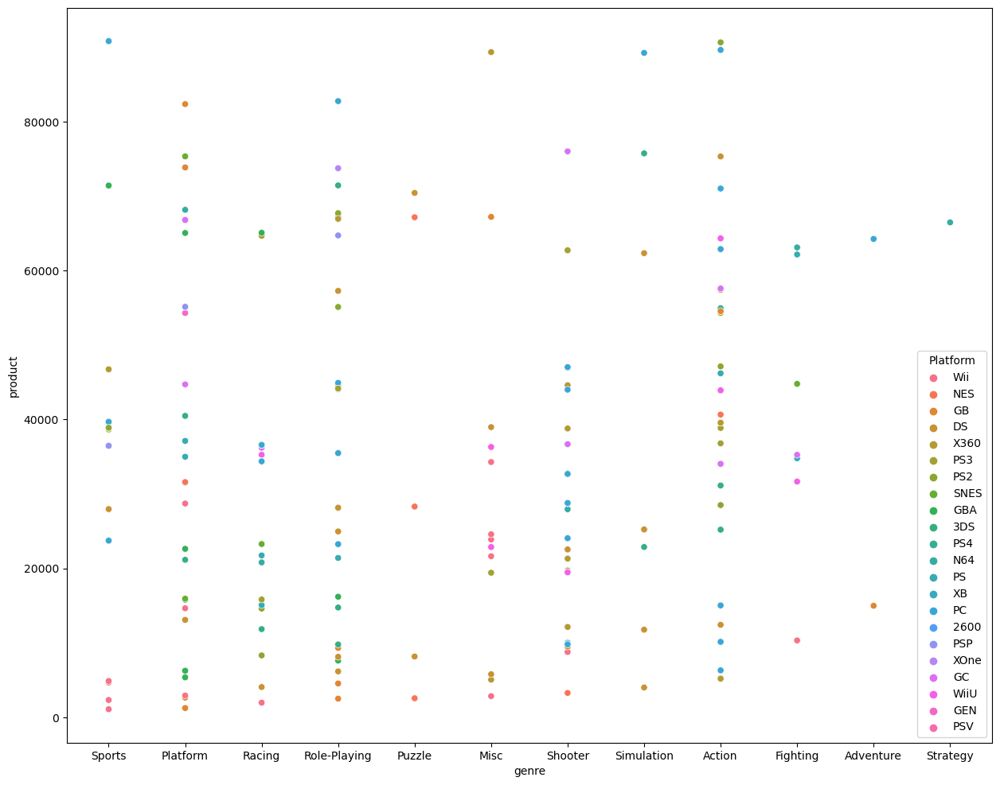

In [90]:
# Genre, product2 and platform
plt.figure(figsize = (15, 12))
sns.scatterplot(data = sales, x = 'Genre', y = 'product2', hue = 'Platform')
plt.xlabel('genre')
plt.ylabel('product')

There is no discernable pattern between product and genre, there are many publishers (making the hue unuseful), there are more products in some genres than others.

Text(0, 0.5, 'product')

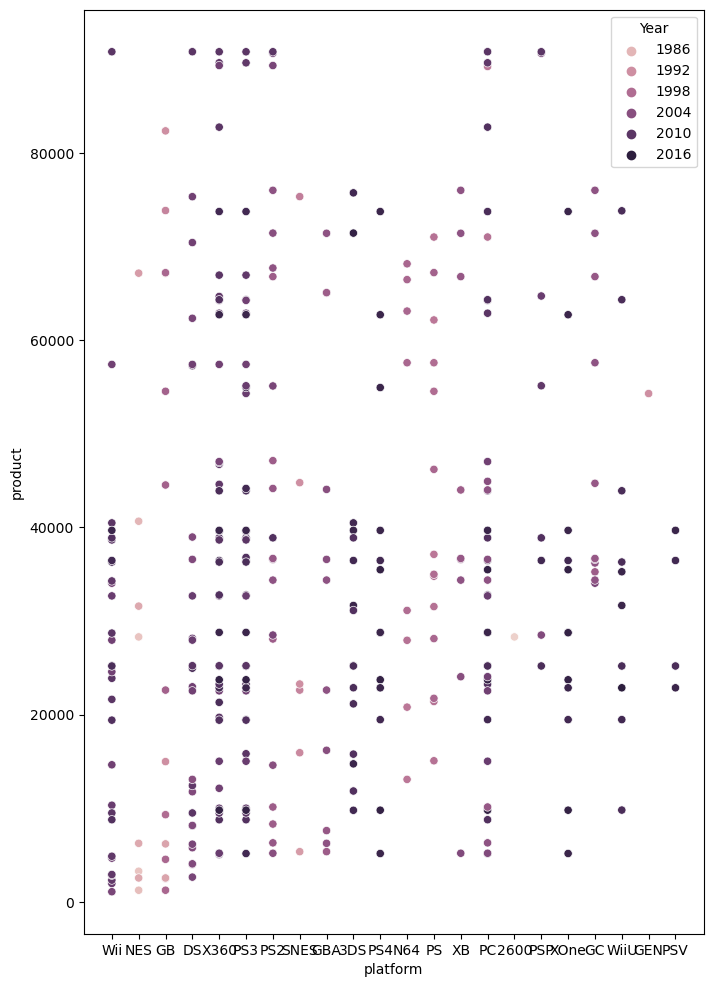

In [91]:
# Platform, product, year
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = sales, x = 'Platform', y = 'product2', hue = 'Year')
plt.xlabel('platform')
plt.ylabel('product')

Product numbers don't align with years, and differnt genres published over all years.

Text(0, 0.5, 'product')

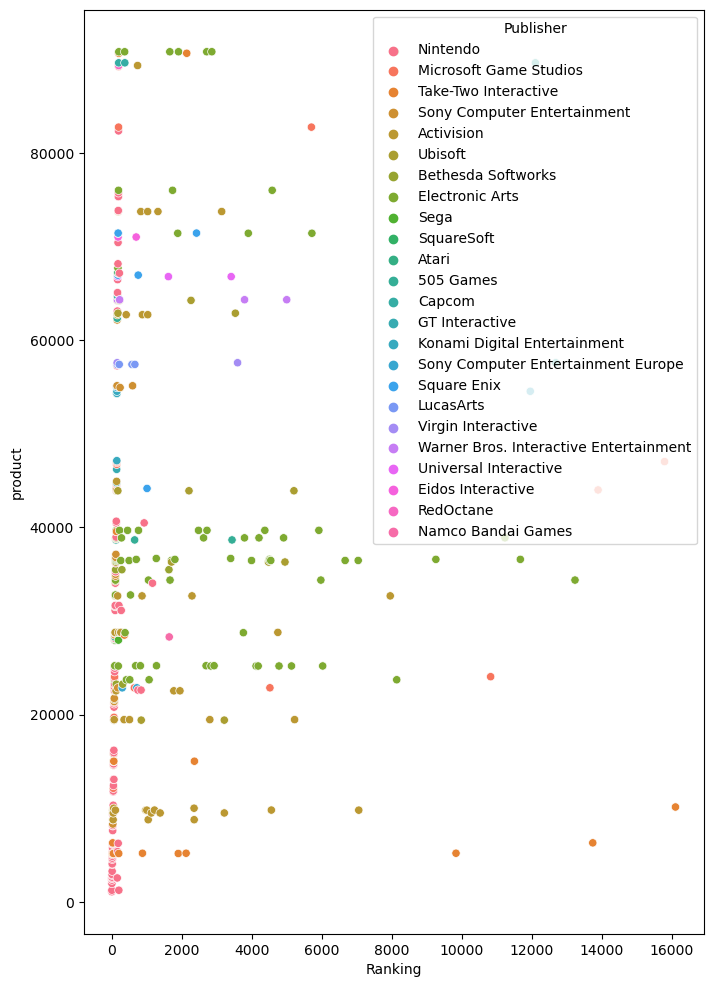

In [92]:
# ranking, product, pubilsher
plt.figure(figsize = (8, 12))
sns.scatterplot(data = sales, x = 'Ranking', y = 'product2', hue = 'Publisher')
plt.xlabel('Ranking')
plt.ylabel('product')

No discernable relationship here between ranking and product number, but there seem to be some publisehrs that dominate in low rankings (ie more popular games). To be investigated further. 

There are some anomalous gaps there, eg around 5000 (the original 500). This may be useful as it may indicate a grouping / system. 

Text(0, 0.5, 'Ranking')

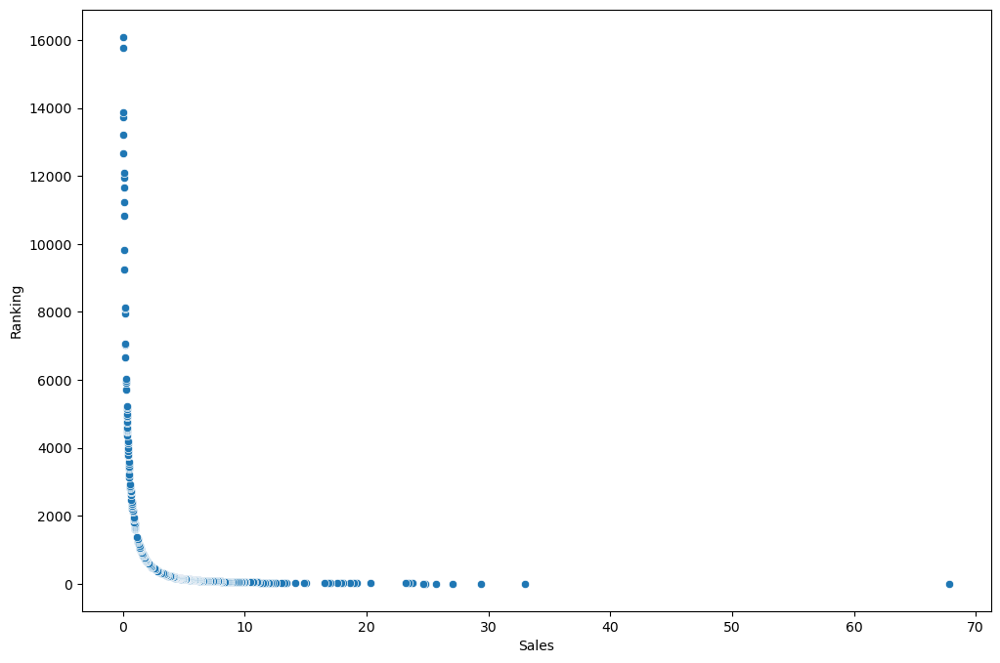

In [93]:
# Ranking and Sales
plt.figure(figsize = (12, 8))
sns.scatterplot(data = sales, y = 'Ranking', x = 'Global_Sales')
plt.xlabel('Sales')
plt.ylabel('Ranking')

Strong correlation here between sales and ranking - this is not surprising, but has implocations: 
- the higher ranked products are more desirable and sell better
- are they available at other sales outlets? Can we lower the price of some of these to draw customers in? Earn points for use with specific other prioducts? ie depends on competition, and other factors. Increase sales mean numbers or revenue? 

The outlier has twice as many sales. How to cehck the reliability of it? Check publisher products only, and low ranking proucts. 


Identify which publishers make the best ranking products.

Where should the cut off be? We know there is a strong alignment between Global sales and ranking (though with caution that this doesn't necessarily align with all markets ie NA =/= EU =/=Other)

In [94]:
# Make a new df which is just the low ranking / sales above 6million
low_rank = sales[sales['Global_Sales']>6].copy()
low_rank.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\208122.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  low_rank.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2
Ranking,1.000000,0.985155,0.118663,-0.646128,-0.550839,-0.738424,0.172785,0.985159
product,0.985155,1.000000,0.081300,-0.594376,-0.524320,-0.686850,0.124346,1.000000
Year,0.118663,0.081300,1.000000,-0.321248,0.186159,-0.156577,0.381236,0.081309
NA_Sales,-0.646128,-0.594376,-0.321248,1.000000,0.569189,0.901044,-0.152323,-0.594382
EU_Sales,-0.550839,-0.524320,0.186159,0.569189,1.000000,0.823889,-0.025617,-0.524322
Global_Sales,-0.738424,-0.686850,-0.156577,0.901044,0.823889,1.000000,-0.188425,-0.686856
count,0.172785,0.124346,0.381236,-0.152323,-0.025617,-0.188425,1.000000,0.124361
product2,0.985159,1.000000,0.081309,-0.594382,-0.524322,-0.686856,0.124361,1.000000


In [95]:
# Identify the unique publishers in this dataset
print(low_rank['Publisher'].unique())

['Nintendo' 'Microsoft Game Studios' 'Take-Two Interactive'
 'Sony Computer Entertainment' 'Activision' 'Ubisoft' 'Bethesda Softworks'
 'Electronic Arts' 'Sega' 'SquareSoft' 'Atari']


Text(0, 0.5, 'Ranking')

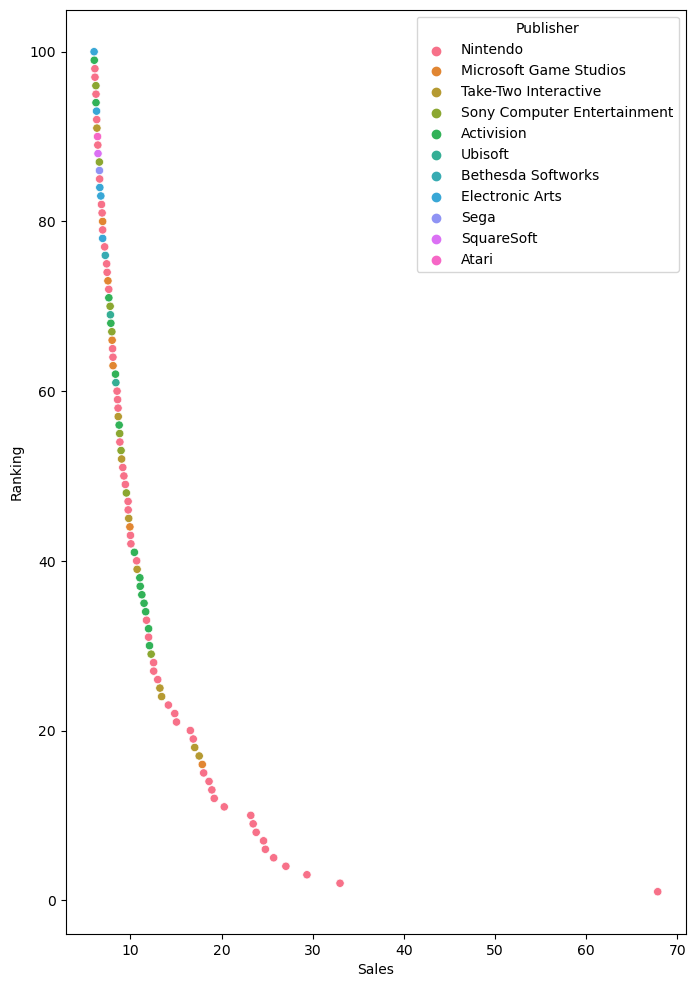

In [96]:
# popular products, their sales and their publishers
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank, y = 'Ranking', x = 'Global_Sales', hue = 'Publisher')
plt.xlabel('Sales')
plt.ylabel('Ranking')

Still slightly too few publishers for the hue to be as useful as might be desired, but we can pick out that Nintendo dominates. Do these figures distort the dataset? 

In [97]:
low_rank.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\206154268.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  low_rank.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2
Ranking,1.000000,0.985155,0.118663,-0.646128,-0.550839,-0.738424,0.172785,0.985159
product,0.985155,1.000000,0.081300,-0.594376,-0.524320,-0.686850,0.124346,1.000000
Year,0.118663,0.081300,1.000000,-0.321248,0.186159,-0.156577,0.381236,0.081309
NA_Sales,-0.646128,-0.594376,-0.321248,1.000000,0.569189,0.901044,-0.152323,-0.594382
EU_Sales,-0.550839,-0.524320,0.186159,0.569189,1.000000,0.823889,-0.025617,-0.524322
Global_Sales,-0.738424,-0.686850,-0.156577,0.901044,0.823889,1.000000,-0.188425,-0.686856
count,0.172785,0.124346,0.381236,-0.152323,-0.025617,-0.188425,1.000000,0.124361
product2,0.985159,1.000000,0.081309,-0.594382,-0.524322,-0.686856,0.124361,1.000000


There is a much stronger relationship between Global sales and ranking in this dataset. 

Also very significantly. product and ranking also have a much strongr correlation. They are in fact almost perferctly correlated for this dataset. 

Six is the ulitmate cut-off point for this subset (ie filterning at or above, or above six million - it makes no difference either way but 5.5 and 6.5 are lower correlations with product. 

Graph the product and ranking now. 

And try removing the outlier (approx 70 mill in sales) before checking again. 


In [98]:
low_rank2 = low_rank[low_rank['Global_Sales']<60].copy()
low_rank2.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2480146675.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  low_rank2.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2
Ranking,1.000000,0.984956,0.122593,-0.685493,-0.620226,-0.871209,0.163693,0.984960
product,0.984956,1.000000,0.084140,-0.632920,-0.600215,-0.815165,0.115410,1.000000
Year,0.122593,0.084140,1.000000,-0.407642,0.253532,-0.228692,0.383020,0.084148
NA_Sales,-0.685493,-0.632920,-0.407642,1.000000,0.259363,0.844507,-0.138511,-0.632927
EU_Sales,-0.620226,-0.600215,0.253532,0.259363,1.000000,0.652247,0.034057,-0.600216
Global_Sales,-0.871209,-0.815165,-0.228692,0.844507,0.652247,1.000000,-0.195231,-0.815173
count,0.163693,0.115410,0.383020,-0.138511,0.034057,-0.195231,1.000000,0.115424
product2,0.984960,1.000000,0.084148,-0.632927,-0.600216,-0.815173,0.115424,1.000000


That doesn't improve the product / ranking correltion. And it reduces the corrleation between the sales categories. GRaph this data to see if the curve is visibly different.

Text(0, 0.5, 'Ranking')

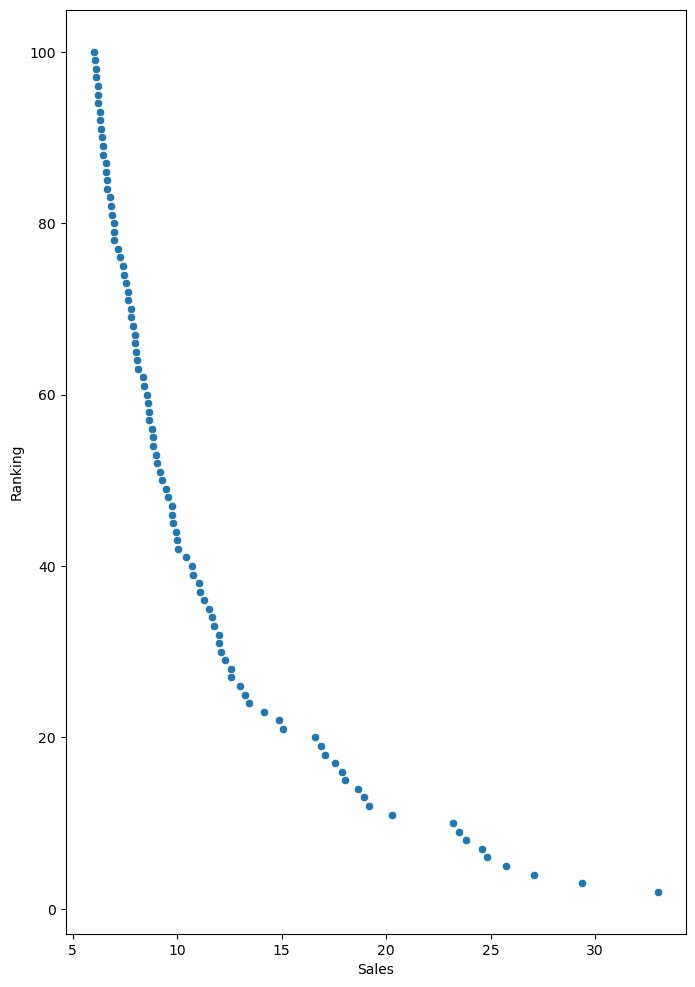

In [99]:
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank2, y = 'Ranking', x = 'Global_Sales')
plt.xlabel('Sales')
plt.ylabel('Ranking')

Text(0, 0.5, 'Ranking')

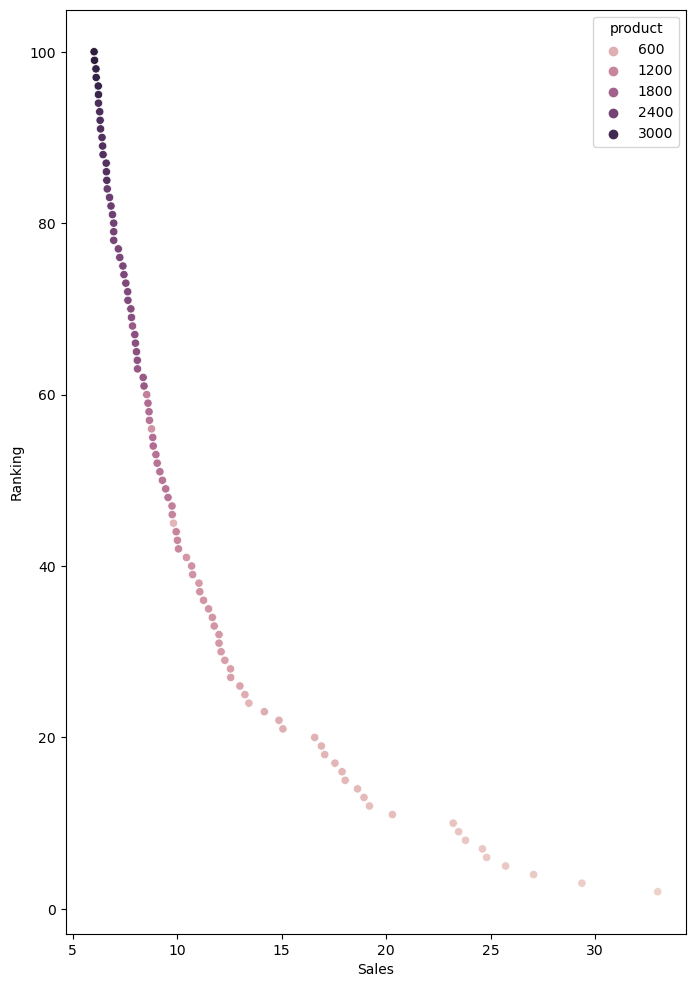

In [100]:
# It's easier to see clusters here. Graph again with product as hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank2, y = 'Ranking', x = 'Global_Sales', hue = 'product')
plt.xlabel('Sales')
plt.ylabel('Ranking')

So we've clearly identified the pattern by which products are numbered, at least for this subset of the data. Products are numbered based on their Ranking. This isn't directly something the client wanted to know but it may inform out analysis of what they've asked. 

Need to look at the filtered out data to see if there is a correlation there too of a similar or comparable nature. 
And want to look at the year as a hue with product number and ranking graphed. 


Text(0, 0.5, 'Ranking')

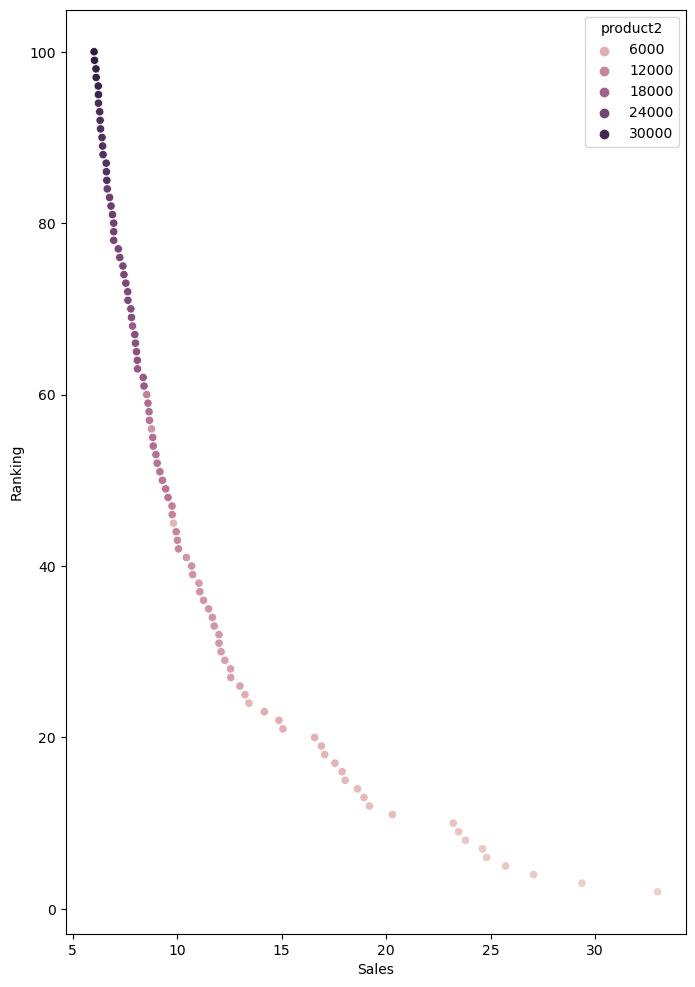

In [101]:
# It's easier to see clusters here. Graph again with product as hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank2, y = 'Ranking', x = 'Global_Sales', hue = 'product2')
plt.xlabel('Sales')
plt.ylabel('Ranking')

We can say with reasonable confidence (as we expected) that the product2 data reflects the pattern seen in product data. 


What if we graph the product2 data instead? 

Text(0, 0.5, 'Ranking')

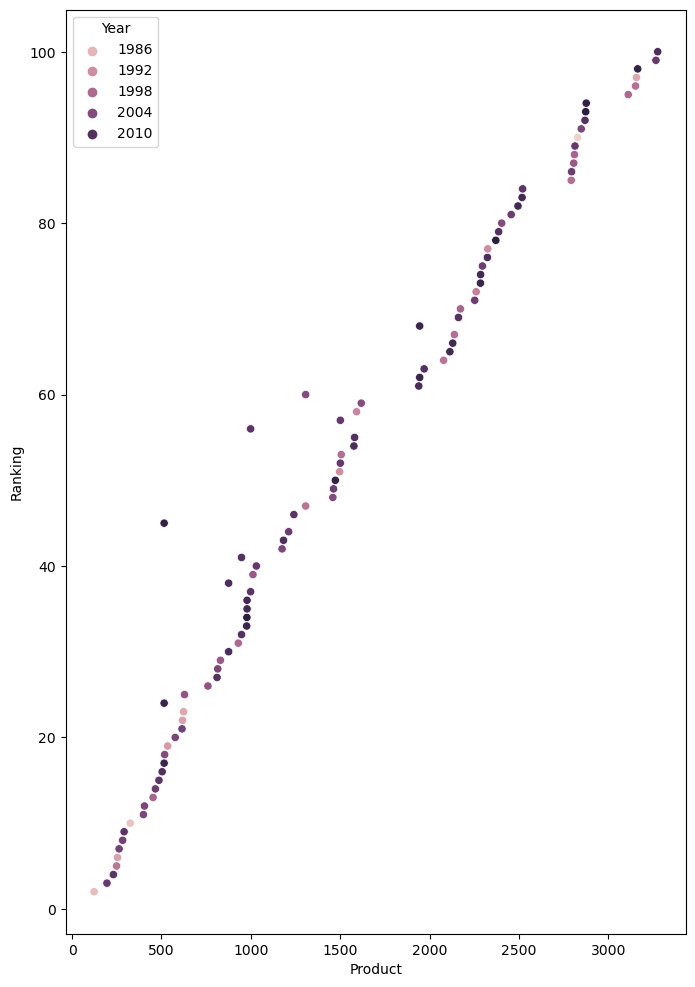

In [102]:

# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank2, y = 'Ranking', x = 'product', hue = 'Year')
plt.xlabel('Product')
plt.ylabel('Ranking')

 We can clearly now see the outliers in the relationship between Sales and Ranking.  It would be good to identify these: filtering them may improve the overall models, but evem just identifying them will be intersting and may be informative. 
 
 
 And we can see that year doesn't seem to have much to do with the product number at all!
 
 Graph this relationship again but with the whoe dataset.


Text(0, 0.5, 'Ranking')

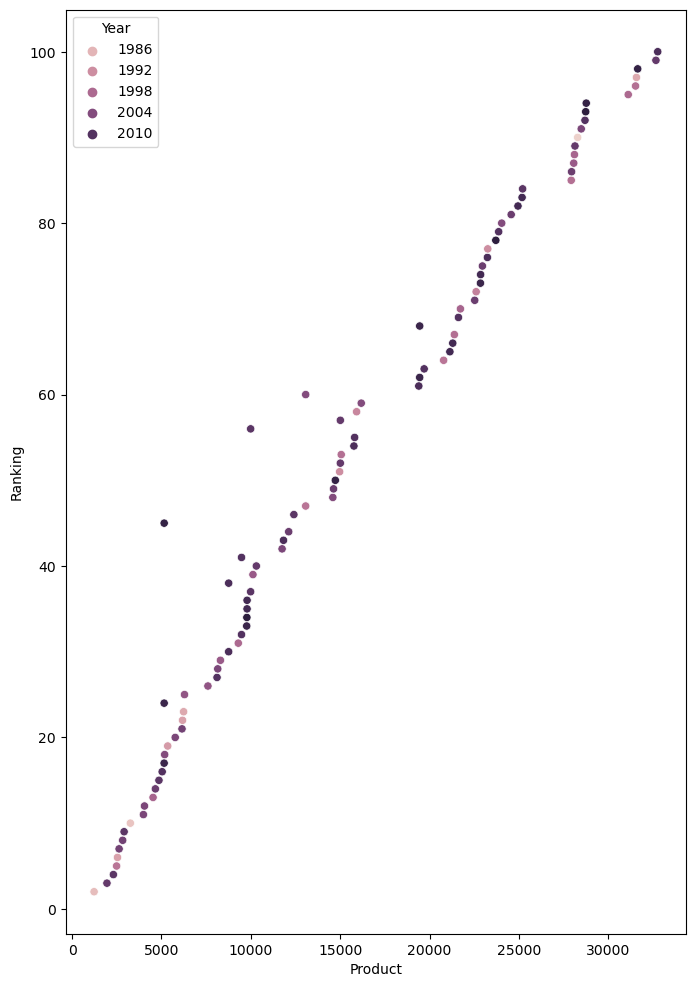

In [103]:
# Plot again with product2 data. 

# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank2, y = 'Ranking', x = 'product2', hue = 'Year')
plt.xlabel('Product')
plt.ylabel('Ranking')

Admittedly a scatterplot may not show all the datapoints, but there doesn't seem to be a difference here. Is that because the duplicates predominate in some areas of the df? 

Text(0, 0.5, 'Ranking')

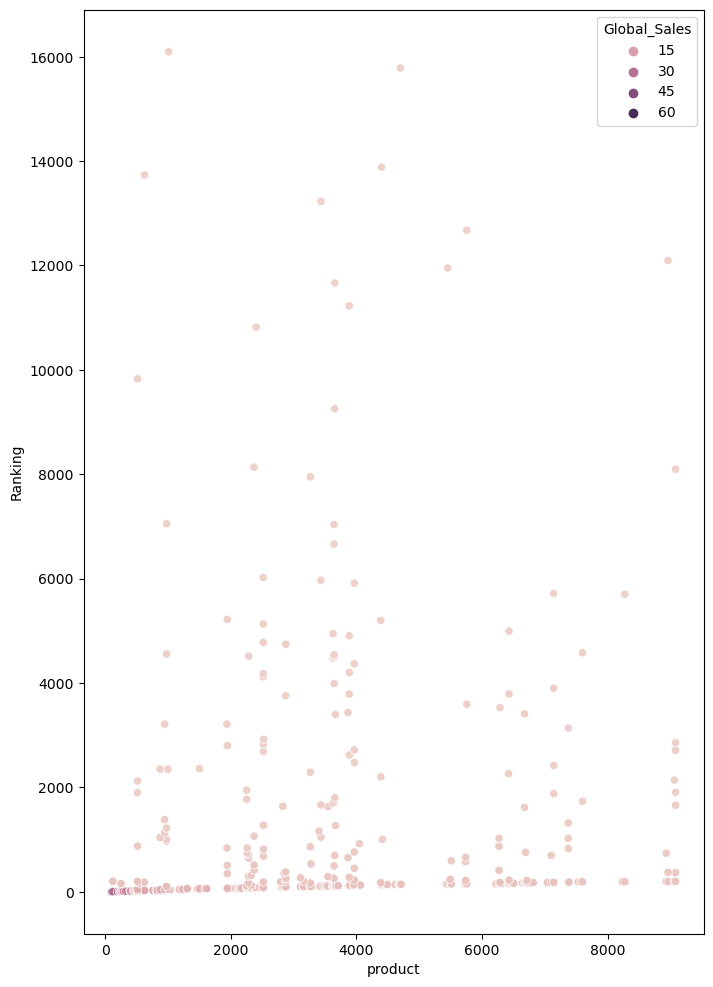

In [104]:
# scatter plot of product data to determine if ranking / product no relationship is visible.
plt.figure(figsize = (8, 12))
sns.scatterplot(data = sales, y = 'Ranking', x = 'product', hue = 'Global_Sales')
plt.xlabel('product')
plt.ylabel('Ranking')

The very low ranking (and therefore very high sales) data is obscured here.

Text(0, 0.5, 'Ranking')

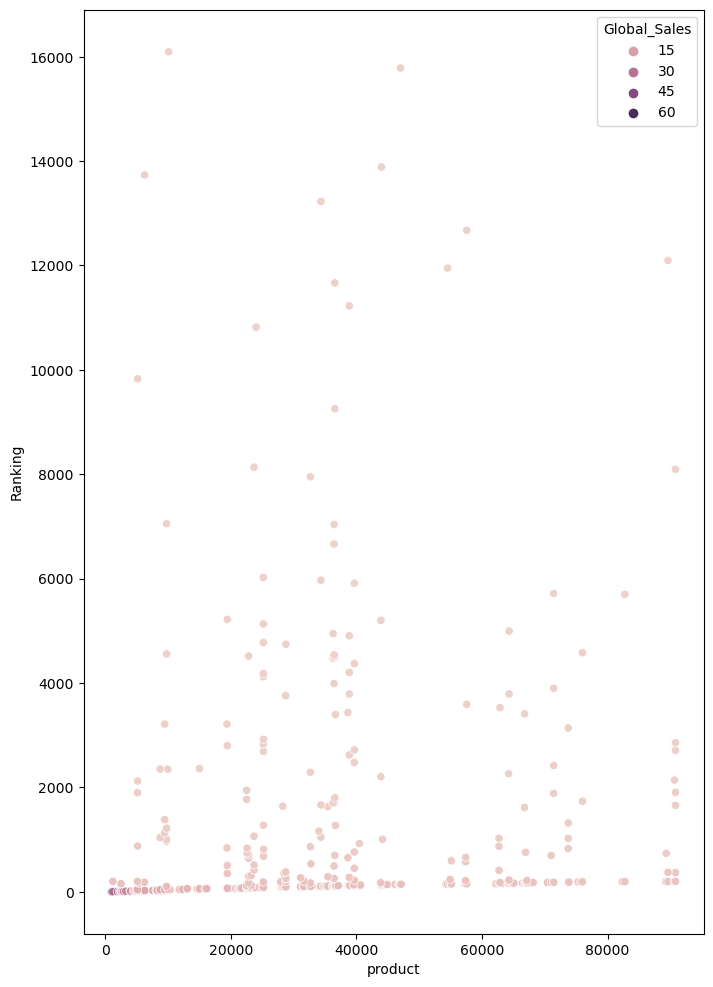

In [105]:
# scatter plot of produc2 data to determine if ranking / product relationship is visible.
plt.figure(figsize = (8, 12))
sns.scatterplot(data = sales, y = 'Ranking', x = 'product2', hue = 'Global_Sales')
plt.xlabel('product')
plt.ylabel('Ranking')

A scatterplot of the whole dataset makes this difficult to see, because there are so many datapoints and also the lower sales products predominate.


Text(0, 0.5, 'Global Sales')

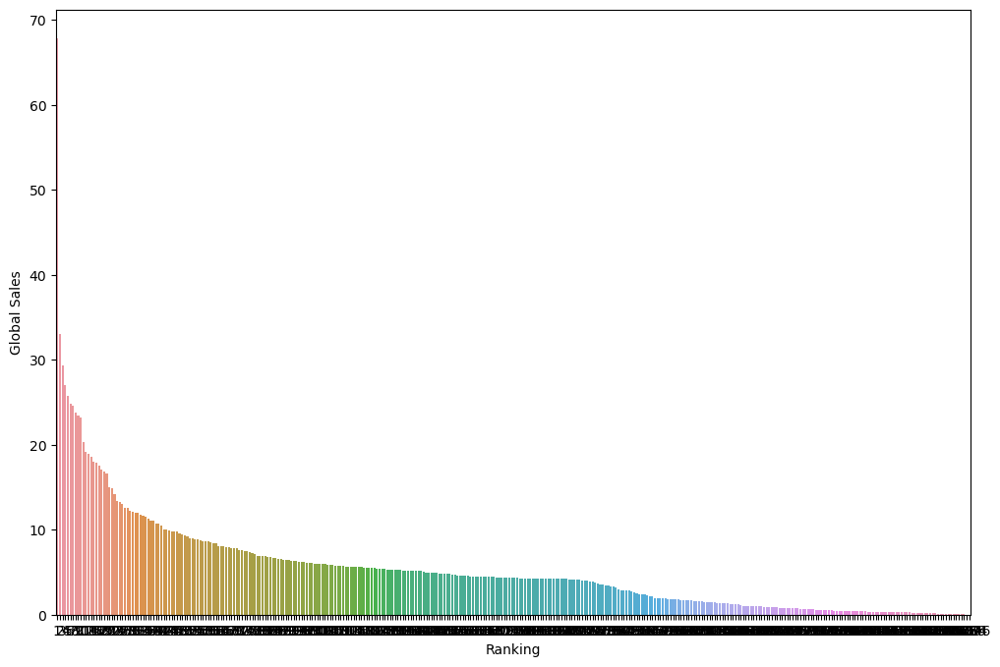

In [106]:
# bar plot
plt.figure(figsize = (12, 8))
sns.barplot(data = sales, x = 'Ranking', y = 'Global_Sales')
plt.xlabel('Ranking')
plt.ylabel('Global Sales') 

There are clear groupings here - one to note that we haven't attended yet, is indicated by the line below, which shows wher the sales start to decine again after a considerable plateau. 

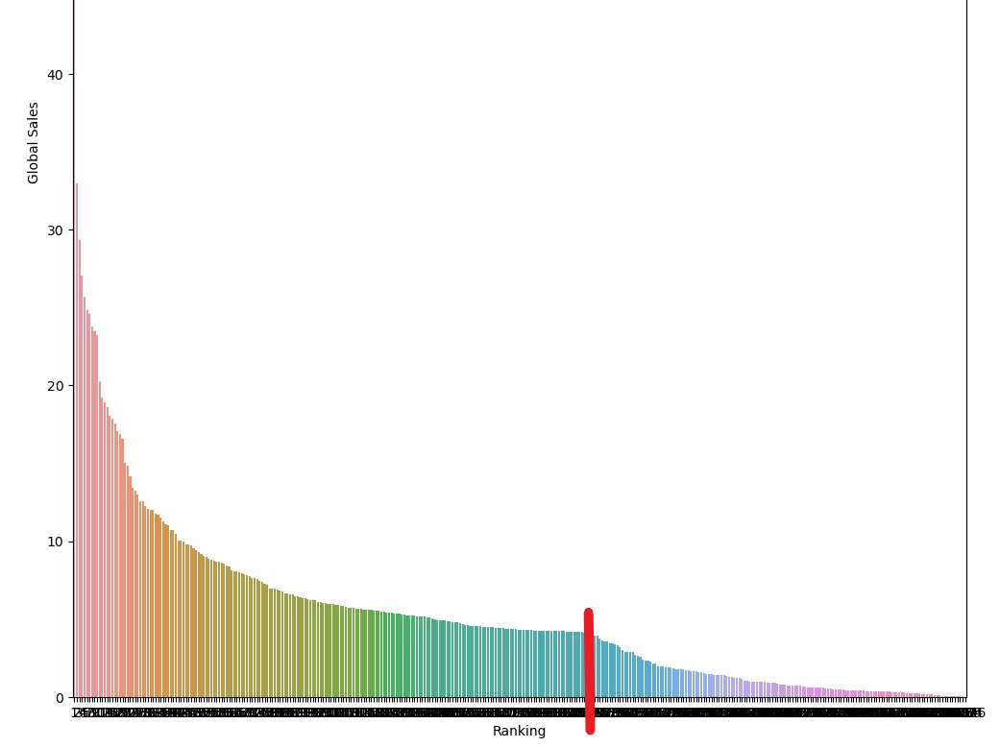

We have discovered that there is a relationship between ranking and product id (at least for a subset of the data). 

We also know that there are duplicate values at the same ranking. 

So perhaps the product id, being dependent somewhat on ranking, has more to reveal. 

This does justify the exploration of the product id column, when our overall task is to increase sales for Turtle Games. 
- it may be that we recommend separate product ids. 
- product id is dependent on ranking, and so are sales. 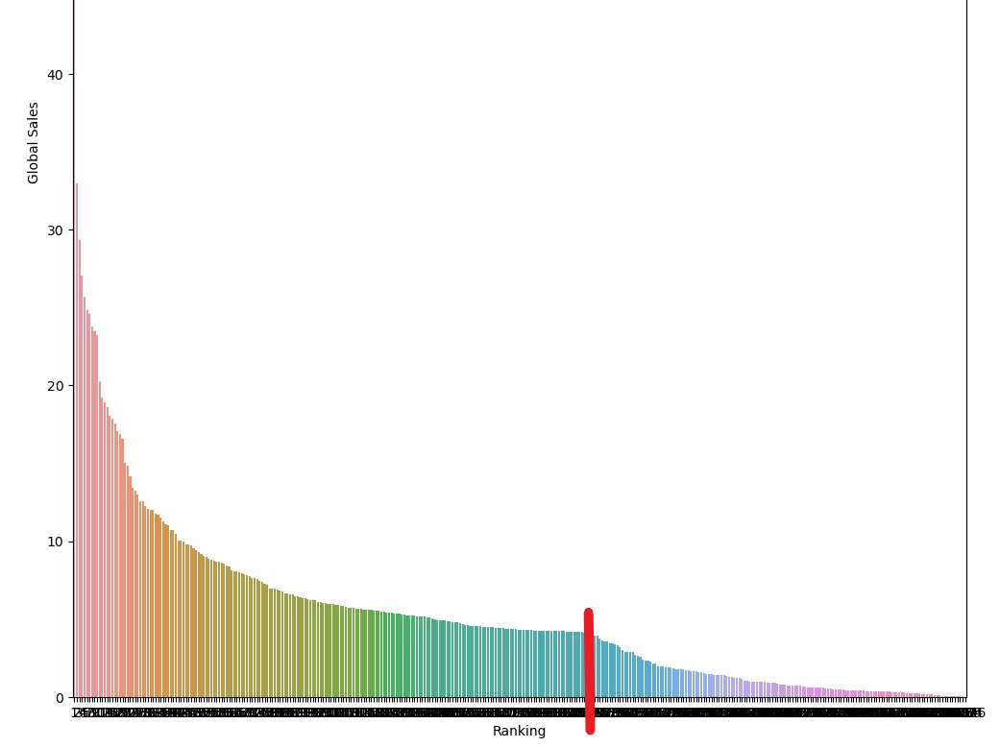



In [107]:
# Bracket the data by Ranking and replot, to show how the best ranking products dominate sales.

# Define the number of brackets
# num_brackets = 50
# num_brackets = 18
num_brackets = 7
# Create the new column 
sales['Ranking_Bracket'] = pd.qcut(sales['Ranking'], q = num_brackets, labels = False)

# Count the number of occurences in each ranking bracket. 
ranking_counts = sales['Ranking_Bracket'].value_counts().sort_index()
print(ranking_counts)

0    51
1    50
2    50
3    50
4    50
5    50
6    51
Name: Ranking_Bracket, dtype: int64


In [108]:
sales.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0


Text(0, 0.5, 'Global Sales')

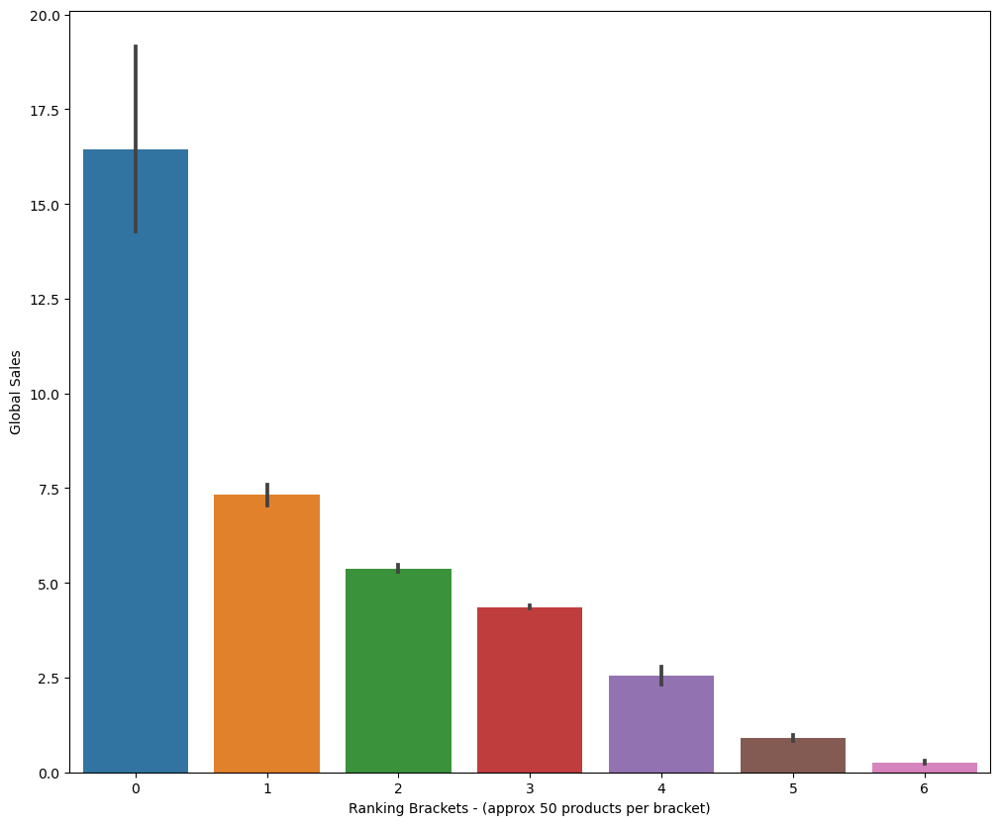

In [109]:
# bar plot showing how sales relies on best ranking products
plt.figure(figsize = (12, 10))
sns.barplot(data = sales, x = 'Ranking_Bracket', y = 'Global_Sales')
plt.xlabel('Ranking Brackets - (approx 50 products per bracket)')
plt.ylabel('Global Sales') 

That is useful because it shows the data more manageably than all of the products can. But because the sales data is the mean of the values in each bracket, we don't see quite how esxtreme the impact of ratings are on sales. To do that we will need to group the data first, by ranking bracket, then replot.

In [110]:
# Grop the sales data by bracket.

Ranking_Sales = sales.groupby('Ranking_Bracket')['Global_Sales'].sum().reset_index()
Ranking_Sales.head()

,Ranking_Bracket,Global_Sales
0,0,838.27
1,1,366.49
2,2,268.88
3,3,218.14
4,4,127.63


Text(0, 0.5, 'Global Sales')

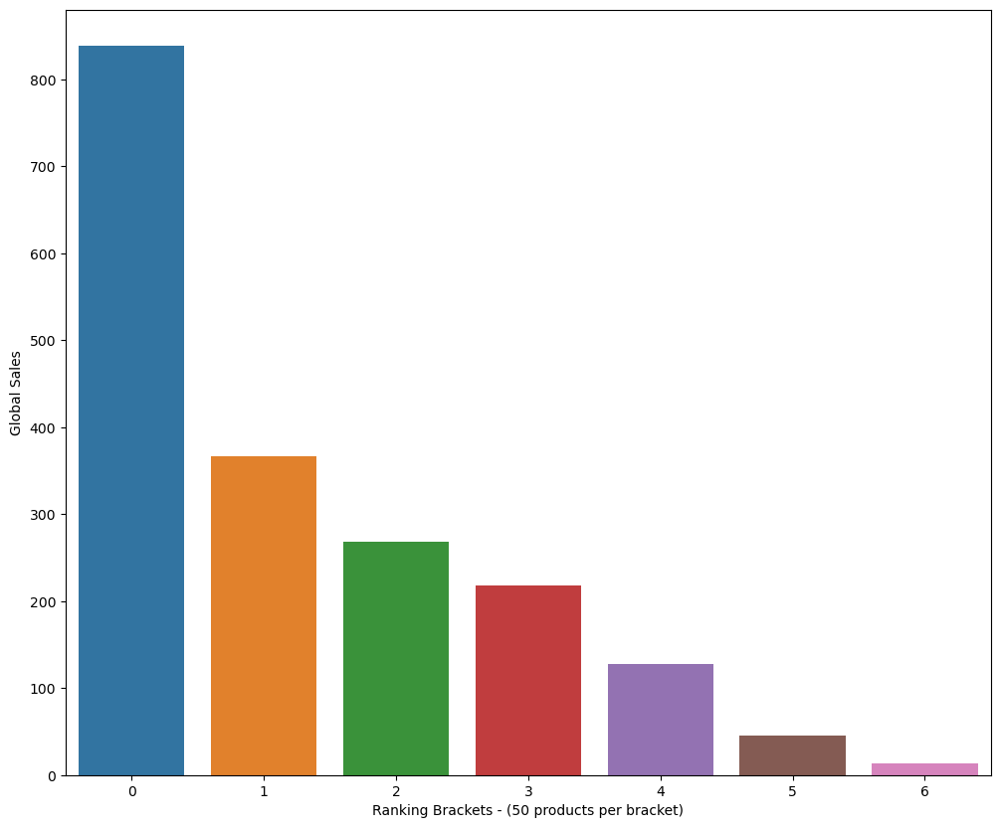

In [111]:
# bar plot showing how sales relies on best ranking products (showing brackets and sum of sales)
plt.figure(figsize = (12, 10))
sns.barplot(data = Ranking_Sales, x = 'Ranking_Bracket', y = 'Global_Sales')
plt.xlabel('Ranking Brackets - (50 products per bracket)')
plt.ylabel('Global Sales') 

I think this does show the effect of ranking on sales, more meaningfully. 

In [112]:
# Which products are in the bset 50 (rankings)?

top_50 = sales[sales['Ranking_Bracket'] == 0]

top_50.sort_values('Ranking', ascending = True, inplace = True)
top_50.head(50)

C:\Users\User\AppData\Local\Temp\ipykernel_9840\1838584909.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_50.sort_values('Ranking', ascending = True, inplace = True)


,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0
5,6,254,GB,1989.0,Puzzle,Nintendo,19.02,1.85,24.81,2,2540,0
6,7,263,DS,2006.0,Platform,Nintendo,9.33,7.57,24.61,1,2630,0
7,8,283,Wii,2006.0,Misc,Nintendo,11.50,7.54,23.80,1,2830,0
8,9,291,Wii,2009.0,Platform,Nintendo,11.96,5.79,23.47,1,2910,0
9,10,326,NES,1984.0,Shooter,Nintendo,22.08,0.52,23.21,1,3260,0


<Axes: xlabel='Genre', ylabel='Global_Sales'>

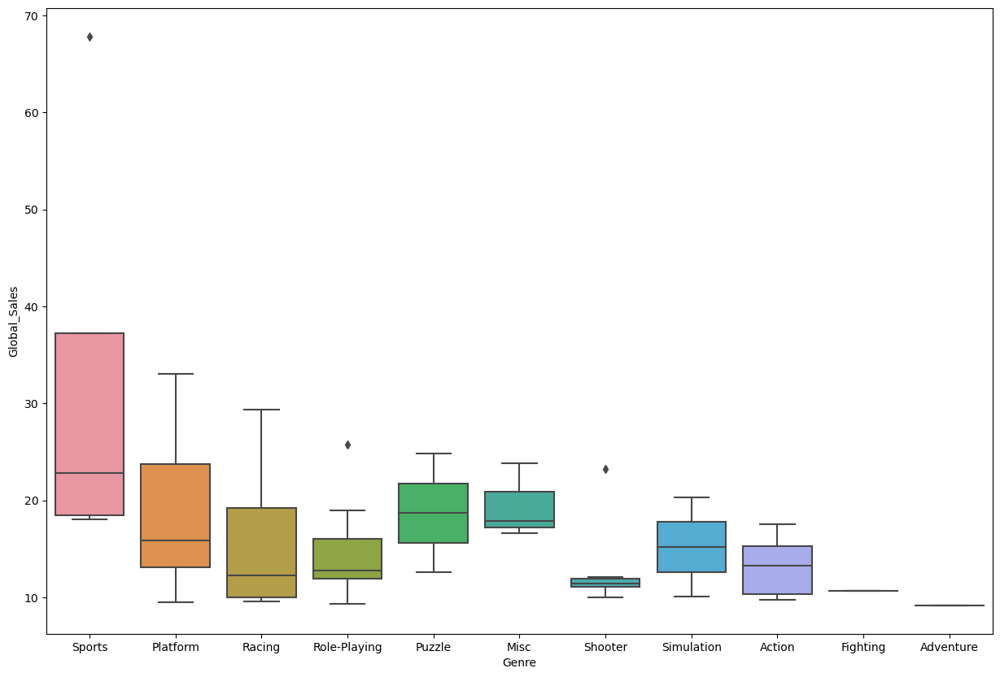

In [113]:
# Graph the various variables of this data to show which variables predominate in this group.
plt.figure(figsize = (15, 10))
sns.boxplot(data = top_50, x = 'Genre', y = 'Global_Sales')

<Axes: xlabel='Genre', ylabel='Global_Sales'>

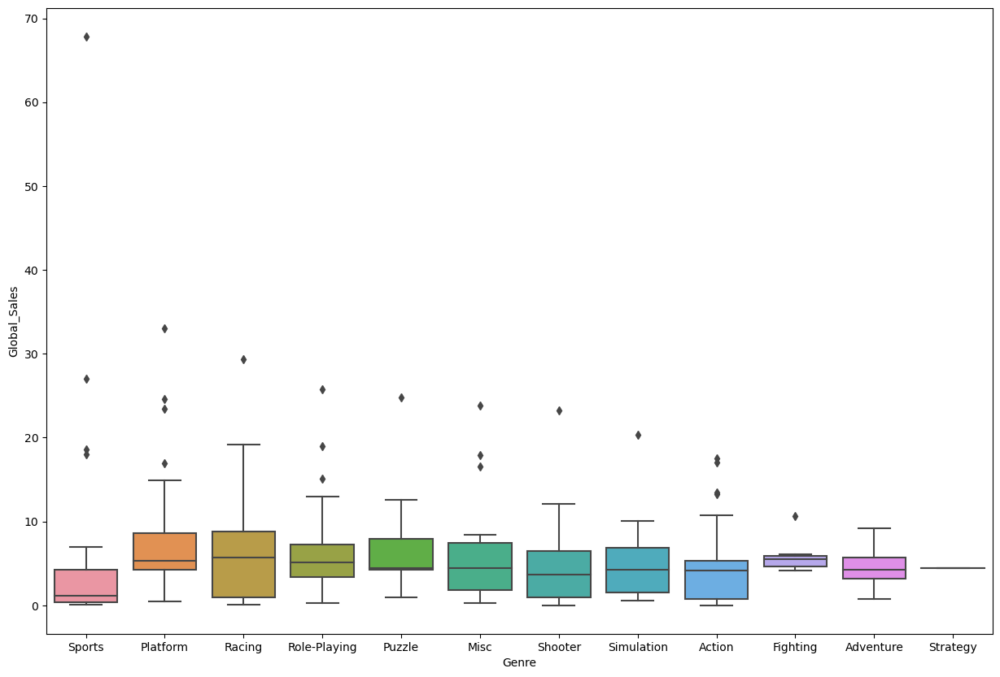

In [114]:
# Graph the various variables of this data to show which variables predominate in this group.
# But this time with all the data
plt.figure(figsize = (15, 10))
sns.boxplot(data = sales, x = 'Genre', y = 'Global_Sales')

<Axes: xlabel='Publisher', ylabel='Global_Sales'>

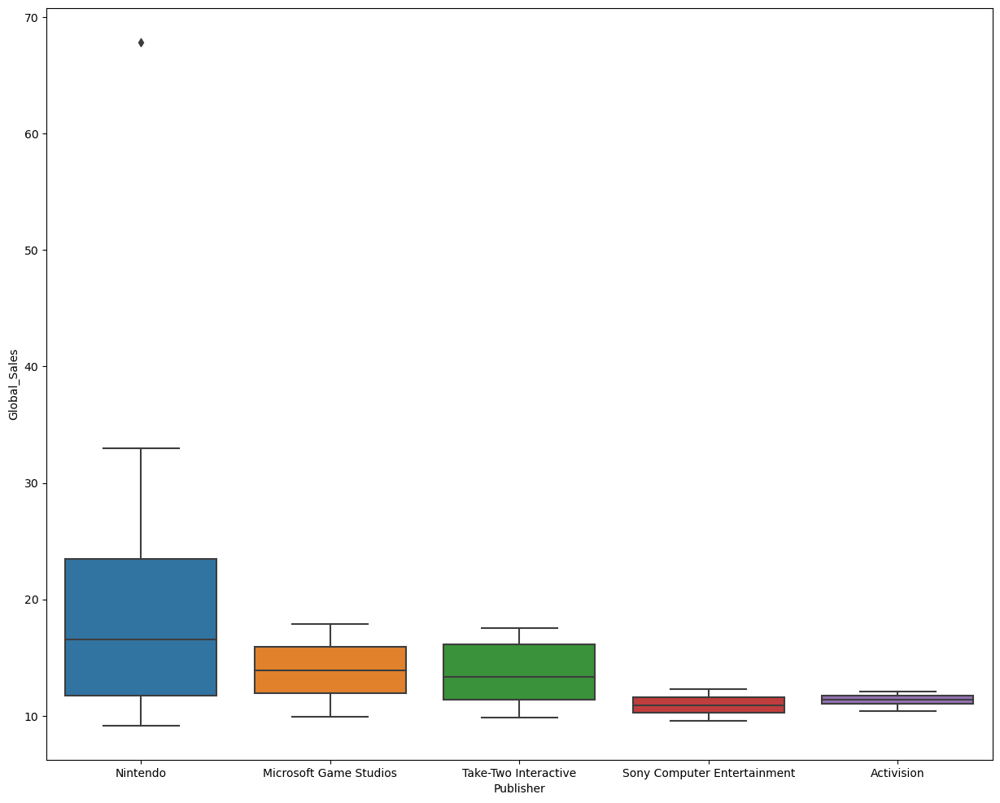

In [115]:
# Graph the various variables of this data to show which variables predominate in this group.
plt.figure(figsize = (15, 12))
sns.boxplot(data = top_50, x = 'Publisher', y = 'Global_Sales')

Aside from nintendo, which seems to have a crazy outlier, these all look reasonbly normally distrubuted - but of course it could be that there are high figures that are distoritng the mean. 

<Axes: xlabel='Year', ylabel='Global_Sales'>

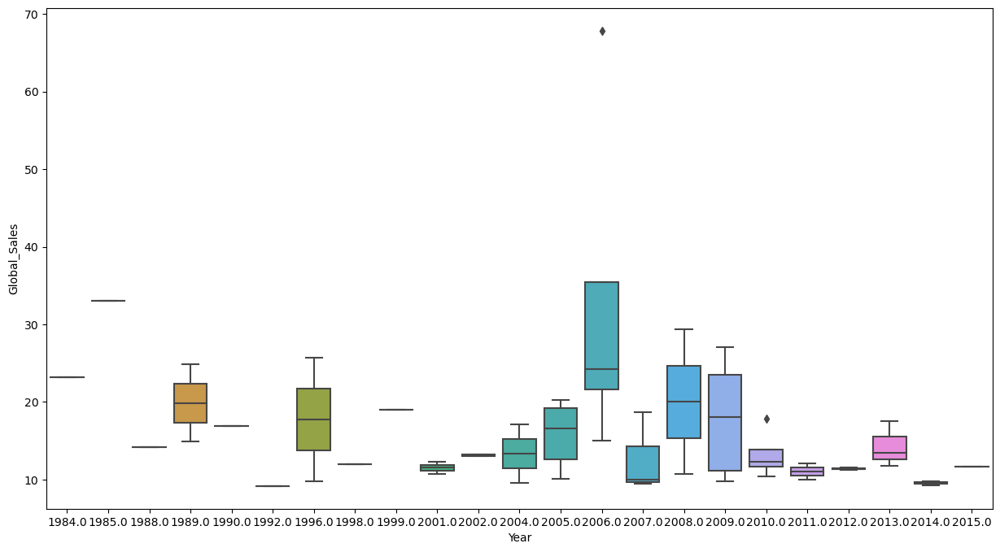

In [116]:
# Graph the various variables of this data to show which variables predominate in this group.
plt.figure(figsize = (15, 8))
sns.boxplot(data = top_50, x = 'Year', y = 'Global_Sales')

What came out in 2006? Is there any way to influence the publishers to identify what works about that product, to encourage them to produce more? Or will publihsers be doing that already....depends if Turtle Sale ranking (and sales) reflect overall. 


Are there limits in supply of the products which were produced longer ago? 

Text(0, 0.5, 'Ranking')

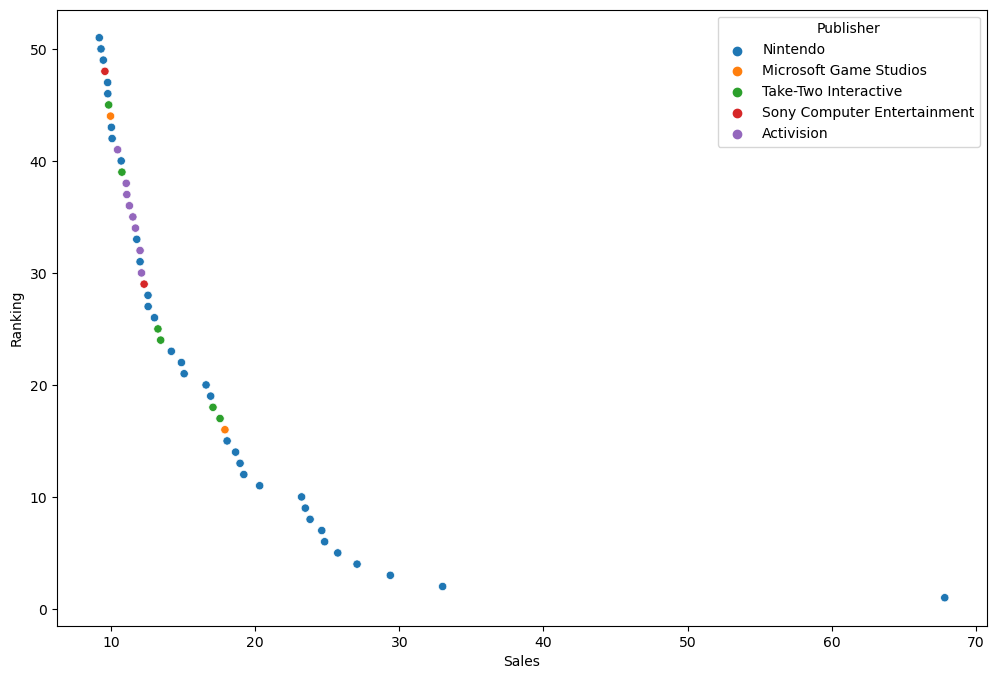

In [117]:
# popular products, their sales and their publishers
plt.figure(figsize = (12, 8))
sns.scatterplot(data = top_50, y = 'Ranking', x = 'Global_Sales', hue = 'Publisher')
plt.xlabel('Sales')
plt.ylabel('Ranking')

<Axes: xlabel='Platform', ylabel='Global_Sales'>

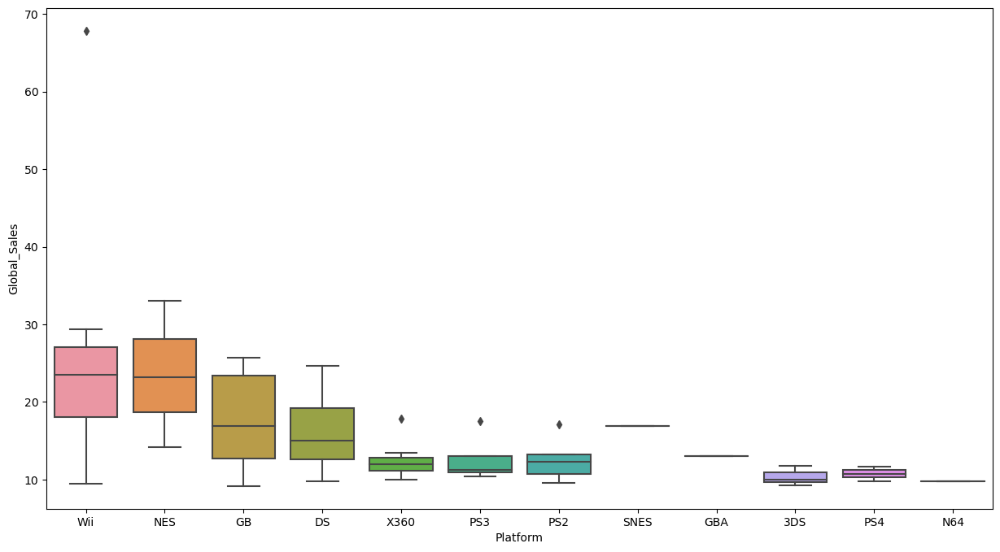

In [118]:
# Graph the various variables of this data to show which variables predominate in this group.
plt.figure(figsize = (15, 8))
sns.boxplot(data = top_50, x = 'Platform', y = 'Global_Sales')

We're going to go back now to the relationship between product and ranking that we identified and explore that further. 

In [119]:
# Which datapoints (products) are the outliers in the rank  / product relationship (low_rank)
# When we know what causes (or excludes) these outliers, can apply to the rest of the dataset?


# Identify the residuals.

# Fit a linear regression model.
model = np.polyfit(low_rank['Ranking'], low_rank['product'], 1)
predicted_values = np.polyval(model, low_rank['Ranking'])

# Calculate the residuals. 
residuals = low_rank['product'] - predicted_values

# Calculate the z-scores for residuals. 
z_scores = (residuals - residuals.mean()) / residuals.std()


In [120]:
print(z_scores)

0     0.989977
1     0.891925
2     1.143017
3     1.169659
4     1.084077
        ...   
95    1.189223
96    1.022589
97    0.868425
98    1.306558
99    1.171098
Name: product, Length: 100, dtype: float64


In [121]:
# Identify the outliers based on  z-scores
outliers = low_rank[abs(z_scores) >1.4]

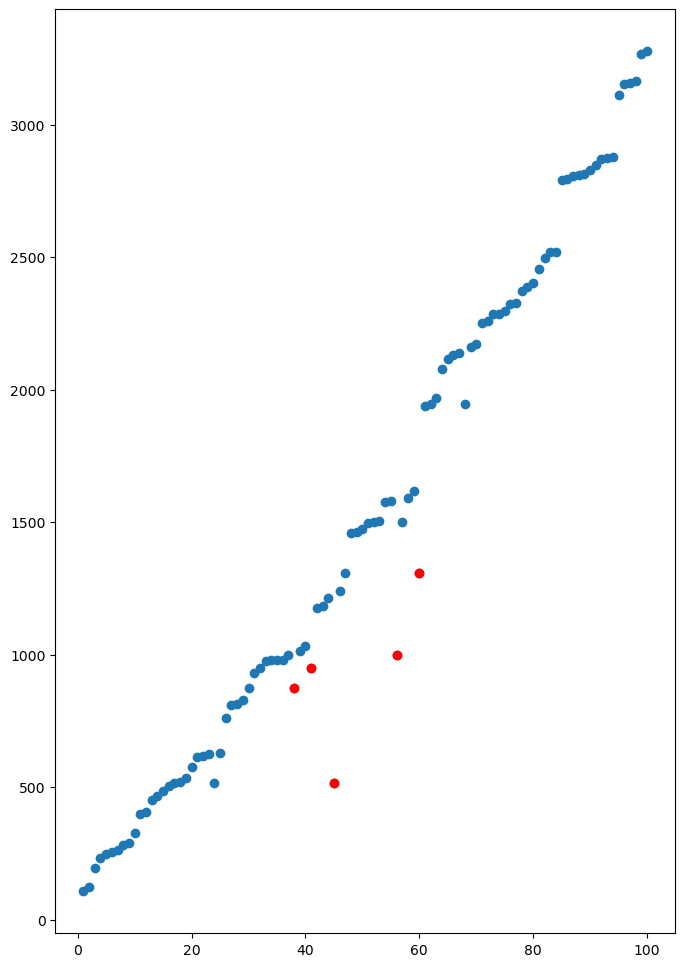

In [122]:
# Scatterplot
plt.figure(figsize = (8, 12))
plt.scatter(low_rank['Ranking'], low_rank['product'])
plt.scatter(outliers['Ranking'], outliers['product'], color='red')
plt.show()


In [123]:
# Determine which products are outliers. 
print(outliers)

    Ranking  product Platform    Year     Genre             Publisher  \
37       38      876      PS3  2011.0   Shooter            Activision   
40       41      948      PS3  2010.0   Shooter            Activision   
44       45      515      PS4  2014.0    Action  Take-Two Interactive   
55       56      999      PS3  2009.0   Shooter            Activision   
59       60     1307       DS  2004.0  Platform              Nintendo   

    NA_Sales  EU_Sales  Global_Sales  count  product2  
37      4.54      4.77         11.04      4      8761  
40      4.90      3.64         10.44      5      9481  
44      3.12      4.76          9.82      5      5152  
55      4.09      3.03          8.77      3      9991  
59      4.17      2.55          8.54      2     13071  


There is no observable pattern to these products. Filter them from the df and replot.


Text(0, 0.5, 'Ranking')

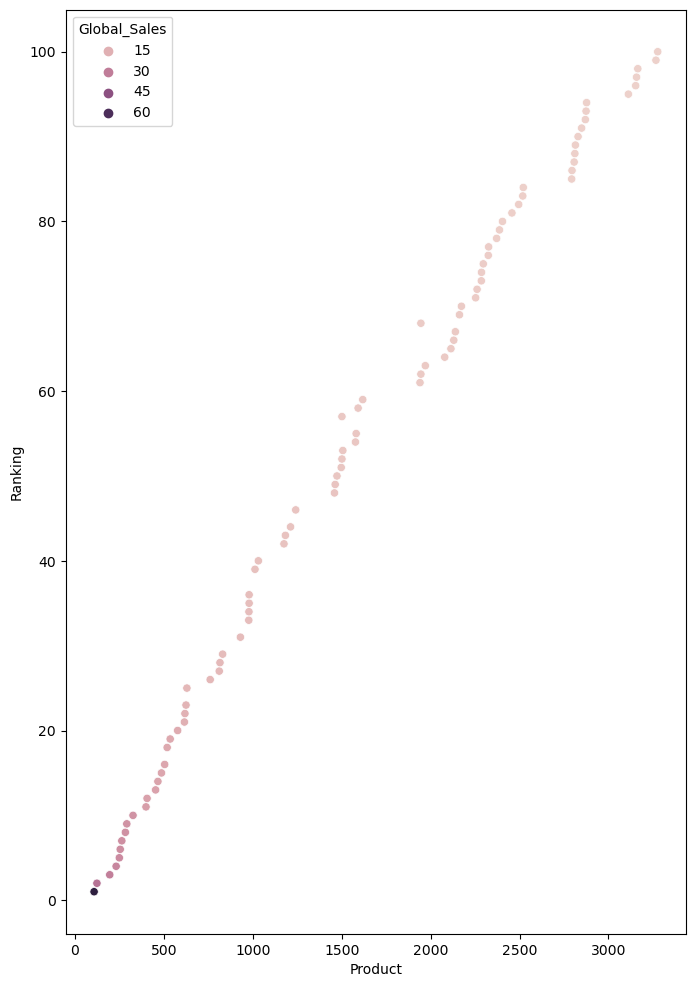

In [124]:
# Remove the outliers from the df. 
low_rank3 = low_rank[~low_rank['product'].isin(outliers['product'])]


# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = low_rank3, y = 'Ranking', x = 'product', hue = 'Global_Sales')
plt.xlabel('Product')
plt.ylabel('Ranking')

The clusters here are even clearer now - as if the product numbers are allocated according to a code. 
We think from wht we've established so far that the Ranking determines the product number (to some degree). Perhaps that's the intention, but the system doesn't always work? Return to the higher ranked (poorer sales)products.


In [125]:
# Attend to the higher ranking products (poor sales)
high_rank = t_sales[t_sales['Global_Sales']<=6].copy()
high_rank.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\23720718.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  high_rank.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
Ranking,1.000000,-0.127894,0.059081,-0.587217,-0.552799,-0.681280,0.238510,-0.127857,0.716023
product,-0.127894,1.000000,-0.208320,0.121443,0.028335,0.149997,-0.246064,1.000000,-0.131094
Year,0.059081,-0.208320,1.000000,-0.329906,0.025781,-0.269523,0.526106,-0.208293,0.267408
NA_Sales,-0.587217,0.121443,-0.329906,1.000000,0.479119,0.865465,-0.546592,0.121396,-0.843254
EU_Sales,-0.552799,0.028335,0.025781,0.479119,1.000000,0.775469,-0.130406,0.028295,-0.744721
Global_Sales,-0.681280,0.149997,-0.269523,0.865465,0.775469,1.000000,-0.493998,0.149943,-0.966453
count,0.238510,-0.246064,0.526106,-0.546592,-0.130406,-0.493998,1.000000,-0.246016,0.501237
product2,-0.127857,1.000000,-0.208293,0.121396,0.028295,0.149943,-0.246016,1.000000,-0.131039
Ranking_Bracket,0.716023,-0.131094,0.267408,-0.843254,-0.744721,-0.966453,0.501237,-0.131039,1.000000


Text(0, 0.5, 'Product')

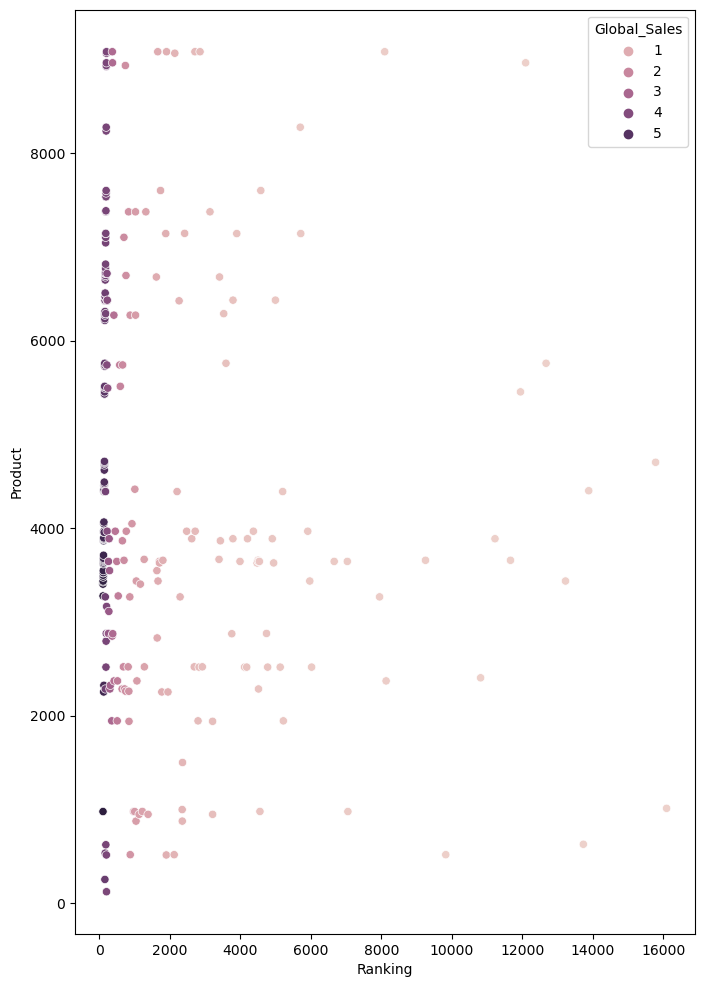

In [126]:
 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = high_rank, x = 'Ranking', y = 'product', hue = 'Global_Sales')
plt.xlabel('Ranking')
plt.ylabel('Product')

There is a relationship, still, between rank and sales. But the product correlation is gone. 

Once again we can see the clusters of product numbers. What makes these unique?

There is a weak negative correlation between NA sale and Year. 

I can't determine yet what clusters these together ie which the product numbers break at about 1600 and 5000. (Various hues used, above).

Because a larger dataset would be better, return to the original t_sales data set and map the low_rank model onto it. 

Text(0, 0.5, 'Product')

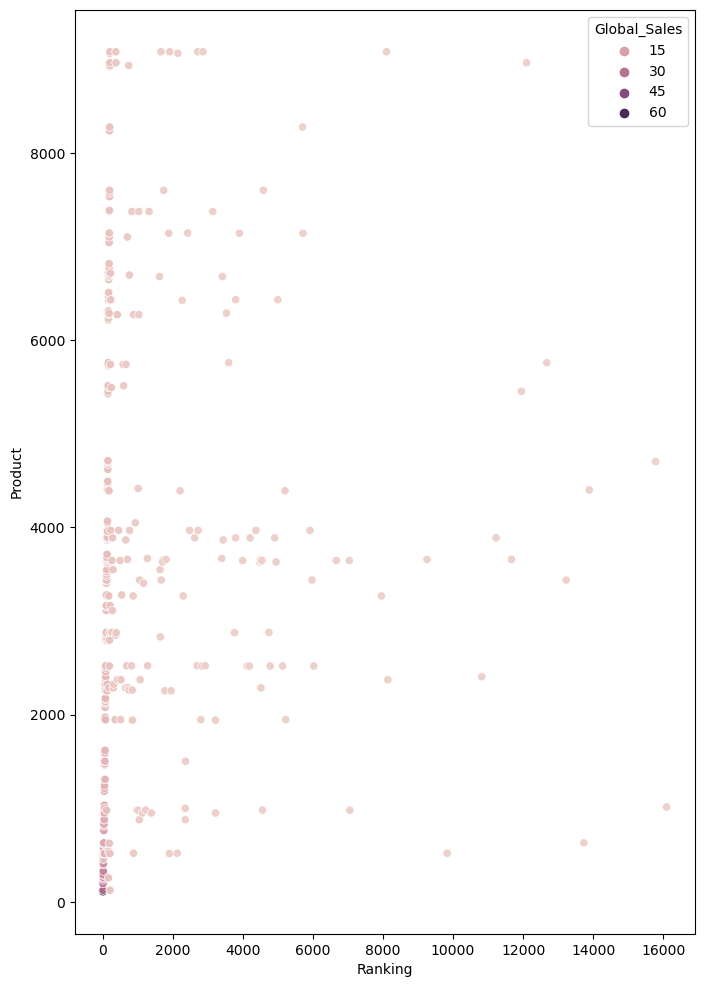

In [127]:
 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = t_sales, x = 'Ranking', y = 'product', hue = 'Global_Sales')
plt.xlabel('Ranking')
plt.ylabel('Product')

In [128]:
# Can we figure out the relationship between Ranking and product number that is in the good ranking dataset? 
low_rank3.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490


In [129]:
# Determine the correlation coefficient of Ranking and prduct in the lowrank3 dataset. 
correlation = low_rank3['product'].corr(low_rank3['Ranking'])
print(correlation)

0.9947757243079762


In [130]:
# Independent variable.
x = low_rank3['Ranking']
# Dependent variable.
y = low_rank3['product']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'

# Create a second variable to store the ols()method. 
test = ols(f, data = low_rank3).fit()

# Print the regression table. 
test.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.989
Method:                 Least Squares   F-statistic:                     8261.
Date:                Mon, 24 Jul 2023   Prob (F-statistic):           5.16e-88
Time:                        22:14:38   Log-Likelihood:                -533.66
No. Observations:                  89   AIC:                             1071.
Df Residuals:                      87   BIC:                             1076.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -45.9103     20.859     -2.201      0.030     -87.370      -4.451
x             31.6137      0.348     90.892      0.000      30.922      32.305
==============================================================================
Omnibus:                        2.066   Durbin-Watson:                   0.445
Prob(Omnibus):                  0.356   Jarque-Bera (JB):                1.867
Skew:                          -0.246   Prob(JB):                        0.393
Kurtosis:                       2.490   Cond. No.                         120.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [131]:
# Extract the estimated parameters.
print("Parameters:", test.params)

# Extract the standard errors.
print("Standard Errors:", test.bse)

# Extract the predicted values.
print("Predicted values:", test.predict())

Parameters: Intercept   -45.910291
x            31.613674
dtype: float64
Standard Errors: Intercept    20.859123
x             0.347817
dtype: float64
Predicted values: [ -14.29661671   17.3170575    48.93073172   80.54440593  112.15808015
  143.77175436  175.38542858  206.99910279  238.612777    270.22645122
  301.84012543  333.45379965  365.06747386  396.68114807  428.29482229
  459.9084965   523.13584493  554.74951915  586.36319336  617.97686757
  649.59054179  681.204216    744.43156443  776.04523865  807.65891286
  839.27258707  870.88626129  934.11360972  997.34095814 1028.95463236
 1060.56830657 1092.18198079 1187.02300343 1218.63667764 1281.86402607
 1313.47770029 1345.0913745  1408.31872293 1471.54607136 1503.15974557
 1534.77341979 1566.387094   1598.00076821 1629.61444243 1661.22811664
 1692.84179086 1756.06913929 1787.6828135  1819.29648771 1882.52383614
 1914.13751036 1945.75118457 1977.36485878 2008.978533   2040.59220721
 2072.20588143 2103.81955564 2135.43322986 2167.04

In [132]:
# Set the X coefficient and the constant to generate the regression table.
y_pred = (-45.910291) + 31.613674 * low_rank3['Ranking']

# View the output.
y_pred

0      -14.296617
1       17.317057
2       48.930731
3       80.544405
4      112.158079
         ...     
95    2989.002413
96    3020.616087
97    3052.229761
98    3083.843435
99    3115.457109
Name: Ranking, Length: 89, dtype: float64

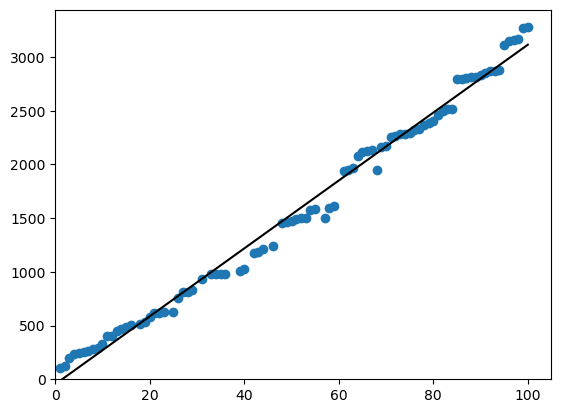

In [133]:
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred, color = 'black')

# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

In [134]:
# Set the X coefficient and the constant to generate the regression table.
y_pred1 = (-45.910291) + 31.613674 * t_sales['Ranking']

# View the output.
y_pred1

0         -14.296617
1          17.317057
2          48.930731
3          80.544405
4         112.158079
           ...      
347    418108.155707
348    434136.288425
349    438941.566873
350    498944.320125
351    508807.786413
Name: Ranking, Length: 352, dtype: float64

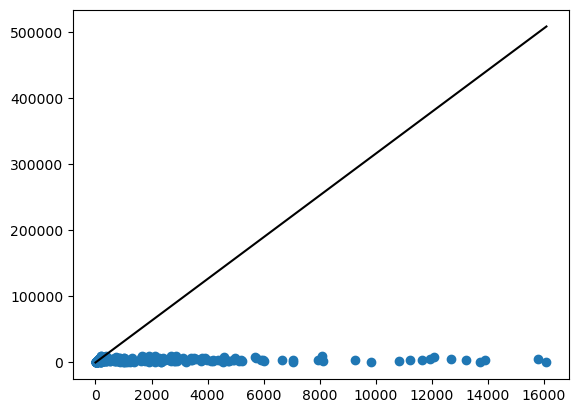

In [135]:
# Fit to the larger dataset
# Independent variable.
x = t_sales['Ranking']
# Dependent variable.
y = t_sales['product']



# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)



# Plot the regression line. 
plt.plot(x, y_pred1, color = 'black')

# Plot the x and y limits on the axes. 

plt.show()

The regression line dwarfs the dataset. The trajectory for the top ranking products is not visible elsewhere. 

Text(0, 0.5, 'Product')

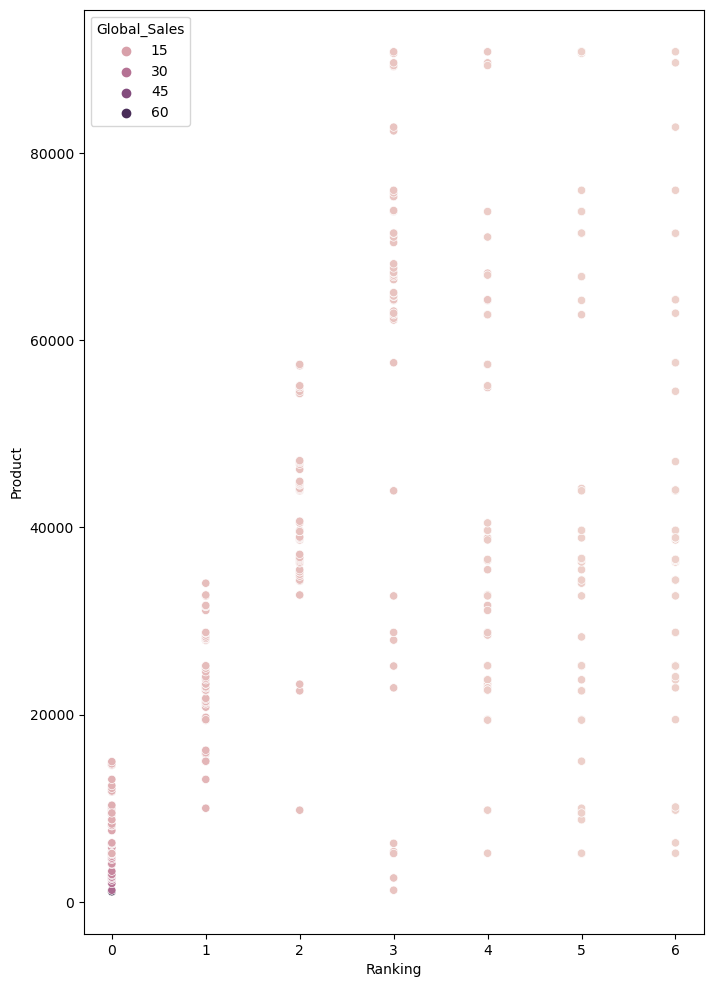

In [136]:
 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = sales, x = 'Ranking_Bracket', y = 'product2', hue = 'Global_Sales')
plt.xlabel('Ranking')
plt.ylabel('Product')

Clearly there is a relationship but it's hard to pin down. The datapoints to the left of the red line appear to follow a pattern. It's aftr ranking bracket passes 3 that the relationship breaks down (or changes)

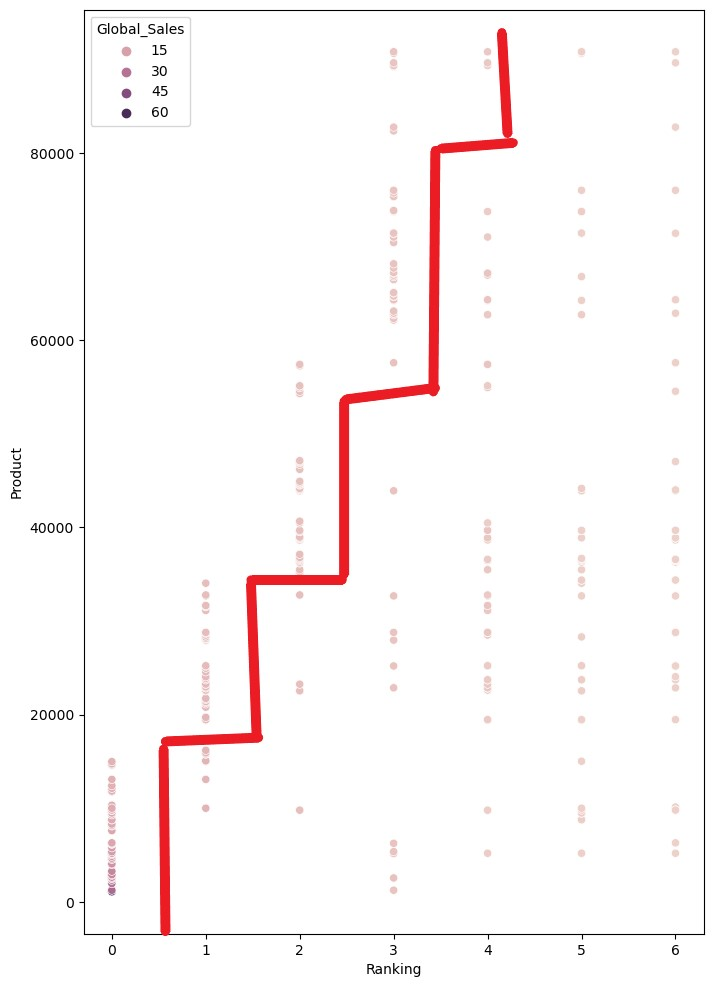

This has not worked as we have more rows than there should be. 

In [137]:
# Create dummmy columns for the categorical variables. 
# Methodically create these and check for correlations, and list as these are accomplished:
# Platform, Puplisher, Genre
sales_dummies = sales
sales_dummies = pd.get_dummies(sales_dummies, columns = ['Genre'])
sales_dummies.head()

,Ranking,product,Platform,Year,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,...,Genre_Fighting,Genre_Misc,Genre_Platform,Genre_Puzzle,Genre_Racing,Genre_Role-Playing,Genre_Shooter,Genre_Simulation,Genre_Sports,Genre_Strategy
0,1,107,Wii,2006.0,Nintendo,34.02,23.80,67.85,1,1070,...,0,0,0,0,0,0,0,0,1,0
1,2,123,NES,1985.0,Nintendo,23.85,2.94,33.00,2,1230,...,0,0,1,0,0,0,0,0,0,0
2,3,195,Wii,2008.0,Nintendo,13.00,10.56,29.37,1,1950,...,0,0,0,0,1,0,0,0,0,0
3,4,231,Wii,2009.0,Nintendo,12.92,9.03,27.06,1,2310,...,0,0,0,0,0,0,0,0,1,0
4,5,249,GB,1996.0,Nintendo,9.24,7.29,25.72,1,2490,...,0,0,0,0,0,1,0,0,0,0


In [138]:
sales_dummies.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2796409510.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sales_dummies.corr()


,Ranking,product,Year,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Genre_Action,...,Genre_Fighting,Genre_Misc,Genre_Platform,Genre_Puzzle,Genre_Racing,Genre_Role-Playing,Genre_Shooter,Genre_Simulation,Genre_Sports,Genre_Strategy
Ranking,1.000000,0.080607,0.100726,-0.343823,-0.357466,-0.391028,0.301073,0.080647,6.586547e-01,0.121878,...,-0.072502,-0.049483,-0.142966,-0.062197,0.061946,-0.119828,0.039661,-0.045722,0.137838,-2.458735e-02
product,0.080607,1.000000,-0.015476,-0.404786,-0.389425,-0.440905,0.028304,1.000000,4.004892e-01,0.087944,...,0.020278,-0.063631,-0.030696,-0.011362,-0.080735,0.094438,-0.188811,-0.010440,0.132987,6.881867e-02
Year,0.100726,-0.015476,1.000000,-0.325654,-0.007736,-0.243983,0.497386,-0.015451,2.711876e-01,0.028751,...,-0.096107,0.119087,-0.346690,-0.345693,-0.139307,0.032405,0.186501,0.030682,0.248831,-6.341566e-02
NA_Sales,-0.343823,-0.404786,-0.325654,1.000000,0.705524,0.934946,-0.373564,-0.404814,-6.593905e-01,-0.094946,...,0.015634,0.029759,0.165994,0.085564,0.018194,-0.024072,0.015276,-0.043691,-0.089247,1.474218e-03
EU_Sales,-0.357466,-0.389425,-0.007736,0.705524,1.000000,0.877558,-0.234370,-0.389451,-6.354823e-01,-0.059258,...,-0.034303,0.030101,0.016683,-0.024314,0.046996,0.017358,-0.068906,0.051115,0.065015,-1.645918e-02
Global_Sales,-0.391028,-0.440905,-0.243983,0.934946,0.877558,1.000000,-0.391164,-0.440936,-7.373872e-01,-0.097531,...,0.013232,0.023217,0.127883,0.058906,0.045776,0.054213,-0.065413,-0.001092,-0.053482,-7.377428e-03
count,0.301073,0.028304,0.497386,-0.373564,-0.234370,-0.391164,1.000000,0.028351,5.297290e-01,0.021772,...,-0.140840,-0.041053,-0.262490,-0.107069,-0.041053,-0.218643,0.088421,0.013710,0.487437,-5.520546e-02
product2,0.080647,1.000000,-0.015451,-0.404814,-0.389451,-0.440936,0.028351,1.000000,4.005388e-01,0.087945,...,0.020271,-0.063633,-0.030708,-0.011367,-0.080737,0.094427,-0.188806,-0.010440,0.133010,6.881594e-02
Ranking_Bracket,0.658655,0.400489,0.271188,-0.659391,-0.635482,-0.737387,0.529729,0.400539,1.000000e+00,0.096267,...,-0.066482,-0.033063,-0.173325,-0.047487,-0.038573,-0.119131,0.028219,-0.015600,0.231110,3.058605e-17
Genre_Action,0.121878,0.087944,0.028751,-0.094946,-0.059258,-0.097531,0.021772,0.087945,9.626739e-02,1.000000,...,-0.075300,-0.136530,-0.171774,-0.075300,-0.136530,-0.179285,-0.248203,-0.092765,-0.200915,-2.635590e-02


corr() with dummies: Not useful so far but might be useful later if further insights indicate such, eg when we separate the dataframe into subsets (eg publishers), looking at distribution. From the boxplots above, it looks like Publisher would be a good way to break the data up as the data for each lokos reasonably normal  (at least with that view): the Nintendo outlier wold of course need to be managed.

In [139]:
# Create subsets of the data based on Publisher. (although can try with various columns if time)
publishers = sales['Publisher'].unique()

globals()

for publisher in publishers: 
    globals()[str(publisher) + '_df'] = sales[sales['Publisher'] == publisher]

# View a test df. 
Nintendo_df.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0


In [140]:
# View list of publihsers.
print(publishers)

['Nintendo' 'Microsoft Game Studios' 'Take-Two Interactive'
 'Sony Computer Entertainment' 'Activision' 'Ubisoft' 'Bethesda Softworks'
 'Electronic Arts' 'Sega' 'SquareSoft' 'Atari' '505 Games' 'Capcom'
 'GT Interactive' 'Konami Digital Entertainment'
 'Sony Computer Entertainment Europe' 'Square Enix' 'LucasArts'
 'Virgin Interactive' 'Warner Bros. Interactive Entertainment'
 'Universal Interactive' 'Eidos Interactive' 'RedOctane'
 'Namco Bandai Games']


In [141]:
# Remove known outlier from teh Nintendo_df
Nintendo_df = Nintendo_df[Nintendo_df['Global_Sales']<60]
Nintendo_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87 entries, 1 to 258
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Ranking          87 non-null     int64  
 1   product          87 non-null     int64  
 2   Platform         87 non-null     object 
 3   Year             87 non-null     float64
 4   Genre            87 non-null     object 
 5   Publisher        87 non-null     object 
 6   NA_Sales         87 non-null     float64
 7   EU_Sales         87 non-null     float64
 8   Global_Sales     87 non-null     float64
 9   count            87 non-null     int64  
 10  product2         87 non-null     int32  
 11  Ranking_Bracket  87 non-null     int64  
dtypes: float64(4), int32(1), int64(4), object(3)
memory usage: 8.5+ KB


<Axes: xlabel='Global_Sales', ylabel='Count'>

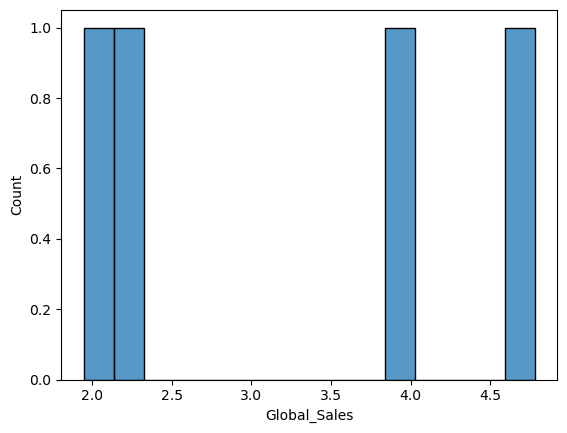

In [142]:
# Determine the normal distribution of the df. 
sns.histplot(data = LucasArts_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

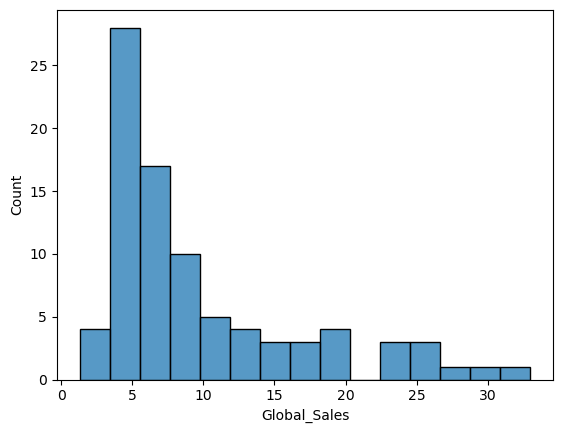

In [143]:
# Determine the normal distribution of the df. 
sns.histplot(data = Nintendo_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

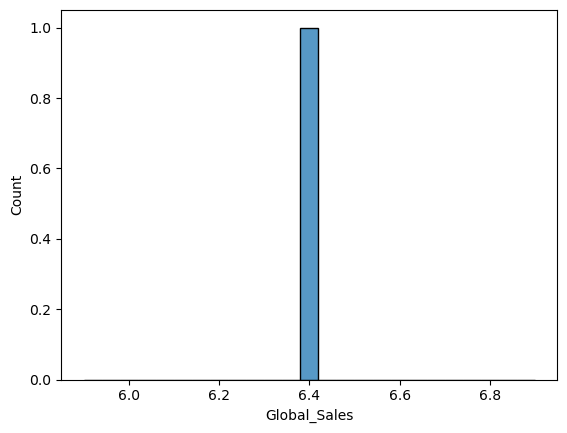

In [144]:
# Definitely not normally distributed. Continue with plotting other Publisher dfs to determine if Nintendo is an anomaly. 


# Determine the normal distribution of the df. 
sns.histplot(data = Atari_df, x = 'Global_Sales', bins = 25)

<Axes: xlabel='Global_Sales', ylabel='Count'>

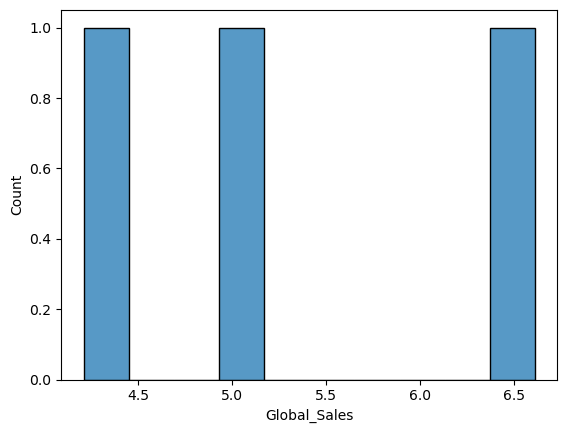

In [145]:
# Determine the normal distribution of the df. 
sns.histplot(data = Sega_df, x = 'Global_Sales', bins = 10)

<Axes: xlabel='Global_Sales', ylabel='Count'>

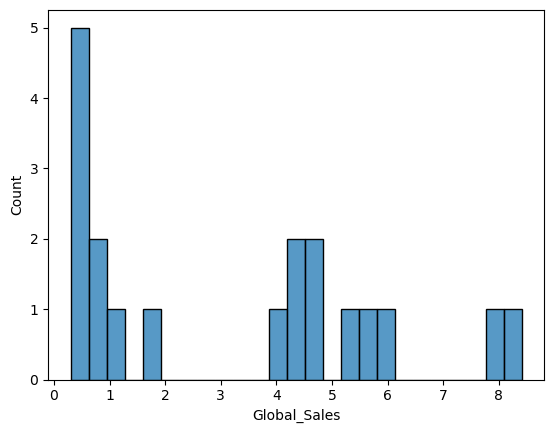

In [146]:
# Determine the normal distribution of the df. 
sns.histplot(data = Ubisoft_df, x = 'Global_Sales', bins = 25)

Having explored a few publisher's data in historgrams, we can already see that the data is not normally distributed. 
Explore other columns from teh sales df, eg Year. 




In [147]:
# Create subsets of the data based on Genre.
genres = sales['Genre'].unique()

globals()

for genre in genres: 
    globals()[str(genre) + '_df'] = sales[sales['Genre'] == genre]

# View a test df. 
Shooter_df.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
9,10,326,NES,1984.0,Shooter,Nintendo,22.08,0.52,23.21,1,3260,0
29,30,876,X360,2011.0,Shooter,Activision,7.40,3.51,12.10,4,8760,0
31,32,948,X360,2010.0,Shooter,Activision,7.93,3.06,12.00,5,9480,0
33,34,978,PS4,2015.0,Shooter,Activision,4.73,4.76,11.68,5,9780,0
34,35,979,PS3,2012.0,Shooter,Activision,4.09,4.82,11.50,4,9790,0


<Axes: xlabel='Global_Sales', ylabel='Count'>

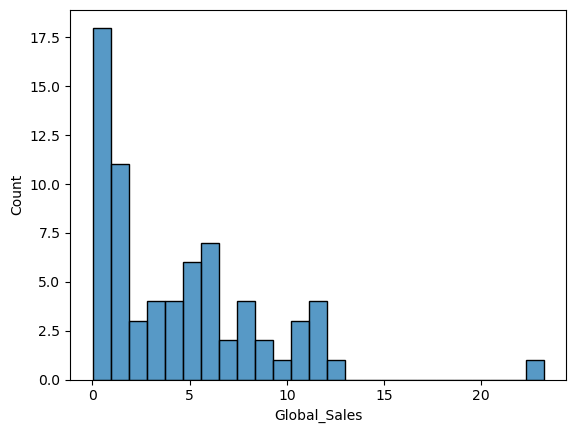

In [148]:
# Determine the normal distribution of the df. 
sns.histplot(data = Shooter_df, x = 'Global_Sales', bins = 25)

In [149]:
# What if we remove Nintendo? 

<Axes: xlabel='Global_Sales', ylabel='Count'>

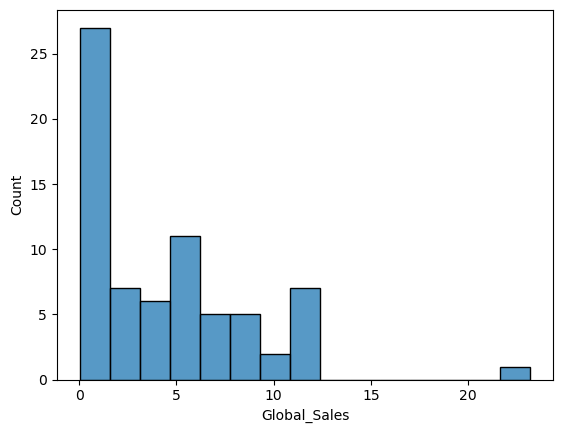

In [150]:
# Determine the normal distribution of the df. 
sns.histplot(data = Shooter_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

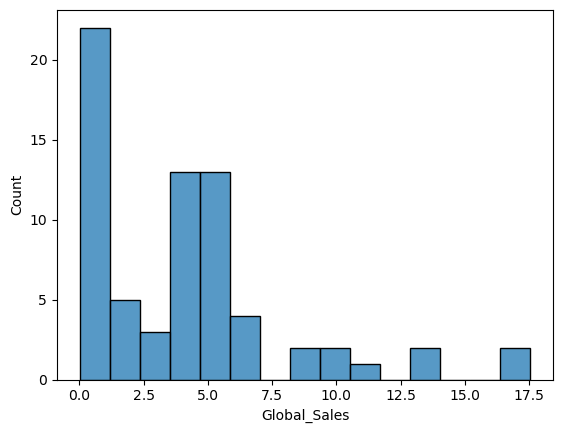

In [151]:
# Determine the normal distribution of the df. 
sns.histplot(data = Action_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

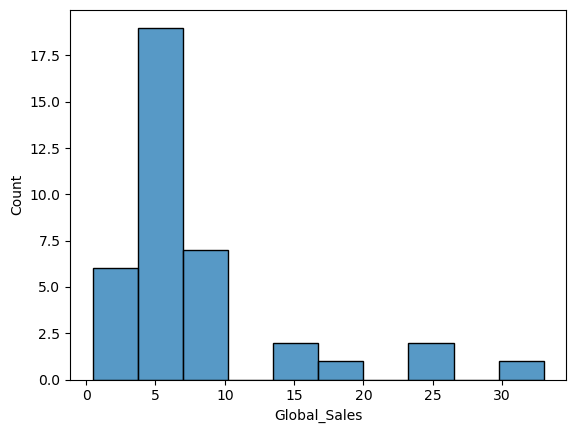

In [152]:
# Determine the normal distribution of the df. 
sns.histplot(data = Platform_df, x = 'Global_Sales', bins = 10)

In [153]:
# They are perhaps more normally distrubuted than the Publishre dfs but they are generally all right tailed. 

In [154]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 352 entries, 0 to 351
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Ranking          352 non-null    int64  
 1   product          352 non-null    int64  
 2   Platform         352 non-null    object 
 3   Year             350 non-null    float64
 4   Genre            352 non-null    object 
 5   Publisher        352 non-null    object 
 6   NA_Sales         352 non-null    float64
 7   EU_Sales         352 non-null    float64
 8   Global_Sales     352 non-null    float64
 9   count            352 non-null    int64  
 10  product2         352 non-null    int32  
 11  Ranking_Bracket  352 non-null    int64  
dtypes: float64(4), int32(1), int64(4), object(3)
memory usage: 31.8+ KB


Not really getting around the issue of the right tails. 

In [159]:
# Create subsets of the data based on Ranking Bracket
rbs = sales['Ranking_Bracket'].unique()

globals()

for rb in rbs: 
    globals()['rb_' + str(rb) + '_df'] = sales[sales['Ranking_Bracket'] == rb]

# Print a test df
rb_0_df.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0


<Axes: xlabel='Global_Sales', ylabel='Count'>

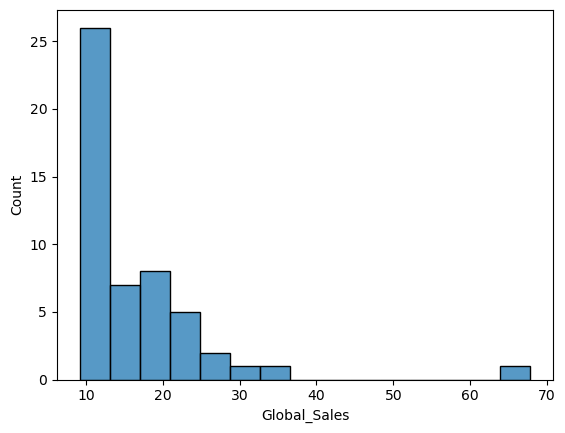

In [160]:
# Determine the normal distribution of the df. 
sns.histplot(data = rb_0_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

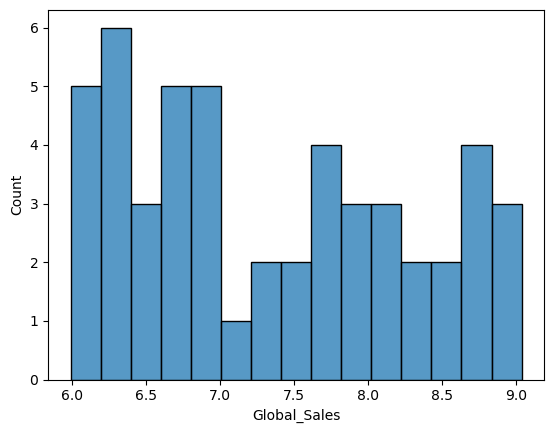

In [161]:
# Determine the normal distribution of the df. 
sns.histplot(data = rb_1_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

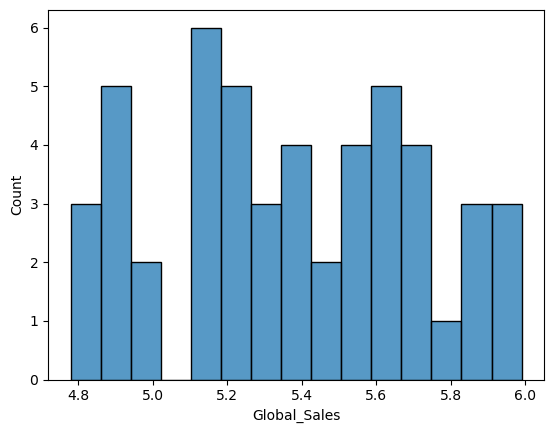

In [162]:
# Determine the normal distribution of the df. 
sns.histplot(data = rb_2_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

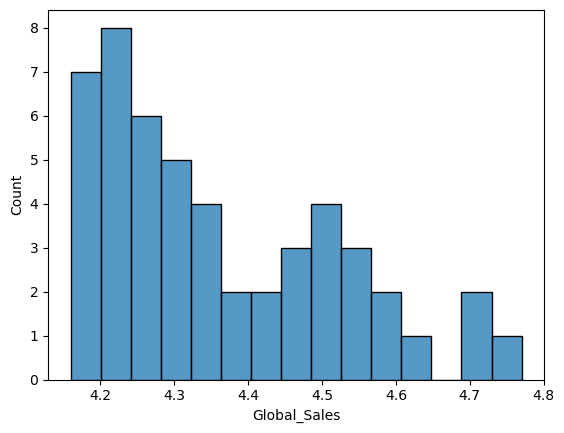

In [163]:
# Determine the normal distribution of the df. 
sns.histplot(data = rb_3_df, x = 'Global_Sales', bins = 15)

We've looked at various ways to subset the data, but it remains consistently, heavily right tailed. The last option to try is Platform

In [164]:
# Create subsets of the data based on Ranking Bracket
platforms = sales['Platform'].unique()

globals()

for platform in platforms: 
    globals()[str(platform) + '_df'] = sales[sales['Platform'] == platform]

# Print the platforms.
print(platforms)

['Wii' 'NES' 'GB' 'DS' 'X360' 'PS3' 'PS2' 'SNES' 'GBA' '3DS' 'PS4' 'N64'
 'PS' 'XB' 'PC' '2600' 'PSP' 'XOne' 'GC' 'WiiU' 'GEN' 'PSV']


<Axes: xlabel='Global_Sales', ylabel='Count'>

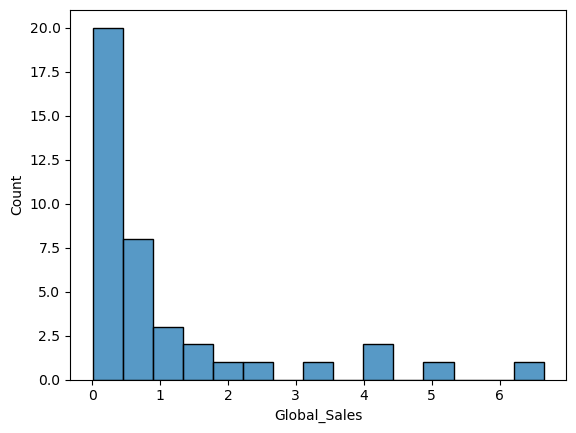

In [165]:
# Determine the normal distribution of the df. 
sns.histplot(data = PC_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

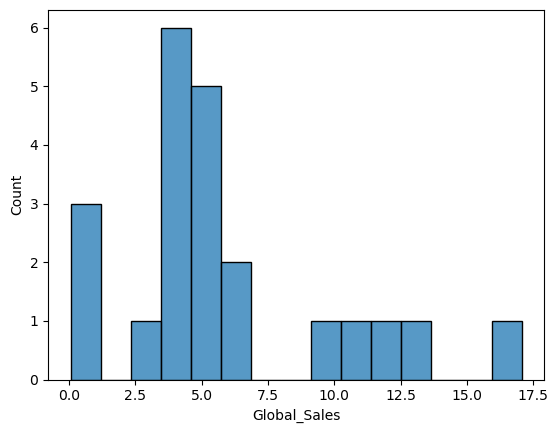

In [166]:
# Determine the normal distribution of the df. 
sns.histplot(data = PS2_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

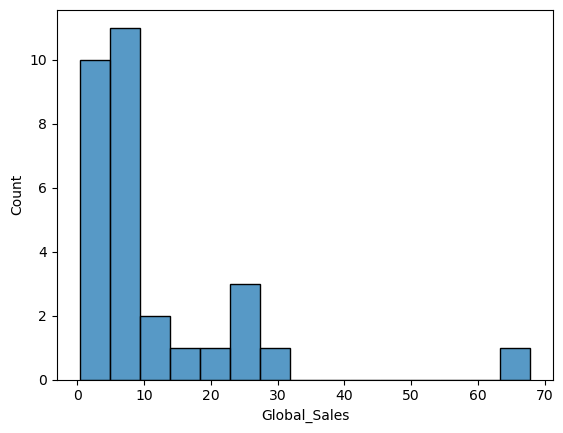

In [167]:
# Determine the normal distribution of the df. 
sns.histplot(data = Wii_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

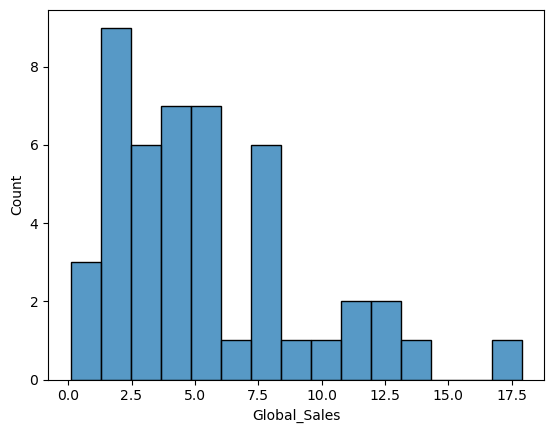

In [168]:
# Determine the normal distribution of the df. 
sns.histplot(data = X360_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

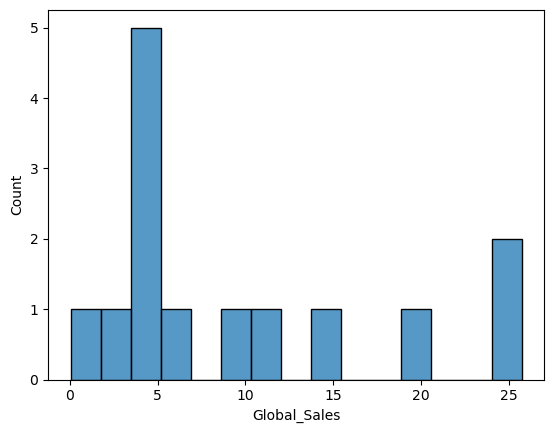

In [169]:
# Determine the normal distribution of the df. 
sns.histplot(data = GB_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

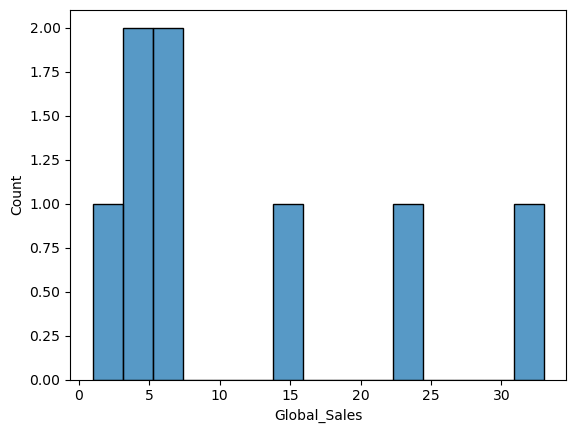

In [170]:
# Determine the normal distribution of the df. 
sns.histplot(data = NES_df, x = 'Global_Sales', bins = 15)

<Axes: xlabel='Global_Sales', ylabel='Count'>

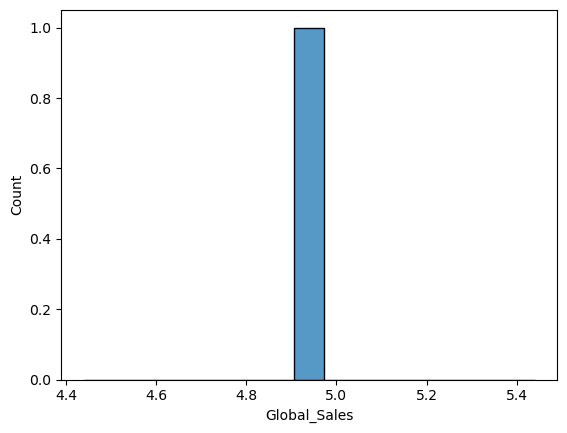

In [171]:
# Determine the normal distribution of the df. 
sns.histplot(data = GEN_df, x = 'Global_Sales', bins = 15)

This seems, at this stage, to be the best way (ie the best of a bad lot) to subset the data to access more normal distributions of sales. But the issues remain, so we will need to look at transforming the data to make it behave more 'normally'

In [172]:
# Is it possible the sales data is normally distrubuted when viewed across the different markets? 
# Create a new column which is Other_Sales (GLobal - (us + eu)

sales['Other_Sales'] = sales['Global_Sales'] - (sales['EU_Sales'] + sales['NA_Sales'])
sales.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Other_Sales
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0,10.03
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0,6.21
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0,5.81
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0,5.11
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0,9.19


In [173]:
# plot the regiona sales data (togehter)
# Melt the data
sales_data = pd.melt(sales, value_vars = ['Other_Sales', 'NA_Sales', 'EU_Sales'],\
                     var_name  = 'Region', value_name = 'Sales_Figure')
sales_data.head()

,Region,Sales_Figure
0,Other_Sales,10.03
1,Other_Sales,6.21
2,Other_Sales,5.81
3,Other_Sales,5.11
4,Other_Sales,9.19


<Axes: xlabel='Sales_Figure', ylabel='Count'>

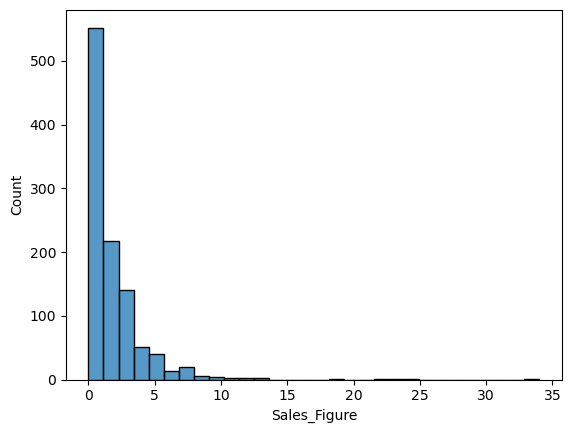

In [174]:
# Determine the normal distribution of the df. 
sns.histplot(data = sales_data, x = 'Sales_Figure', bins = 30)

<Axes: xlabel='Publisher', ylabel='Global_Sales'>

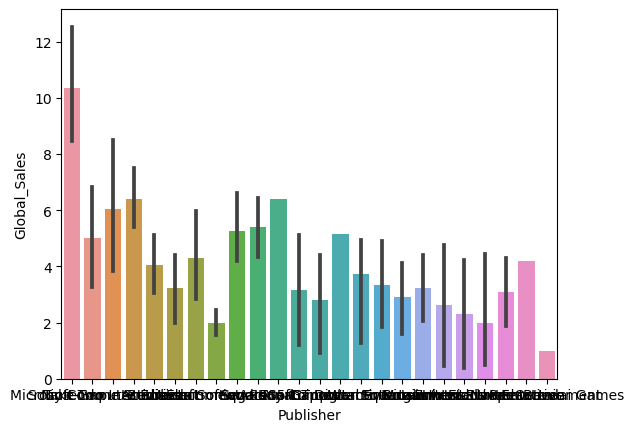

In [175]:
# Can we plot the sales for each publisher - will that give us a normal distribution? 
sns.barplot(data = sales, x = 'Publisher', y = 'Global_Sales')

In [176]:
# Can we me make a df that is publishers and their sales data, and put that on a histogram? 
publishers_df = sales.groupby('Publisher')['Global_Sales'].sum().reset_index()
publishers_df.head()

,Publisher,Global_Sales
0,505 Games,12.71
1,Activision,211.21
2,Atari,6.40
3,Bethesda Softworks,25.88
4,Capcom,16.86


<Axes: xlabel='Global_Sales', ylabel='Count'>

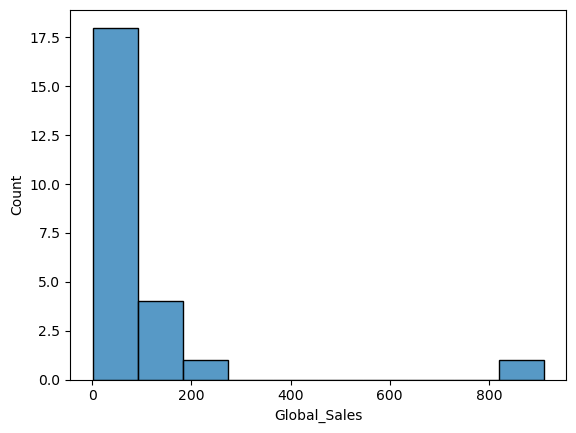

In [177]:
# Determine the normal distribution of the df. 
sns.histplot(data = publishers_df, x = 'Global_Sales', bins = 10)

We've explored the dataset very thoroughly and from all sorts of angles - and at this stage it looks like this is not a normal distribution, no matter how we subset the data. Partly this is because we aren't ever going to have negative sales. 

What we're going to do to transform this dataset is to create false values which are on the negative side of the sales ledger. Common sense indicates that in situations where there are visualations that apppear to be just one side of the dataset, we're effectively, and actually quite simply, missing the left side of the data  (albeit imagined). 


We will mirror the dataset by taking the negative of each existing value. There are other ways to transform data (such as power transform - which we will also look at , and is discussed here: https://www.datasciencecentral.com/how-to-differentiate-dataset-if-it-has-normal-distribution/)

## Mirroring the data

In [178]:
# Create a copy of the dataset
sales_columns = ['Global_Sales', 'Other_Sales', 'EU_Sales', 'NA_Sales']

# Create a negative values dataset. 
copied_data = sales.copy()
mirrored_data = sales.copy()
mirrored_data[sales_columns] = -mirrored_data[sales_columns]

# Concatenate the orginal and mirrored data
normalised_df = pd.concat([copied_data, mirrored_data], ignore_index = True)
normalised_df.tail()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Other_Sales
699,13227,3436,PC,2003.0,Racing,Electronic Arts,-0.00,-0.03,-0.04,5,34364,6,-0.01
700,13734,629,PC,2003.0,Action,Take-Two Interactive,-0.00,-0.02,-0.03,2,6291,6,-0.01
701,13886,4399,PC,2003.0,Shooter,Microsoft Game Studios,-0.01,-0.02,-0.03,2,43991,6,-0.00
702,15784,4702,PC,2007.0,Shooter,Microsoft Game Studios,-0.00,-0.01,-0.02,2,47021,6,-0.01
703,16096,1012,PC,2002.0,Action,Take-Two Interactive,-0.00,-0.01,-0.01,2,10121,6,-0.00


<Axes: xlabel='Global_Sales', ylabel='Count'>

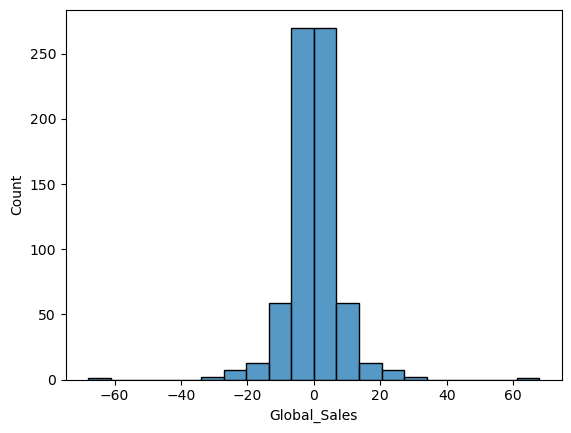

In [179]:
# Plot again to see if we have acheived a normal distribution, before saving the dataset as a csv to be accessed in R etc. 
# Determine the normal distribution of the df. 
sns.histplot(data = normalised_df, x = 'Global_Sales', bins = 20)

<Axes: xlabel='Global_Sales', ylabel='Count'>

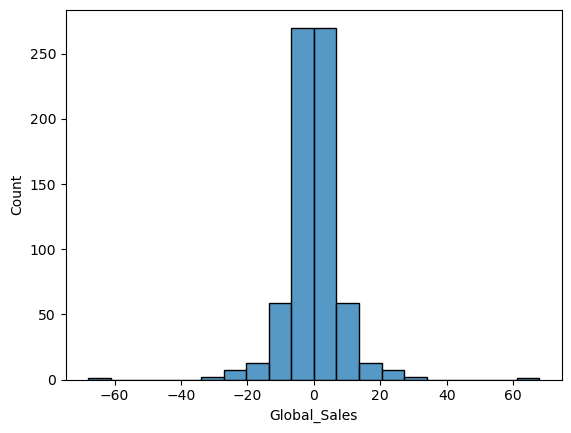

In [180]:
sns.histplot(data = normalised_df, x = 'Global_Sales', bins = 20)

<Axes: xlabel='Global_Sales', ylabel='Count'>

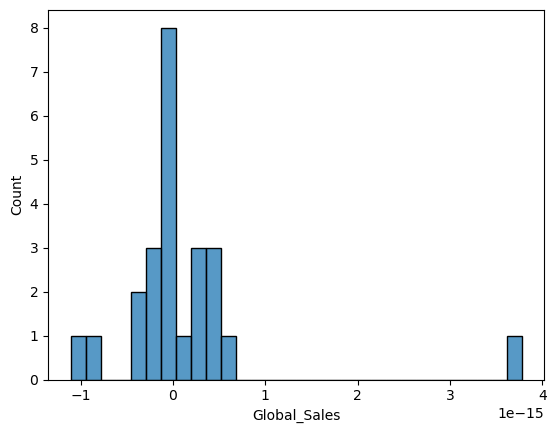

In [181]:
# Look at individual publihser data, using this mirrored data. 
publishers_df1 = normalised_df.groupby('Publisher')['Global_Sales'].sum().reset_index()
publishers_df1.head()

sns.histplot(data = publishers_df1, x = 'Global_Sales', bins = 30)

In [182]:
platform_df1 = normalised_df.groupby('Platform')['Global_Sales'].sum().reset_index()
platform_df1.head()

,Platform,Global_Sales
0,2600,0.000000e+00
1,3DS,2.775558e-17
2,DS,1.096345e-15
3,GB,1.165734e-15
4,GBA,-1.110223e-16


<Axes: xlabel='Global_Sales', ylabel='Count'>

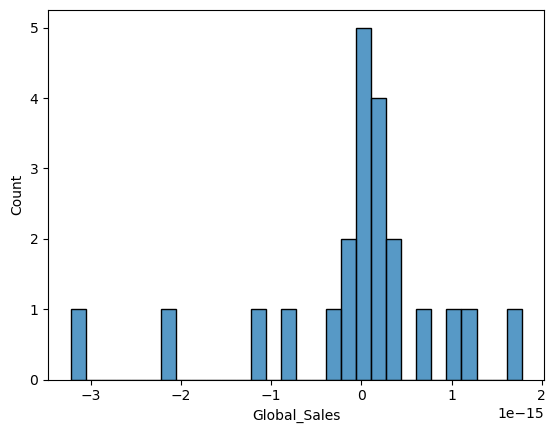

In [183]:
sns.histplot(data = platform_df1, x = 'Global_Sales', bins = 30)

That doesn't make a lot of sense: The data is not symmetrical. 

It would be useful to know more about the relationship between product 2 and product columns, because it is so highly likely that if they aren't miscoded, then they are different platforms but the same game. So customers may have preferences for specific platforms, for example. eg diff incomes.  which is something we can tell the marketing department.But we won't be able to show that using the data where there is more than one product2 for the proiduct 1. 

Let's make two dataframes then: one which has only one item per product number, and one which has more than one.  


In [184]:
sales.head()

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Other_Sales
0,1,107,Wii,2006.0,Sports,Nintendo,34.02,23.80,67.85,1,1070,0,10.03
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0,6.21
2,3,195,Wii,2008.0,Racing,Nintendo,13.00,10.56,29.37,1,1950,0,5.81
3,4,231,Wii,2009.0,Sports,Nintendo,12.92,9.03,27.06,1,2310,0,5.11
4,5,249,GB,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1,2490,0,9.19


In [185]:
# Makes two copies of the sales df. One where there are duplicates in the product column. 
# sales_count_1 will be the one that can be joined with the appropriate rows in the reviews df. 
# Sales_count_multiple will need close examination to fully understand what's happening between product1 and product2. 

sales_count1 = sales[sales['count'] ==1].copy()
sales_count_multiple = sales[sales['count'] !=1].copy()

In [186]:
sales_count1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103 entries, 0 to 194
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Ranking          103 non-null    int64  
 1   product          103 non-null    int64  
 2   Platform         103 non-null    object 
 3   Year             103 non-null    float64
 4   Genre            103 non-null    object 
 5   Publisher        103 non-null    object 
 6   NA_Sales         103 non-null    float64
 7   EU_Sales         103 non-null    float64
 8   Global_Sales     103 non-null    float64
 9   count            103 non-null    int64  
 10  product2         103 non-null    int32  
 11  Ranking_Bracket  103 non-null    int64  
 12  Other_Sales      103 non-null    float64
dtypes: float64(5), int32(1), int64(4), object(3)
memory usage: 10.9+ KB


In [187]:
sales_count_multiple.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 249 entries, 1 to 351
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Ranking          249 non-null    int64  
 1   product          249 non-null    int64  
 2   Platform         249 non-null    object 
 3   Year             247 non-null    float64
 4   Genre            249 non-null    object 
 5   Publisher        249 non-null    object 
 6   NA_Sales         249 non-null    float64
 7   EU_Sales         249 non-null    float64
 8   Global_Sales     249 non-null    float64
 9   count            249 non-null    int64  
 10  product2         249 non-null    int32  
 11  Ranking_Bracket  249 non-null    int64  
 12  Other_Sales      249 non-null    float64
dtypes: float64(5), int32(1), int64(4), object(3)
memory usage: 26.3+ KB


Unfortunately sales_count_1 is only 100 rows long, and that is quite a small dataset. But it may align with more rows when it is joined with the appropriate rows of the reviews column. Explore this concatenation. The reason for trying this again is that the next part of this exploration is about groups of customers that the marketing team can target. So finding out how cutomers feel about certain products, including their platforms, genres, etc, is useful. Unfortunately it's likely that any groups we can identify eg females / males, income levels, education, etc, will be VERY small, so we may not be able to pursue this line of inquiry meaningfullly, for long. 

# Return to concatenation when the sentiment scores are complete? 

In [188]:







# Concatenate the two dfs. 
sales_reviews = pd.merge(sales_count1, reviews,  on = 'product', how = 'inner')
sales_reviews.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1027 entries, 0 to 1026
Data columns (total 24 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   Ranking          1027 non-null   int64   
 1   product          1027 non-null   int64   
 2   Platform         1027 non-null   object  
 3   Year             1027 non-null   float64 
 4   Genre            1027 non-null   object  
 5   Publisher        1027 non-null   object  
 6   NA_Sales         1027 non-null   float64 
 7   EU_Sales         1027 non-null   float64 
 8   Global_Sales     1027 non-null   float64 
 9   count            1027 non-null   int64   
 10  product2         1027 non-null   int32   
 11  Ranking_Bracket  1027 non-null   int64   
 12  Other_Sales      1027 non-null   float64 
 13  gender           1027 non-null   object  
 14  age              1027 non-null   int64   
 15  income           1027 non-null   float64 
 16  score            1027 non-null   int64   


The concatenated data frame is about half the lenght of the original reviews df. With 1000 rows it's still quite large. Let's see if the age has a simliar distribution to the original reviews df, by plotting histograms consecutively. 

<Axes: xlabel='age', ylabel='Count'>

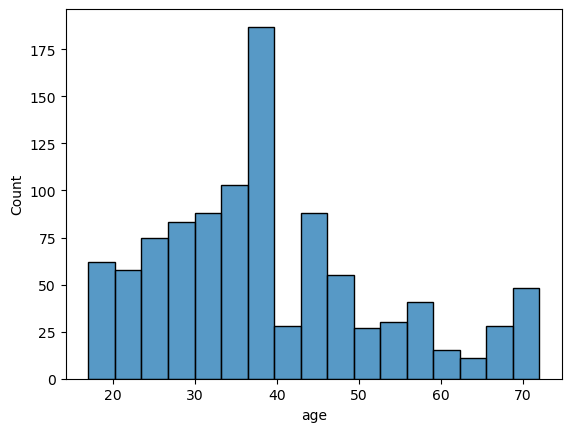

In [189]:
sns.histplot(data = sales_reviews, x = 'age')

<Axes: xlabel='age', ylabel='Count'>

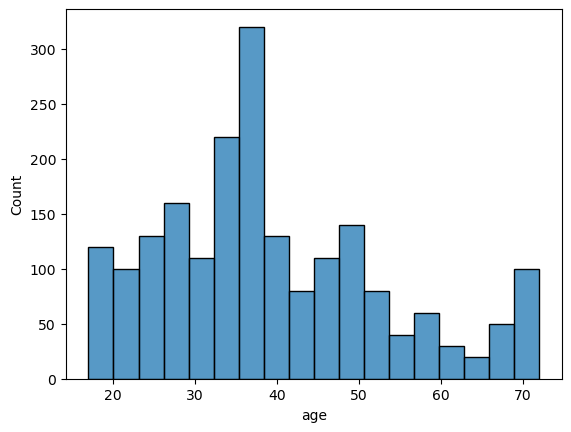

In [190]:
sns.histplot(data = reviews, x = 'age')

The datasets aren't exactly the same but they're fairly similar. The 40-44 year olds are one group in partcular that is not represented well in the sales_reviews dataset. 

Unfortunately, the sizes of these groups (in the sales_reviews df) are just too small. Perhaps best to look at other columns



<Axes: xlabel='income_bracket', ylabel='Count'>

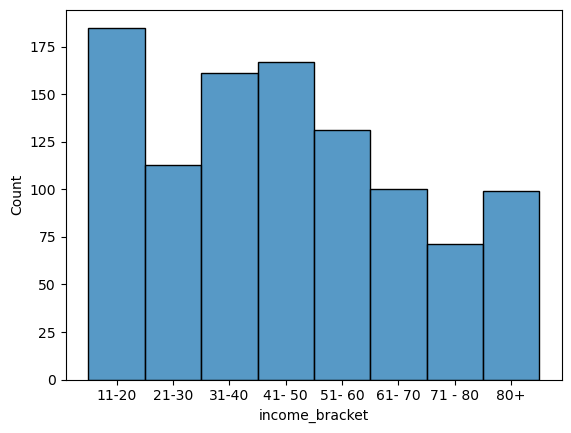

In [191]:
sns.histplot(data = sales_reviews, x = 'income_bracket')

<Axes: xlabel='income_bracket', ylabel='Count'>

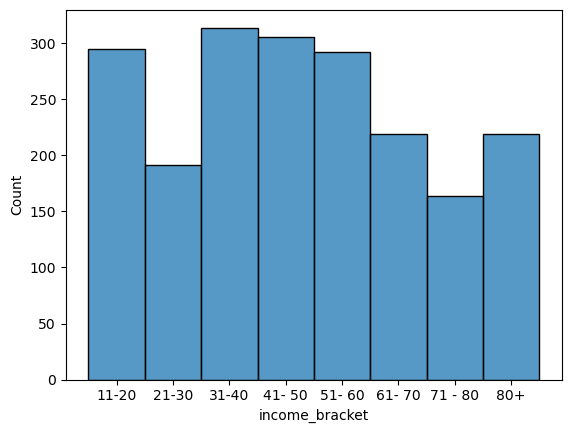

In [192]:
sns.histplot(data = reviews, x = 'income_bracket')

These groups are bigger, and they all sit at about half the size of the full dataset. 

<Axes: xlabel='education', ylabel='Count'>

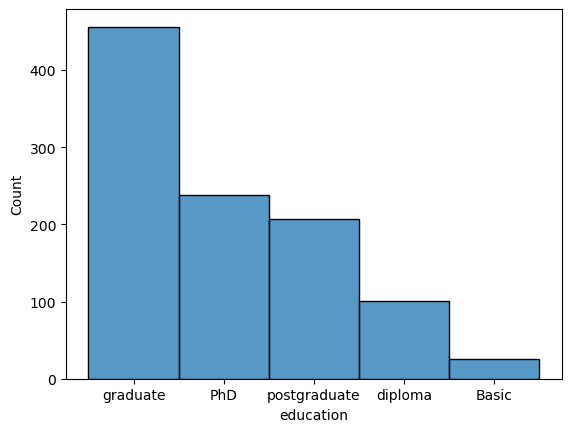

In [193]:
sns.histplot(data = sales_reviews, x = 'education')

<Axes: xlabel='education', ylabel='Count'>

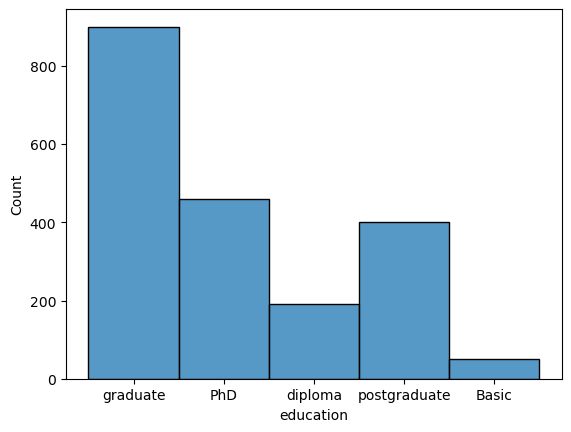

In [194]:
sns.histplot(data = reviews, x = 'education')

Education has about the same dsitribtion, and the groups are not necessarily too small. 

# Return to concatenation (above) when the sentiment scores are complete?

In [195]:
# What can we find out abut the duplicate products? 

sales_count_multiple.head(30)

,Ranking,product,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Other_Sales
1,2,123,NES,1985.0,Platform,Nintendo,23.85,2.94,33.00,2,1230,0,6.21
5,6,254,GB,1989.0,Puzzle,Nintendo,19.02,1.85,24.81,2,2540,0,3.94
16,17,515,PS3,2013.0,Action,Take-Two Interactive,5.75,7.60,17.55,5,5150,0,4.20
17,18,518,PS2,2004.0,Action,Take-Two Interactive,7.73,0.33,17.06,4,5180,0,9.00
18,19,535,SNES,1990.0,Platform,Nintendo,10.48,3.08,16.90,2,5350,0,3.34
22,23,624,NES,1988.0,Platform,Nintendo,7.82,2.82,14.17,2,6240,0,3.53
23,24,515,X360,2013.0,Action,Take-Two Interactive,7.90,4.35,13.43,5,5151,0,1.18
24,25,629,PS2,2002.0,Action,Take-Two Interactive,6.90,4.50,13.24,2,6290,0,1.84
29,30,876,X360,2011.0,Shooter,Activision,7.40,3.51,12.10,4,8760,0,1.19
31,32,948,X360,2010.0,Shooter,Activision,7.93,3.06,12.00,5,9480,0,1.01


In [196]:
# It appears that the games have the sames publisher and genre, but have different platforms. 

# Let's look at which platform does better across these 

mean_sales_platforms = sales_count_multiple.groupby('Platform')['Global_Sales'].mean().reset_index()
mean_sales_platforms.head(40)

,Platform,Global_Sales
0,2600,6.400000
1,3DS,1.506667
2,DS,2.242222
3,GB,7.042000
4,GBA,1.875000
5,GC,0.623750
6,N64,5.480000
7,NES,11.346000
8,PC,0.887632
9,PS,4.670000


# Reviews dataset

In [197]:
# DO they get a higher score if they review well - answer this later.

In [198]:
print(reviews.columns)

Index(['gender', 'age', 'income', 'score', 'points', 'education', 'product',
       'review', 'summary', 'score_bracket', 'income_bracket', 'customer_id'],
      dtype='object')


In [199]:
# Add a column for income bracket.
bins = [0, 20, 40, 60, 80, 120]
labels = ['0 -20', '21-40','41- 60','61 - 80', '80+']
reviews['income_bracket'] = pd.cut(reviews['income'], bins = bins, labels = labels, right = False )
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5


## 4. Save the DataFrame as a CSV file

In [200]:
# Create a CSV file as output.
reviews.to_csv('reviews.csv', index = False)

In [201]:
# Import new CSV file with Pandas.
reviews = pd.read_csv("reviews.csv")

# View DataFrame.
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5


## 5. Linear regression

The overall goal here is to look at increasing overall sales. Turtle Games wants to know how customers accumulate loyalty points, but that is subsidiary to increasing sales. So to start with I'm going to make the loyalty points the independent variable, and sales (score) the dependent variable.

In [202]:
reviews.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\4098900293.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews.corr()


,age,income,score,points,product,customer_id
age,1.000000,-0.005708,-0.224334,-0.042445,0.003081,0.061429
income,-0.005708,1.000000,0.005612,0.616065,0.305309,0.497067
score,-0.224334,0.005612,1.000000,0.672310,-0.001649,-0.020297
points,-0.042445,0.616065,0.672310,1.000000,0.183600,0.270348
product,0.003081,0.305309,-0.001649,0.183600,1.000000,0.173149
customer_id,0.061429,0.497067,-0.020297,0.270348,0.173149,1.000000


None of the correlations are perfect, positive or otherwise. But the one that has the most correlation with sales (score) is points, and the income in turn has a strong correlation with points. 

Product has a fairly low score against most variables, but with that in mind there is a relatively high correlation between income and product, but product, though an integer does not align with any numerical scale that we understand yet. 

Similarly, age doesn't have a strong impact on many factors (ie .2 is the max) but within that context, there is a relatively high correlation between age and score. 

I'm going to proceed methodically through the process and add now a (or some) visualiation(s) on a scatterplot. 

In [203]:
# Rename the column headers.
reviews = reviews.rename(columns = {'score': 'spend_score', 'points':'loyalty_points'})

# View column names.
print(reviews.columns)

Index(['gender', 'age', 'income', 'spend_score', 'loyalty_points', 'education',
       'product', 'review', 'summary', 'score_bracket', 'income_bracket',
       'customer_id'],
      dtype='object')


Why use OLS? - put this in the report.

### 5a) spending vs points

In [204]:
# Independent variable.
x = reviews['spend_score']
# Dependent variable.
y = reviews['loyalty_points']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'
# Create a second variable to store the ols()method. 
test = ols(f, data = reviews).fit()

# Print the regression table. 
test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.452
Model:                            OLS   Adj. R-squared:                  0.452
Method:                 Least Squares   F-statistic:                     1648.
Date:                Mon, 24 Jul 2023   Prob (F-statistic):          2.92e-263
Time:                        22:17:54   Log-Likelihood:                -16550.
No. Observations:                2000   AIC:                         3.310e+04
Df Residuals:                    1998   BIC:                         3.312e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -75.0527     45.931     -1.634      0.102    -165.129      15.024
x             33.0617      0.814     40.595      0.000      31.464      34.659
==============================================================================
Omnibus:                      126.554   Durbin-Watson:                   1.191
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              260.528
Skew:                           0.422   Prob(JB):                     2.67e-57
Kurtosis:                       4.554   Cond. No.                         122.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [205]:
# Extract the estimated parameters.
print("Parameters:", test.params)

# Extract the standard errors.
print("Standard Errors:", test.bse)

# Extract the predicted values.
print("Predicted values:", test.predict())

Parameters: Intercept   -75.052663
x            33.061693
dtype: float64
Standard Errors: Intercept    45.930554
x             0.814419
dtype: float64
Predicted values: [1214.35337415 2602.94449102  123.31749662 ... 2933.56142361  453.93442921
  189.44088314]


In [206]:
# Set the X coefficient and the constant to generate the regression table.
y_pred = (-75.052663) + 33.061693 * reviews['spend_score']

# View the output.
y_pred

0       1214.353364
1       2602.944470
2        123.317495
3       2470.697698
4       1247.415057
           ...     
1995    2206.204154
1996     189.440881
1997    2933.561400
1998     453.934425
1999     189.440881
Name: spend_score, Length: 2000, dtype: float64

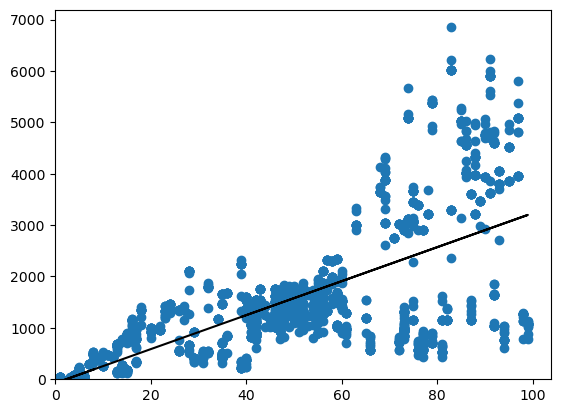

In [207]:
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred, color = 'black')

# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

**Observations and Insights (spend vs loyalty)**


 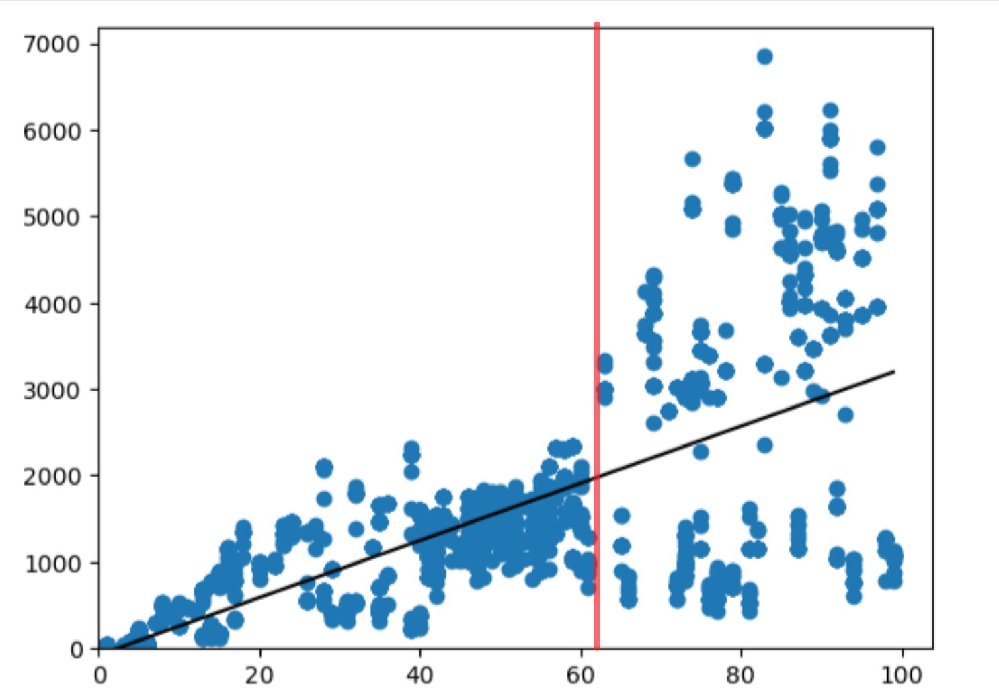
There are two main groups here: those who gain more / less than just over 60 points.  Roughly speaking the model fits fairly well for those under 60~ points. However above 60~ points the model is not fitting. The main reason for this is that under 60~ points the datapoints are fairly cohesive and generally  predictable - overall there is a pretty clear positive relationship between loyalty and points in this group, with discrepancies worthy of investigation, but minor compared to customers earning above 60~ points. The model absolutely does not fit to predict the relationship those above 60~ points. 

NEXT STEPS: Determine the exact score (eg 62?) that groups the customers into <60~ and >60~ groups. Run multiple regression on the >60~ group, and clustering. If time, run linear regression again on the same on the sub 60 group, and then multiple regression and clustering analysis, again if time. 

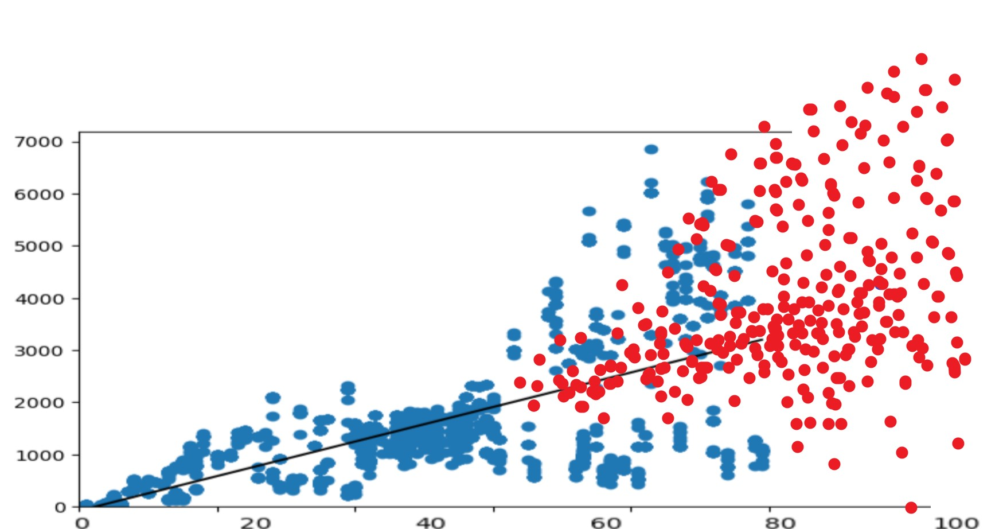

We should primarily keep in mind what the stakeholders wants. Here it is illustrated by imaginary (future speculative) red dots. 

Note first of all that the score (x-axis) is ammended for the purposes of this desmonstration: we are imagining that much higher sales are required to score 100. This in itself, as an aside, indicates that the customers' score should probably be refreshed / recalculated regualrly, if this is not already being done, and this is a recommendation that can be made to the company. Either that or the score scale should be extended beyond 100.

The main points to note, though, are that the new (imaginary) data points are all higher spending, and are also somewhat explained by the model. TG's primary focus is to increase sales. They would however like to understand how they can better manipulate sales, through the way they manage loyalty points. That's why the new (desired) red dots are somewhat clustered around the regression line: this reflects that TG wants to understand how to drive better sales. 

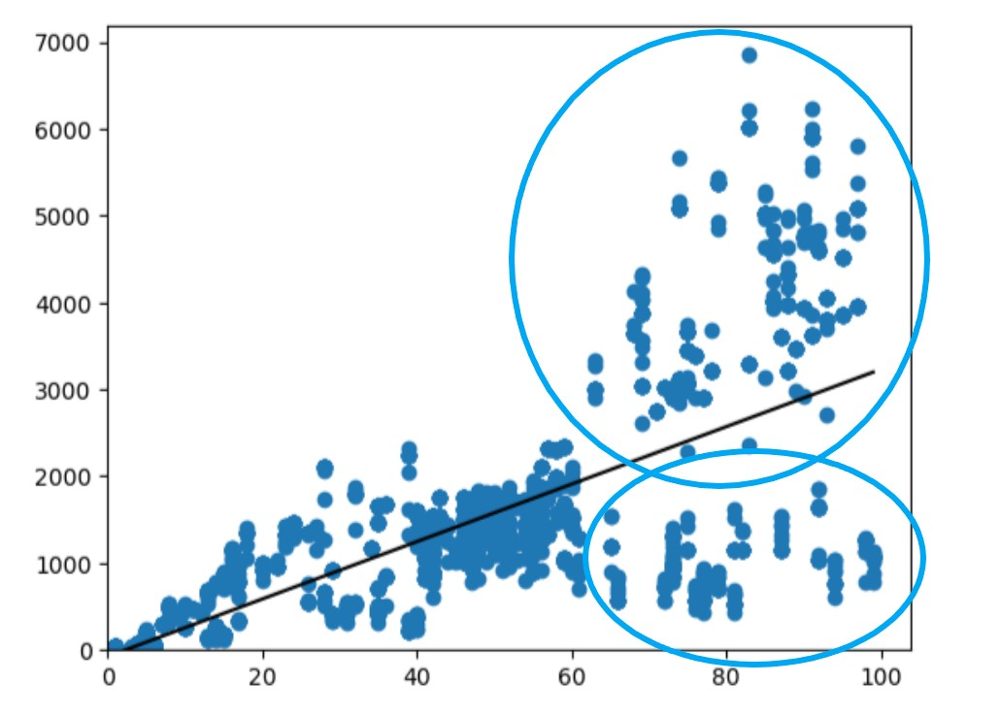


Looking again at what we currntly have: 
There are two broad subgroups of customers with more than 60~ points. 
- Those who are earning points and are spending well. 
> This group could be said to be responding somewhat as desired to the loyal points programme, or it cold be said that they are spending well regardless, and being rewarded for that 
- Those who are spending well but not earning points.  
> This group is spending well and not being rewarded.

If customers are not being adequately rewarded despite high spending, then they are probably not being encouraged to spend more (at least through the rewards programme). The high spending, low reward cohort may have capacity to spend more, if adequately rewarded. An assumption (to be avoided) would be that they have higher spending capacity. An analysis of their income may help determine this, either way. But the question does need to be considered: if they're spending high anwyay, then do they even need to be better included in the points programme? 

It would be helpful to determine the spending patterns of the customers and how they accumulate their score (which is slightly different from what the stakeholders have said they want to know, which is how customers accumulate points). The metadata indicates it is not a simple 1:1 relationship between purchase and score, but rather that purhcasing behaviour is also a factor. The exact words are here: 
> " A score is assigned to the customer by Turtle Games based on the customer’s spending nature and behaviour. The value ranges between 1 and 100."

Nature and behaviour are arguably the same thing. So the score is assigned by TG based on the customer's spending behavior. This could be how often they purchase, whether they are responsive to deals, and / or how large their purchases are. It is not necessarily any of those things. It could be desirable if those characteristics were articualted separately in the data - and we may find that in the other dataset when we get to it. 

Incidentally, the metadata on loyalty points is similarly problematic: 
> "A score based on the point value of the purchase,converting the monetary value to point value, and the point value of an action (purchase)." 

From the above, points could seem so intricately tied to spending behaviour, as to really being another version of a spending score.  The fact that there isn't a direct correlation between the two, indicates that there is a lot more going on, with both, and certainly for our purposes here, the mechanications behind loyalty points accumulation, are an important topic of investigation to continue. 

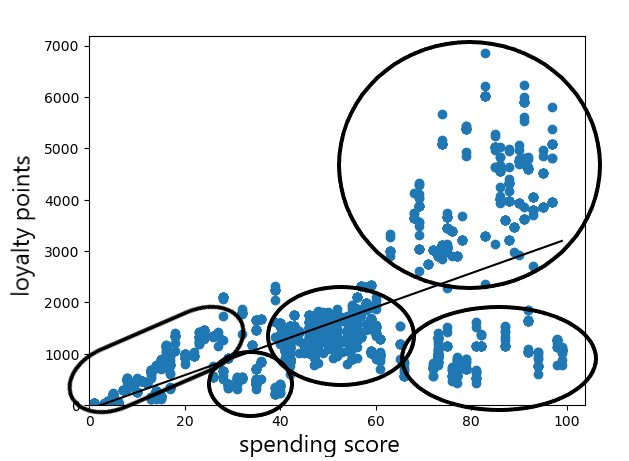
Another way of looking at the graph is this. But the issue with all of this is that score and points are not necessarily factors that we can tell the business about until a customer purchases. What we do want to tell them is something like, this new customer, with these demographics, will likely..... and you could enourage them to buy more by....

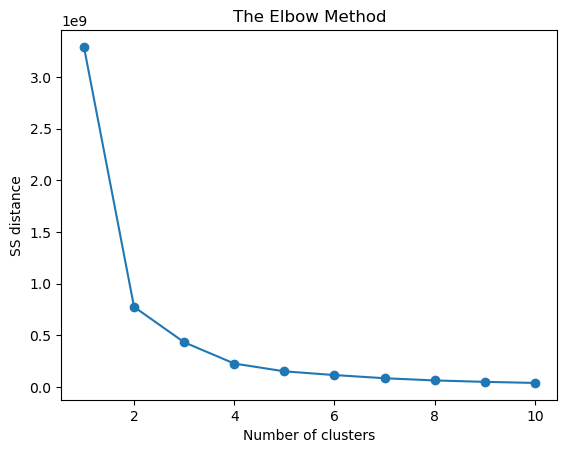

In [208]:
# Explore this relationship further (spend and points) with clustering. 
# Elbow and silhouette methods to determine the clusters. 

# Determine the number of clusters: Elbow method.

# Store the two columns in a variable. 
x = reviews[['loyalty_points', 'spend_score']]

# Import the KMeans class.
from sklearn.cluster import KMeans 

# Elbow chart for us to decide on the number of optimal clusters.
# Create an empty list (sum of squares)
ss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i,
                    init='k-means++',
                    max_iter=300,
                    n_init=10,
                    random_state=0)
    kmeans.fit(x)
    ss.append(kmeans.inertia_)

# Plot the elbow method.
plt.plot(range(1, 11),
         ss,
         marker='o')

# Insert labels and title.
plt.title("The Elbow Method")
plt.xlabel("Number of clusters")
plt.ylabel("SS distance")

plt.show()

C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_k

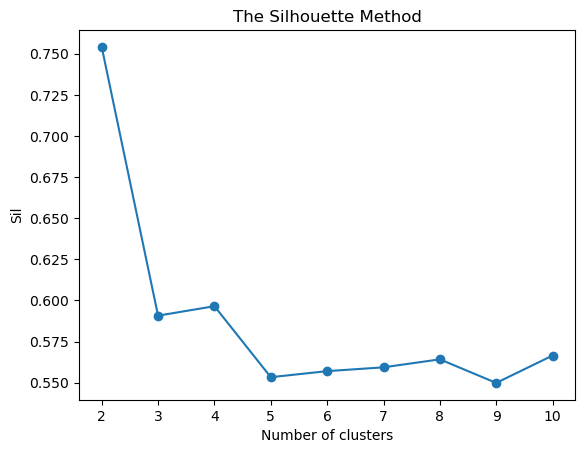

In [209]:
# Determine the number of clusters: Silhouette method.

# Import silhouette_score class from sklearn.
from sklearn.metrics import silhouette_score

# Find the range of clusters to be used using silhouette method.
sil = []
kmax = 10

for k in range(2, kmax+1):
    kmeans_s = KMeans(n_clusters=k).fit(x)
    labels = kmeans_s.labels_
    sil.append(silhouette_score(x,
                                labels,
                                metric='euclidean'))

# Plot the silhouette method.
plt.plot(range(2, kmax+1),
         sil,
         marker='o')

# Insert labels and title.
plt.title("The Silhouette Method")
plt.xlabel("Number of clusters")
plt.ylabel("Sil")

plt.show()

That's good news - I wanted there to be at least 4 and this is a strong indication (the secnod peak) that 4 is a good option. 

C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\AppData\Local\Temp\ipykernel_9840\594871837.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x['K-Means Predicted'] = clusters


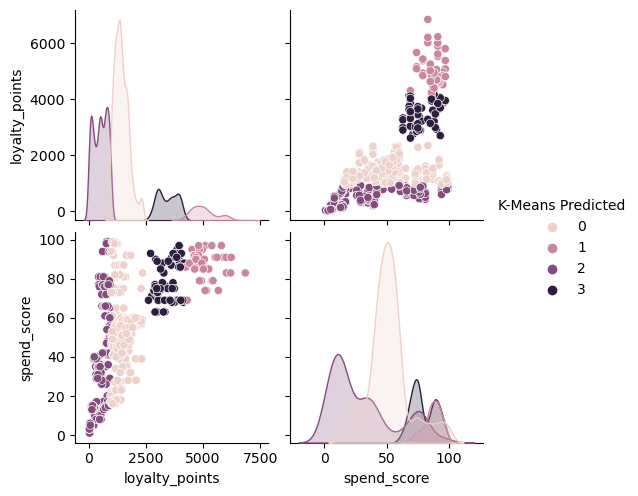

In [210]:
#Evaluate the modely with 4 clusters
kmeans = KMeans(n_clusters =4, 
                max_iter = 15000,
                init='k-means++',
                random_state=0).fit(x)

clusters = kmeans.labels_

x['K-Means Predicted'] = clusters

# Plot the predicted.
sns.pairplot(x,
             hue='K-Means Predicted',
             diag_kind= 'kde')

It's not looking good though, so far. Can always try to manually allocate cluster-like numbers based on the dimensions identified above, eg spend over 60. 

C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\AppData\Local\Temp\ipykernel_9840\3192403086.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x['K-Means Predicted'] = clusters


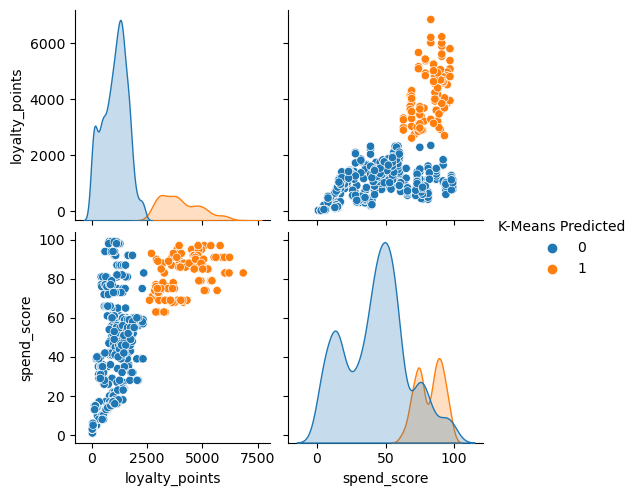

In [211]:
#Evaluate the modely with 4 clusters
kmeans = KMeans(n_clusters =2, 
                max_iter = 15000,
                init='k-means++',
                random_state=0).fit(x)

clusters = kmeans.labels_

x['K-Means Predicted'] = clusters

# Plot the predicted.
sns.pairplot(x,
             hue='K-Means Predicted',
             diag_kind= 'kde')

Two is slightly better, but it's all not the groups we were hoping to isolate. There's no point in isolating one group without isolating the others, as the comparison is key. 

Text(0, 0.5, 'points')

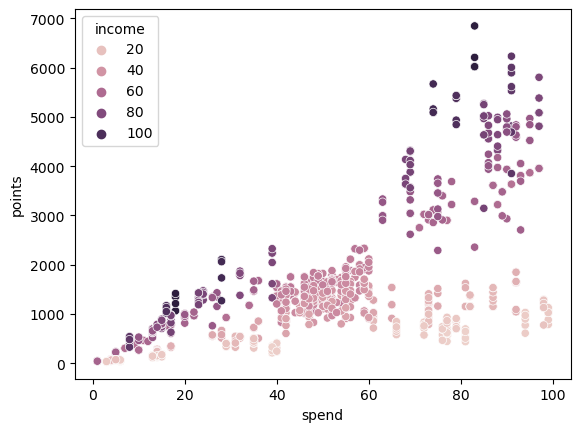

In [212]:
sns.scatterplot(data = reviews, x = 'spend_score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

POINTS ARE ACCUMULATED BY A COMBINATION OF SPENDING SCORE AND INCOME, with an anomaly in the 40-60 spend score range. 

Certain products may be influencing what the points are that customers are earning (and as we explore further, later, there may be different deals offered etc, that are outside our data lexicon, which may influence score)

Continue with this proces further. Subset the data by incme bracket. Then look for patterns in the corr() and other sets. 

Woudl be great to be able to concatenate the datasets before continuing further, in case the insughts are in the union of the two...

But will continue with the process of subsetting for clusters, manually, before exploring the income dynamic in the points / score nexus, further. 


Break the data up into spend score brackets to find out why customers with middle incomes seem to dominate teh 40-60 spend score range. 

In [213]:
# Create a new comumn in the new df, indicating the spend score bracket (0-40, 41-60, 61-100)
score_bins = [0, 40, 60, 100]
score_labels = ['0-40', '41-60', '61-100']

# Assign spend score values to their bracket in the new column. 
reviews['score_bracket'] = pd.cut(reviews['score'], bins = score_bins, labels = score_labels, include_lowest = True)
reviews.head()

KeyError: 'score'

In [ ]:
# Graph the scatterplot again with the score bracket as hue, to test the groups are captured correctly. 
sns.scatterplot(data = reviews, x = 'score', y = 'points', hue = 'score_bracket')
plt.xlabel('spend score')
plt.ylabel('points')

That's done what we wanted it to. Now we can look at what's happening in those three groups to see why the anomaly occurs in the 40-60 spend score, ie does it have the full range of income brackets? 

The spend score is obviously something that TG allocates based on customer's 'spening nature and behaviour', while customer income is not influenced at all by the company (unless they are an employee...but we can ignore that possibility for present purposes). 



In [214]:
# check the size of the score brackets (ie data)
score_counts = reviews['score_bracket'].value_counts()
print(score_counts)

41-60     718
0-40      649
61-100    633
Name: score_bracket, dtype: int64


In [215]:
# We can confirm that they are of a relatively even size. 
# Count how many of each income bracket is in each score_bracket (to see if each score_brakcet has rounghly the same
# income distribution).

# Group the data first
grouped_by_score = reviews.groupby(['score_bracket', 'income_bracket']).size().unstack()
grouped_by_score.head()

income_bracket,0 -20,21-40,41- 60,61 - 80,80+
score_bracket,,,,,
0-40,147.0,133.0,67.0,190.0,112.0
41-60,NaN,243.0,475.0,NaN,NaN
61-100,148.0,129.0,56.0,193.0,107.0


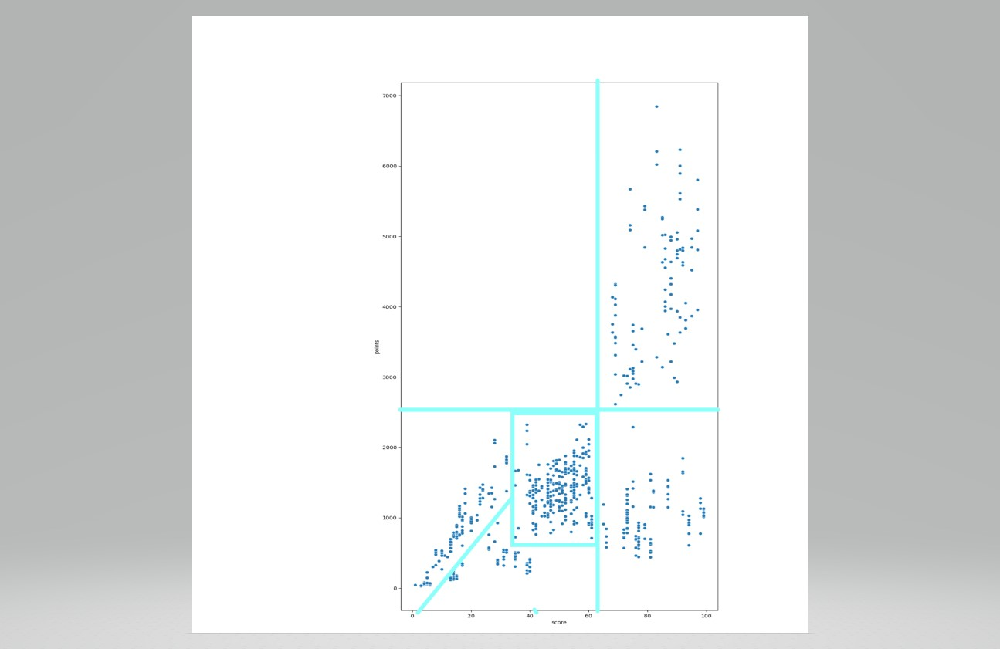


In [216]:
# subset the data manually
# Start with score over 60 to find out how that group is accessing those high points (we already know it's likely due to
# income but that in turn may mean they can access specific products, or even multiple purchases, if we can get to that)

over60 = reviews[reviews['spend_score']>60].copy()
over60.tail()


,gender,age,income,spend_score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
1986,Female,53,92.66,91,6232,postgraduate,977,Love playing Quiddler and this dictionary help...,Great Dictionary,61-100,80+,167
1990,Female,36,16.40,77,863,PhD,453,Fun for the family. Just make certain you agre...,"Sort of a card game equivalent of Scrabble, an...",61-100,0 -20,15
1993,Female,38,84.46,85,5019,graduate,263,Gift,Gift,61-100,80+,163
1995,Female,37,84.46,69,4031,PhD,977,The perfect word game for mixed ages (with Mom...,The perfect word game for mixed ages (with Mom,61-100,80+,161
1997,Male,34,92.66,91,5614,graduate,1012,Great game for all.........\nKeeps the mind ni...,Great Game,61-100,80+,316


Text(0, 0.5, 'points')

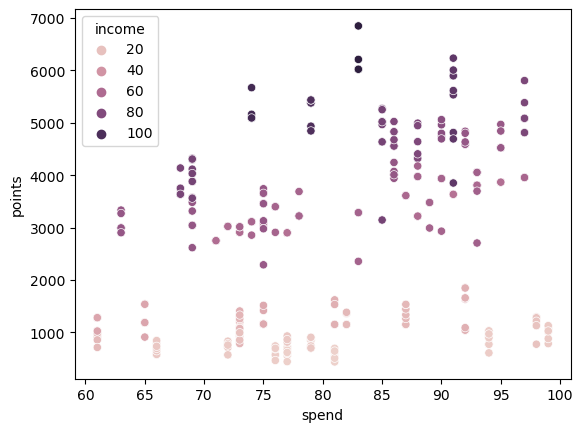

In [217]:
# Explore this dataset
sns.scatterplot(data =over60, x = 'spend_score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

WE can see here that it is going to be very easy to subdivide this further, and that very fact indicates that these are unique groups. Caution around the dataset size but continuing anyway. Could have done this with the original reviews dataset (more data).

Fascinatingly the points are obviously influenced by income. We don't yet know if this is because they are buying different 
products or just because the points calculation is determined both by score and income. Can look into this later.

In [218]:
over60_higherPoints = over60[over60['loyalty_points']>2000].copy()
over60_higherPoints.tail()

,gender,age,income,spend_score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
1984,Female,39,84.46,69,4114,PhD,263,"Yes, you can find obscure short words to use i...",Quiddler is much more fun to me just using com...,61-100,80+,161
1986,Female,53,92.66,91,6232,postgraduate,977,Love playing Quiddler and this dictionary help...,Great Dictionary,61-100,80+,167
1993,Female,38,84.46,85,5019,graduate,263,Gift,Gift,61-100,80+,163
1995,Female,37,84.46,69,4031,PhD,977,The perfect word game for mixed ages (with Mom...,The perfect word game for mixed ages (with Mom,61-100,80+,161
1997,Male,34,92.66,91,5614,graduate,1012,Great game for all.........\nKeeps the mind ni...,Great Game,61-100,80+,316


Text(0, 0.5, 'points')

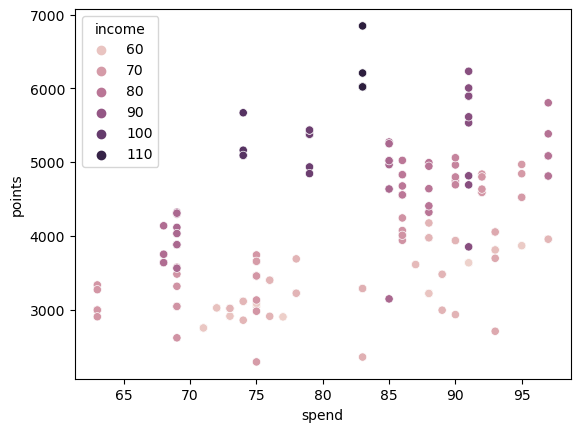

In [219]:
# Explore this dataset
sns.scatterplot(data =over60_higherPoints, x = 'spend_score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

Clearly the income starta is the most significant arguement here. Will pause this investigation and subset instead by income.  There are some anomalies (see below) which may help indicate what's happening here. 

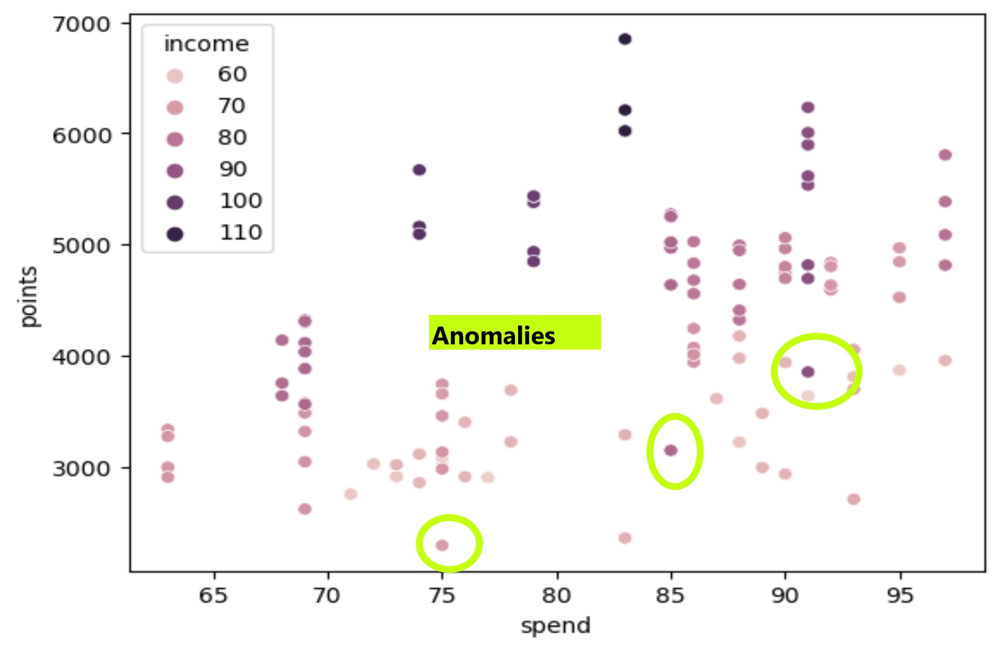

In [220]:
income_minus_20= reviews[reviews['income']<= 20].copy()
income_minus_20.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\485136909.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_minus_20.corr()


,age,income,spend_score,loyalty_points,product,customer_id
age,1.000000,0.171932,-0.386825,-0.215080,0.075926,0.159640
income,0.171932,1.000000,0.038172,0.325428,0.014458,0.248039
spend_score,-0.386825,0.038172,1.000000,0.925228,-0.028238,-0.096650
loyalty_points,-0.215080,0.325428,0.925228,1.000000,-0.010173,-0.064907
product,0.075926,0.014458,-0.028238,-0.010173,1.000000,-0.029241
customer_id,0.159640,0.248039,-0.096650,-0.064907,-0.029241,1.000000


In [221]:
# I was expecting a higher correlation with other factors. 

In [222]:
income_minus_20.describe()

,age,income,spend_score,loyalty_points,product,customer_id
count,295.000000,295.000000,295.000000,295.000000,295.000000,295.000000
mean,36.745763,15.874644,51.176271,509.996610,2485.671186,90.345763
std,13.770956,2.145086,32.506244,341.529996,2806.995579,89.378823
min,17.000000,12.300000,3.000000,25.000000,107.000000,0.000000
25%,25.000000,13.940000,15.000000,172.000000,785.500000,11.000000
50%,37.000000,15.580000,66.000000,506.000000,1459.000000,21.000000
75%,40.500000,17.220000,77.000000,733.500000,2462.500000,189.000000
max,70.000000,19.680000,99.000000,1292.000000,11086.000000,204.000000


I suspec the key info here will be what the sales data is assocuiated with this group. I'm really happy now tht I did proceed wtih concatenation of the two dfs as I can access that info now. The figure there refers to the mean sales figure for the products bought by this income bracket. It's not number of items sold but the average sales revenue for the cobination of products these customers are purchasing (restricted to those who have submitted reviews). 


Text(0, 0.5, 'points')

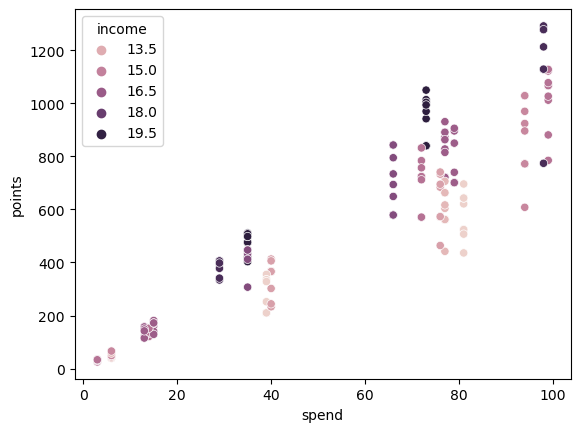

In [223]:
# Explore this dataset
sns.scatterplot(data =income_minus_20, x = 'spend_score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

This is really good because it indicates that even within this dataset there is a clear spread, so that the same or similar spend score is bringing about more points for customrs with higher incomes. 

There is a lot more to investigate with this dataeset but for now, continue to explore this specific dynamic with the other income brackets. Im especially interested in what happens between 40 and 60 spend score. It looks like this score actually isn't even available to peopel with this income range, which is really curious. 


The presence of anomalies, again, is noteable. 



In [224]:
# 21 to 40 income bracket
income_21_to_40 = reviews[reviews['income_bracket'] == '21-40'].copy()
income_21_to_40.head()


,gender,age,income,spend_score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
22,Female,44,20.50,5,75,postgraduate,1307,While my 3 year old son liked th tattos you'd ...,Not enough product,0-40,21-40,31
23,Male,33,20.50,73,982,PhD,535,There are only few tatoos so in one week they ...,Good product but...,61-100,21-40,205
24,Female,53,22.96,14,238,graduate,577,I'd buy again as a gift for a young kid obsess...,Temporary Tattoos were good gift.,0-40,21-40,35
25,Male,29,22.96,82,1150,postgraduate,618,My young son was thrilled to have tattoos just...,Huge Hit,61-100,21-40,211
26,Female,43,22.96,32,534,graduate,624,"Gorgeous, I love the book and the pictures are...",Gorgeous pictures!,0-40,21-40,35


In [225]:
income_21_to_40.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2710441348.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_21_to_40.corr()


,age,income,spend_score,loyalty_points,product,customer_id
age,1.000000,0.150154,-0.318457,0.001860,0.069881,0.072348
income,0.150154,1.000000,0.121467,0.562286,0.312175,0.226039
spend_score,-0.318457,0.121467,1.000000,0.804645,0.035056,0.168150
loyalty_points,0.001860,0.562286,0.804645,1.000000,0.161433,0.173951
product,0.069881,0.312175,0.035056,0.161433,1.000000,0.130727
customer_id,0.072348,0.226039,0.168150,0.173951,0.130727,1.000000


Text(0, 0.5, 'points')

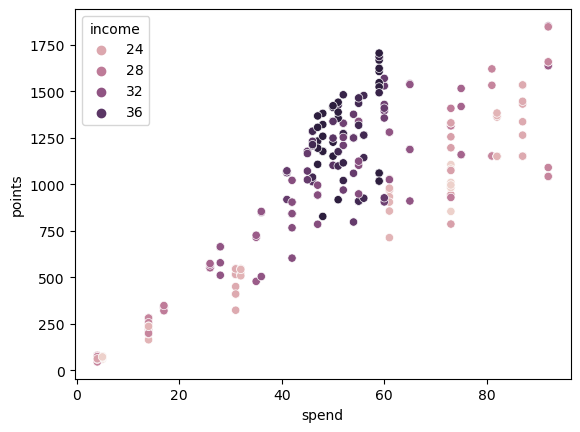

In [226]:
# scatter plot
sns.scatterplot(data =income_21_to_40, x = 'spend_score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

The anomaly htere is that the higer income bracket within this dataset, it accessing that point range between 40 and 60. 
Will dive quickly into this spend score range, then snap back to the income brakcets subsetting. 




In [227]:
# Rename the column headers.
reviews = reviews.rename(columns = {'remuneration (k£)': 'income', 'spend_score':'score'})


In [239]:
# 40 -60 points. 
score_40_to_60 = reviews[(reviews['score'] >=40) & (reviews['score'] <= 60)].copy()
score_40_to_60.head()

,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5
46,Female,49,32.80,55,1338,graduate,3667,MY HUSBAND LOVED IT. HE IS IN TO DRAGONS.,Five Stars,41-60,21-40,59
47,Female,29,32.80,47,942,postgraduate,3678,The dragons are really interesting and fun to ...,Five Stars,41-60,21-40,60
48,Female,29,32.80,42,842,graduate,2079,love it,Five Stars,41-60,21-40,59
49,Female,33,32.80,42,904,graduate,2114,cool,Four Stars,41-60,21-40,59


Text(0, 0.5, 'points')

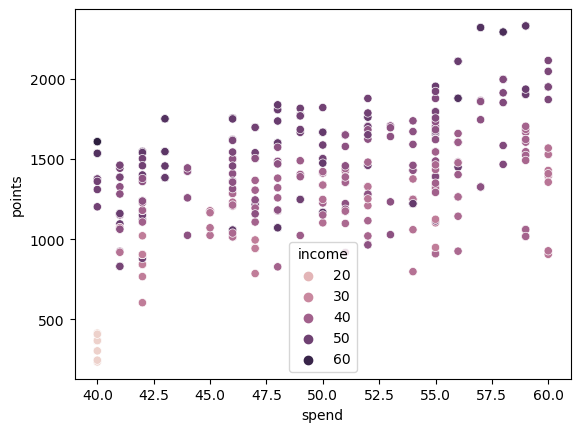

In [240]:
# scatter plot
sns.scatterplot(data = score_40_to_60, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

There seems more chaos here ('anomalies' except theyre' quite common)

We can show that though the income bracket for the whole dataset is (whatever it is) and compare either side of this band, this spend score band only has an income range of: 



In [241]:
points_40_to_60.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\3696913521.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  points_40_to_60.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,-0.031688,0.011957,0.329148,0.015316,0.095165
income,-0.031688,1.000000,-0.018102,0.636407,0.040481,0.236598
score,0.011957,-0.018102,1.000000,0.448743,0.031762,0.137773
loyalty_points,0.329148,0.636407,0.448743,1.000000,0.024536,0.133973
product,0.015316,0.040481,0.031762,0.024536,1.000000,0.019548
customer_id,0.095165,0.236598,0.137773,0.133973,0.019548,1.000000


Text(0, 0.5, 'points')

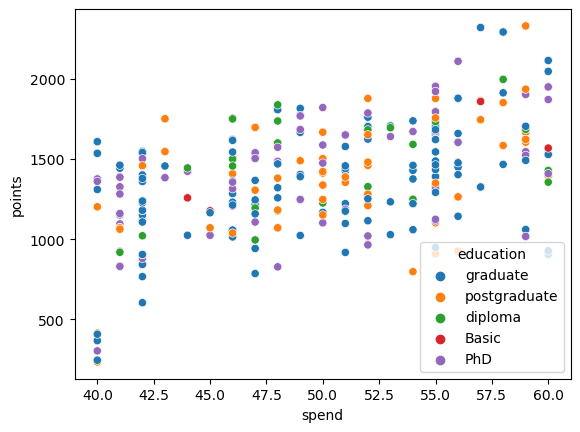

In [243]:
# scatter plot
sns.scatterplot(data =points_40_to_60, x = 'score', y = 'loyalty_points', hue = 'education')
plt.xlabel('spend')
plt.ylabel('points')

In [244]:
# But they are a diverse education range. 

Text(0, 0.5, 'points')

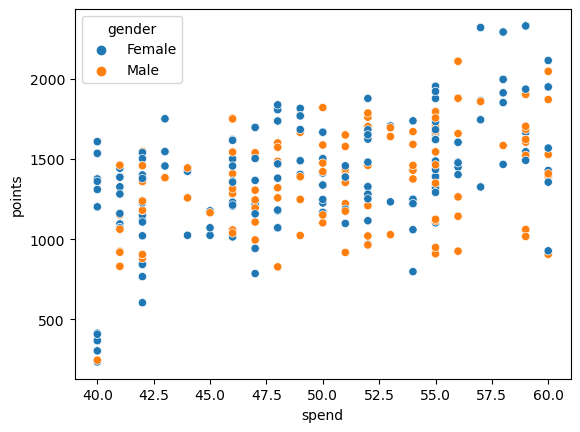

In [247]:
# scatter plot
sns.scatterplot(data =points_40_to_60, x = 'score', y = 'loyalty_points', hue = 'gender')
plt.xlabel('spend')
plt.ylabel('points')

In [1130]:
# and a fair mix of genders

In [250]:
# etc. So there's an almost artificical or arbitrary bottleneck here with this points range. 


# Now leaving that here for now (though there is more to explore), and back to income.
# 61 - 80 points. 
income_41_to_60 = reviews[reviews['income_bracket'] == '41- 60'].copy()
income_41_to_60.head()


,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
70,Male,72,40.18,55,1322,PhD,9530,AGE APPROPIATE. G'SON LOVED,Five Stars,41-60,41- 60,244
71,Female,45,40.18,42,1239,diploma,9560,"its a cute little book, but it's a tiny little...",Tiny,41-60,41- 60,81
72,Female,62,41.00,49,1404,postgraduate,9595,This is a tiny book. Only a few pages of stick...,"Worked for a trip, Only a few pages",41-60,41- 60,86
73,Female,62,41.00,56,1605,graduate,9596,This was a gift; have not heard how it worked ...,Four Stars,41-60,41- 60,85
74,Male,58,44.28,47,1504,graduate,9597,"Although $1.99 isn't much, it was disappointin...",Should be a buck at Dollar Store!,41-60,41- 60,251


Text(0, 0.5, 'points')

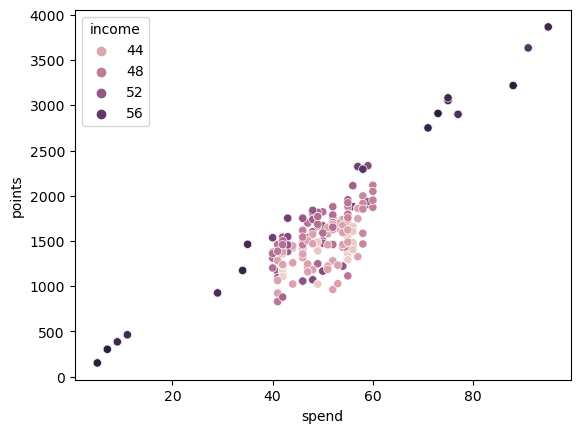

In [251]:
# scatter plot
sns.scatterplot(data =income_41_to_60, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

THAT's AMAZING!!!!!!!!!!!!!!

I love this graph. 


It just shows not only that if your income is anywhere between 41 and 60k inclusvie, your points are going to be within the 40 and 60 spend score band. This might be an issue with the data systems the copany has in place. Can we identify more exactly which income bracet this is by lowering the ceiling slightly (removing the spend score values outside the 40-60 band)? 


In [252]:
income_41_to_56 = reviews[(reviews['income'] >= 40) & (reviews['income'] <56)].copy()
income_41_to_56.head()

,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
70,Male,72,40.18,55,1322,PhD,9530,AGE APPROPIATE. G'SON LOVED,Five Stars,41-60,41- 60,244
71,Female,45,40.18,42,1239,diploma,9560,"its a cute little book, but it's a tiny little...",Tiny,41-60,41- 60,81
72,Female,62,41.00,49,1404,postgraduate,9595,This is a tiny book. Only a few pages of stick...,"Worked for a trip, Only a few pages",41-60,41- 60,86
73,Female,62,41.00,56,1605,graduate,9596,This was a gift; have not heard how it worked ...,Four Stars,41-60,41- 60,85
74,Male,58,44.28,47,1504,graduate,9597,"Although $1.99 isn't much, it was disappointin...",Should be a buck at Dollar Store!,41-60,41- 60,251


Text(0, 0.5, 'points')

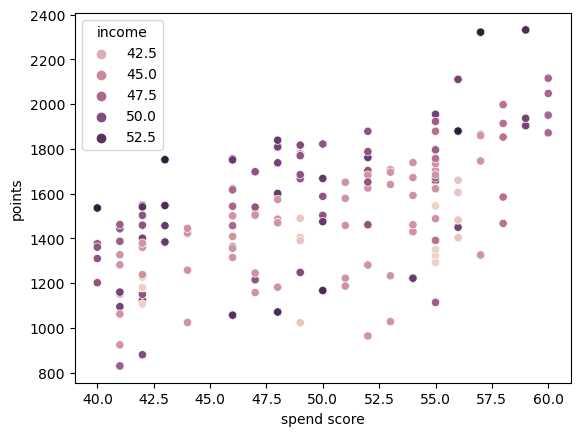

In [253]:
# scatter plot
sns.scatterplot(data = income_41_to_56, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend score')
plt.ylabel('points')


In [255]:
income_41_to_56.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\1908542917.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_41_to_56.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,-0.111293,0.028580,0.436537,0.022600,0.091065
income,-0.111293,1.000000,-0.102239,0.251778,-0.037174,0.057190
score,0.028580,-0.102239,1.000000,0.570353,-0.009035,0.044634
loyalty_points,0.436537,0.251778,0.570353,1.000000,-0.005002,-0.003323
product,0.022600,-0.037174,-0.009035,-0.005002,1.000000,-0.050103
customer_id,0.091065,0.057190,0.044634,-0.003323,-0.050103,1.000000


There's something quite chaotic about this dataset. in terms of where the income of the datapoints are verseus elsewhere in the larger dataset. That is, the lower income datapoints are up and down, as are the higher datapoints. That's corroborated by the correlation table. 

In [256]:
income_61_to_80 = reviews[reviews['income_bracket'] == '61 - 80'].copy()
income_61_to_80.head()


,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
138,Male,18,60.68,10,266,graduate,10270,My 4 year old loves this robot sticker book! Y...,Awesome little sticker book,0-40,61 - 80,275
139,Female,37,60.68,72,3022,graduate,10281,"My Grandson adores robots, I think Buzz Lighty...",Great idea...,61-100,61 - 80,122
140,Female,56,61.50,5,225,diploma,4470,I bought 8 of these for my 3 year old daughter...,Awesome sticker activity for the price,0-40,61 - 80,123
141,Male,34,61.50,93,3808,graduate,4477,My son is 5 and LOVES robots. He likes to chan...,robot lover,61-100,61 - 80,276
142,Female,32,62.32,40,1609,graduate,4491,Perfect for that long airplane ride for my alm...,Entertains A 5 Year Old Boy!,0-40,61 - 80,124


In [257]:
income_61_to_80.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\808299963.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_61_to_80.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.154792,-0.258289,-0.179592,-0.120888,0.041425
income,0.154792,1.000000,0.021728,0.160280,-0.145024,0.177103
score,-0.258289,0.021728,1.000000,0.978461,-0.019003,-0.171912
loyalty_points,-0.179592,0.160280,0.978461,1.000000,-0.045108,-0.138391
product,-0.120888,-0.145024,-0.019003,-0.045108,1.000000,-0.014460
customer_id,0.041425,0.177103,-0.171912,-0.138391,-0.014460,1.000000


Text(0, 0.5, 'points')

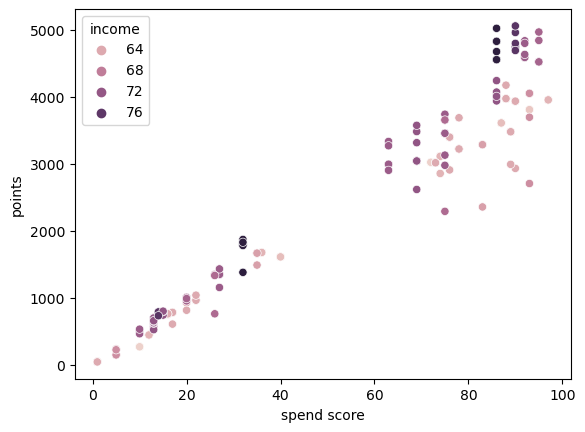

In [258]:
# scatter plot
sns.scatterplot(data = income_61_to_80, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend score')
plt.ylabel('points')

There again that strange dynamic of a gap in the spend score data! But even within this restructed dataset a clearer relationship between income / spend and points ie less chaotic than in the group above. 

In [259]:
income_81_plus = reviews[reviews['income_bracket'] == '80+'].copy()
income_81_plus.head()


,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
182,Male,44,80.36,15,881,PhD,6504,Incomplete kit! Very disappointing!,INCOMPLETE KIT!,0-40,80+,302
183,Female,29,80.36,88,4320,graduate,6507,Incomplete set. Was missing the bead eyes the ...,Incomplete,61-100,80+,152
184,Female,39,81.18,39,2235,PhD,3403,Nieces loved it.,Four Stars,0-40,80+,154
185,Male,32,81.18,97,5084,graduate,4390,Kit and instructions make easy to learn the pr...,Five Stars,61-100,80+,305
186,Female,53,82.82,24,1469,postgraduate,4399,Hard to put together.,"Cute idea, hard to do",0-40,80+,159


In [260]:
income_81_plus.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\905465360.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_81_plus.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.014845,-0.184198,-0.104430,0.006495,-0.170059
income,0.014845,1.000000,-0.053634,0.127381,-0.294792,0.302374
score,-0.184198,-0.053634,1.000000,0.966677,-0.002783,-0.041184
loyalty_points,-0.104430,0.127381,0.966677,1.000000,-0.063363,-0.018913
product,0.006495,-0.294792,-0.002783,-0.063363,1.000000,-0.118766
customer_id,-0.170059,0.302374,-0.041184,-0.018913,-0.118766,1.000000


Text(0, 0.5, 'points')

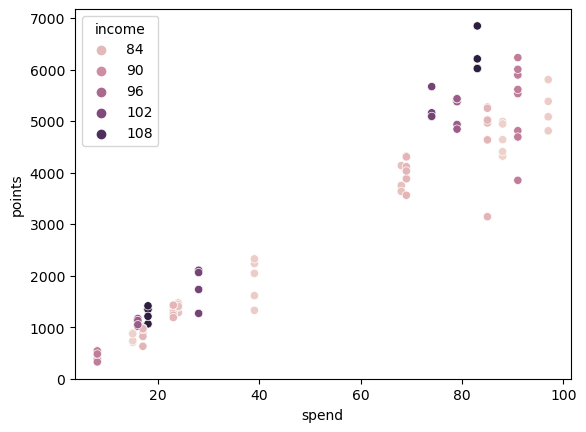

In [261]:
# scatter plot
sns.scatterplot(data = income_81_plus, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

In [262]:
# Clear relatinship between income, spend and points. 

# For all but the 40-56 spend score, your points are correllated to your spend score, with the added dynamic 
# that your points will be more or less in relation to your income. 

# What is the points range for each income bracket? 
# What is the exact calculation that determines your points, based on your spend and your income? 




In [263]:
# REmove the 40-55 (inculsive) POINTS datapoints and check corr() again. 

reviews_minus_midscores  = reviews.copy()
reviews_minus_midscores = reviews_minus_midscores[~reviews_minus_midscores['score'].between(40,55)]
reviews_minus_midscores.head(50)

,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
5,Female,24,13.94,76,573,PhD,977,Grandson loves,Five Stars,61-100,0 -20,3
6,Female,37,14.76,6,61,diploma,979,"I have bought many gm screens over the years, ...",Best gm screen ever,0-40,0 -20,8
7,Female,25,14.76,94,772,graduate,1012,Came in perfect condition.,Five Stars,61-100,0 -20,9
8,Male,66,15.58,3,31,PhD,1031,Could be better but its still great. I love th...,Great but could be even better,0-40,0 -20,187
9,Female,32,15.58,72,724,PhD,1459,My review will mirror others in that this kind...,Another missed opportunity. Not a value add t...,61-100,0 -20,11
10,Male,69,15.58,14,138,diploma,1463,Works very well,Five Stars,0-40,0 -20,188


Text(0, 0.5, 'points')

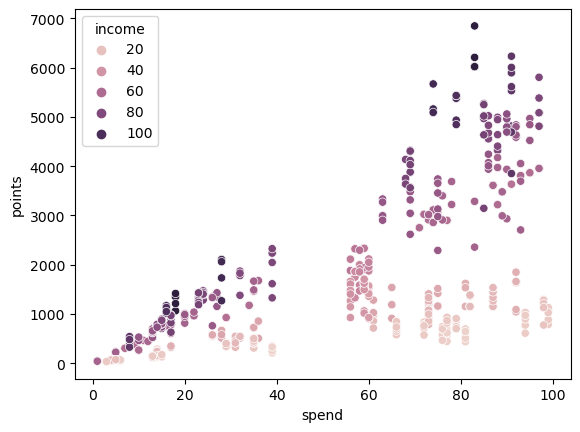

In [264]:
# scatter plot
sns.scatterplot(data = reviews_minus_midscores, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend')
plt.ylabel('points')

Beautiful. There's a clear relationship here. We can see that there is an income bracket that is messing with the pattern a bit. What's that? Looks like around 40k, as we already identified. Perform corr() with this dataset and then again after further filtering (ie removing the messy income bracket) if approproate. 

In [265]:
reviews_minus_midscores.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\197093900.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_minus_midscores.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.020002,-0.290374,-0.075341,-0.009423,0.051337
income,0.020002,1.000000,-0.000974,0.610472,0.360080,0.544154
score,-0.290374,-0.000974,1.000000,0.675893,-0.003943,-0.035319
loyalty_points,-0.075341,0.610472,0.675893,1.000000,0.214601,0.290175
product,-0.009423,0.360080,-0.003943,0.214601,1.000000,0.232270
customer_id,0.051337,0.544154,-0.035319,0.290175,0.232270,1.000000


Text(0, 0.5, 'points')

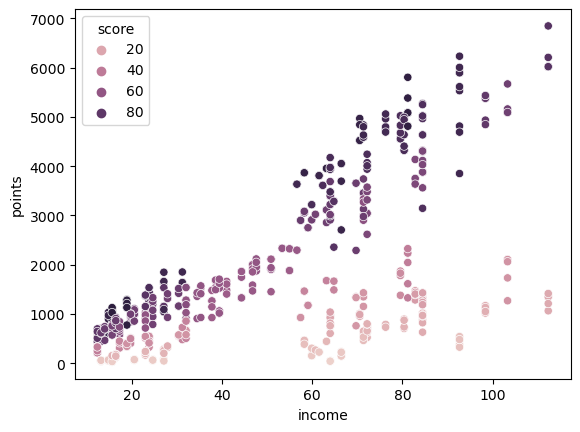

In [266]:
# Plot with income on the  and score in hue
# scatter plot
sns.scatterplot(data = reviews_minus_midscores, x = 'income', y = 'loyalty_points', hue = 'score')
plt.xlabel('income')
plt.ylabel('points')


Text(0, 0.5, 'points')

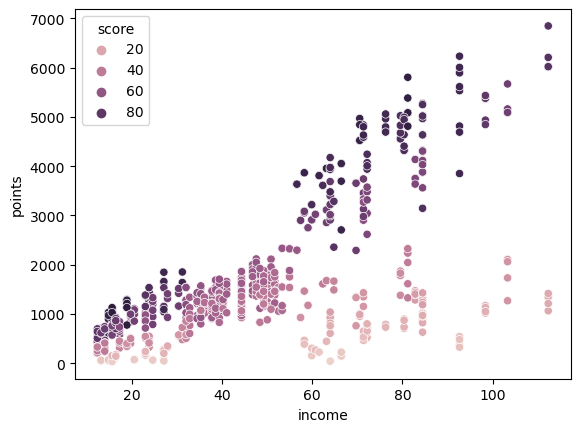

In [270]:
# Plot with income on the  and score in hue
# scatter plot
sns.scatterplot(data = reviews, x = 'income', y = 'loyalty_points', hue = 'score')
plt.xlabel('income')
plt.ylabel('points')


Text(0, 0.5, 'points')

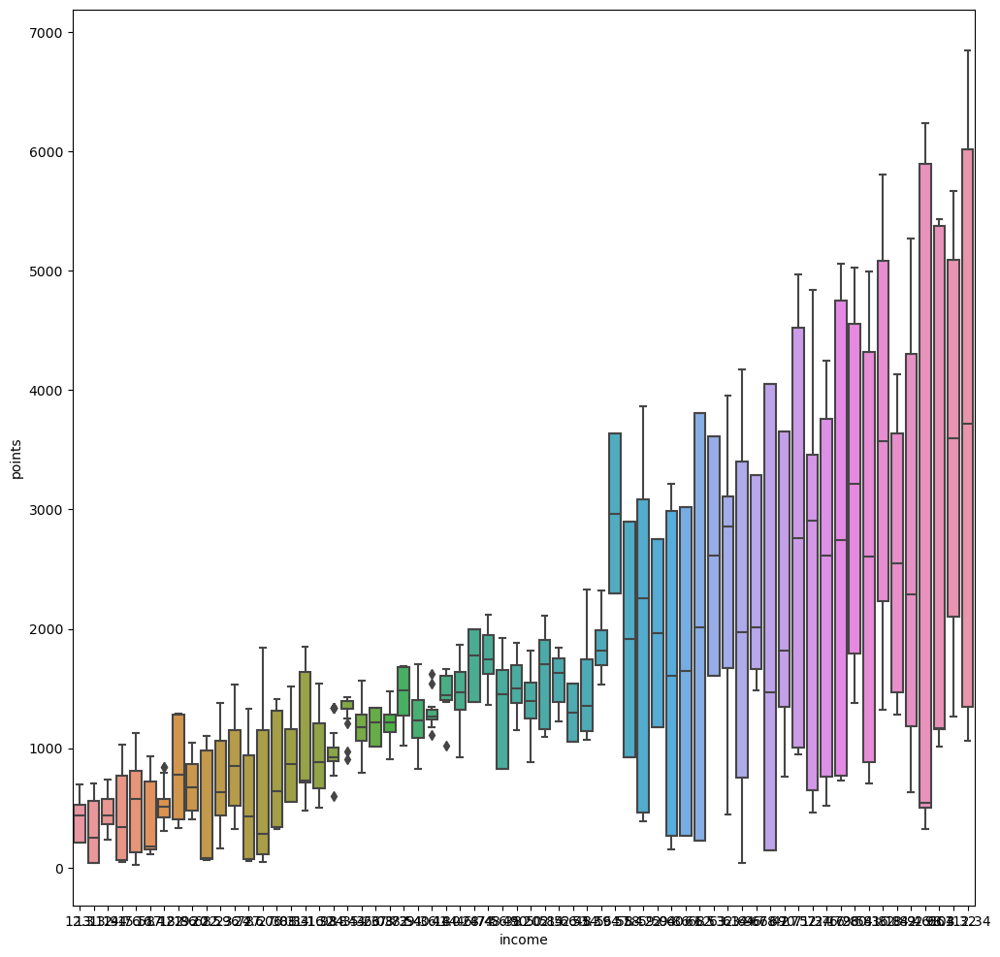

In [274]:
# Plot with income on the  and score in hue
# violinplot
plt.figure(figsize=(12, 12))
sns.boxplot(data = reviews, x = 'income', y = 'loyalty_points')
plt.xlabel('income')
plt.ylabel('points')

Text(0, 0.5, 'points')

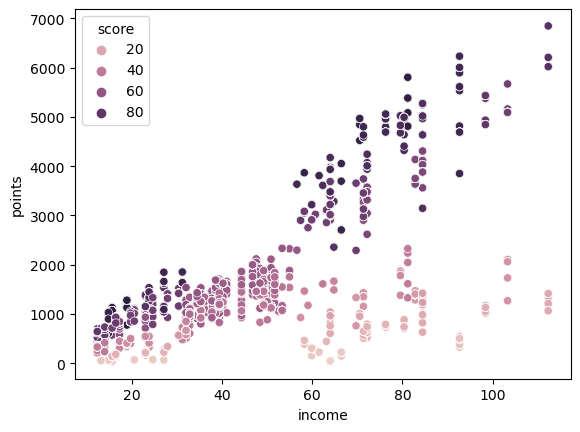

In [284]:
# Plot with income on the  and score in hue but with the normalised dataset
# scatter plot
sns.scatterplot(data = reviewsNE, x = 'income', y = 'points', hue = 'score')
plt.xlabel('income')
plt.ylabel('points')


In [285]:
# Subset further into income brackets, for corr() and graphing. 

reviews_pattern_income_minus_20 = reviews_minus_midscores[reviews_minus_midscores['income']<= 20].copy()

reviews_pattern_income_21_to_40 = reviews_minus_midscores[reviews_minus_midscores['income_bracket'] == '21-40'].copy()

reviews_pattern_income_41_to_60 = reviews_minus_midscores[reviews_minus_midscores['income_bracket'] == '41- 60'].copy()

reviews_pattern_income_61_to_80 = reviews_minus_midscores[reviews_minus_midscores['income_bracket'] == '61 - 80'].copy()

reviews_pattern_income_81_plus = reviews_minus_midscores[reviews_minus_midscores['income_bracket'] == '80+'].copy()

reviews_pattern_income_81_plus.head()

,gender,age,income,score,loyalty_points,education,product,review,summary,score_bracket,income_bracket,customer_id
182,Male,44,80.36,15,881,PhD,6504,Incomplete kit! Very disappointing!,INCOMPLETE KIT!,0-40,80+,302
183,Female,29,80.36,88,4320,graduate,6507,Incomplete set. Was missing the bead eyes the ...,Incomplete,61-100,80+,152
184,Female,39,81.18,39,2235,PhD,3403,Nieces loved it.,Four Stars,0-40,80+,154
185,Male,32,81.18,97,5084,graduate,4390,Kit and instructions make easy to learn the pr...,Five Stars,61-100,80+,305
186,Female,53,82.82,24,1469,postgraduate,4399,Hard to put together.,"Cute idea, hard to do",0-40,80+,159


In [286]:
reviews_pattern_income_minus_20.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\3903019830.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_pattern_income_minus_20.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.163377,-0.397356,-0.229937,0.096599,0.159813
income,0.163377,1.000000,0.025487,0.314230,0.013764,0.226070
score,-0.397356,0.025487,1.000000,0.925552,-0.029364,-0.110634
loyalty_points,-0.229937,0.314230,0.925552,1.000000,-0.005534,-0.080945
product,0.096599,0.013764,-0.029364,-0.005534,1.000000,-0.047981
customer_id,0.159813,0.226070,-0.110634,-0.080945,-0.047981,1.000000


In this dataset there is a small negative correlation between age and score. 

Text(0, 0.5, 'points')

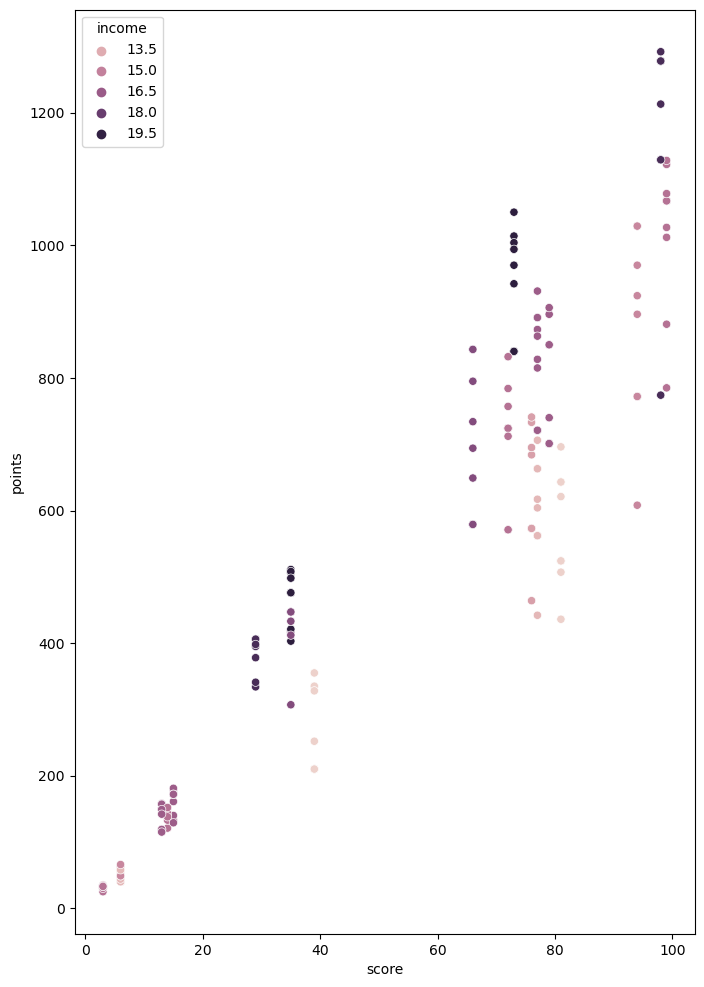

In [287]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

We have a new insight here  -  with  points being oddly grouped. The tall graph helps this come to light. 

The implications of the vertically grouped datapoints are important here because they suggest further clarification of the dynamic whereby the same score will earn different points, depending on another factor, perhaps income (perhaps not just income). 

To look more closely at this we will graph the same data as above, but with income on the y axis and points in hue. 

Then we will continue to look at the other income brackets in this subset (which will answer to the issue of this being a small dataset, relative to the whole). 


Text(0, 0.5, 'income')

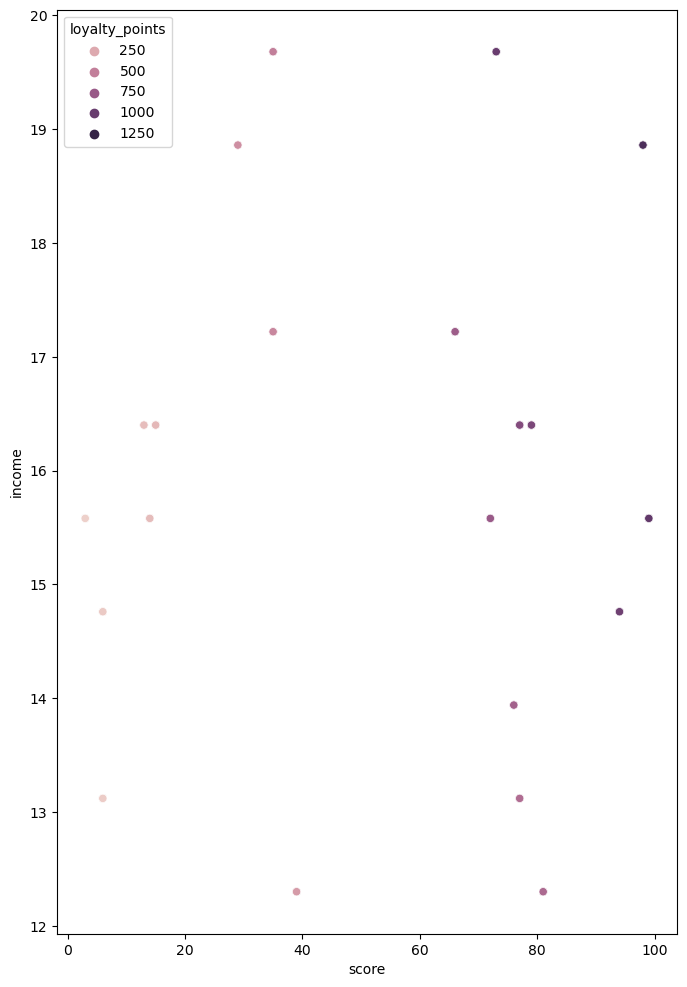

In [288]:
# Plot with income on y and points in hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'income', hue = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('income')

C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 76.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 80.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 78.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 77.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 75.0% of the points cann

Text(66.97222222222221, 0.5, 'income')

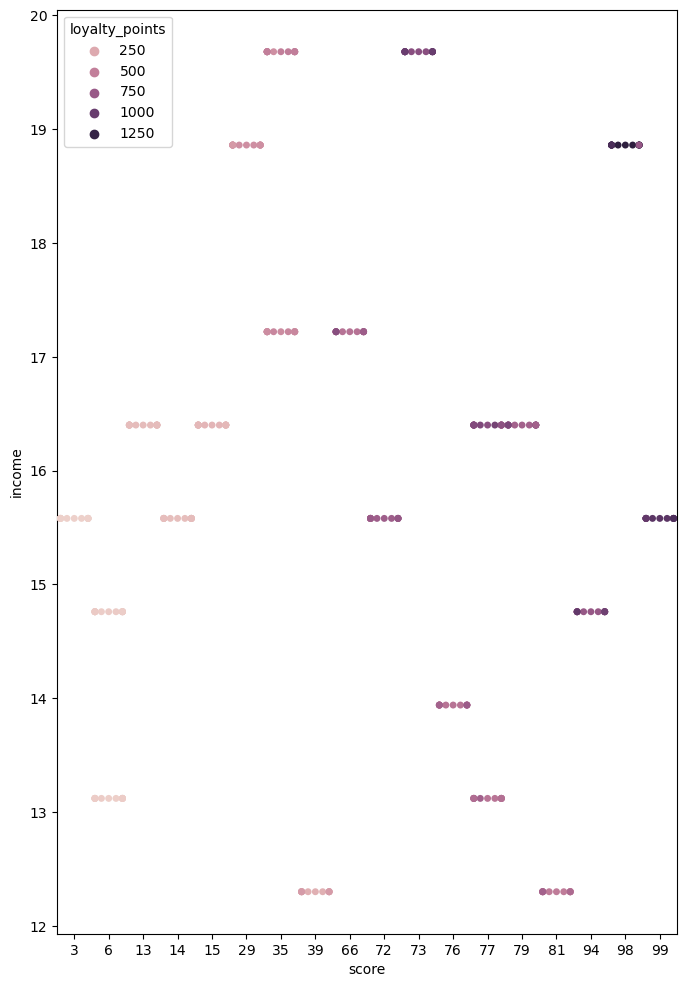

In [289]:
# Plot with income on y and points in hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.swarmplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'income', hue = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('income')

Lots of the datapoints weren't placed (between 75 and 80%)

The scatter plot wasn't showing all the data. I'm puzzled at what I'm looking at here. The income looks to be exactly the same for these clusters. AND there are no uinique data points. So, if this is a case of multiple purchases by the same indiviuals, where are the individual purchases by individuals, or are there none in this subset? 

Furthermore, the points (hue) visualisation seems to indicate that the points are not tied to score only (inside income). That is, there are higher points at the same score (although the swarmplot makes this a but tricky to read, we do know from the scatterplot immediately above it, that these are in fact the same score), but the same income. So we're looking at an indication that there is indeed at least one other factor. Whether we can discern it from the two main datasets is yet to be discovered. It could be multipl purchases (we have no way of knowing from the scatterplot above which purchase came first, or if (eg) two in a cluster happened at the same time, and then another. The question would still remain: why does the points change, when the score does not? This could (for example) be because the purchases are completed at the same time and each one gains more points (successively) but the score doesn't change. There are several clusters along the same income level, and the points do seem to get higher as these move along the score. So these in fact could be a series of multiple purchases by the same person? 

Let's try some other values in the hue. We haven't used the concatenated dataset here, because we wanted to use as many datapoints as possible. It may be worth rrunning this visualisation with the concatenated dataset (subsetting first), if nothing shows up in the variables we can access from the sales data (the original set this was drawn from). 

And then let's finish the visualisations of this series, as this is just the first (income of 0-20) of several in this stage of the analysis. 

C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 76.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 80.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 78.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 77.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 75.0% of the points cann

Text(66.97222222222221, 0.5, 'income')

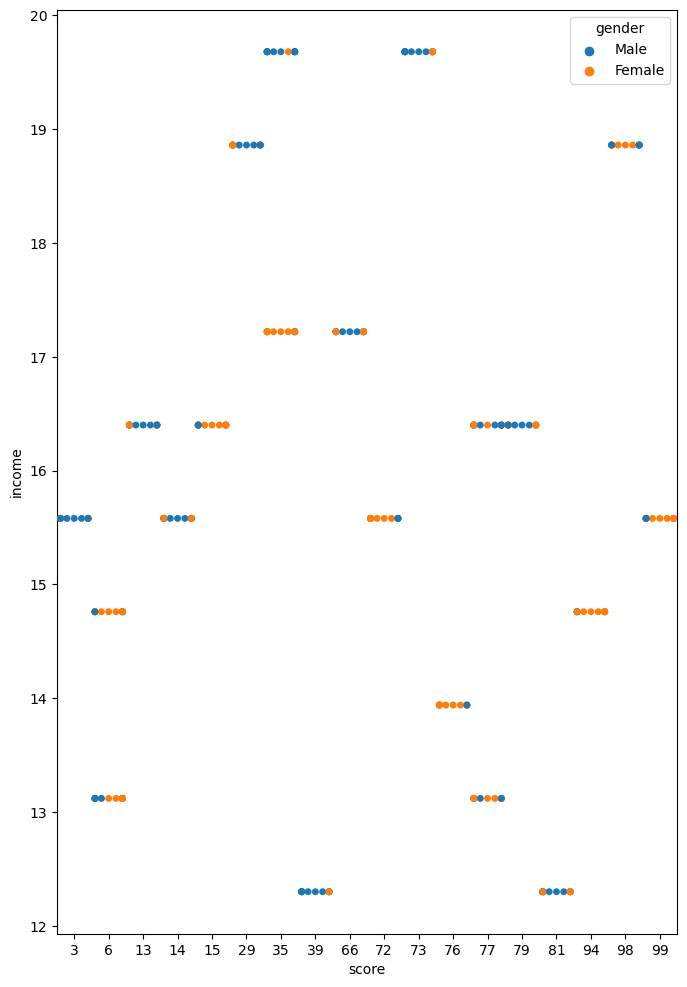

In [290]:
# Plot with income on y and points in hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.swarmplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'income', hue = 'gender')
plt.xlabel('score')
plt.ylabel('income')

Again, not all th datapoints have been placed. 

But clearly those purchases are NOT the same person (at least in all cases) becuase if they were, they'd be the same gender (with a dataset that insists on binary gender, we can leave that there). Although education can change perhaps moe easily than gender, we can stil likey get some more sense of the various individuals or otherwise, as there are more options)

C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 76.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 80.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 78.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 77.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 75.0% of the points cann

Text(66.97222222222221, 0.5, 'income')

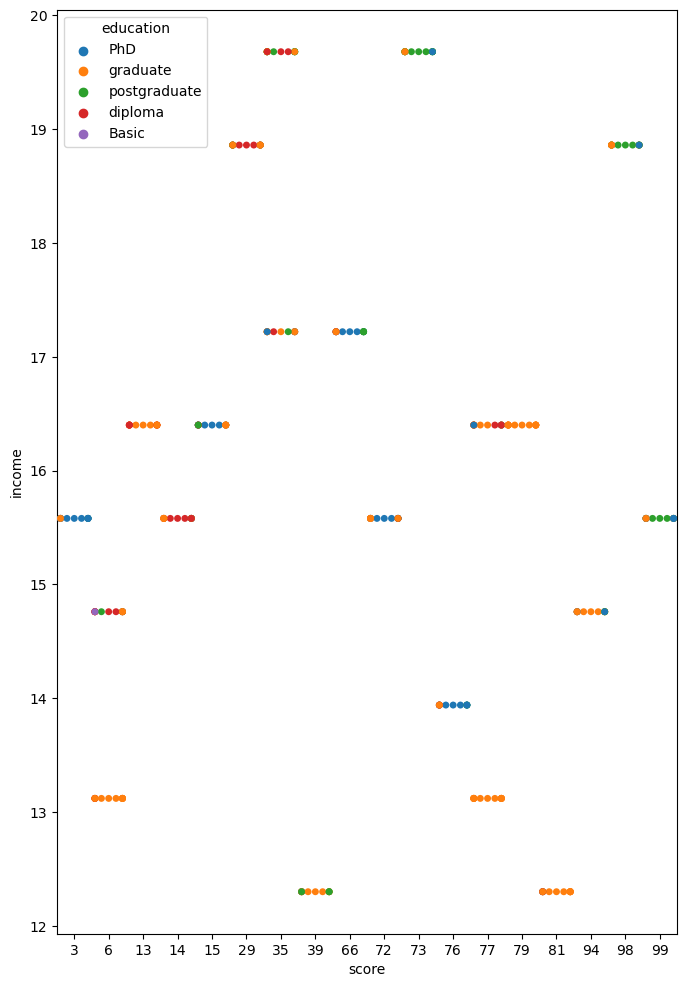

In [291]:
# Plot with income on y and points in hue. 
# scatter plot
plt.figure(figsize = (8, 12))
sns.swarmplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'income', hue = 'education')
plt.xlabel('score')
plt.ylabel('income')

Text(0, 0.5, 'income')

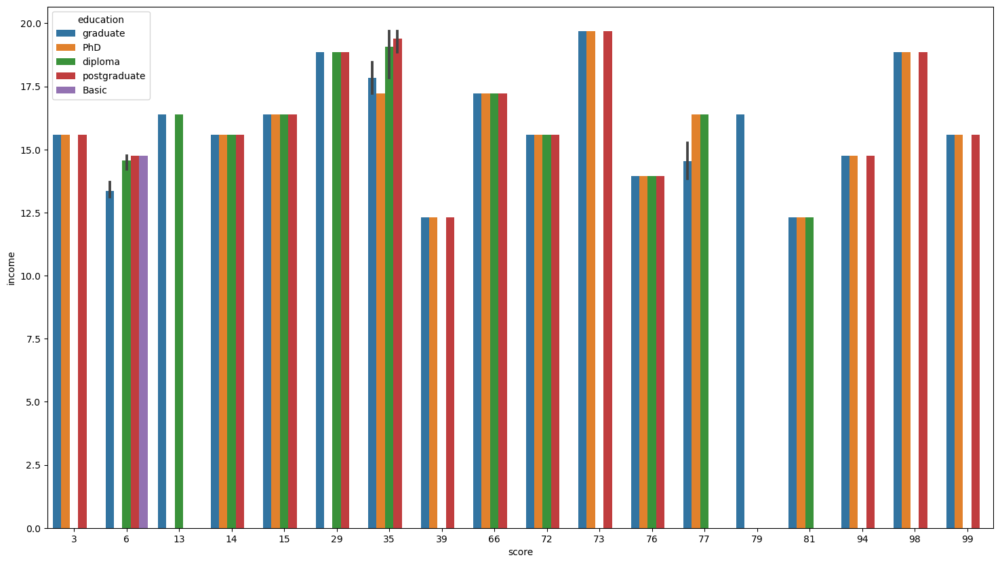

In [292]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_minus_20, x = 'score', y = 'income', hue = 'education')
plt.xlabel('score')
plt.ylabel('income')

This doesn't seem to line up with the visualisation above, in terms of the education levels of the customers making purchases. This needs to be investigated further. There are definitely more educational levels represented here at each score / income nexus than in the graph above. 

More than one datapoint with the same ed / score / income(of a range) would not show up as two bars of same colour - we cn see that because there are lines indicating a rang for this data. 

If we just had this visualisation we'd say for sure that none of the purchases at the same points level have been made by the same person (assuming noone has changed education levels within the data collection time frame - though this is unlikely unless the dataset here is only representative of a short time frame). 



## 21-40K

In [293]:
reviews_pattern_income_21_to_40.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2392662354.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_pattern_income_21_to_40.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.017917,-0.411135,-0.162475,0.006991,0.009071
income,0.017917,1.000000,0.174997,0.502044,0.317056,0.303592
score,-0.411135,0.174997,1.000000,0.874020,0.055717,0.204694
loyalty_points,-0.162475,0.502044,0.874020,1.000000,0.153906,0.234902
product,0.006991,0.317056,0.055717,0.153906,1.000000,0.198569
customer_id,0.009071,0.303592,0.204694,0.234902,0.198569,1.000000


Text(0, 0.5, 'points')

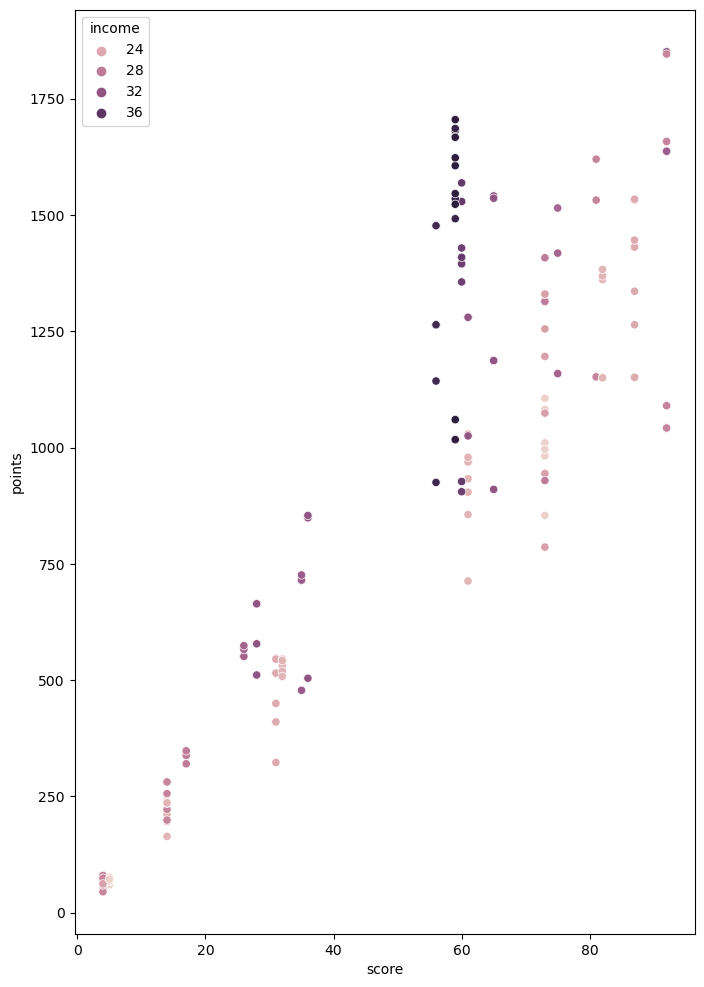

In [294]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_21_to_40, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

Clear correlation betwen income and points, even at the same score. Need to find out which products these are (ranking etc) to see if there is a correlation. 



C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 71.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 55.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 44.4% of the points cann

Text(49.222222222222214, 0.5, 'points')

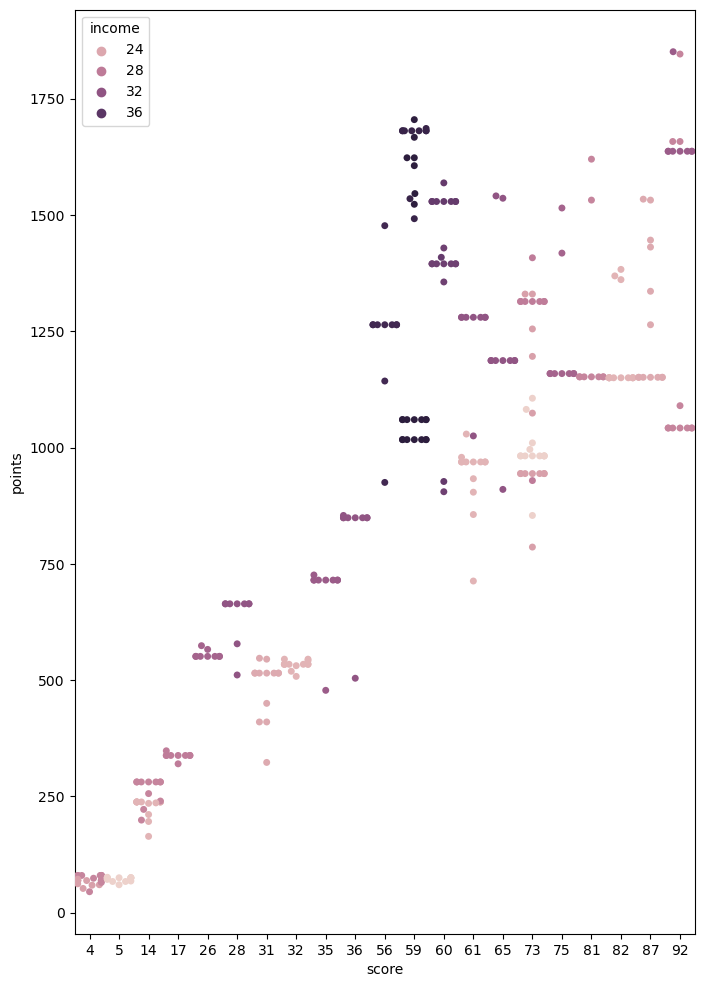

In [295]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.swarmplot(data = reviews_pattern_income_21_to_40, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

Something odd is going on there at teh higher score end with the higher end of his income bancd - that's the beginning of the bermuda triangle (not triangle) tho, as established. 

Text(0, 0.5, 'income')

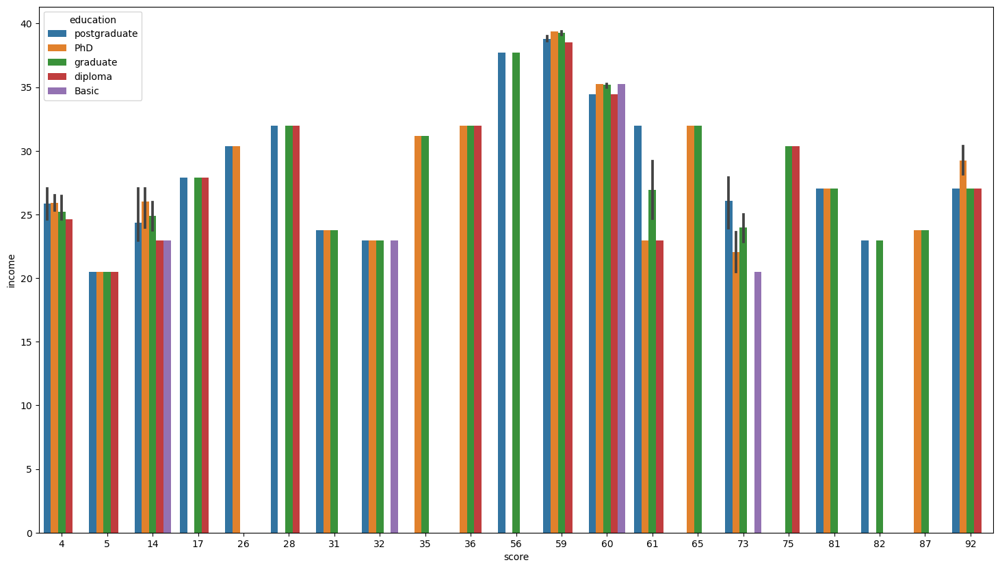

In [296]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'score', y = 'income', hue = 'education')
plt.xlabel('score')
plt.ylabel('income')

Text(0, 0.5, 'points')

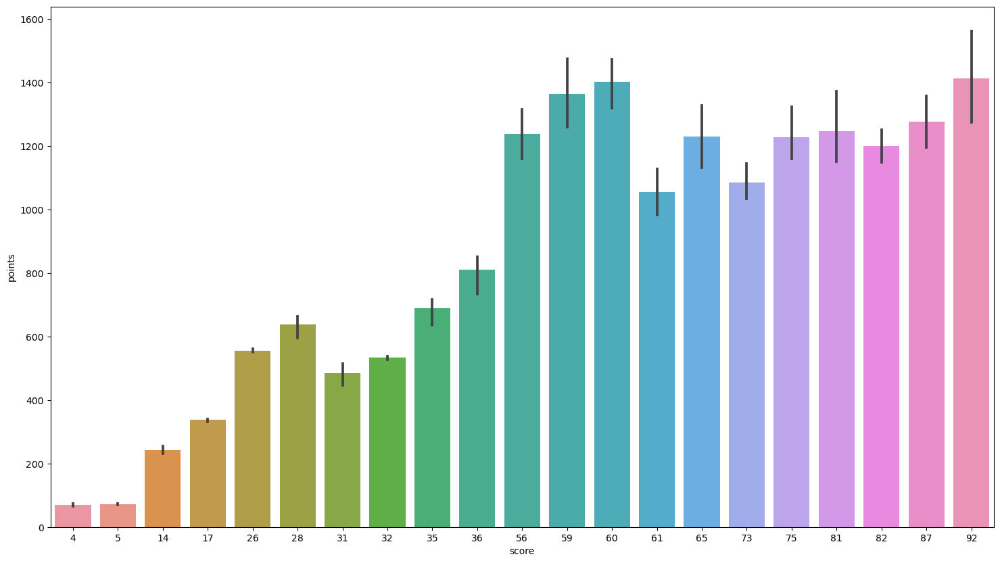

In [297]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'score', y = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('points')

Text(0, 0.5, 'points')

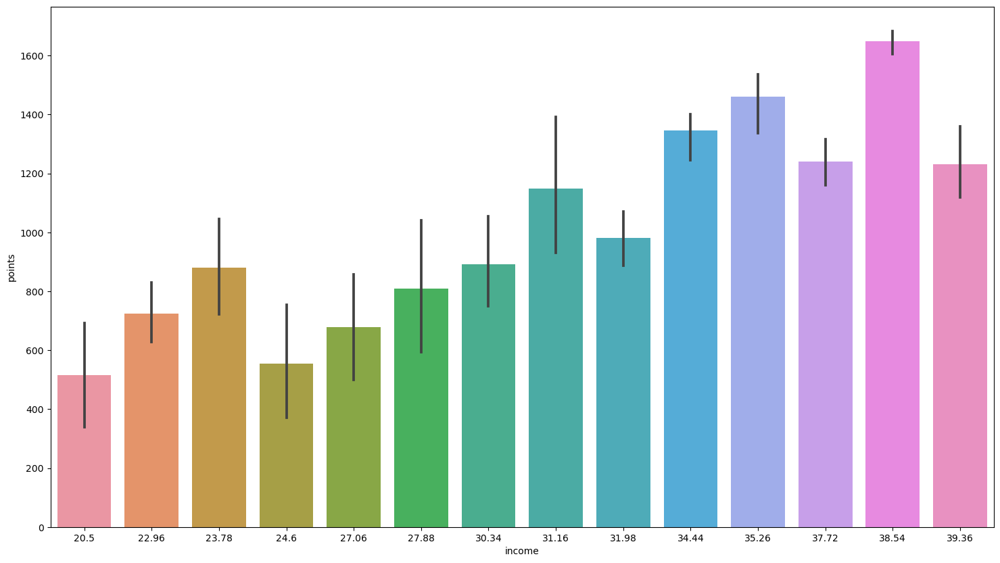

In [353]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'income', y = 'loyalty_points')
plt.xlabel('income')
plt.ylabel('points')

Those are great together (those barplots) because they show that points raise with income, and not just score, and with pretty much the same (ir)regularity. Let's try with income and score too, to attempt to show how they aren't related.



Text(0, 0.5, 'score')

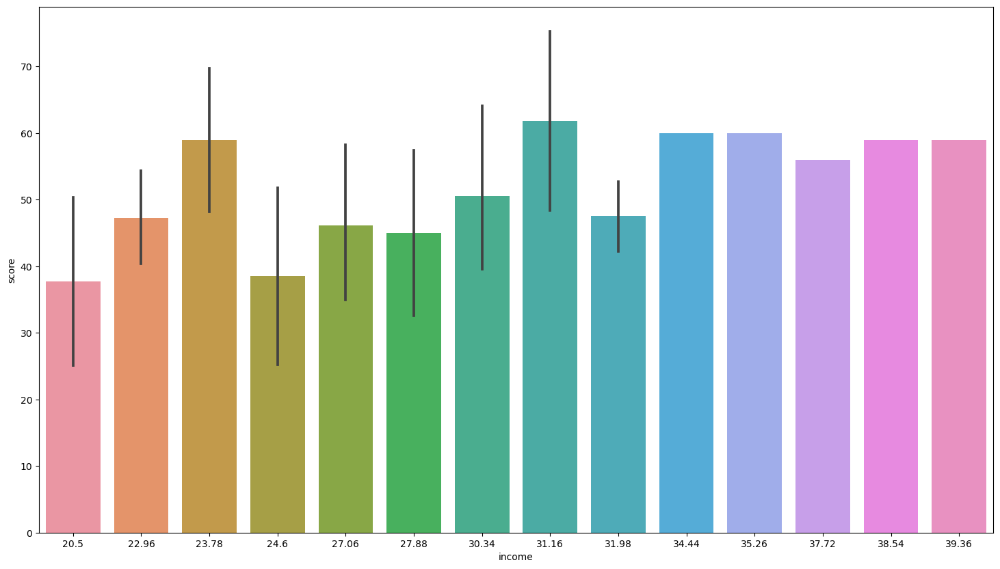

In [354]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'income', y = 'score')
plt.xlabel('income')
plt.ylabel('score')

Text(0, 0.5, 'score')

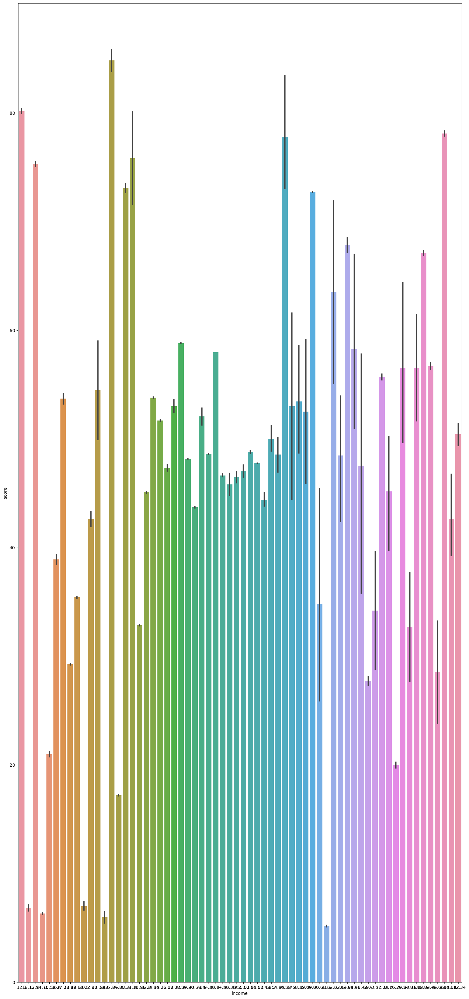

In [355]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 40))
sns.barplot(data = reviewsNE, x = 'income', y = 'score')
plt.xlabel('income')
plt.ylabel('score')

Text(0, 0.5, 'score')

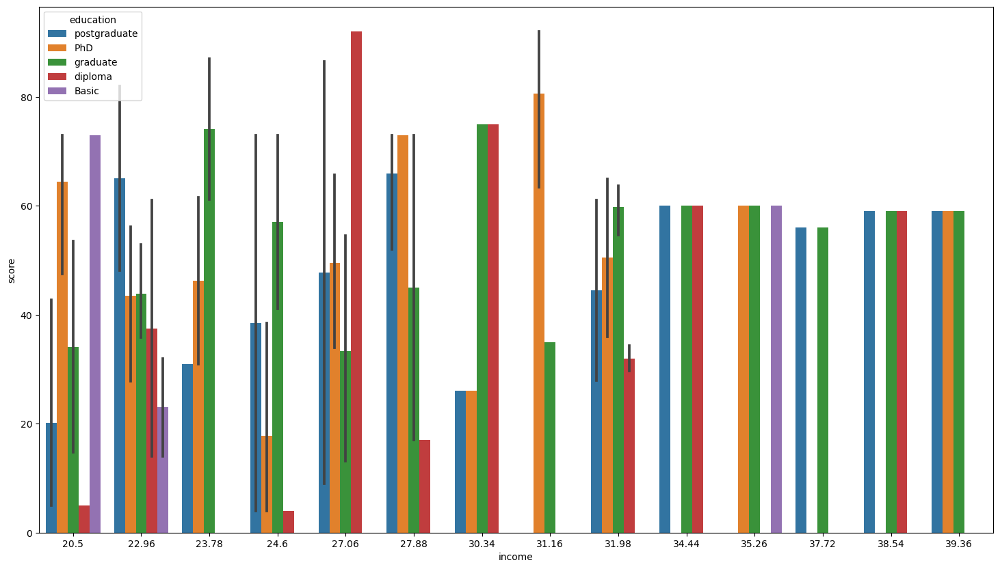

In [361]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'income', y = 'score', hue = 'education')
plt.xlabel('income')
plt.ylabel('score') 

This is messy but I love how it shows the messiness of the data up till 34.5. This suggests that th ceiling on score may begin earlier (at a lower income rate) than we thought. There aren't even any mean lines after that point

Text(0, 0.5, 'score')

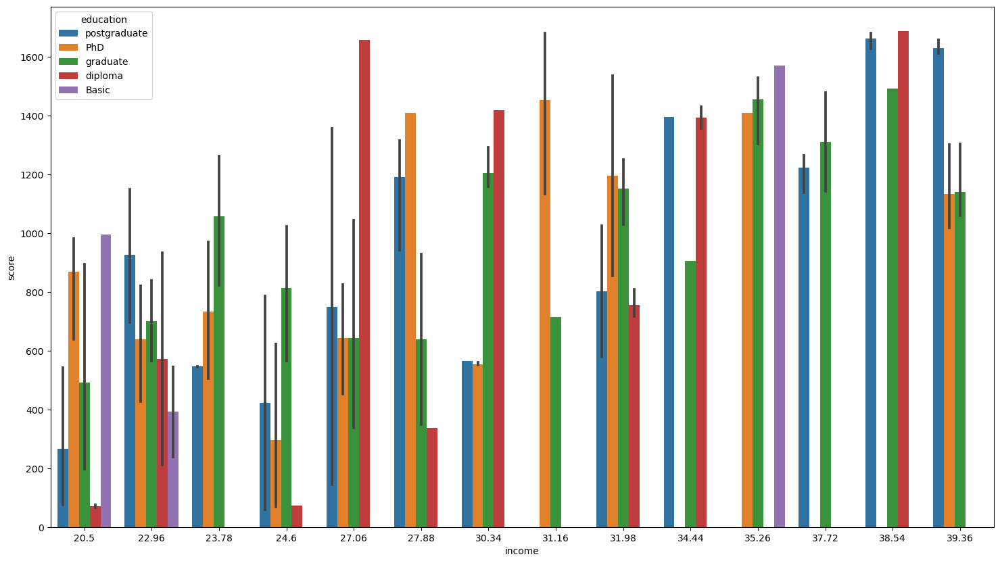

In [362]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_21_to_40, x = 'income', y = 'loyalty_points', hue = 'education')
plt.xlabel('income')
plt.ylabel('score') 

In [363]:
# Fasincating. Messy, but fascinating. 

# Do people with low educations but high income, buy differently to others with high income? 

## 41-60K 

In [364]:
reviews_pattern_income_41_to_60.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2609220881.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_pattern_income_41_to_60.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,-0.320873,-0.042740,-0.020748,-0.168918,0.113442
income,-0.320873,1.000000,-0.126534,0.095758,0.280330,0.409601
score,-0.042740,-0.126534,1.000000,0.962325,-0.055213,-0.040061
loyalty_points,-0.020748,0.095758,0.962325,1.000000,-0.002431,0.089020
product,-0.168918,0.280330,-0.055213,-0.002431,1.000000,0.031846
customer_id,0.113442,0.409601,-0.040061,0.089020,0.031846,1.000000


Text(0, 0.5, 'points')

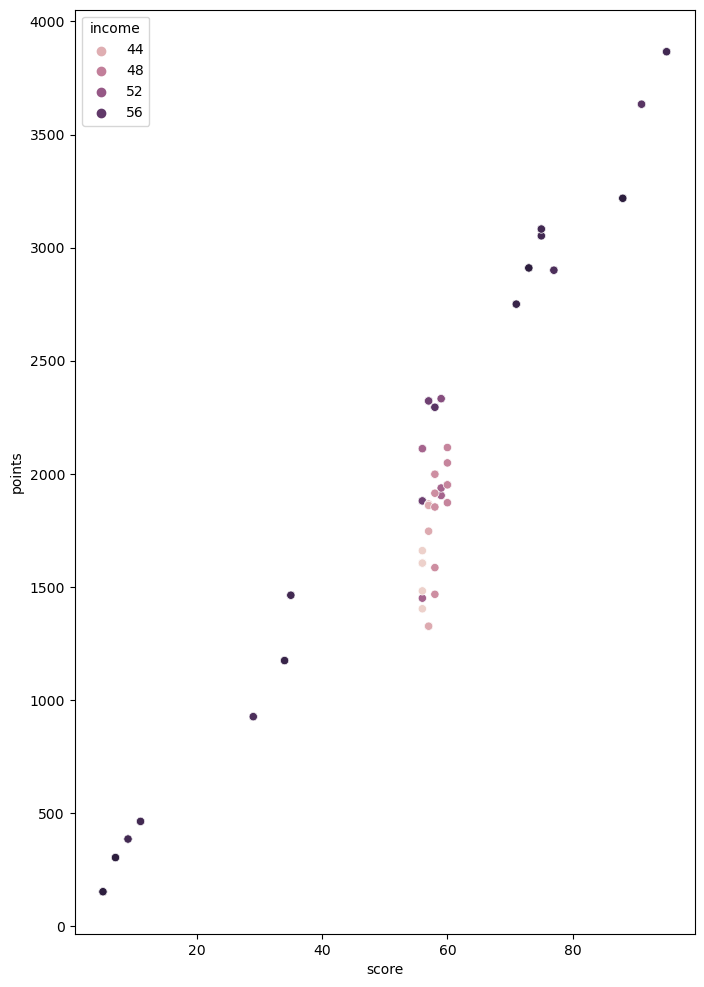

In [402]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_41_to_60, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 57.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 44.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 53.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 45.5% of the points cann

Text(49.222222222222214, 0.5, 'points')

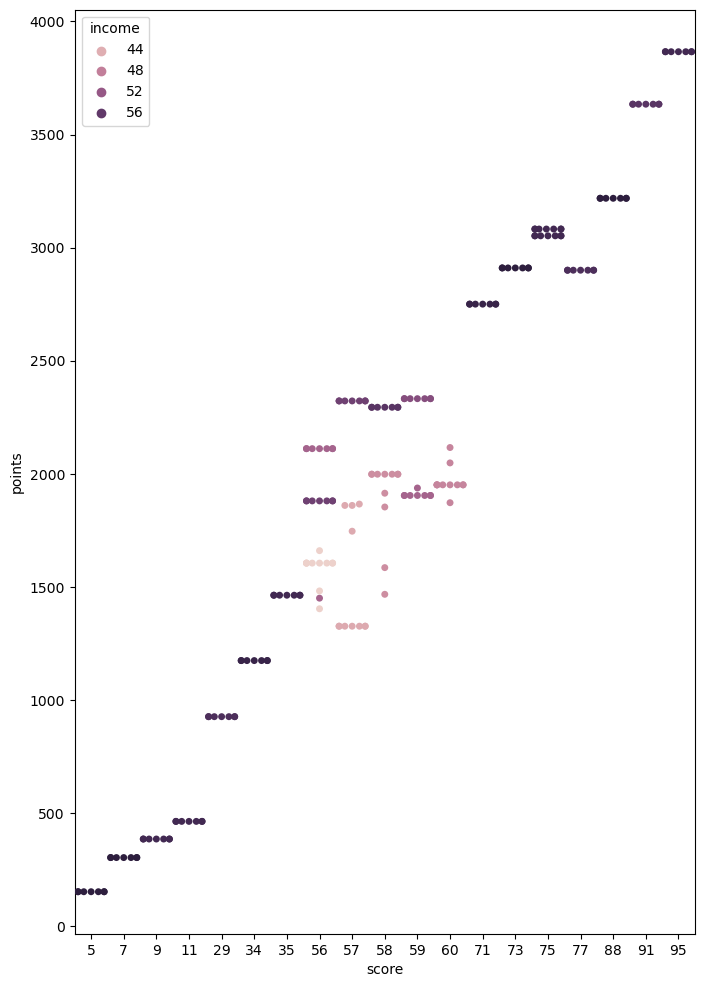

In [403]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.swarmplot(data = reviews_pattern_income_41_to_60, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

This is a peculiar dataset because of the extractions made here - most of the scores in the 40-55 range are from this income bracket. So we won't analyuse too much further. 

Why is it always a maximum of dots in a cluster in these swarm plots? Is that just how they are? - in fact here, it isn't the case and we have individual data points. 

In [404]:
# Check the unique combinations of x and y variables in this dataset. 
unique_combinations = reviews_pattern_income_41_to_60.groupby(['score', 'loyalty_points']).size().reset_index()
print(unique_combinations)

    score  loyalty_points  0
0       5             152  7
1       7             303  7
2       9             385  7
3      11             463  7
4      29             926  7
5      34            1174  7
6      35            1463  7
7      56            1403  1
8      56            1450  1
9      56            1482  1
10     56            1605  8
11     56            1660  1
12     56            1880  7
13     56            2111  7
14     57            1326  7
15     57            1746  1
16     57            1860  2
17     57            1866  1
18     57            2322  7
19     58            1467  1
20     58            1585  1
21     58            1853  1
22     58            1914  1
23     58            1998  7
24     58            2294  7
25     59            1904  7
26     59            1937  1
27     59            2332  7
28     60            1872  1
29     60            1951  8
30     60            2048  1
31     60            2116  1
32     71            2750  7
33     73     

It's clear now we aren't seeing all the datapoints in the graph above (and intresting counts for the combinations).

Text(0, 0.5, 'points')

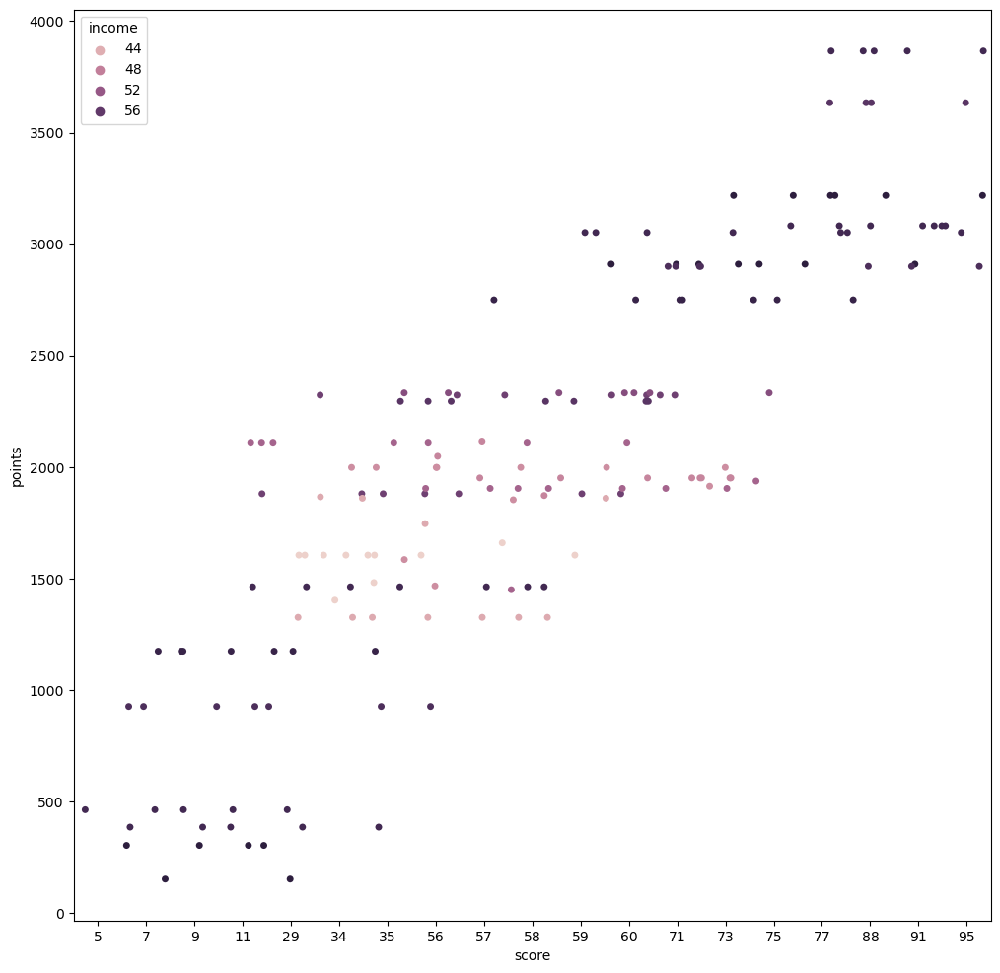

In [405]:
# Plot 
# scatter plot
plt.figure(figsize = (12, 12))
sns.stripplot(data = reviews_pattern_income_41_to_60, x = 'score', y = 'loyalty_points', hue = 'income', jitter = 4)
plt.xlabel('score')
plt.ylabel('points')

In [406]:
# Okay so we can interpret that with a grain os salt, but in combination with the graph aboe it shows more clearly the 
# counts of these datapoints. 

## 61 - 80K

In [407]:
reviews_pattern_income_61_to_80.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2256901182.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_pattern_income_61_to_80.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.144261,-0.262982,-0.185652,-0.124906,0.029053
income,0.144261,1.000000,0.015647,0.153283,-0.152339,0.157912
score,-0.262982,0.015647,1.000000,0.978570,-0.020342,-0.180497
loyalty_points,-0.185652,0.153283,0.978570,1.000000,-0.047285,-0.149493
product,-0.124906,-0.152339,-0.020342,-0.047285,1.000000,-0.018881
customer_id,0.029053,0.157912,-0.180497,-0.149493,-0.018881,1.000000


Text(0, 0.5, 'points')

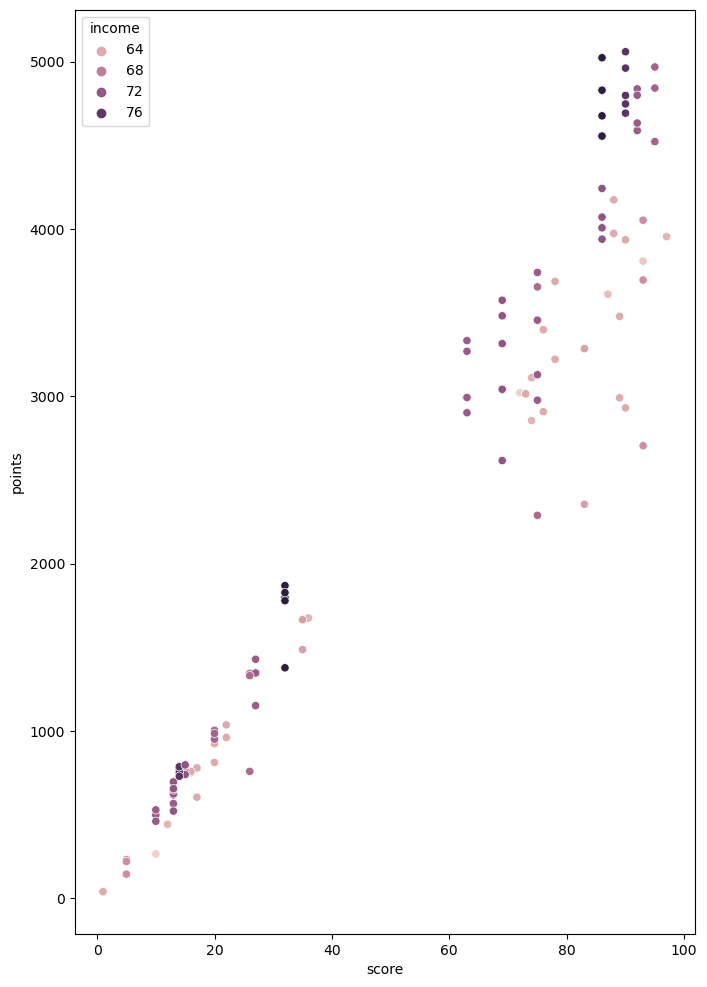

In [408]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_61_to_80, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

In [409]:
# Check the unique combinations of x and y variables in this dataset. 
unique_combinations2 = reviews_pattern_income_61_to_80.groupby(['score', 'loyalty_points']).size().reset_index()
print(unique_combinations2)

     score  loyalty_points  0
0        1              40  1
1        1              41  1
2        1              44  7
3        1              45  7
4        5             145  7
..     ...             ... ..
106     93            4052  7
107     95            4522  7
108     95            4842  1
109     95            4968  1
110     97            3954  7

[111 rows x 3 columns]


In [410]:
# Again, that same feature of either a low number or 7~...to be investigated further for sure. 

Text(0, 0.5, 'score')

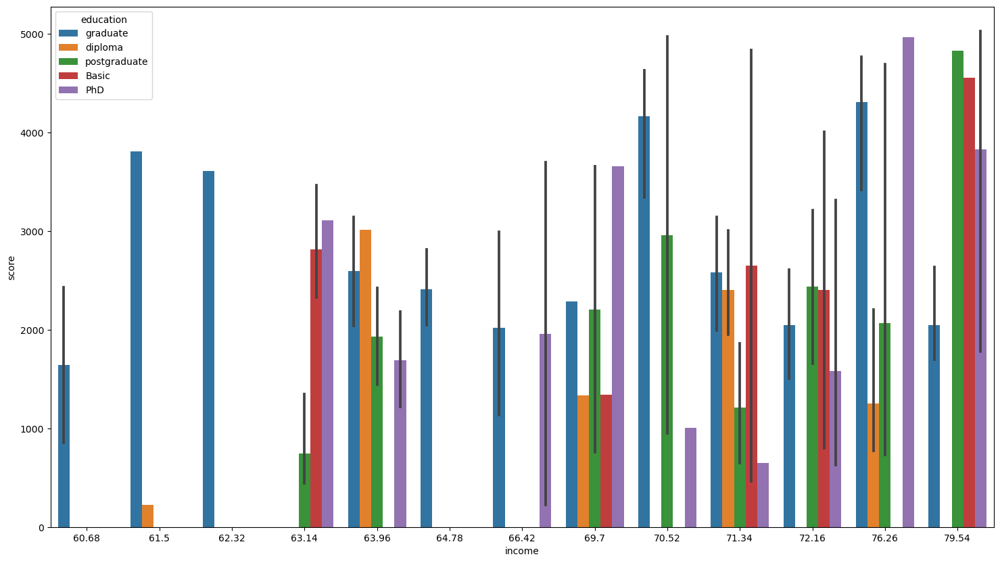

In [411]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_61_to_80, x = 'income', y = 'loyalty_points', hue = 'education')
plt.xlabel('income')
plt.ylabel('score') 

Again a gap in teh data here because the points were filtered out. When this stage of the analysis is complete (one more income bracket after this one), we can look at the points we removed and what they look like on similar graphs to those we've used in this series. 




## 81K+

In [412]:
reviews_pattern_income_81_plus.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\3438323527.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_pattern_income_81_plus.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,0.014845,-0.184198,-0.104430,0.006495,-0.170059
income,0.014845,1.000000,-0.053634,0.127381,-0.294792,0.302374
score,-0.184198,-0.053634,1.000000,0.966677,-0.002783,-0.041184
loyalty_points,-0.104430,0.127381,0.966677,1.000000,-0.063363,-0.018913
product,0.006495,-0.294792,-0.002783,-0.063363,1.000000,-0.118766
customer_id,-0.170059,0.302374,-0.041184,-0.018913,-0.118766,1.000000


Text(0, 0.5, 'points')

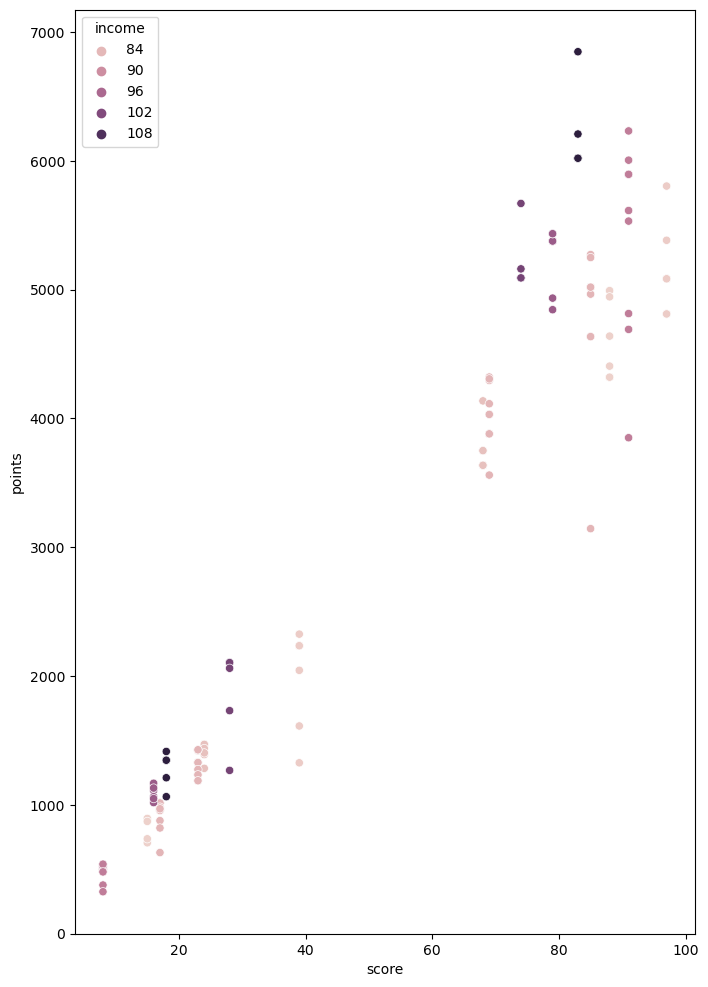

In [413]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = reviews_pattern_income_81_plus, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

How is the points differential (term?) calcualted for the different incomes of customers?
It's sensible to give 'more financial' customers more points - assuming they can spend more, they may be enticed to do so. 

Text(0, 0.5, 'score')

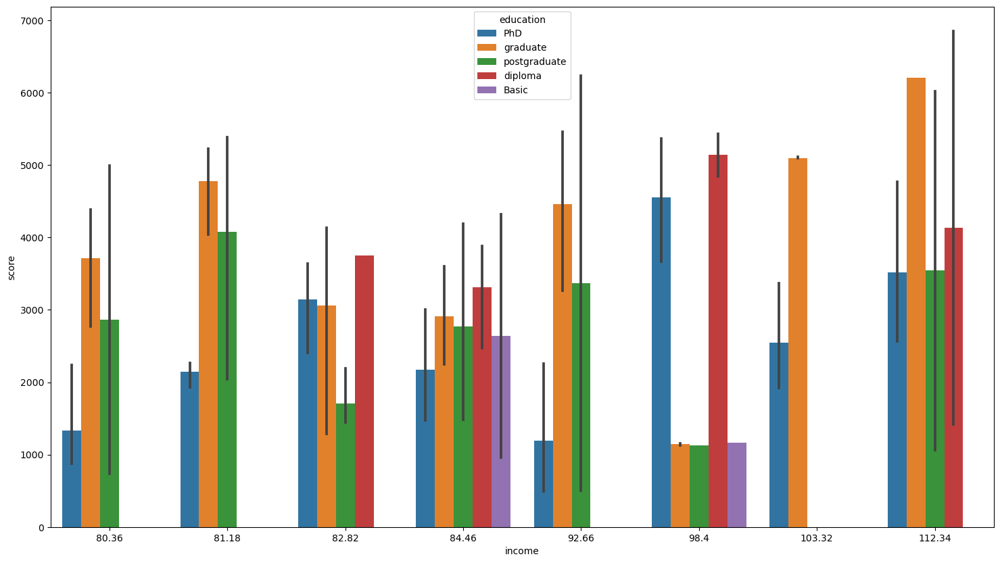

In [414]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = reviews_pattern_income_81_plus, x = 'income', y = 'loyalty_points', hue = 'education')
plt.xlabel('income')
plt.ylabel('score') 

## Points between 40 and 57

Text(0, 0.5, 'score')

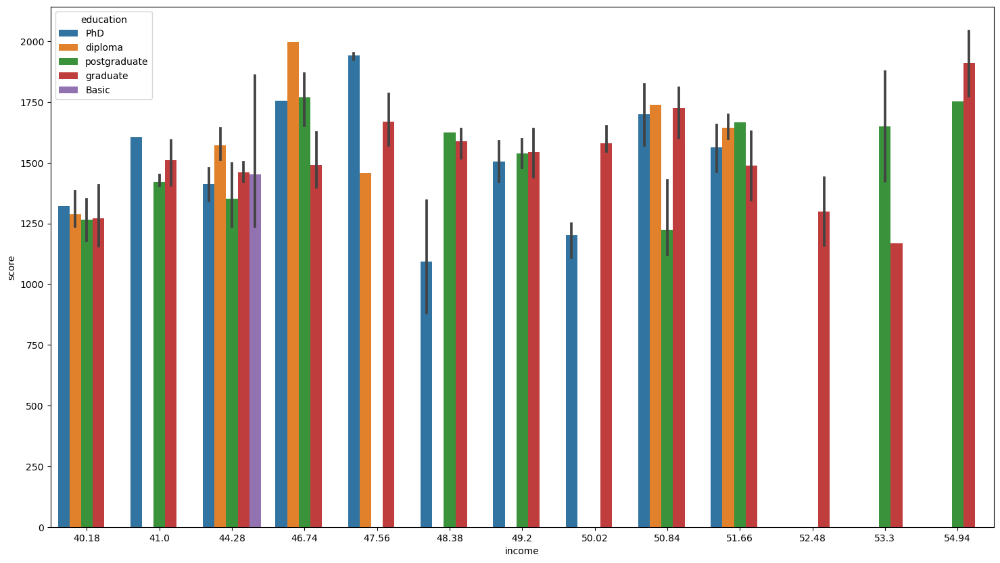

In [415]:
# Plot the same data on a barplot
# scatter plot
plt.figure(figsize = (18, 10))
sns.barplot(data = income_41_to_56, x = 'income', y = 'loyalty_points', hue = 'education')
plt.xlabel('income')
plt.ylabel('score') 




Text(0, 0.5, 'score')

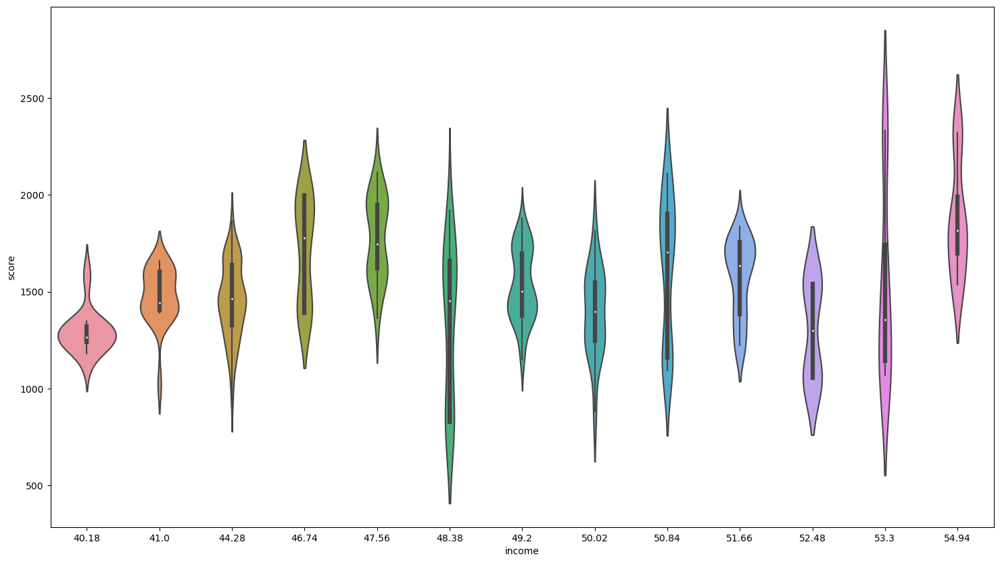

In [416]:
# Violin plot
plt.figure(figsize = (18, 10))
sns.violinplot(data = income_41_to_56, x = 'income', y = 'loyalty_points')
plt.xlabel('income')
plt.ylabel('score') 



Text(0, 0.5, 'points')

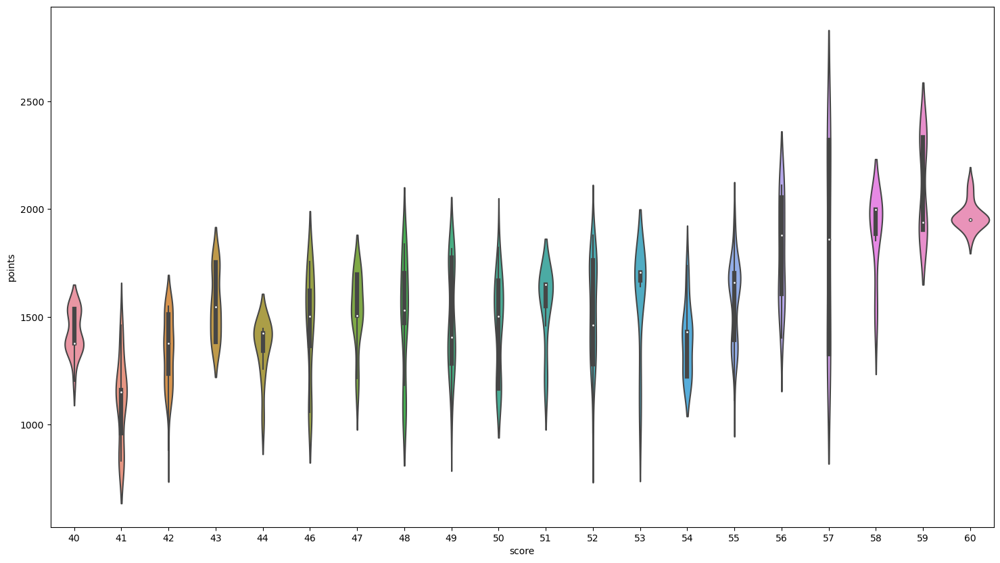

In [417]:
# Violin plot
plt.figure(figsize = (18, 10))
sns.violinplot(data = income_41_to_56, x = 'score', y = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('points') 


Text(0, 0.5, 'points')

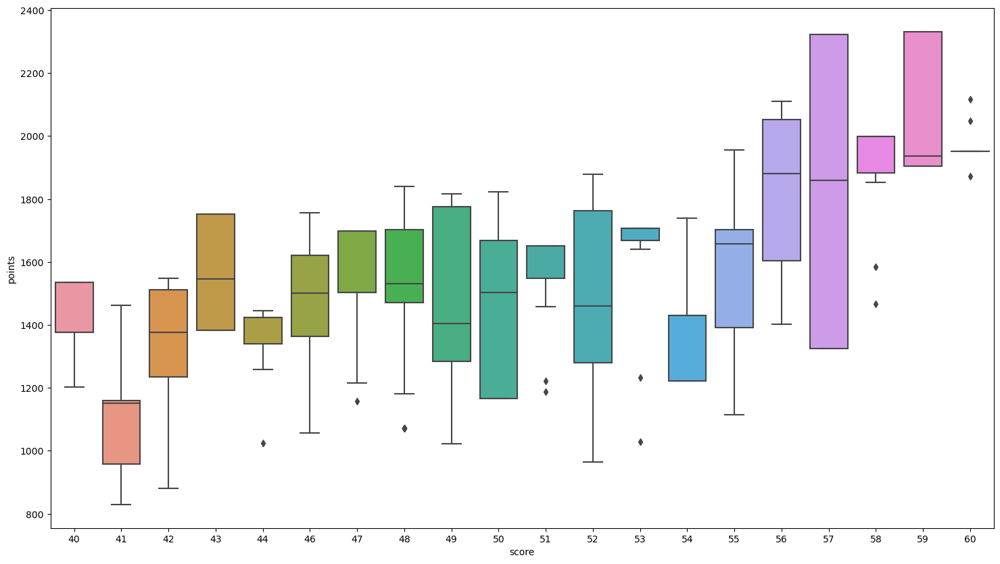

In [418]:
# Box plot
plt.figure(figsize = (18, 10))
sns.boxplot(data = income_41_to_56, x = 'score', y = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('points') 



Text(0, 0.5, 'points')

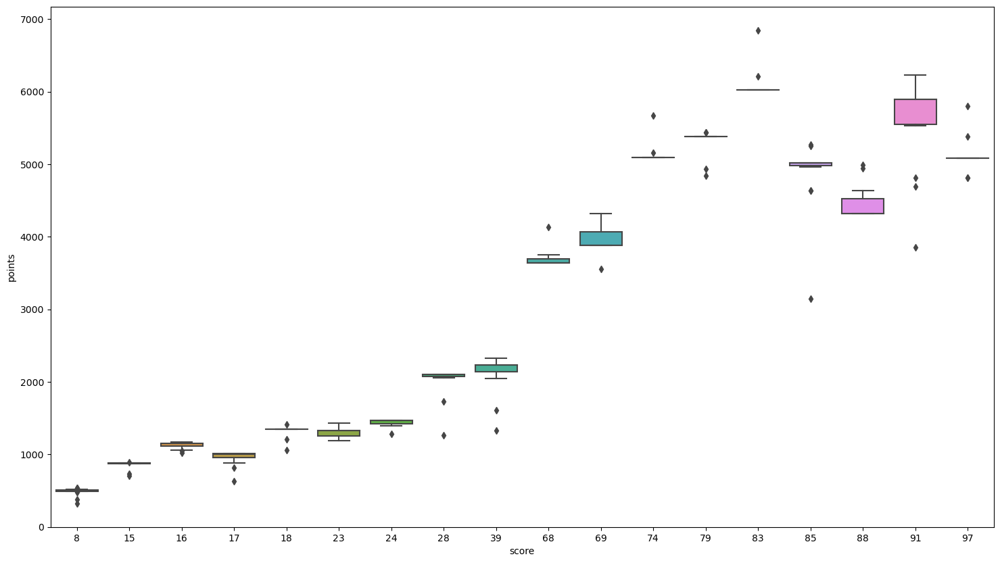

In [419]:
# Box plot - does a different income bracket look different? 
plt.figure(figsize = (18, 10))
# sns.boxplot(data = income_61_to_80, x = 'score', y = 'loyalty_points')
sns.boxplot(data = income_81_plus, x = 'score', y = 'loyalty_points')
plt.xlabel('score')
plt.ylabel('points') 

The other incmoe brackets are consistenly different because they are very spread out across the range of scores.
Frustrating for those in the 40-60 income bracket? Limiting the benefits (to them and the company) of the points system? 


How (if at all) are they behaving differently as a result? Look at what they are purchasing (and reviewing on)


I also want to be able to find out what the calculation is that spreads loyalty points (high or low) depending on income i.e. whatever the version of the followig is true: income x score = points

## points, continued

In [423]:
# Use a df which excludes the 40-60k income bracket, because that subset will distrort the overall pattern. 

reviews_minus_mid_income = reviews[reviews['income_bracket'] != '41- 60']

# Calculate the product of income times spend score. 
# This may make a correalation table more useful (and also linear regression?) 
reviews_calc = reviews_minus_mid_income
reviews_calc['income_x_score']  = reviews_calc['income'] * reviews_calc['score']
reviews_calc.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2374776786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_calc['income_x_score']  = reviews_calc['income'] * reviews_calc['score']
C:\Users\User\AppData\Local\Temp\ipykernel_9840\2374776786.py:9: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews_calc.corr()


,age,income,score,loyalty_points,product,customer_id,income_x_score
age,1.000000,0.006581,-0.285020,-0.079475,0.016622,0.042699,-0.139544
income,0.006581,1.000000,0.005745,0.635121,0.344854,0.553267,0.623061
score,-0.285020,0.005745,1.000000,0.652148,-0.002313,-0.028473,0.678885
loyalty_points,-0.079475,0.635121,0.652148,1.000000,0.212356,0.304965,0.991712
product,0.016622,0.344854,-0.002313,0.212356,1.000000,0.229517,0.212157
customer_id,0.042699,0.553267,-0.028473,0.304965,0.229517,1.000000,0.309456
income_x_score,-0.139544,0.623061,0.678885,0.991712,0.212157,0.309456,1.000000


Suddenly we have identified a really strong relationship, in this subset of the data, between these TWO variables (as a product) and points. Let's plot this relationship linear regression. 

In [424]:
# Independent variable.
x = reviews_calc['income_x_score']
# Dependent variable.
y = reviews_calc['loyalty_points']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'
# Create a second variable to store the ols()method. 
test = ols(f, data = reviews_calc).fit()

# Print the regression table. 
test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.983
Model:                            OLS   Adj. R-squared:                  0.983
Method:                 Least Squares   F-statistic:                 8.341e+04
Date:                Mon, 24 Jul 2023   Prob (F-statistic):               0.00
Time:                        23:08:03   Log-Likelihood:                -9341.0
No. Observations:                1402   AIC:                         1.869e+04
Df Residuals:                    1400   BIC:                         1.870e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -20.1045      7.449     -2.699      0.007     -34.717      -5.492
x              0.6648      0.002    288.802      0.000       0.660       0.669
==============================================================================
Omnibus:                      788.020   Durbin-Watson:                   1.997
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            12983.193
Skew:                          -2.255   Prob(JB):                         0.00
Kurtosis:                      17.209   Cond. No.                     4.76e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.76e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [425]:
# Extract the estimated parameters.
print("Parameters:", test.params)

# Extract the standard errors.
print("Standard Errors:", test.bse)

# Extract the predicted values.
print("Predicted values:", test.predict())

Parameters: Intercept   -20.104508
x             0.664788
dtype: float64
Standard Errors: Intercept    7.449293
x            0.002302
dtype: float64
Predicted values: [ 298.79421036  642.2235993    32.22758942 ... 5585.42629598 1026.5374393
  472.68940889]


In [426]:
# Set the X coefficient and the constant to generate the regression table.
y_pred = (-20.104508) +  0.664788 * reviews_calc['income_x_score']

# View the output.
y_pred

0        298.794296
1        642.223776
2         32.227603
3        651.490921
4        350.581281
           ...     
1995    3854.107111
1996     472.689541
1997    5585.427795
1998    1026.537719
1999     472.689541
Name: income_x_score, Length: 1402, dtype: float64

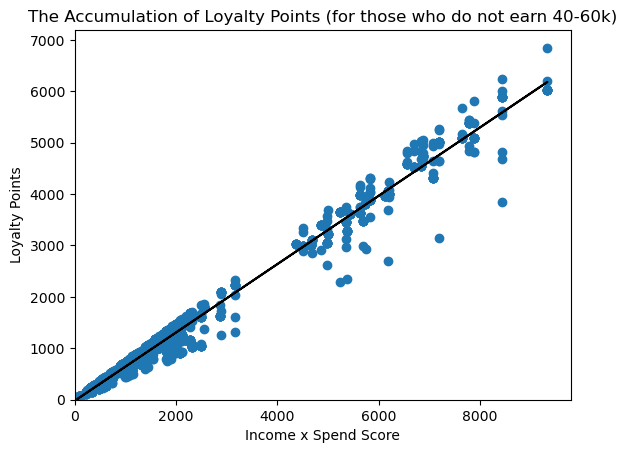

In [427]:
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred, color = 'black')
plt.title("The Accumulation of Loyalty Points (for those who do not earn 40-60k)")
plt.xlabel("Income x Spend Score")
plt.ylabel("Loyalty Points")
# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

Text(0, 0.5, 'loyalty points')

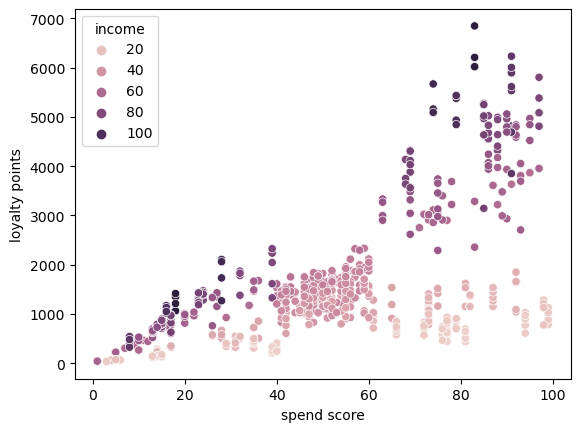

In [428]:
# scatter plot of the whole dataset to desmonstrate the chaos from error(?) in determining the points for the 41-55k inc
sns.scatterplot(data = reviews, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('spend score')
plt.ylabel('loyalty points')

In [429]:
# Determine the points range for all the incomes
income_points_range = reviews.groupby('income')['loyalty_points'].agg(['min', 'max'])
income_points_range.head()

,min,max
income,,
12.30,210,696
13.12,40,706
13.94,233,741
14.76,49,1029
15.58,25,1128


<Axes: xlabel='income'>

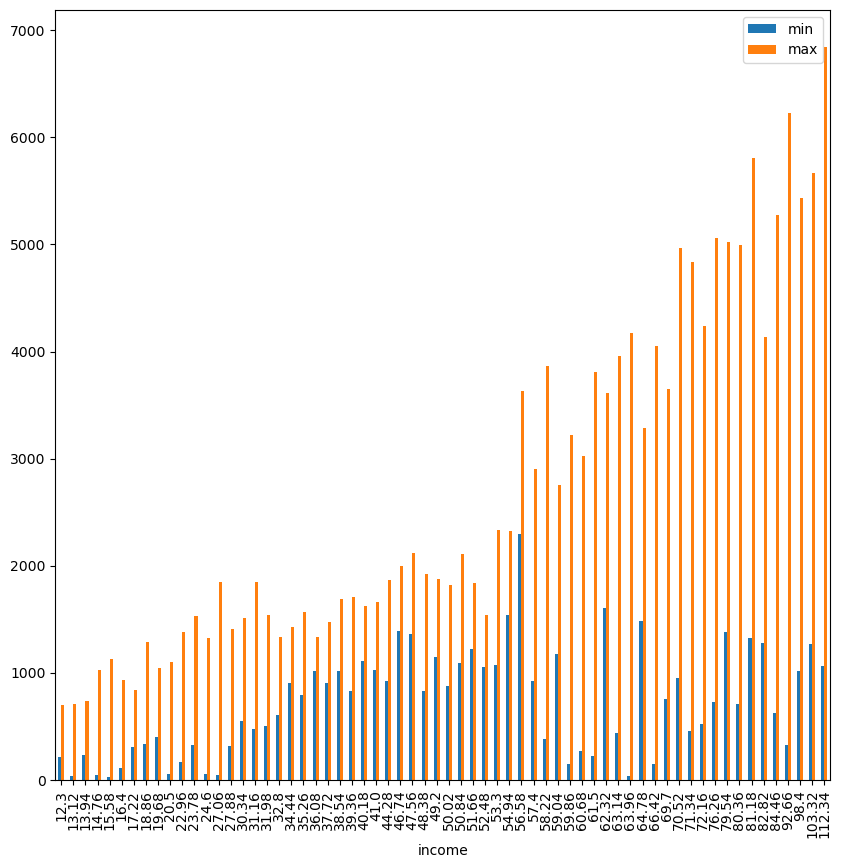

In [430]:
# Graph the data
income_points_range.plot(kind = 'bar', figsize = (10, 10))

This doesn't demonstrate the effect quite as well as I expect, and indeed it demonstrates that there is a slightly higher minimum for this group, which I hadn't noticed before. Regardless, the loyalty points dynamic is not consistent, and needs to be raised with the customers. It may even be deliberate (although if they are asking how the loyalty points are accrued, then this is unlikley).

In [431]:
# Determine the points range for all the incomes
income_points_mean = reviews.groupby('income')['loyalty_points'].agg(['mean'])
income_points_mean.head()

,mean
income,
12.30,411.560000
13.12,316.500000
13.94,478.666667
14.76,447.615385
15.58,488.800000


<Axes: xlabel='income'>

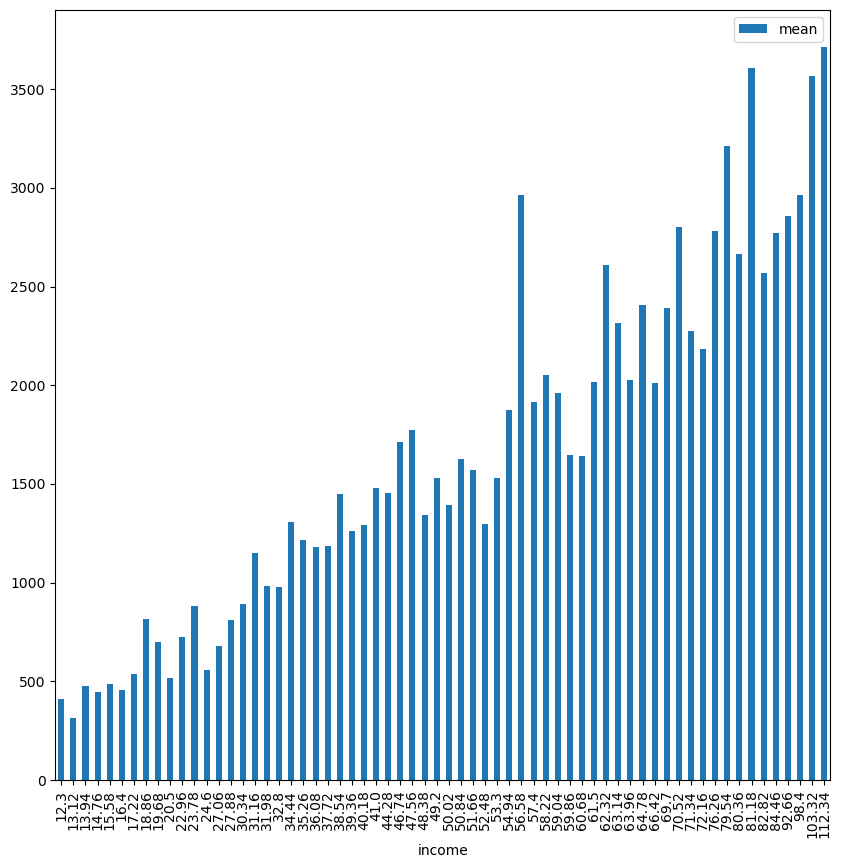

In [432]:
# Graph the data
income_points_mean.plot(kind = 'bar', figsize = (10, 10))

GRaphing the mean doesn't display the effect well, but we will leave it here for the technical viewers.

In [435]:
income_41_to_56.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\1908542917.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  income_41_to_56.corr()


,age,income,score,loyalty_points,product,customer_id
age,1.000000,-0.111293,0.028580,0.436537,0.022600,0.091065
income,-0.111293,1.000000,-0.102239,0.251778,-0.037174,0.057190
score,0.028580,-0.102239,1.000000,0.570353,-0.009035,0.044634
loyalty_points,0.436537,0.251778,0.570353,1.000000,-0.005002,-0.003323
product,0.022600,-0.037174,-0.009035,-0.005002,1.000000,-0.050103
customer_id,0.091065,0.057190,0.044634,-0.003323,-0.050103,1.000000


A much weaker relationship between score and points, and between income and points too. 

Text(0, 0.5, 'points')

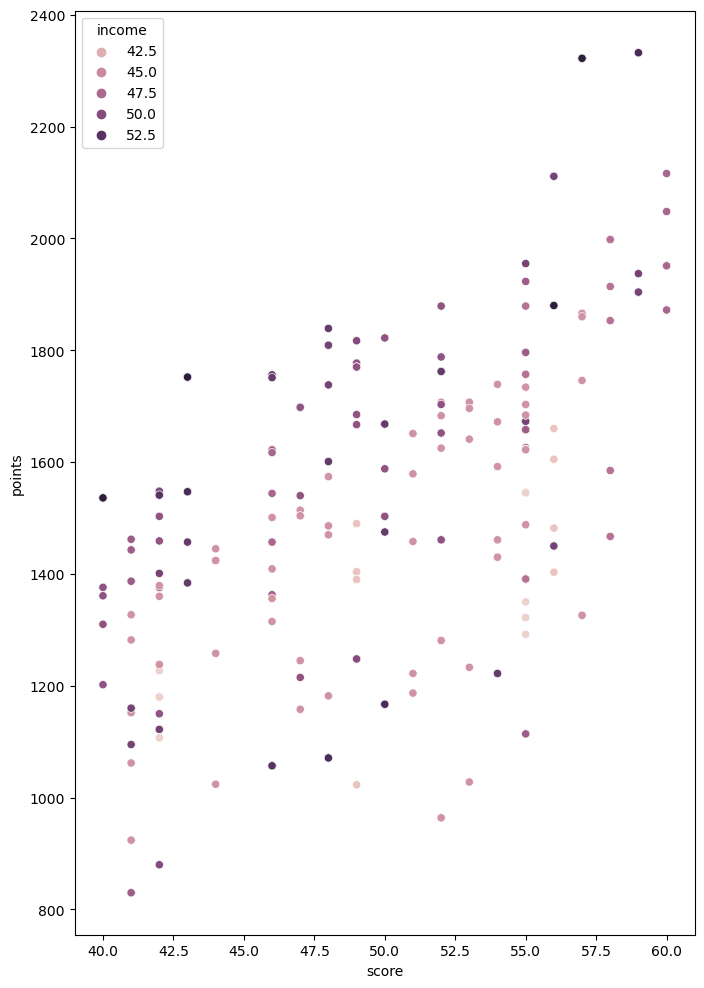

In [436]:
# Plot 
# scatter plot
plt.figure(figsize = (8, 12))
sns.scatterplot(data = income_41_to_56, x = 'score', y = 'loyalty_points', hue = 'income')
plt.xlabel('score')
plt.ylabel('points')

In [439]:
# I'm comfortable with the difference between points and score now, so will change the column heading (points)

# Rename the column headers.
reviews = reviews.rename(columns = {'loyalty_points':'points'})

### 5b) renumeration vs loyalty

In [440]:
# Independent variable.
x = reviews['income']
# Dependent variable.
y = reviews['points']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'
# Create a second variable to store the ols()method. 
test2 = ols(f, data = reviews).fit()

# Print the regression table. 
test2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.380
Model:                            OLS   Adj. R-squared:                  0.379
Method:                 Least Squares   F-statistic:                     1222.
Date:                Mon, 24 Jul 2023   Prob (F-statistic):          2.43e-209
Time:                        23:08:40   Log-Likelihood:                -16674.
No. Observations:                2000   AIC:                         3.335e+04
Df Residuals:                    1998   BIC:                         3.336e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -65.6865     52.171     -1.259      0.208    -168.001      36.628
x             34.1878      0.978     34.960      0.000      32.270      36.106
==============================================================================
Omnibus:                       21.285   Durbin-Watson:                   3.622
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               31.715
Skew:                           0.089   Prob(JB):                     1.30e-07
Kurtosis:                       3.590   Cond. No.                         123.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [441]:
# Extract the estimated parameters.
print("Parameters:", test2.params)

# Extract the standard errors.
print("Standard Errors:", test2.bse)

# Extract the predicted values.
print("Predicted values:", test2.predict())

Parameters: Intercept   -65.686513
x            34.187825
dtype: float64
Standard Errors: Intercept    52.170717
x             0.977925
dtype: float64
Predicted values: [ 354.82374068  354.82374068  382.85775758 ... 3102.15739671 3298.39551499
 3102.15739671]


In [442]:
# Set the the X coefficient and the constant to generate the regression table.
y_pred2 = (-65.686513) +  34.187825 * reviews['income']

# View the output.
y_pred2

0        354.823735
1        354.823735
2        382.857751
3        382.857751
4        410.891767
           ...     
1995    2821.817186
1996    3102.157351
1997    3102.157351
1998    3298.395467
1999    3102.157351
Name: income, Length: 2000, dtype: float64

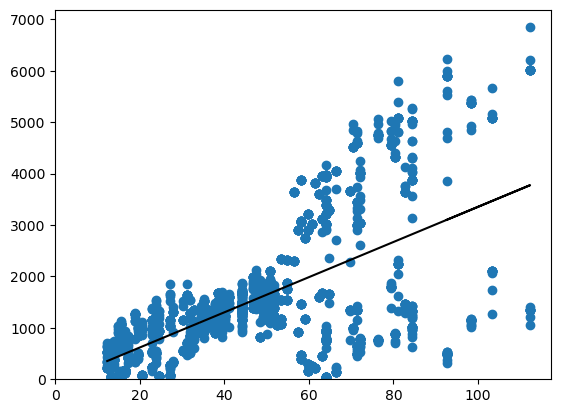

In [443]:
# Plot graph with regression line.
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred2, color = 'black')

# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

**Observations and Insights (remuneration vs loyalty)**
The first thing to notice is that there is indeed a fairly strong positive correlation between income (remuneration) and loyalty points. The second thing to note is how similar the shape of the data, and the regression line are to those in the previous scatter plot, suggesting that there may be a strong correlation in turn between spend and income. However the correlation table does not support that supposition. 

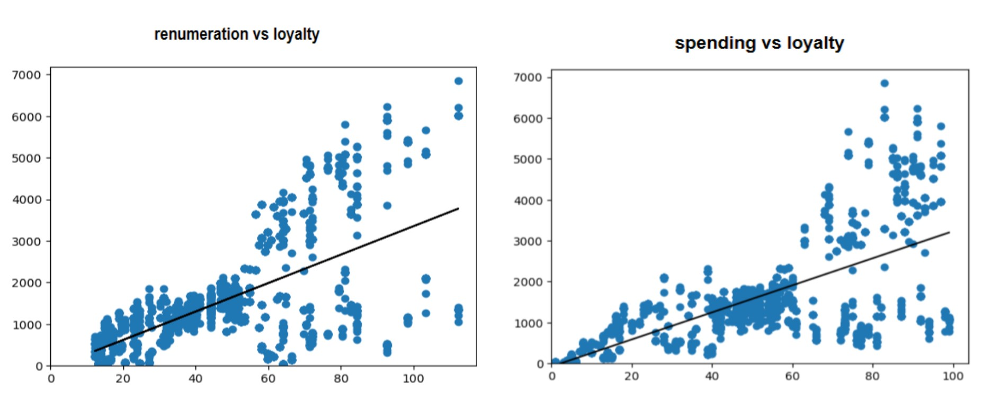

The similarities are probably quite clear, but to be specific: 
- the model is moderately accurate in both cases up until the the 2000 loyalty point mark. After that the model ceases to be very accurate at all, and in fact quite the contrary, indicates (coincidentally or not) a division between the clusters of data points: in one case (left) both groups are those who have a high incomes, but some are being rewarded more and some less than the model would indicate; in the other case (right), among those spending lots, they are largely being rewarded more or quite a lot less than the model woud indicate. 

It would be good to look at the relationship between income (remuneration) and spending, next. Our correlation table above, indicated there is not a strong correlation between the two (ony 0.005612). This is curious, especially considering the similarities of the scatterplots directly above.
This could be due to many factors: it could mean there is no relationship, or that the relationship between income and spend is not linear, there could be a supressor effect operating, for example. 

In [444]:
# Group, pivot and pair plot the data to check again the relationship. 

# Group the data. 


### 5c) spend vs remuneration

In [447]:
# Independent variable.
x = reviews['income']
# Dependent variable.
y = reviews['score']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'
# Create a second variable to store the ols()method. 
test5c = ols(f, data = reviews).fit()

# Print the regression table. 
test5c.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                   0.06294
Date:                Mon, 24 Jul 2023   Prob (F-statistic):              0.802
Time:                        23:09:21   Log-Likelihood:                -9360.8
No. Observations:                2000   AIC:                         1.873e+04
Df Residuals:                    1998   BIC:                         1.874e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     49.6955      1.347     36.899      0.000      47.054      52.337
x              0.0063      0.025      0.251      0.802      -0.043       0.056
==============================================================================
Omnibus:                      256.861   Durbin-Watson:                   3.699
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               66.806
Skew:                          -0.044   Prob(JB):                     3.11e-15
Kurtosis:                       2.109   Cond. No.                         123.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [448]:
# Extract the estimated parameters.
print("Parameters:", test5c.params)

# Extract the standard errors.
print("Standard Errors:", test5c.bse)

# Extract the predicted values.
print("Predicted values:", test5c.predict())

Parameters: Intercept    49.695490
x             0.006334
dtype: float64
Standard Errors: Intercept    1.346809
x            0.025246
dtype: float64
Predicted values: [49.77339247 49.77339247 49.77858596 ... 50.28235444 50.31870887
 50.28235444]


In [449]:
# Set the the X coefficient and the constant to generate the regression table.
y_pred5c = (49.695490) +  0.006334 * reviews['income']

# View the output.
y_pred5c

0       49.773398
1       49.773398
2       49.778592
3       49.778592
4       49.783786
          ...    
1995    50.230460
1996    50.282398
1997    50.282398
1998    50.318756
1999    50.282398
Name: income, Length: 2000, dtype: float64

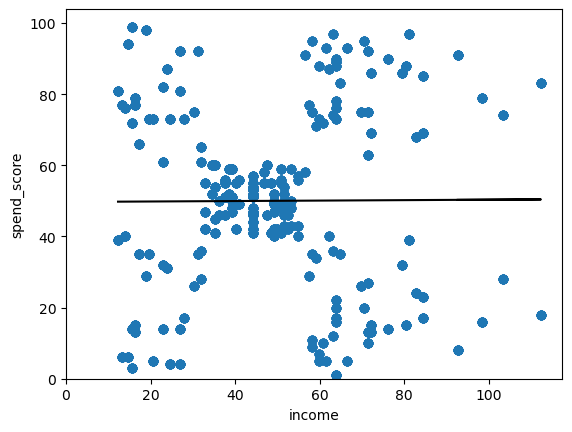

In [450]:
# Plot graph with regression line.
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred5c, color = 'black')


plt.xlabel('income')
plt.ylabel('spend_score')
# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

This is intriguing - although there is clearly not a good fit between the model here and the data, and the data doesn't have a linear correlation, the data has a very clear (though not perfect) symmetry around the regression line, with clear clusters. Because these two factors (income and spend_score) each have a strong impact on points, it would be good to look into this further with alternative approaches, later in the analysis.  

If we can take anything from this present visualisation, it's that there may be a striating / polarising / clustering effect on spend for different income brackets, for example: 

- income < 30k: either earn <40, or >60 points. 
- income between 30k and 60k: the model is good at predicting, partly because there is a lot of data in this group. They're closely clustered, but within that there are three subclusters which are peculiar: there is an income amount (nk) which is almost dividing and sheparding the outcomes into three groups: those who earn <nk, those who earn nk, and those who earn >nk. 
- income>approk 60k: again either earn <40, or >60 points. There are perhaps some linear correlations to be determined, within ieach of therse groups that looks at this stage, as a very early analysis, to be a positive correlation in the low scorers (the more they earn the more they score, if they score less than 40), and a negative correlation in the high points scoreres (the more they earn, the less they spend, if they spend more than 60). 

All these groups will require further analysis, which we wil get to later in the process. One way to do this is to look at oher factors such as age - age being one of the higher correlations identified in our correlation table. 

### 5d) age vs loyalty

In [451]:
# Independent variable.
x = reviews['age']
# Dependent variable.
y = reviews['points']
# OLS model and summary.
# Create the formula and pass through OLS methods.
# Create a variable to store the R-style formula. 
f = 'y ~ x'
# Create a second variable to store the ols()method. 
test3 = ols(f, data = reviews).fit()

# Print the regression table. 
test3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     3.606
Date:                Mon, 24 Jul 2023   Prob (F-statistic):             0.0577
Time:                        23:09:30   Log-Likelihood:                -17150.
No. Observations:                2000   AIC:                         3.430e+04
Df Residuals:                    1998   BIC:                         3.431e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1736.5177     88.249     19.678      0.000    1563.449    1909.587
x             -4.0128      2.113     -1.899      0.058      -8.157       0.131
==============================================================================
Omnibus:                      481.477   Durbin-Watson:                   2.277
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              937.734
Skew:                           1.449   Prob(JB):                    2.36e-204
Kurtosis:                       4.688   Cond. No.                         129.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [452]:
# Extract the estimated parameters.
print("Parameters:", test3.params)

# Extract the standard errors.
print("Standard Errors:", test3.bse)

# Extract the predicted values.
print("Predicted values:", test3.predict())

Parameters: Intercept    1736.517739
x              -4.012805
dtype: float64
Standard Errors: Intercept    88.248731
x             2.113177
dtype: float64
Predicted values: [1664.2872467  1644.22322095 1648.2360261  ... 1600.0823643  1600.0823643
 1608.1079746 ]


In [453]:
# Set the the X coefficient and the constant to generate the regression table.
y_pred3 = (1736.517739) +  -4.012805 * reviews['age']

# View the output.
y_pred3

0       1664.287249
1       1644.223224
2       1648.236029
3       1636.197614
4       1604.095174
           ...     
1995    1588.043954
1996    1563.967124
1997    1600.082369
1998    1600.082369
1999    1608.107979
Name: age, Length: 2000, dtype: float64

In [454]:
# Set the the X coefficient and the constant to generate the regression table.
y_pred3 = (1736.517739) +  -4.012805 * reviews['age']

# View the output.
y_pred3

0       1664.287249
1       1644.223224
2       1648.236029
3       1636.197614
4       1604.095174
           ...     
1995    1588.043954
1996    1563.967124
1997    1600.082369
1998    1600.082369
1999    1608.107979
Name: age, Length: 2000, dtype: float64

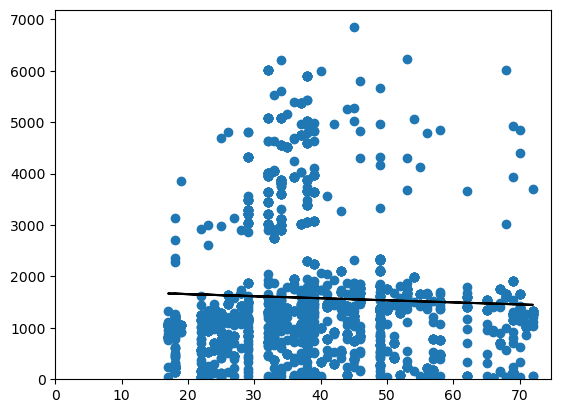

In [455]:
# Plot graph with regression line.
# Plot the graph with a regression line.
# Plot the data points. 
plt.scatter(x,y)

# Plot the regression line. 
plt.plot(x, y_pred3, color = 'black')

# Plot the x and y limits on the axes. 
plt.xlim(0)
plt.ylim(0)
plt.show()

**Observations and Insights (age vs loyalty)**

Here there model suggests there is a slight negative correlation between age and loyalty points - ie the older the customer, the few points they receive.

But the average across all ages is only ever within a very small range - this could be determined further. But for now it appears that there are some anomalies here more immediately of interest. For example there are two main clusters (one below and one above about 200 loyalty points, with a gap between them; there appear to be more customers in the 30ish age bracket than in other age bracketsl and there are some curious gaps in the data (at least in the lower cluster) around the decade mark - suggesting eronious data or processes may be in action, that may be worth looking into further.

Regardless of age, this visualisation shows that few customers overall, earn more than 2000 points. What is it about those customers which means they earn more points? 

We can look into this further by grouping the dataset into those who have earned more, and those who have earned less, than  200 points. 

In [456]:
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5


In [457]:
# Make a copy of the review df where the loyalty points are over 2000. 
high_points = reviews[reviews['points'] > 2000].copy()
high_points.describe()

,age,income,score,points,product,customer_id
count,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000
mean,36.593052,72.544566,78.163772,3782.114144,5623.679901,202.965261
std,7.584230,14.521131,14.354710,1018.135845,3051.273910,76.312357
min,18.000000,47.560000,28.000000,2044.000000,107.000000,98.000000
25%,32.000000,62.320000,71.500000,3042.000000,3153.000000,130.000000
50%,35.000000,70.520000,79.000000,3654.000000,5453.000000,164.000000
75%,38.000000,81.180000,89.000000,4555.000000,7586.500000,281.500000
max,72.000000,112.340000,97.000000,6847.000000,11086.000000,324.000000


In [458]:
# Make a copy of the review df where the loyalty points equal to or less than 2000. 
low_points = reviews[reviews['points'] <= 2000].copy()
low_points.describe()

,age,income,score,points,product,customer_id
count,1597.000000,1597.000000,1597.000000,1597.000000,1597.000000,1597.000000
mean,40.227301,41.905235,42.892924,1021.835942,3991.671885,150.608015
std,14.615080,20.672346,23.455107,514.966807,3088.289385,93.749756
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,29.000000,23.780000,23.000000,621.000000,1463.000000,70.000000
50%,38.000000,39.360000,46.000000,1122.000000,3427.000000,134.000000
75%,49.000000,51.660000,55.000000,1409.000000,6424.000000,242.000000
max,72.000000,112.340000,99.000000,1998.000000,11086.000000,323.000000


In [459]:
high_points.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\970776251.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  high_points.corr()


,age,income,score,points,product,customer_id
age,1.000000,-0.004391,-0.231487,0.011235,-0.146345,0.029262
income,-0.004391,1.000000,-0.052559,0.652526,-0.269883,0.206407
score,-0.231487,-0.052559,1.000000,0.652487,0.102059,0.176362
points,0.011235,0.652526,0.652487,1.000000,-0.154206,0.270515
product,-0.146345,-0.269883,0.102059,-0.154206,1.000000,-0.138995
customer_id,0.029262,0.206407,0.176362,0.270515,-0.138995,1.000000


In [460]:
low_points.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2048377129.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  low_points.corr()


,age,income,score,points,product,customer_id
age,1.000000,0.067286,-0.196405,0.142807,0.049049,0.095691
income,0.067286,1.000000,-0.434942,0.320772,0.325410,0.493446
score,-0.196405,-0.434942,1.000000,0.510464,-0.178111,-0.219484
points,0.142807,0.320772,0.510464,1.000000,0.089043,0.122867
product,0.049049,0.325410,-0.178111,0.089043,1.000000,0.187765
customer_id,0.095691,0.493446,-0.219484,0.122867,0.187765,1.000000


Admittedly the high points dataset is only a quarter the size of the other low points dataset, with the former only ahveing a count of 500.

But...

The high points group has almost double the mean income of the low points group. 

There is a much higher correlation between income and score for the lower points group (.4 v .05).

There is a stronger relationship between income and points in the higher points group (.7 v .3).

The relationship between age and score is not very different between the two groups. Not is it very different between points and score. 

There is not a very strong relationship between product and points in either group, but that being said it is nearly twice as strong in the higher points group, where it is negative (-.15) compared to the lower points group, where there is a positive correlation, albeit smaller (.089).

Although the correlation between age and points is low for both groups, it is very much weaker for the high points cohort.

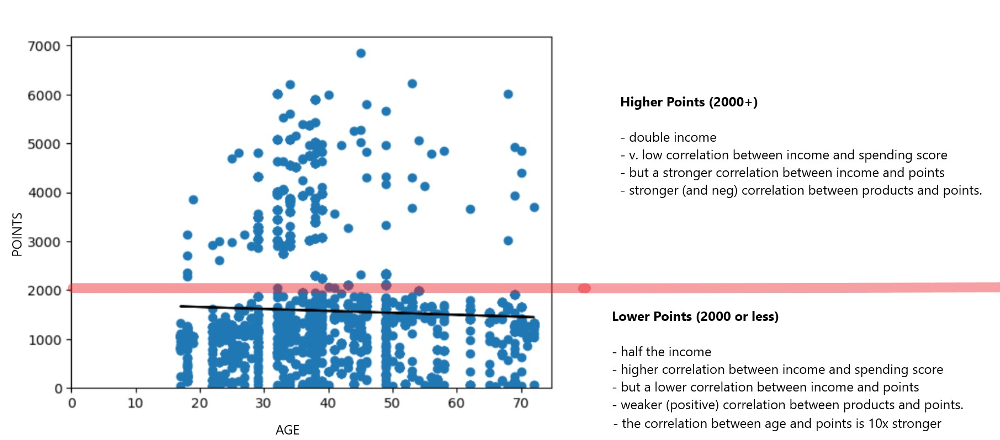




## Product
Another insight into spending behaviours (which loyalty poins are based on) is possibly what the customer is buying. I want to know if products always earn the same spend score and loyalty points. It will help elucidate what 'behaviour' means. We can't know from this dataset if customers are buying more than one item (which would certainly pertain to spending behviour). So let's dig into what we can find out about what points and spending scores are assocaited with the various products bought. 

It's important to keep in mind that all the data in this dataset is asscoaited with purchases where a review was shared. In other words, people / purchases without a review, are not included in this dataset. This is something we will need to convey to the company so they know it may not reflect all purchasers. Maybe some peopel are more likely to leave reviews tahn others. Maybe leaving a review mean you are more likely to get loyalty points? Maybe some of the cusomers here make other purchases and don't leave reviews. Etc. We can also probably say that these purchases are those made by customres who are generally more engaged in aspects of the customer / vendor relationship beyond simply accessing the products, which if true may be relevant to their engagement with loyalty points. 

In [461]:
# Sort the df by spend_score and identify which products are present in the top scores. 
reviews.sort_values('score', ascending = False, inplace = True)
reviews.head(15)

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14
611,Female,37,15.58,99,1067,postgraduate,123,We are giving a set to each of our families i...,We will be able to tell better after Easter we...,61-100,0 -20,14
1841,Male,26,15.58,99,881,PhD,9529,Love this game.,Five Stars,61-100,0 -20,187
1883,Female,44,15.58,99,1128,PhD,2285,Fun and entertaining.,Four Stars,61-100,0 -20,11
1211,Female,37,15.58,99,1067,postgraduate,2162,I like the minis and the game is good too. I h...,good item,61-100,0 -20,14
1812,Female,57,15.58,99,1122,PhD,811,We've been playing this game for about 18 mont...,Great game for all ages!,61-100,0 -20,11


Okay - pausing this investigation because that sorting procedure has made it clear that we probably have a way to identify individual customers purchasing several times, using this data. That possibilty is too exciting to ignore, or to leave till later. The usefulness to our stakeholders if we can do this, may be significant. 

Identifying cusomers may not be possible for lower scores. It may be possible for higher scores. Why? Higher score earners are possibly return purchasers, so their attributes across columns like income, age, education and gender may be enough to give us at least a possible, if not certain, depiction of what these return customers are doing. 

We don't know yet, and may not be able to find out, if the same customer might be featured here with different spend scores  - for example if a customer has 98, makes a significant purchase, and then gets bumped up to 99. But we can group the customers by their scores to start with, and then see if we can identify some intital possible IDs. 

Of course we can follow the same process with points - this being part of TG's focus. 

In [462]:
# Group the dataframe in a new df, where all the customer data the same. 
customers = reviews.groupby(['gender', 'income','education'])
customers.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14
...,...,...,...,...,...,...,...,...,...,...,...,...
1208,Male,66,15.58,3,31,PhD,760,The figures alone are worth the price. Faction...,Faction Pack is a win.,0-40,0 -20,187
408,Male,66,15.58,3,31,PhD,1459,great,Five Stars,0-40,0 -20,187
8,Male,66,15.58,3,31,PhD,1031,Could be better but its still great. I love th...,Great but could be even better,0-40,0 -20,187
1880,Male,56,15.58,3,34,graduate,9875,Goes good with the game.,Four Stars,0-40,0 -20,189


Already we can see that even at the lower spend score values there are likely to be some repeat custom. Maybe the purchases are made over a long period of time? Can we identify combinations of products or products that are associated with low scores? (Similar to where we began this mini exploration). 

But for now we wil continue looking into high scores. 



In [463]:
# Add a new column with a unique customer ID where the first 6 columns (excepting index) are the same.
# Make a copy of the reviews df 
reviews1 = reviews
reviews1['customer_id'] = customers.ngroup()
reviews1 = reviews1.reset_index()
reviews1.head()

,index,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1,1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
2,1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
3,1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
4,811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14


Even if these aren't the same person (eg if there are two or more 39 year old male customers with a postgraduate degree and an income of 63.96k), who are erroniously identified as being one person, we're still going to get valuable insight from this about demographics and their correlations with score, points, etc.

Make a copy of the reviews1 df which drops the duplicate rows for each (possible) cutomer and, necessarily, their products. 

In [464]:
# Drop unnecessary columns.
reviews1_2= reviews1.drop(['review','summary','index'], axis = 1)
reviews1_2.head()

,gender,age,income,score,points,education,product,score_bracket,income_bracket,customer_id
0,Female,37,15.58,99,1067,postgraduate,1497,61-100,0 -20,14
1,Female,38,15.58,99,1078,graduate,6271,61-100,0 -20,13
2,Female,37,15.58,99,1067,postgraduate,577,61-100,0 -20,14
3,Female,33,15.58,99,1012,graduate,2162,61-100,0 -20,13
4,Female,37,15.58,99,1067,postgraduate,1183,61-100,0 -20,14


In [465]:
# Drop duplicate rows
reviews1_3=reviews1_2.drop_duplicates()

In [466]:
reviews1_3.head()

,gender,age,income,score,points,education,product,score_bracket,income_bracket,customer_id
0,Female,37,15.58,99,1067,postgraduate,1497,61-100,0 -20,14
1,Female,38,15.58,99,1078,graduate,6271,61-100,0 -20,13
2,Female,37,15.58,99,1067,postgraduate,577,61-100,0 -20,14
3,Female,33,15.58,99,1012,graduate,2162,61-100,0 -20,13
4,Female,37,15.58,99,1067,postgraduate,1183,61-100,0 -20,14


In [467]:
reviews1_3.describe()

,age,income,score,points,product,customer_id
count,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000
mean,39.488036,48.002170,49.989983,1575.977741,4325.957707,160.823595
std,13.576661,23.323395,26.110949,1289.865220,3148.838110,93.145524
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,29.000000,30.340000,32.000000,772.000000,1592.000000,86.000000
50%,38.000000,46.740000,50.000000,1272.000000,3629.000000,154.000000
75%,49.000000,63.960000,73.000000,1738.000000,6678.000000,251.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000


In [468]:
# Make a new column which counts hwo many purchases each customer has made. 
reviews1_4=reviews1_2
reviews1_4['purchase_count'] = reviews1_4.groupby('customer_id')['customer_id'].transform('count')
reviews1_4.head()

,gender,age,income,score,points,education,product,score_bracket,income_bracket,customer_id,purchase_count
0,Female,37,15.58,99,1067,postgraduate,1497,61-100,0 -20,14,10
1,Female,38,15.58,99,1078,graduate,6271,61-100,0 -20,13,9
2,Female,37,15.58,99,1067,postgraduate,577,61-100,0 -20,14,10
3,Female,33,15.58,99,1012,graduate,2162,61-100,0 -20,13,9
4,Female,37,15.58,99,1067,postgraduate,1183,61-100,0 -20,14,10


In [469]:
# Check score distributi

In [478]:
# Generate a correlation table. 
reviews1_4.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\2945623202.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews1_4.corr()


,age,income,score,points,product,customer_id,purchase_count
age,1.000000,-0.005708,-0.224334,-0.042445,0.003081,0.061429,-0.009858
income,-0.005708,1.000000,0.005612,0.616065,0.305309,0.497067,-0.000005
score,-0.224334,0.005612,1.000000,0.672310,-0.001649,-0.020297,-0.002828
points,-0.042445,0.616065,0.672310,1.000000,0.183600,0.270348,0.002424
product,0.003081,0.305309,-0.001649,0.183600,1.000000,0.173149,-0.008546
customer_id,0.061429,0.497067,-0.020297,0.270348,0.173149,1.000000,0.091680
purchase_count,-0.009858,-0.000005,-0.002828,0.002424,-0.008546,0.091680,1.000000


To review, we have attempted to identify individual customers from the patterns within individual purchase data, and  we are now looking at what may be individual customers and their numerical data.

Should scale the age data, maybe in age brackets, to see whether there is a group that is spending more and needs more attention. 

In [479]:
# Output a list of the values in the count-of-purchase column. 
count_of_purchases = reviews1_4['purchase_count'].unique().tolist()
count_of_purchases

[10,
 9,
 12,
 6,
 1,
 2,
 4,
 14,
 21,
 8,
 7,
 16,
 25,
 11,
 3,
 23,
 15,
 18,
 17,
 20,
 19,
 22,
 13,
 33,
 27,
 46]

Surprising as it seems - at least according to the aggregation we've performed, two groups - those who've purchased 1-2 items, those who have purchses 7-9 items,If this is true (and it may not be) we are dealing with an interesting set of three cohorts which may very well be useful groupings for further analyses. It is still possible that regardless of whether this is true or not (ie that we have identified unique customers) we have some insight here into demographics-based behaviours. Must explore the risks and assumptions here.  

What can we find out abut the three groups? 
If this is true, why do they stop at 9? or 2? Does this reflect the age of the business?

Make new dfs that group these tentative (somewhat spurious) cohorts.

Do customers get a new spend score when they buy more than 2 things, so they are appearing as two different customers in this dataset? 

Is it still useful to explore further - ie do points (and spend) work differently depending on how many purchases are made? 

In [480]:
# Make the new dfs. 
bought_7_plus = reviews1_4[reviews1_4['purchase_count']>=7].copy()
bought_7_plus.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1694 entries, 0 to 1999
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   gender          1694 non-null   object 
 1   age             1694 non-null   int64  
 2   income          1694 non-null   float64
 3   score           1694 non-null   int64  
 4   points          1694 non-null   int64  
 5   education       1694 non-null   object 
 6   product         1694 non-null   int64  
 7   score_bracket   1694 non-null   object 
 8   income_bracket  1694 non-null   object 
 9   customer_id     1694 non-null   int64  
 10  purchase_count  1694 non-null   int64  
dtypes: float64(1), int64(6), object(4)
memory usage: 158.8+ KB


In [481]:
bought_7_plus.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\1438303880.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  bought_7_plus.corr()


,age,income,score,points,product,customer_id,purchase_count
age,1.000000,0.008662,-0.244582,-0.056166,0.004816,0.070595,0.022996
income,0.008662,1.000000,0.010837,0.608774,0.352278,0.494999,-0.019515
score,-0.244582,0.010837,1.000000,0.689560,-0.003720,-0.033718,0.000118
points,-0.056166,0.608774,0.689560,1.000000,0.199195,0.259101,-0.006528
product,0.004816,0.352278,-0.003720,0.199195,1.000000,0.189329,-0.004642
customer_id,0.070595,0.494999,-0.033718,0.259101,0.189329,1.000000,0.127814
purchase_count,0.022996,-0.019515,0.000118,-0.006528,-0.004642,0.127814,1.000000


Does loyalty and spend score have ahigher correlation for the higher earners? 

Do certain products have more points / score associated with them? 

It's hard to ascertain this when a customer's score / points are each an accumulation of their total spend and they've bought several products. So look at the customers who have only bought one product. Even if they aren't really individual customers (eg if their income / points etc have changed during the time they've been in the system) then it's still hopefully going to give us a rough idea. 

There's a good sized dataset here regarding 

What can we find out about the (possible) multiple spending customers?

In [484]:
reviews1_4.describe()

,age,income,score,points,product,customer_id,purchase_count
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000,11.964000
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397,8.465964
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000,1.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000,7.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000,9.000000
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000,15.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000,46.000000


In [485]:
bought_7_plus.describe()

,age,income,score,points,product,customer_id,purchase_count
count,1694.000000,1694.000000,1694.000000,1694.000000,1694.000000,1694.000000,1694.000000
mean,39.171192,48.461806,49.986423,1591.030106,4311.128689,160.283353,13.665880
std,13.413686,21.876845,25.690358,1246.868992,3151.632205,92.174595,8.080476
min,17.000000,12.300000,1.000000,30.000000,107.000000,2.000000,7.000000
25%,29.000000,32.800000,34.250000,830.000000,1581.000000,88.000000,8.000000
50%,38.000000,48.380000,50.000000,1314.000000,3619.000000,144.000000,10.000000
75%,46.000000,63.960000,72.000000,1755.000000,6678.000000,251.000000,17.000000
max,72.000000,112.340000,99.000000,6020.000000,11086.000000,323.000000,46.000000


Comparing the 7+ to the overall dataset:
- same mean age
- it's 3/4 of the original dataset
- income very similar 
- slightly higher mean loyalty points
- mean spend score is lower
- mean purchase number is higher (and mean of whoel dataset is 5)
 

In [486]:
# How do score and points change with successive purchases? 
bought_7_plus = bought_7_plus.sort_values('customer_id')
bought_7_plus.head(40)

,gender,age,income,score,points,education,product,score_bracket,income_bracket,customer_id,purchase_count
1905,Female,22,13.12,6,40,graduate,263,0-40,0 -20,2,19
1889,Female,22,13.12,6,40,graduate,263,0-40,0 -20,2,19
1902,Female,22,13.12,6,40,graduate,1241,0-40,0 -20,2,19
1894,Female,22,13.12,6,40,graduate,123,0-40,0 -20,2,19
1898,Female,38,13.12,6,55,graduate,7532,0-40,0 -20,2,19
1888,Female,22,13.12,6,40,graduate,1463,0-40,0 -20,2,19
1901,Female,25,13.12,6,44,graduate,2173,0-40,0 -20,2,19
1885,Female,22,13.12,6,40,graduate,979,0-40,0 -20,2,19
366,Female,25,13.12,77,562,graduate,486,61-100,0 -20,2,19
363,Female,25,13.12,77,562,graduate,1473,61-100,0 -20,2,19


C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 86.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 68.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 77.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 76.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\User\anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 66.7% of the points cann

<Axes: xlabel='income', ylabel='age'>

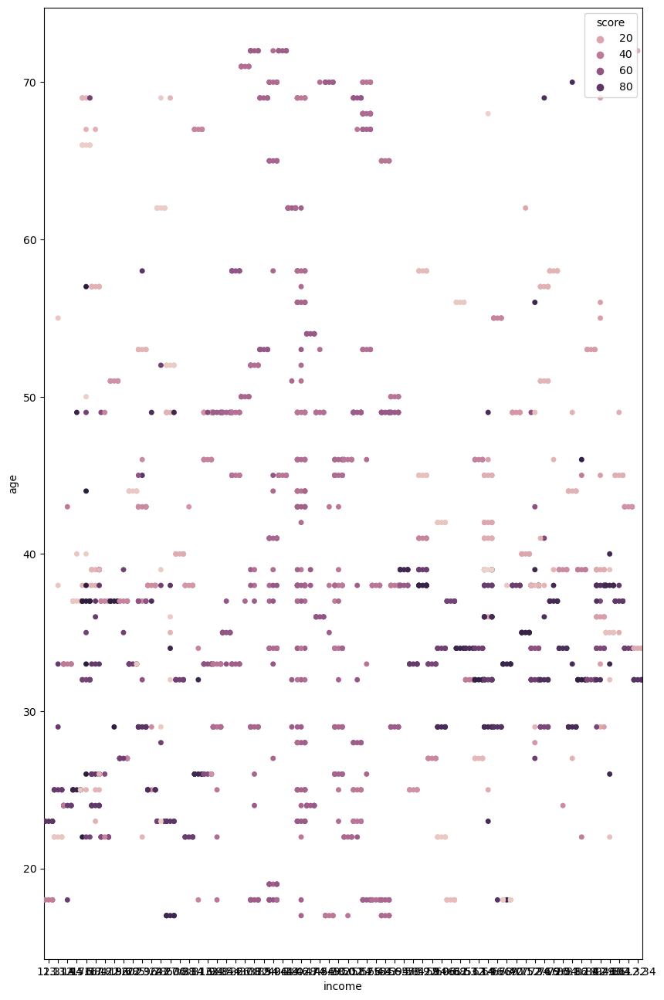

In [487]:
plt.figure(figsize = (10,16))
sns.swarmplot(data = bought_7_plus, x = 'income', y = 'age', hue = 'score')

In [488]:
# Add an income * age column to see what we can then see in a correlation table. 
# Subset further eg by gender, education, etc. 

reviews1_9 = reviews1_4
reviews1_9['inc_age'] = reviews1_9['income'] * reviews1_9['age']
reviews1_9.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\1806439082.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reviews1_9.corr()


,age,income,score,points,product,customer_id,purchase_count,inc_age
age,1.000000,-0.005708,-0.224334,-0.042445,0.003081,0.061429,-0.009858,0.531824
income,-0.005708,1.000000,0.005612,0.616065,0.305309,0.497067,-0.000005,0.807831
score,-0.224334,0.005612,1.000000,0.672310,-0.001649,-0.020297,-0.002828,-0.102207
points,-0.042445,0.616065,0.672310,1.000000,0.183600,0.270348,0.002424,0.466632
product,0.003081,0.305309,-0.001649,0.183600,1.000000,0.173149,-0.008546,0.238182
customer_id,0.061429,0.497067,-0.020297,0.270348,0.173149,1.000000,0.091680,0.424236
purchase_count,-0.009858,-0.000005,-0.002828,0.002424,-0.008546,0.091680,1.000000,0.010257
inc_age,0.531824,0.807831,-0.102207,0.466632,0.238182,0.424236,0.010257,1.000000


In [491]:
DF3_3

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,Female,37,84.46,69,4031,PhD,977,The perfect word game for mixed ages (with Mom...,The perfect word game for mixed ages (with Mom,61-100,80+,161
1996,Female,43,92.66,8,539,PhD,979,Great game. Did not think I would like it whe...,Super fun,0-40,80+,165
1997,Male,34,92.66,91,5614,graduate,1012,Great game for all.........\nKeeps the mind ni...,Great Game,61-100,80+,316
1998,Male,34,98.40,16,1048,PhD,1031,fun game!,Four Stars,0-40,80+,319


<Axes: xlabel='score_bracket', ylabel='age'>

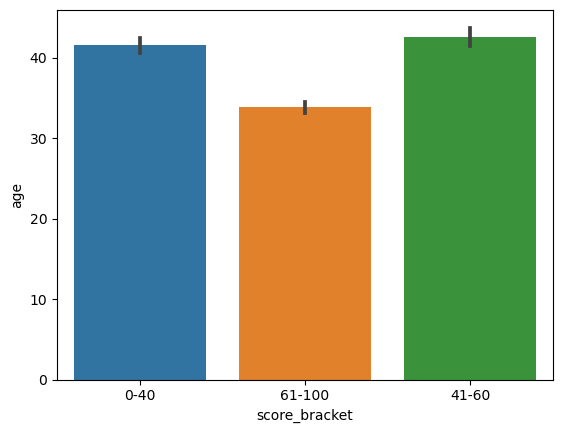

In [492]:
# What is the average age for each score bracket? 

sns.barplot(data = DF3_3, x = 'score_bracket', y = 'age')

<Axes: xlabel='income_bracket', ylabel='age'>

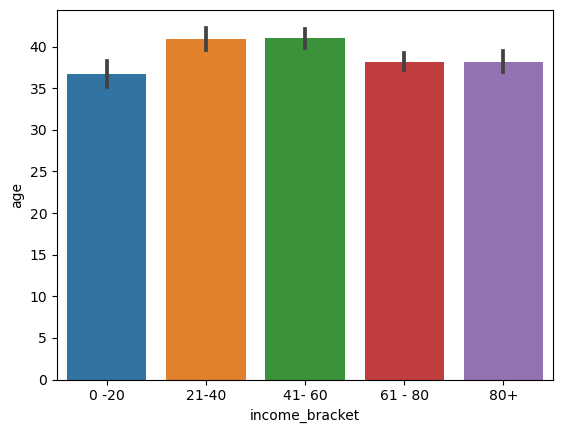

In [493]:
# What is the average age for each income bracket? 

sns.barplot(data = DF3_3, x = 'income_bracket', y = 'age')

<Axes: xlabel='points', ylabel='age'>

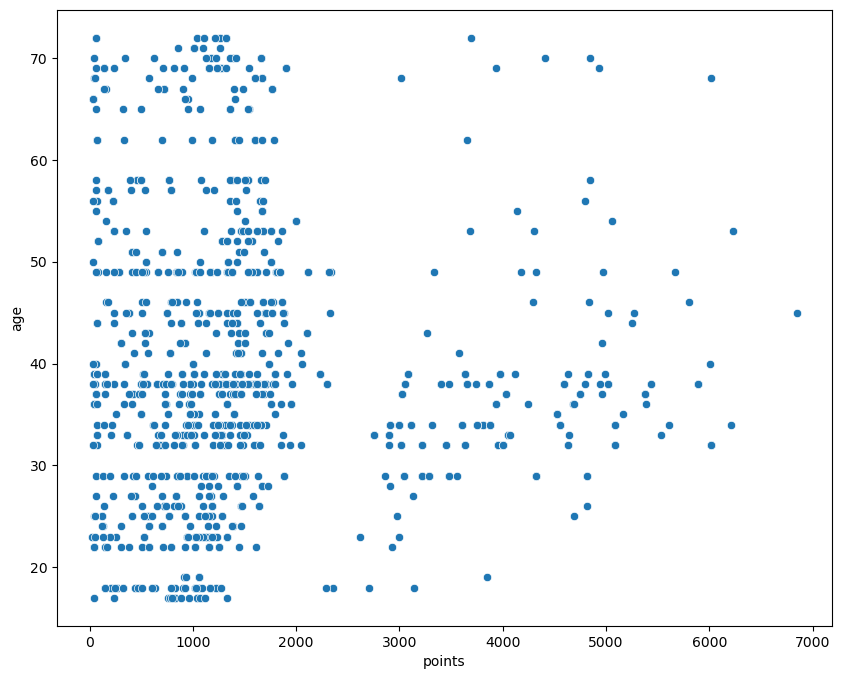

In [494]:
# What is the average age for points values? 
plt.figure(figsize = (10,8))
sns.scatterplot(data = DF3_3, x = 'points', y = 'age')



Confirming that if you want to get a lot of points you have to be between 20ish and 45ish. Should look into this more. Futher analysis below:

In [497]:
# Make the new dfs. 
bought1_to_2 = reviews1_4[reviews1_4['purchase_count']<=2].copy()
bought1_to_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 175 entries, 15 to 1970
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   gender          175 non-null    object 
 1   age             175 non-null    int64  
 2   income          175 non-null    float64
 3   score           175 non-null    int64  
 4   points          175 non-null    int64  
 5   education       175 non-null    object 
 6   product         175 non-null    int64  
 7   score_bracket   175 non-null    object 
 8   income_bracket  175 non-null    object 
 9   customer_id     175 non-null    int64  
 10  purchase_count  175 non-null    int64  
 11  inc_age         175 non-null    float64
dtypes: float64(2), int64(6), object(4)
memory usage: 17.8+ KB


There aren't as many, at approximately 600, but it's still fairly large dataset. Just need to be careful about subsets within this set as they are going to necessarily get even smaller

In [498]:
bought1_to_2.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_9840\681565242.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  bought1_to_2.corr()


,age,income,score,points,product,customer_id,purchase_count,inc_age
age,1.000000,-0.022122,-0.103296,0.052349,0.111995,0.012221,-0.106057,0.446450
income,-0.022122,1.000000,0.011354,0.650537,0.097088,0.418796,0.038987,0.840347
score,-0.103296,0.011354,1.000000,0.637851,-0.033289,0.065126,-0.073407,0.012891
points,0.052349,0.650537,0.637851,1.000000,0.084334,0.263406,-0.009869,0.609894
product,0.111995,0.097088,-0.033289,0.084334,1.000000,0.145564,0.004082,0.122490
customer_id,0.012221,0.418796,0.065126,0.263406,0.145564,1.000000,0.061679,0.368115
purchase_count,-0.106057,0.038987,-0.073407,-0.009869,0.004082,0.061679,1.000000,-0.015752
inc_age,0.446450,0.840347,0.012891,0.609894,0.122490,0.368115,-0.015752,1.000000


- much stronger correlation betwen age and purchase count. 
- very much weaker relationship between age and spend score
- a positive relationship between age and income (it is negative in the other dataset). 
- weaker relationship between product and income (their purchases aren't as income dependent - but remember that product is erroneously numerical anyway). 
- much stronger relationship between purchase count and income. Their income is determining how much they buy MORE than the other (higher purchase) group. We can guess there are fewer buying less who could afford more, than there are those buying more who don't necessarily have as much spending capacity. Maybe one group has fewer financial commitments (this could be true of much older and much younger customers tho, which would make determing the average a not unproblematic way to proceed). 
- weaker relationship between spend score and age
- stronger relationship between spend score and purchase count. 
- a positive relationship between loyalty points and age, whereas it's negative in the other dataset. 
- similar relationship between points and income. 
- a stronger relationship between purcahse count and loyalty points, AND it's negative. It's not a strong correlation, but maybe this is concerning anyway? 


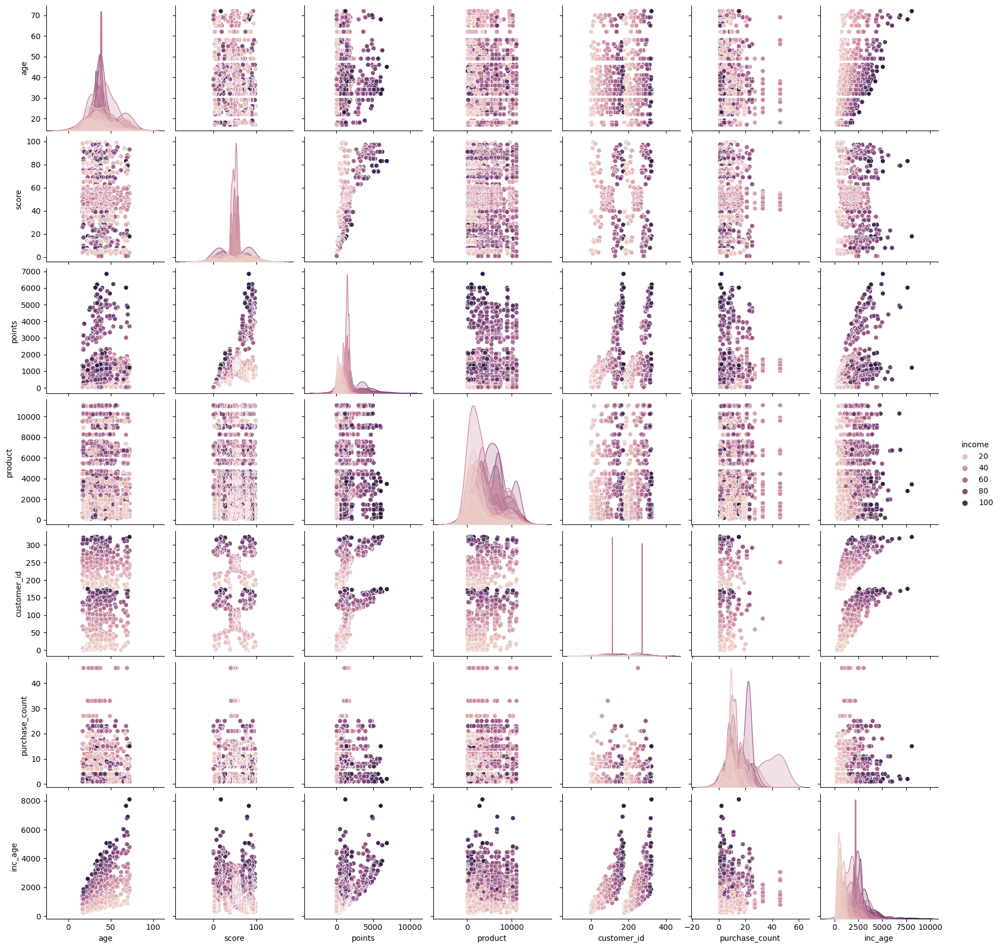

In [503]:
sns.pairplot(reviews1_4, hue = 'income')

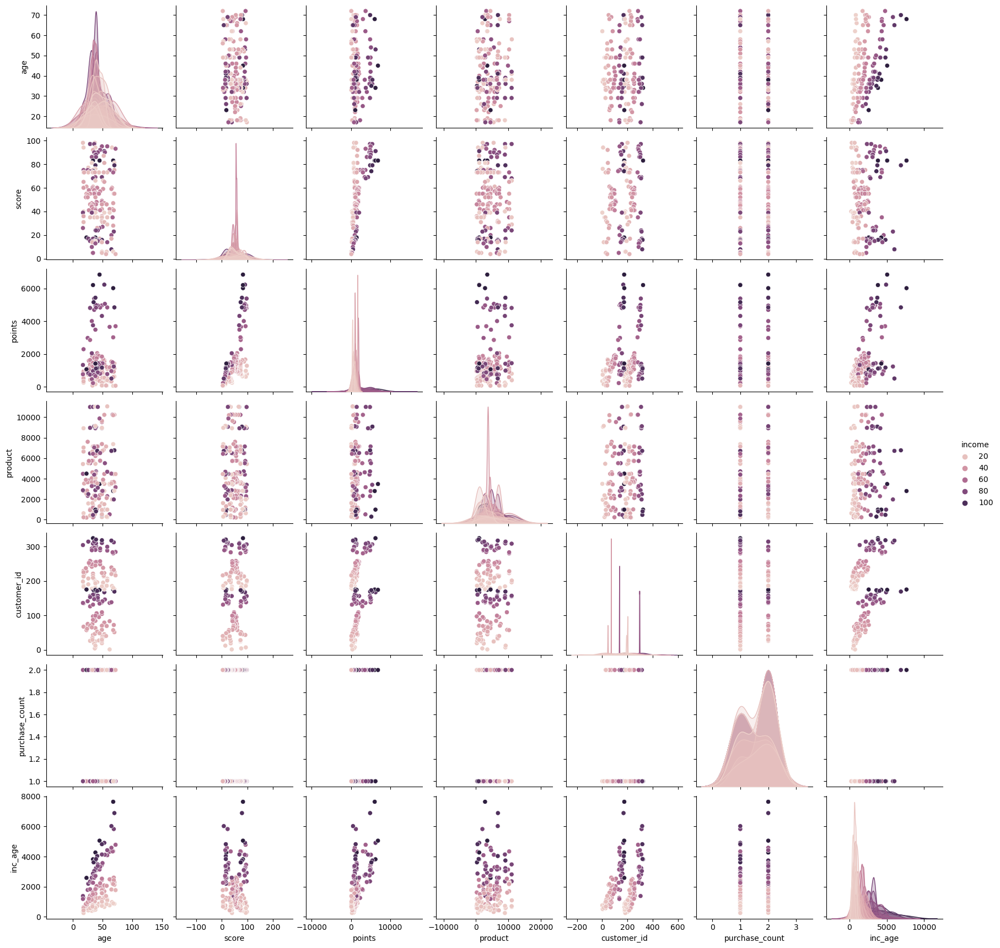

In [504]:
# Visualise in a pairplot
sns.pairplot(bought1_to_2, hue = 'income')

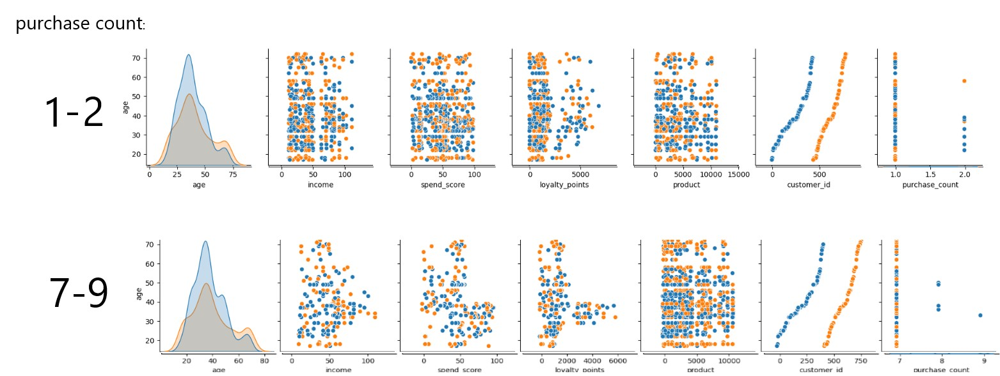

- There are high income earners in both groups, but in the 7-9 group, only the 30-60 year old high earners are purchasing from Turtle Games. Presumably all age groups could buy more (high income) and all age groups are potential customers (they're purchasing in the 1-3 age group). Could loyalty points be better targeted to get people to buy more than 2 products? Are there rewards at 7 that don't exist for smaller numbers of multiple purchases? 
- You have to be under 40 to get a higher spend score (above about 50) if you are purchasing more products. Curiously the spend score range doesn't change for higher purchase numbers. Is it too closely tied to income? 
- Most people don't get more than 2000 loyalty points. If you're buying 1-2 products, whether you do or not isn't heavily age dependent. But if you're buying 7-9 products, only customers between about 30-40 years get high loalty points, but a few of those are getting more than any other age / purchase count group. This is a smaller dataset (the higher purchase count customers) so it could be that this age reflects the fact that many of TG's customers overall are around this age. 
- Most customers seem to buy either seven or one. This seems kind of unlikely? Need to investigate further. But it's possible, if customer are being rewarded somehow for multiple purchases. Are there products which come in multipacks? 






How can we do this to account for customers earning more points / score changing over time (ie with purchases). Can we track that? Maybe their income changes too but they're still the same customer? Or they they same customer for our purposes? They do enter into a different spending relationship with the company at that point. 

It's important to note, too, that we don't know whether the points / score  etc is allocated pre or post purchase. 



In [505]:
duplicate_rows = reviews1_4.duplicated()
print(duplicate_rows)

0       False
1       False
2       False
3       False
4       False
        ...  
1995    False
1996    False
1997    False
1998    False
1999     True
Length: 2000, dtype: bool


In [502]:
num_duplicates = duplicate_rows.sum()
print(num_duplicates)

203


Duplicate purchases won't readily be showing up on all graphs in the pairplots. It won't affect purchase counts, though. 
Does it mean there are people with exactly the same demographics? Are there some products more likley to be purchased more than once, than others? 

## 6. Observations and insights

***Your observations here...***






# 

# Week 2 assignment: Clustering with *k*-means using Python

The marketing department also wants to better understand the usefulness of renumeration and spending scores but do not know where to begin. You are tasked to identify groups within the customer base that can be used to target specific market segments. Use *k*-means clustering to identify the optimal number of clusters and then apply and plot the data using the created segments.

## Instructions
1. Prepare the data for clustering. 
    1. Import the CSV file you have prepared in Week 1.
    2. Create a new DataFrame (e.g. `df2`) containing the `renumeration` and `spending_score` columns.
    3. Explore the new DataFrame. 
2. Plot the renumeration versus spending score.
    1. Create a scatterplot.
    2. Create a pairplot.
3. Use the Silhouette and Elbow methods to determine the optimal number of clusters for *k*-means clustering.
    1. Plot both methods and explain how you determine the number of clusters to use.
    2. Add titles and legends to the plot.
4. Evaluate the usefulness of at least three values for *k* based on insights from the Elbow and Silhoutte methods.
    1. Plot the predicted *k*-means.
    2. Explain which value might give you the best clustering.
5. Fit a final model using your selected value for *k*.
    1. Justify your selection and comment on the respective cluster sizes of your final solution.
    2. Check the number of observations per predicted class.
6. Plot the clusters and interpret the model.

## 1. Load and explore the data

In [511]:
# Import necessary libraries.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import accuracy_score
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings('ignore')

In [512]:
# Load the CSV file(s) as df2.
df2 = pd.read_csv("reviews.csv")
df3 = pd.read_csv("reviews.csv")
# View DataFrame.
df2.head(2)

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.3,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.3,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178


In [513]:
# Drop unnecessary columns.
df2 = df2.loc[:,['income', 'score']]

# View DataFrame.
df2.head()

,income,score
0,12.30,39
1,12.30,81
2,13.12,6
3,13.12,77
4,13.94,40


In [514]:
# Explore the data.
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   income  2000 non-null   float64
 1   score   2000 non-null   int64  
dtypes: float64(1), int64(1)
memory usage: 31.4 KB


In [515]:
# Descriptive statistics.
df2.describe()

,income,score
count,2000.000000,2000.000000
mean,48.079060,50.000000
std,23.123984,26.094702
min,12.300000,1.000000
25%,30.340000,32.000000
50%,47.150000,50.000000
75%,63.960000,73.000000
max,112.340000,99.000000


In [516]:
df2.head()

,income,score
0,12.30,39
1,12.30,81
2,13.12,6
3,13.12,77
4,13.94,40


## 2. Plot

Text(0, 0.5, 'spending score')

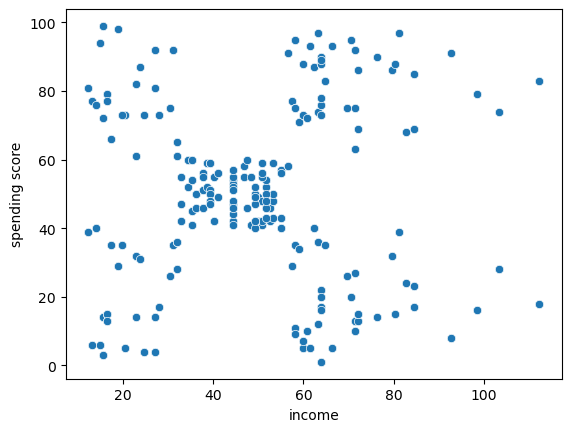

In [517]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df2, x = 'income', y = 'score')
plt.xlabel('income')
plt.ylabel('spending score')


In [518]:
df3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5


Text(0, 0.5, 'spending score')

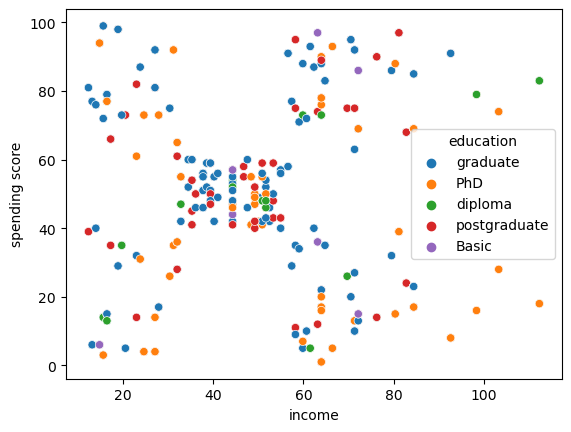

In [519]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'income', y = 'score', hue='education')
plt.xlabel('income')
plt.ylabel('spending score')



Education is all over the place with this particular pairplot (above), indicating not much of a relationship. 

Text(0, 0.5, 'spending score')

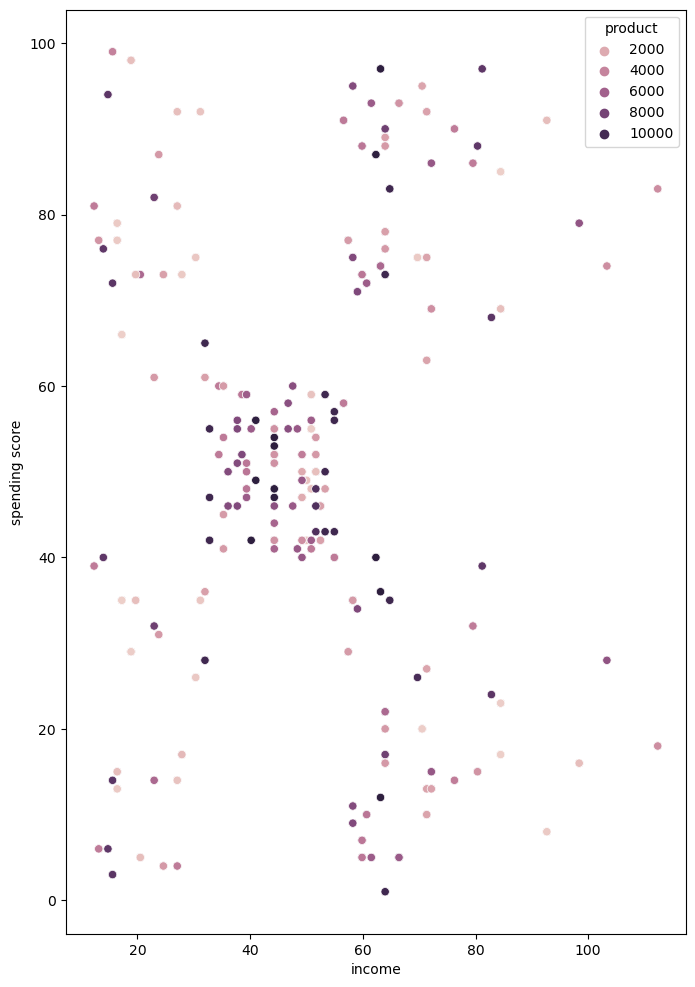

In [520]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (8, 12))
sns.scatterplot(data = df3, x = 'income', y = 'score', hue='product')
plt.xlabel('income')
plt.ylabel('spending score')

This is a very basic graph (above) but it does seem there are some products which are more likely to be bought by those with higher incomes. Check this out with a large swarm plot 

Text(58.097222222222214, 0.5, 'spending score')

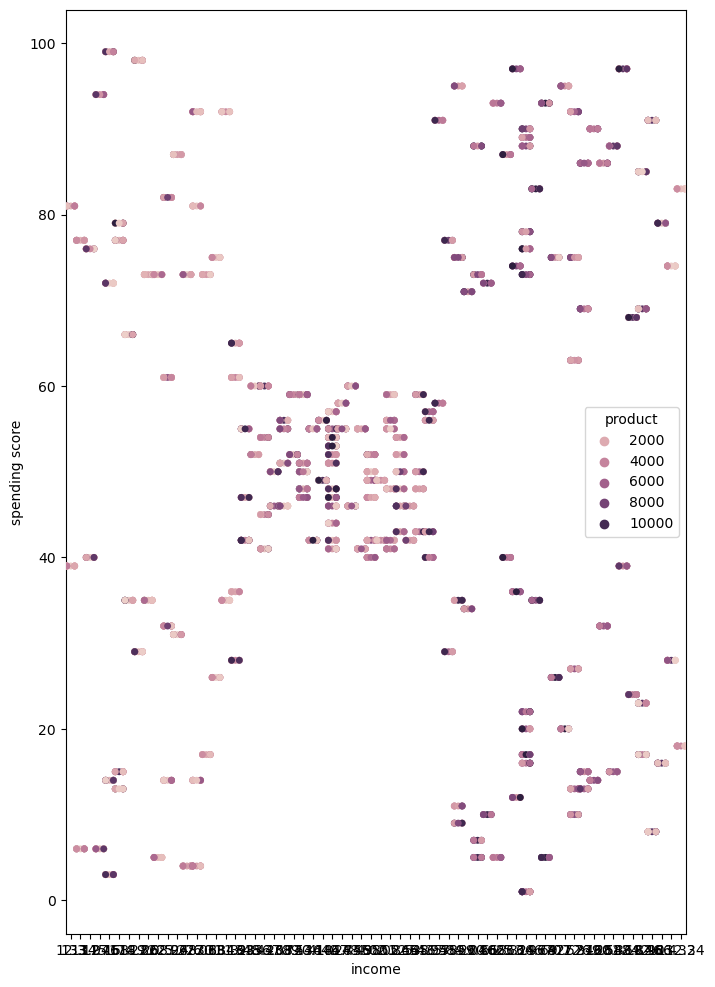

In [521]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (8, 12))
sns.swarmplot(data = df3, x = 'income', y = 'score', hue='product')
plt.xlabel('income')
plt.ylabel('spending score')

Text(165.34722222222223, 0.5, 'product')

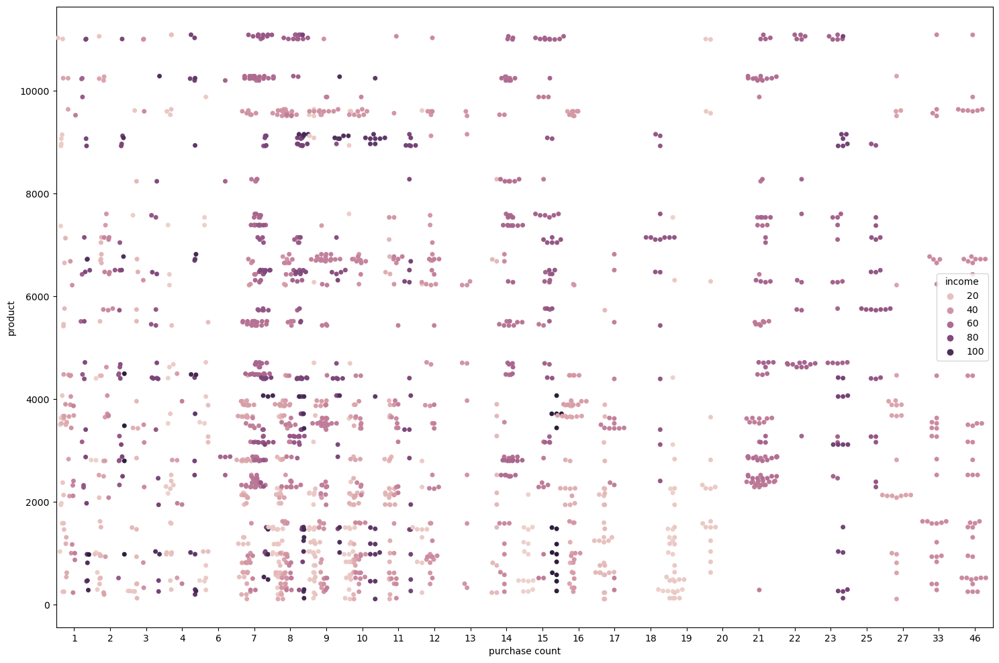

In [527]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (18, 12))
sns.swarmplot(data = reviews1_4, x = 'purchase_count', y = 'product', hue='income', dodge = 0.1)
plt.xlabel('purchase count')
plt.ylabel('product')

Text(0.5, 0, 'income bracket')

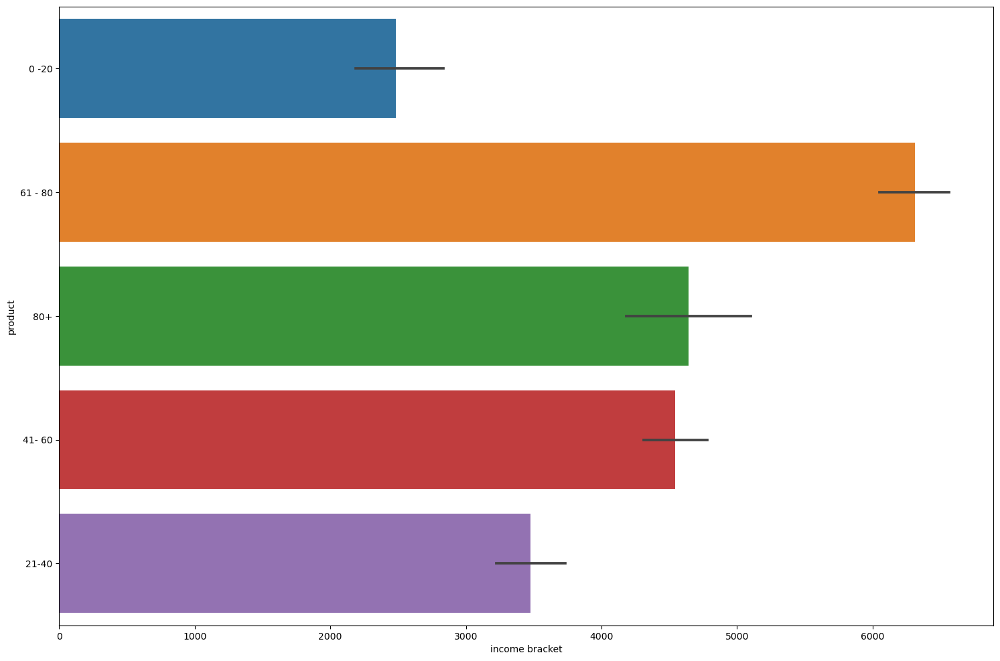

In [528]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (18, 12))
sns.barplot(data = reviews1_4, y = 'income_bracket', x = 'product')
plt.ylabel('product')
plt.xlabel('income bracket')

Text(0, 0.5, 'product')

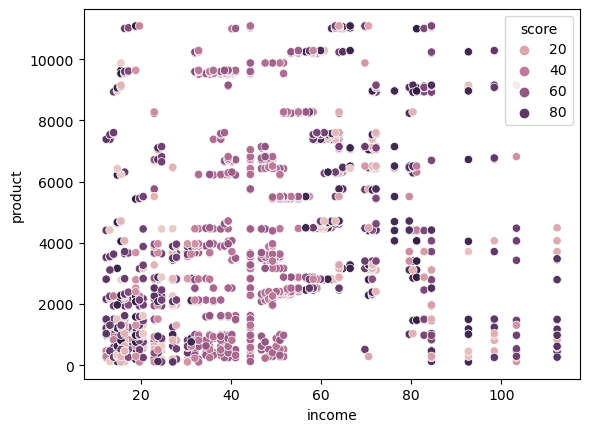

In [529]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'income', y = 'product', hue='score')
plt.xlabel('income')
plt.ylabel('product')

This graph (above) indicates (or confirms) that there is a relationship between score and income around the 30-50k range (for income) where most customers with that income range have a score of around 40-60.  

Text(0, 0.5, 'score')

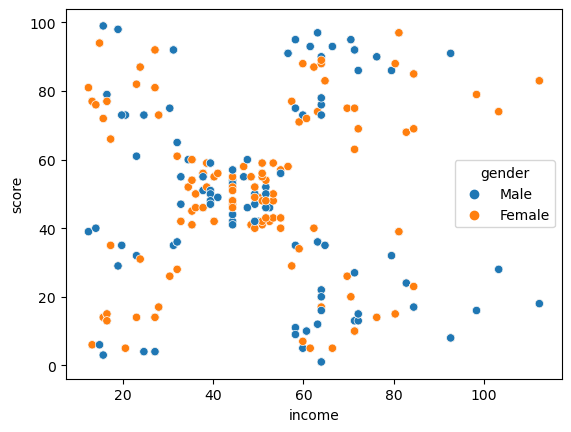

In [530]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'income', y = 'score', hue='gender')
plt.xlabel('income')
plt.ylabel('score')

Text(0, 0.5, 'score')

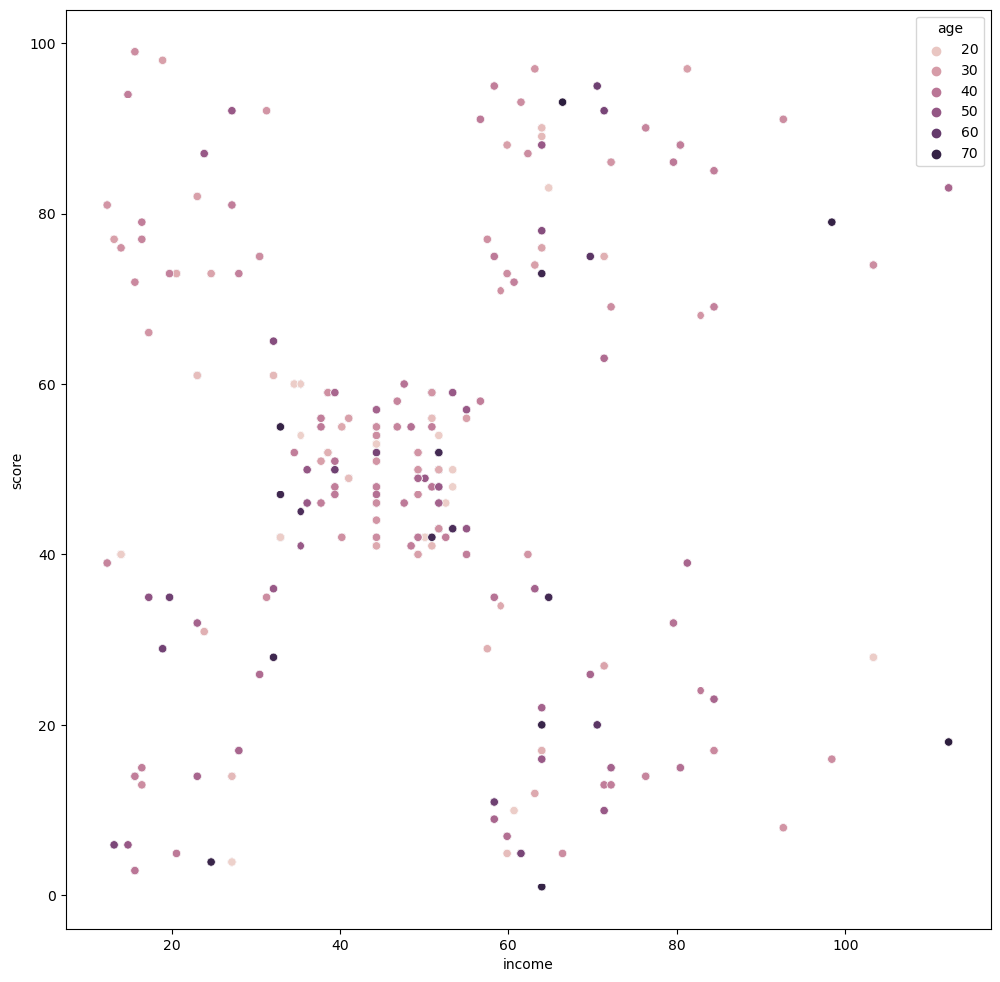

In [531]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 12))
sns.scatterplot(data = df3, x = 'income', y = 'score', hue='age')
plt.xlabel('income')
plt.ylabel('score')

In the two graphs above we can see that gender is roughly randomly dispersed but that within the dynamic of income and score, age is definitely a factor. WE can look at this again from different angles by playing around with the variables. 

Text(0, 0.5, 'score')

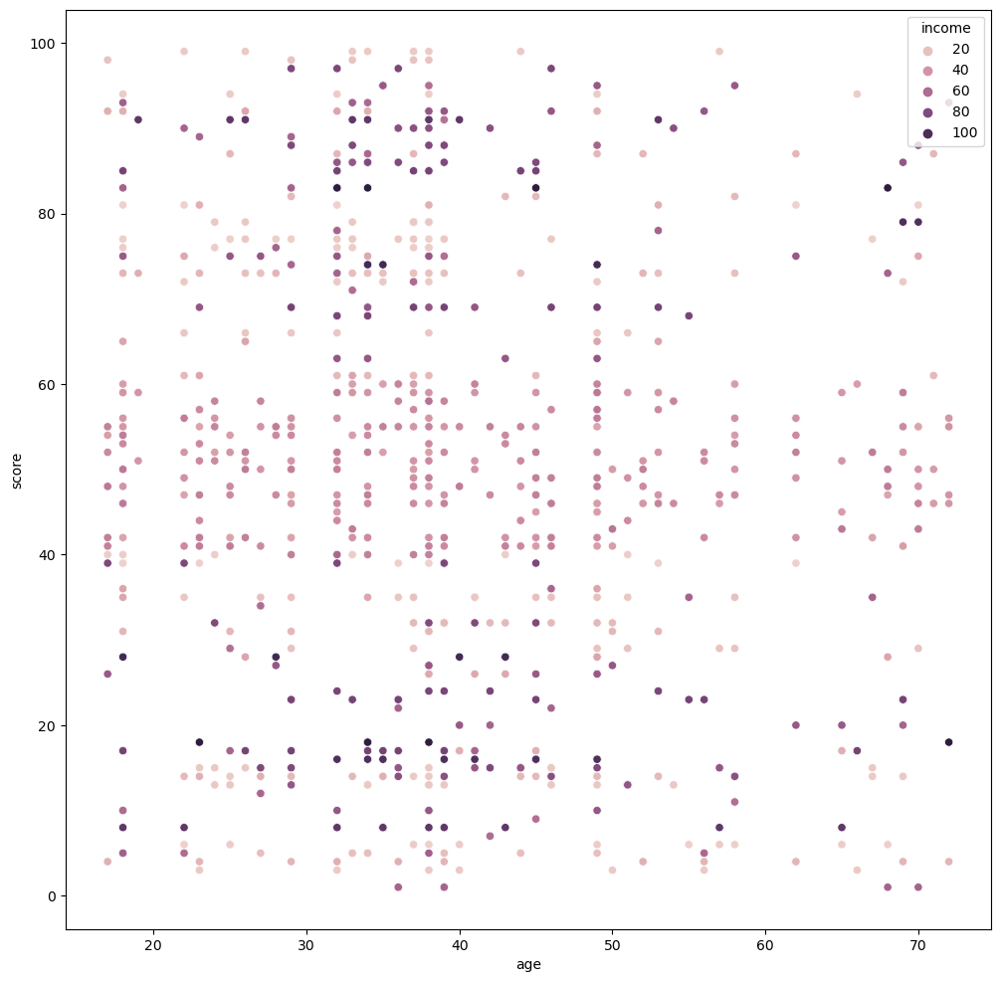

In [532]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 12))
sns.scatterplot(data = df3, x = 'age', y = 'score', hue = 'income')
plt.xlabel('age')
plt.ylabel('score')

Text(0, 0.5, 'product')

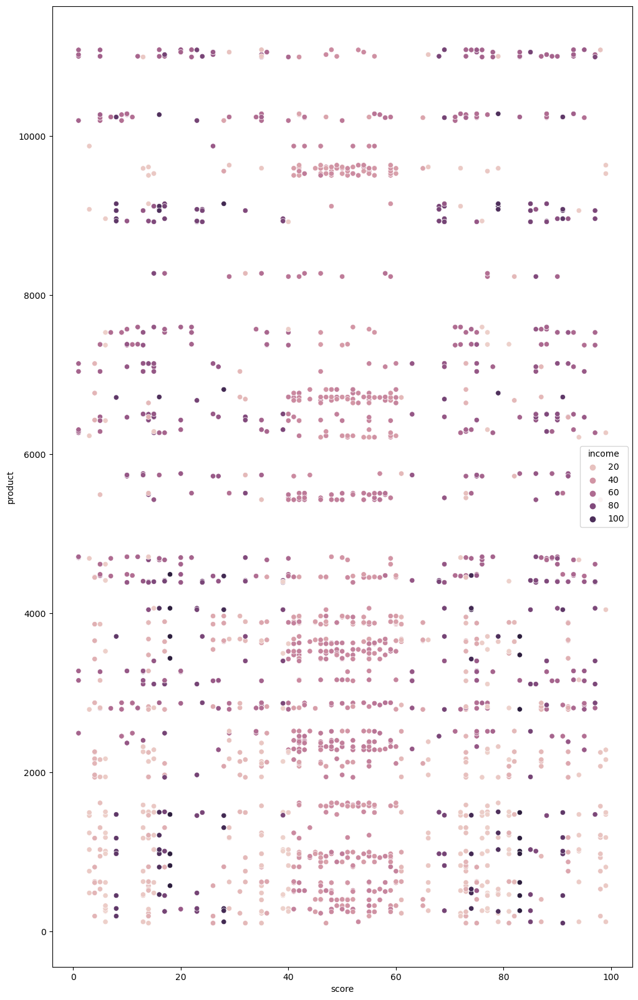

In [533]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 20))
sns.scatterplot(data = df3, x = 'score', y = 'product', hue = 'income')
plt.xlabel('score')
plt.ylabel('product')

In [534]:
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14


Text(90.34722222222221, 0.5, 'product')

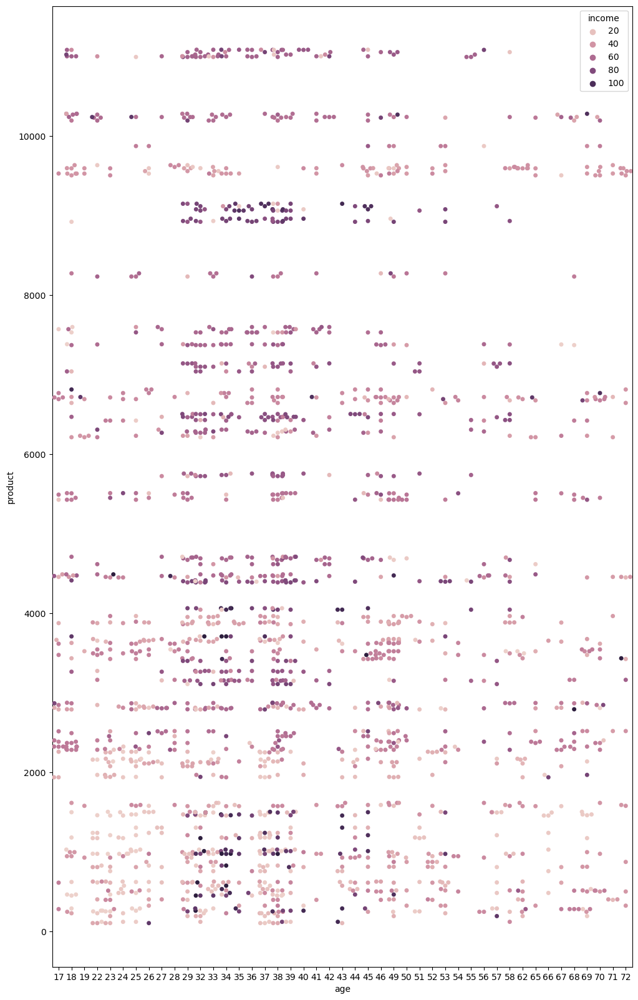

In [535]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 20))
sns.swarmplot(data = df3, x = 'age', y = 'product', hue = 'income')
plt.xlabel('age')
plt.ylabel('product')

<Axes: xlabel='income', ylabel='age'>

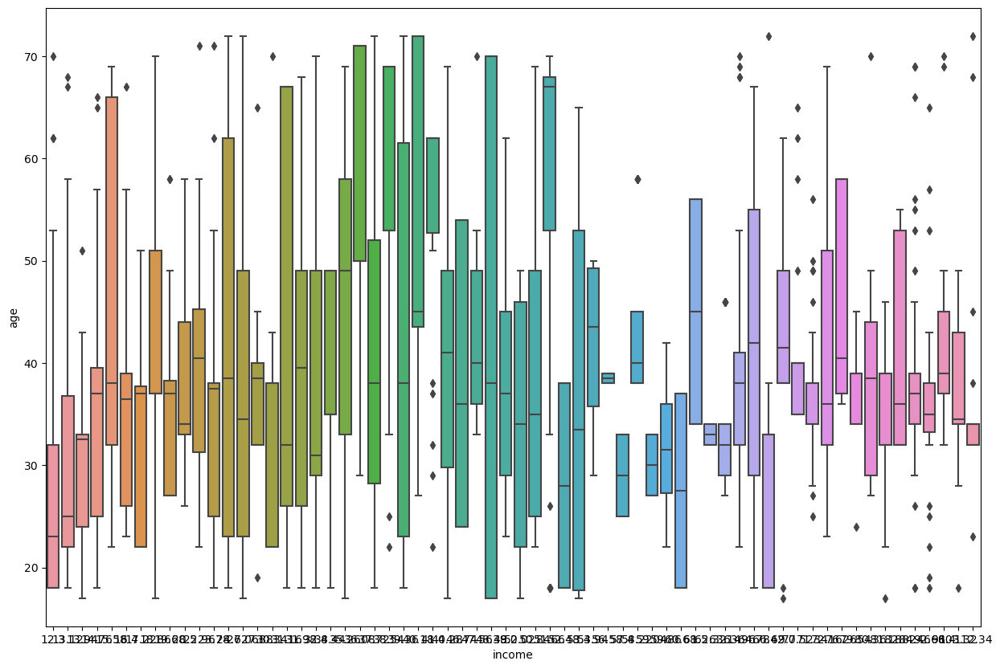

In [536]:
# What are the ages of the customers (who review)
# Graph the various variables of this data to show which variables predominate in this group.
plt.figure(figsize = (15, 10))
sns.boxplot(data = reviews, x = 'income', y = 'age')


Text(0, 0.5, 'income')

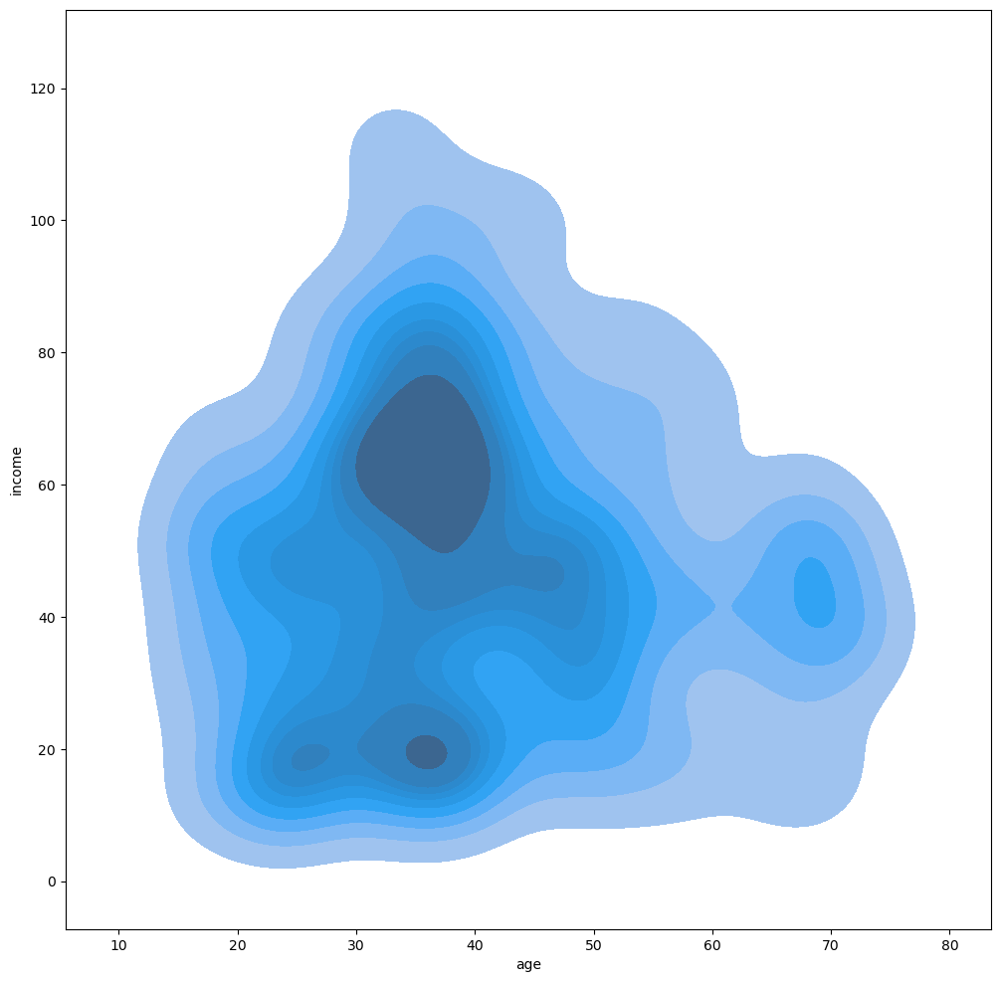

In [537]:
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 12))
sns.kdeplot(data = reviews, x = 'age', y = 'income', shade = True)
plt.xlabel('age')
plt.ylabel('income')

That's useful in terms of the marketing department's request for info about customer groups. But if we have correctly identified customers (ie the customer id column) then that map might look very different when we remove duplicate rows (re: customer id. Group the data by customer id and regraph. 

In [538]:
customer_id = reviews
customer_id = customer_id.drop_duplicates(subset='customer_id', keep = 'first')
customer_id = customer_id.drop(['review', 'summary'], axis = 1)
customer_id.head()

,gender,age,income,score,points,education,product,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,61-100,0 -20,13
1841,Male,26,15.58,99,881,PhD,9529,61-100,0 -20,187
1883,Female,44,15.58,99,1128,PhD,2285,61-100,0 -20,11
1969,Male,34,15.58,99,1027,graduate,4047,61-100,0 -20,189


In [539]:
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14


Text(0, 0.5, 'income')

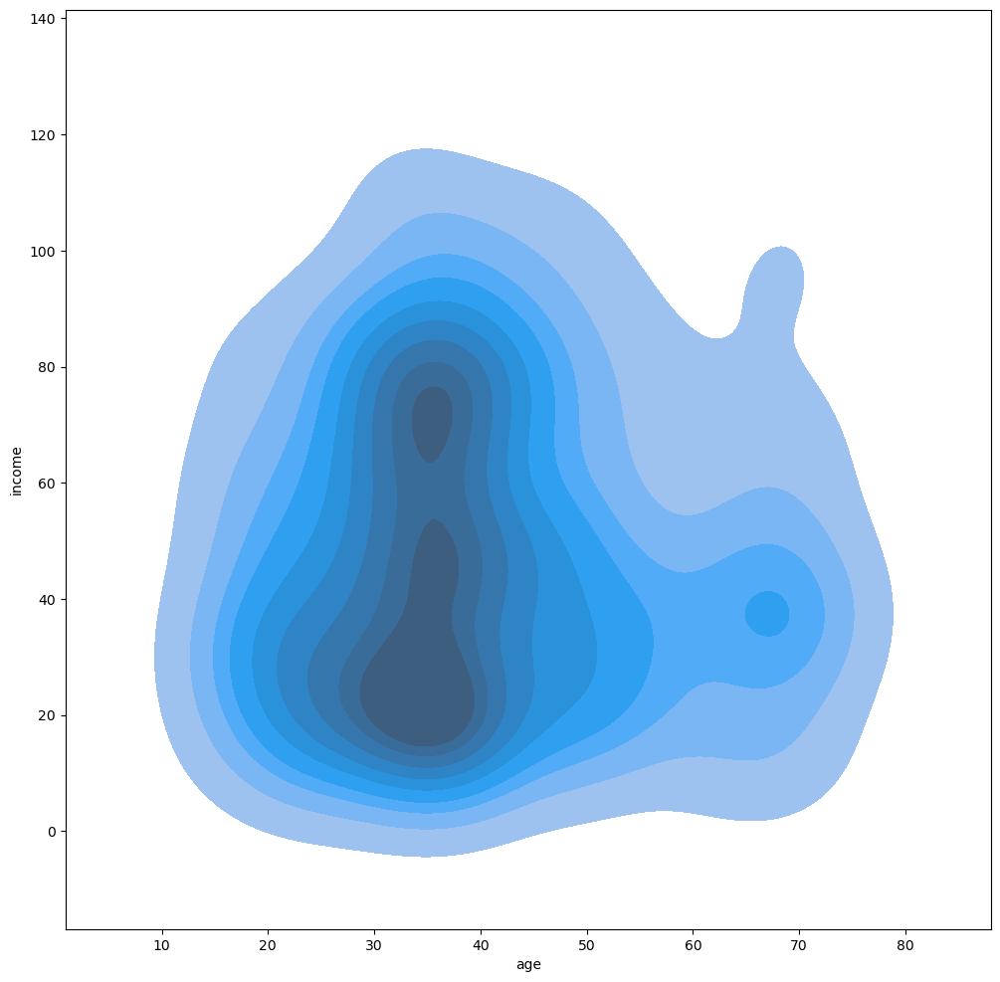

In [540]:
# Plot desnsity map again showing each possible customer, just once each.
# Create a scatterplot with Seaborn.
plt.figure(figsize = (12, 12))
sns.kdeplot(data = customer_id, x = 'age', y = 'income', shade = True)
plt.xlabel('age')
plt.ylabel('income')

The images have significant similarites, including: 

- the dominant age bracket is between 30 and 40.
- the income densities that form a nexus with that age group, are around 20k and around 80k

The main differences:
- in the smaller dataset, the income density at 20k spans to 40k
- in the larger dataset, the income density at 80k reaches down to 50k and is most significant at 60k. 
- most noticeably, the heaviness in income drops from a higher number to a lower number, indicating that the return customers are higher income. 


The impications? We could present these as they are to our marketing team. This would involve explanation of the uncertainty in the interpretation of the data. But possibly not too much. The workflow of the presentation would need to look at the two groups first (the multi-purchasers and the 1-2 time purchasers), but without going too much into the process. This would be a difficult balance to manange.

Would it be better to present the visualisation of the larger dataset, because it reflects the spending capactity of the whole cohort better than the subset does? ie, if certain customers purchase more often, then it's useful to see each purchase as a datapoint rather than each customer. 

If we did present both, would we go ahead and present the two, as if we were certain of the subsetting process? What would be the implocations if we are wrong? And would we need still further visualisations to explain what we are looking at above?

Text(0, 0.5, 'age')

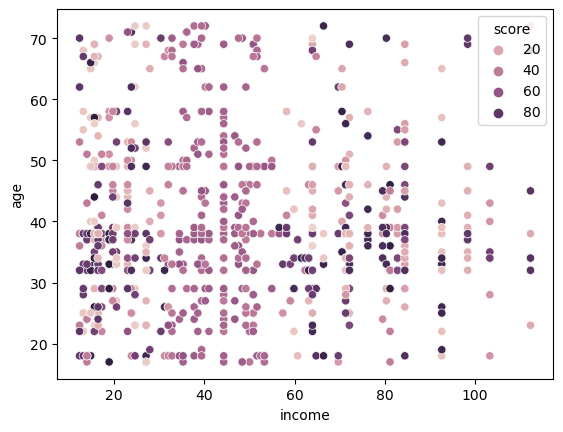

In [543]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'income', y = 'age', hue='score')
plt.xlabel('income')
plt.ylabel('age')

In [544]:
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14


Of all the simple scatterplots we've looked at this is artcualtes among the most clearly, the effect of income (independent variable) on score (dependent variable). On either side of the middle band (score: 40-60; income:40-60) there is much more high and low income customers represented, than in that band, and than that income bracket is represented. 

Why? 

Text(0, 0.5, 'spending score')

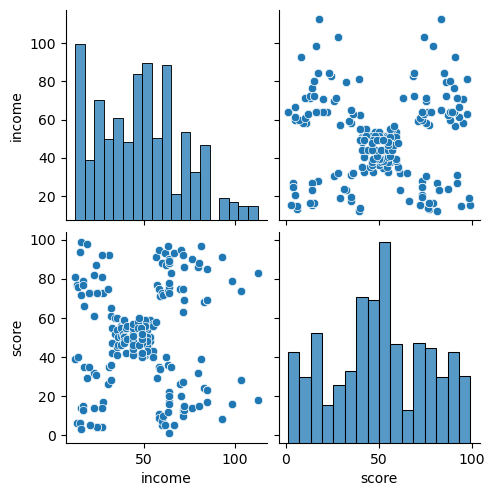

In [545]:
# Create a pairplot with Seaborn.
sns.pairplot(df2)
plt.xlabel('income')
plt.ylabel('spending score')

We could say there are roughly five clusters here. There are a mixture of soft and hard edges between them, and there are some datapoints at the far reachs of at least two of the clusters, which are almost outliers (ie a more precise model would be determined if they were excluded - something to be considered). K-means clustering is sensitive to outliers, so that will be an important to keep in mind.  

However the more precise view articulated by the scatterplot shows there are some intersted subcluster groupings within the clusters - for example the centre cluster of the five, has three definable groups within it. Exploration will help determine how useful all of the considerations mentioned here, might be. 

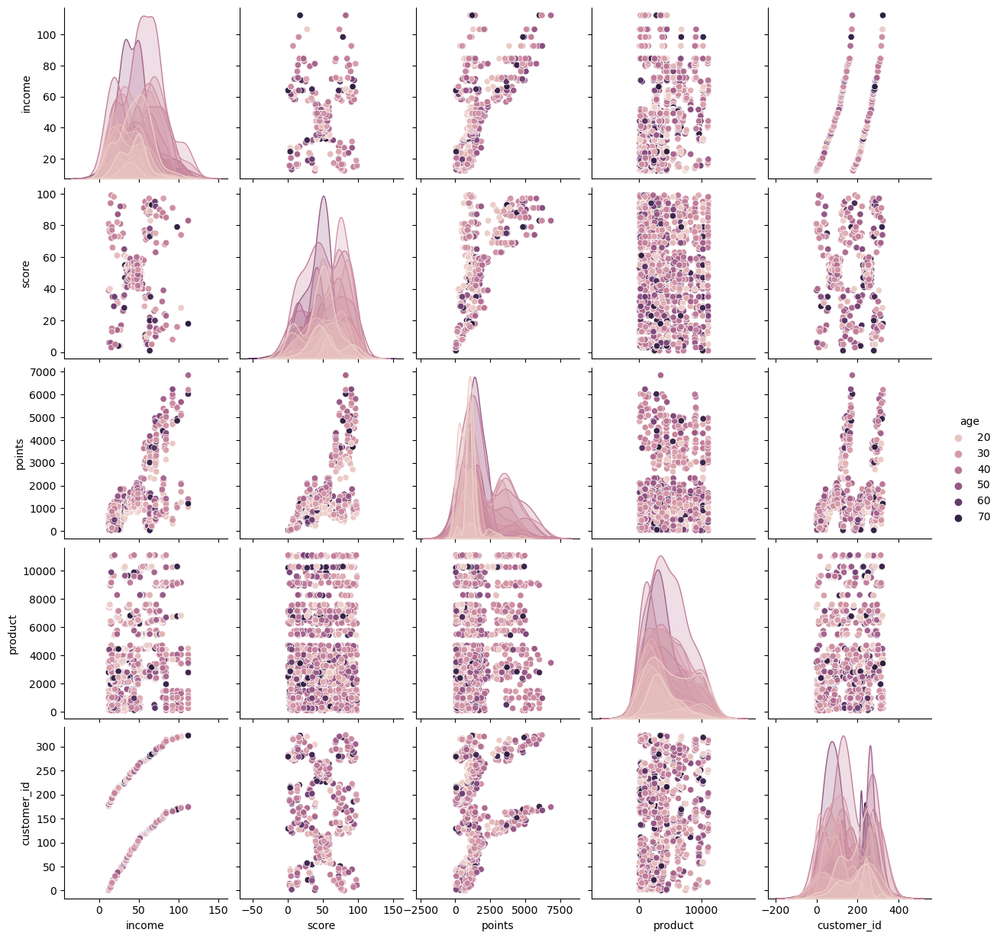

In [546]:
# Create a pairplot with Seaborn.
sns.pairplot(df3, hue = 'age')

Wow - lots of intesting insights here.
- income is normally distrubuted. 
- There are people stuck in a point bracket no matter what they spend. Why? This doesn't apply to everyone. 
- This same pattern is seen in the points and income bracket. 
- it looks like the older you are (ie if youre 60 - 70+), the lower your score is likely to be, no matter what your income is. This needs to be checked. 
- the clustering and bottlenecks (for want of a better term) in the income / score relationships, is paralelled or emphasised even further by that age dynamic. That is, lower and higher income (as opposed to medium income) is either going to be low or high point, but low income can be low or high points, and high income can be low or high points. Being middle aged or younger in either of those groups means you're more likely to get higher points. (Need to check the cluster sizes with this). If this provs statistically significant etc, then this is a dynamic with considerable relevance to the business. 


Text(0, 0.5, 'age')

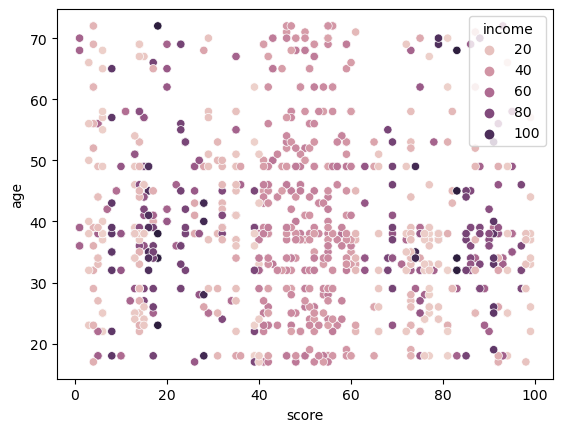

In [547]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'score', y = 'age', hue='income')
plt.xlabel('score')
plt.ylabel('age')

It doesn't look like there is such a strong relationship as the pairplot suggestes now that we can see more of the datapoints. 

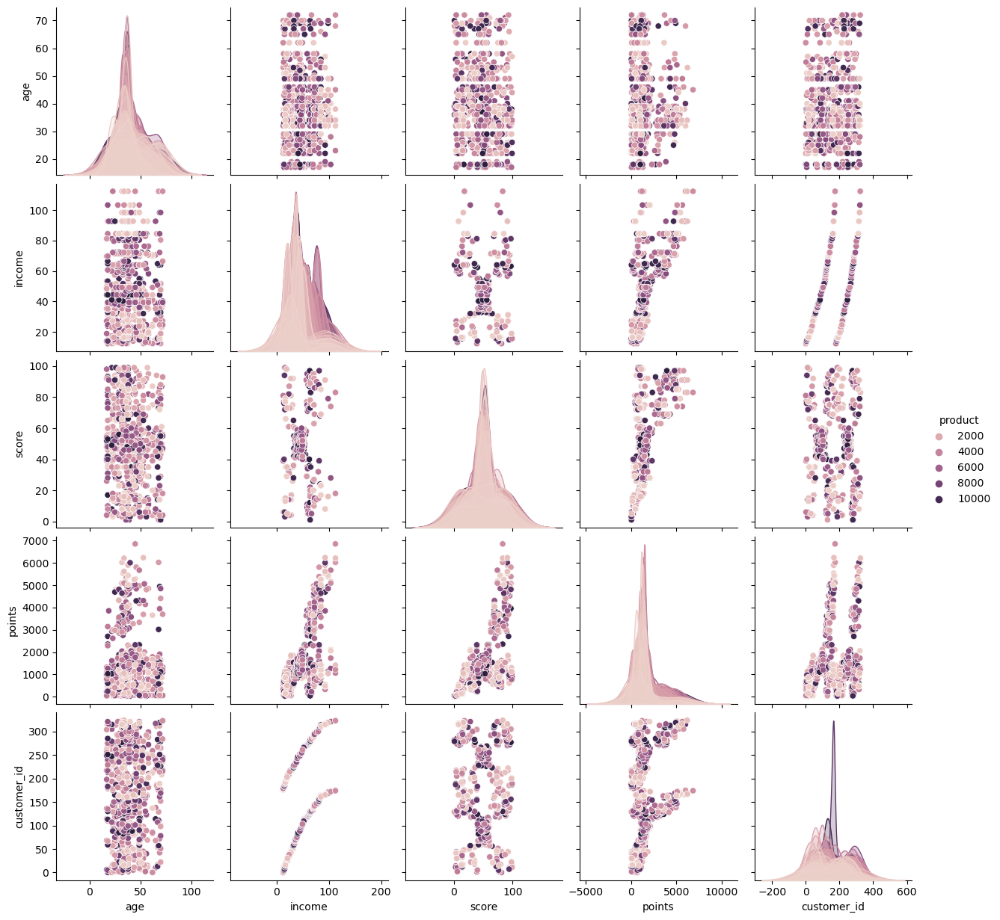

In [548]:
# Create a pairplot with Seaborn.
sns.pairplot(df3, hue = 'product')

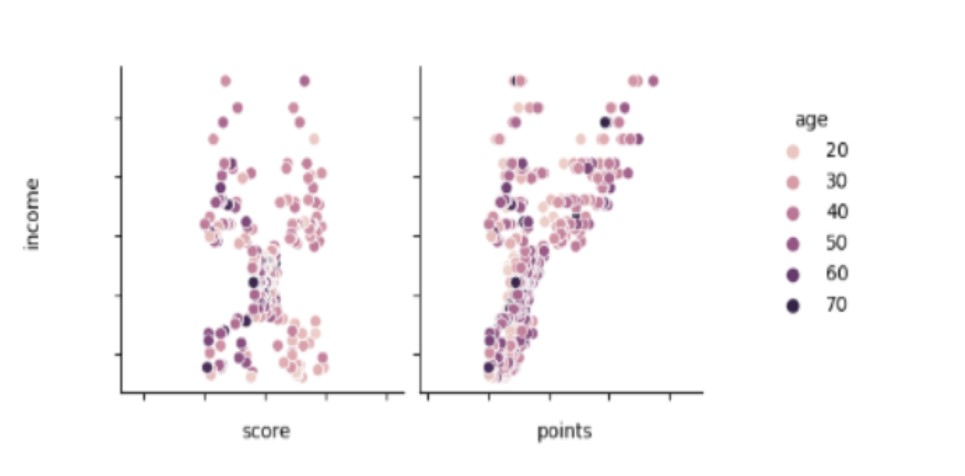

This is a really intriguing dynamic which the pairplot above elucidates, and is worth looking at in closer detail, here. I think we can tentatitively say that the dynamic on the left of each graph is fairly similar, not just formally (where the dots are) but more granularly in terms of where the age-determined hues are:
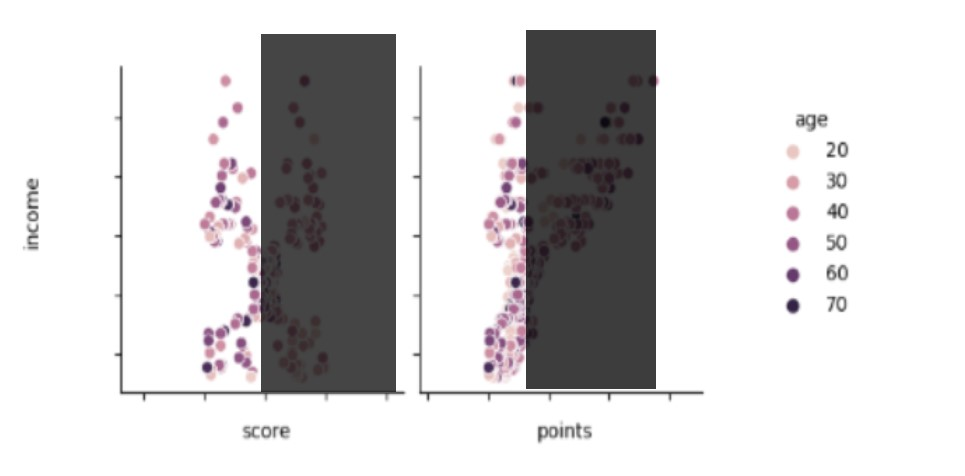

The similarities aren't perfect (above) but compared to the right side of the graph, we get to see the real differences are  in the high score / high points ends of each x- variable. 

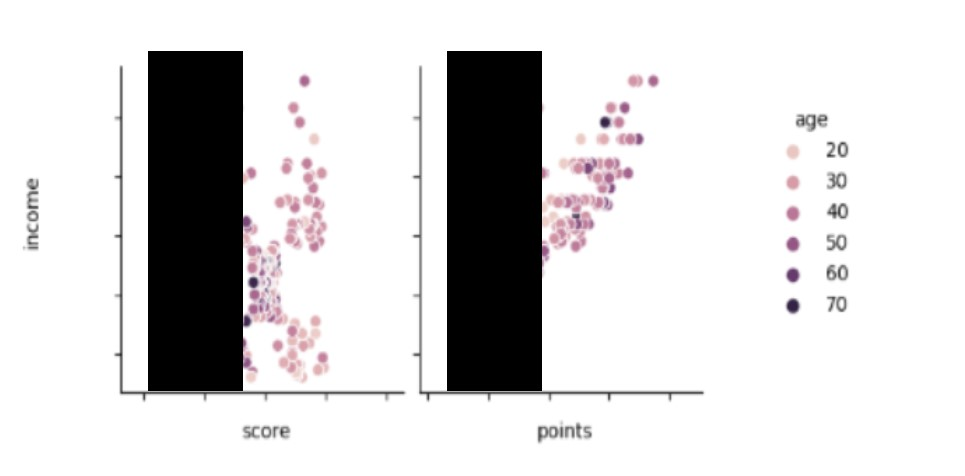


Here we can see that ponits are much more closely correlated with income thanscore is. Furthrmore, it looks like older customers are accessing higher points, even though they aren't accessing higher scores (although to be fair we can't see from this graph how many data points are demonstrating that, nor therefore how significant it is). 

Text(0, 0.5, 'spending score')

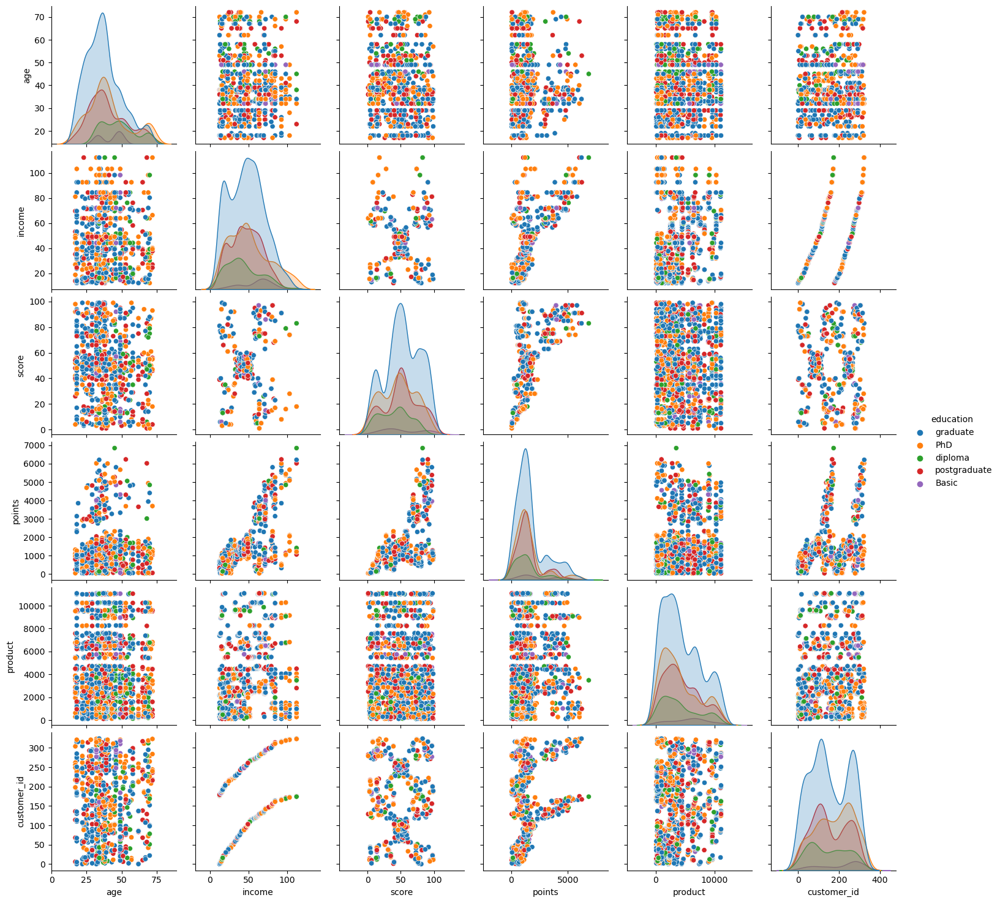

In [549]:
# Create a pairplot with Seaborn.
sns.pairplot(df3, hue = 'education')
plt.xlabel('income')
plt.ylabel('spending score')

Some people are gettnig a higher score even though they're not spending much - is that a problem? Should the beneifts (if there are any) for higher points only be accessible to those who spend more? Is the spend score clearly reflecting how much customers spend, or is it more complicated than that. In which case, ponits 

Because we have seen that age is a factor in accessing higher points, now when we look at education as a variable and see that younger cutomers are mostly graduates, and older ones are mostly PhDs.

There do seem to be some correlations between education and products purchased. Will look into this more. 

Text(0, 0.5, 'product')

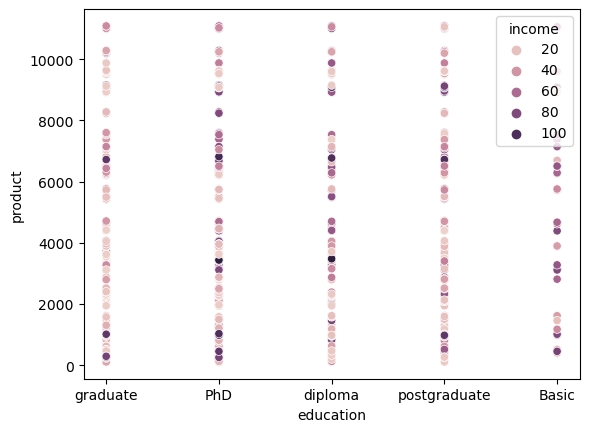

In [550]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'education', y = 'product', hue='income')
plt.xlabel('education')
plt.ylabel('product')

Probably not the best graph to show this on, but even here there are some patterns suggested. Again we don't know that we're seeing all the data points, but if what we're seeing was true, then there are some products that predominantly lower income customers purchase. When we look at the pairplot's visualisation of these variables though, we see it's not as simple as it looks in our graph here. See below (NB hue is age).
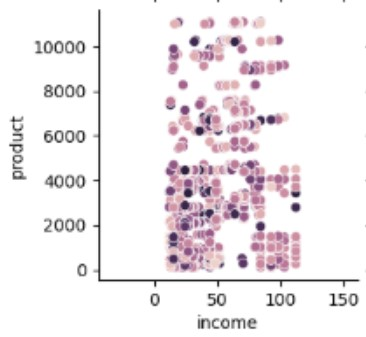

Text(0, 0.5, 'product')

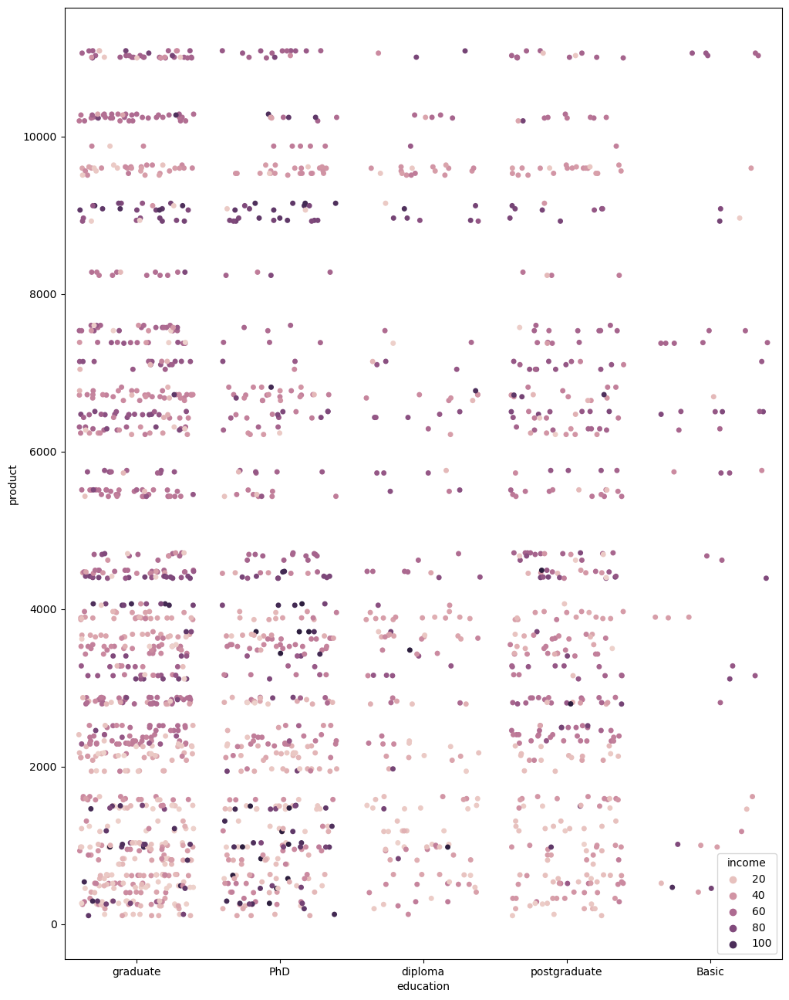

In [551]:
# Create a scatterplot with Seaborn. SAme as above but with jitter.
plt.figure(figsize = (12,16))
sns.stripplot(data = df3, x = 'education', y = 'product', hue='income', jitter = 0.4)
plt.xlabel('education')
plt.ylabel('product')

Interesting, so we can say things like, post graduates with a certain income buy.... and PhDs with a certain income buy, etc. Remembering though that these are REVIEWS and NOT all sales. Need to do all this again with polarity amd sentiment for hue etc. But maybe ALSO good to break it down into matrix  of categories like education / income first. 


Text(0, 0.5, 'product')

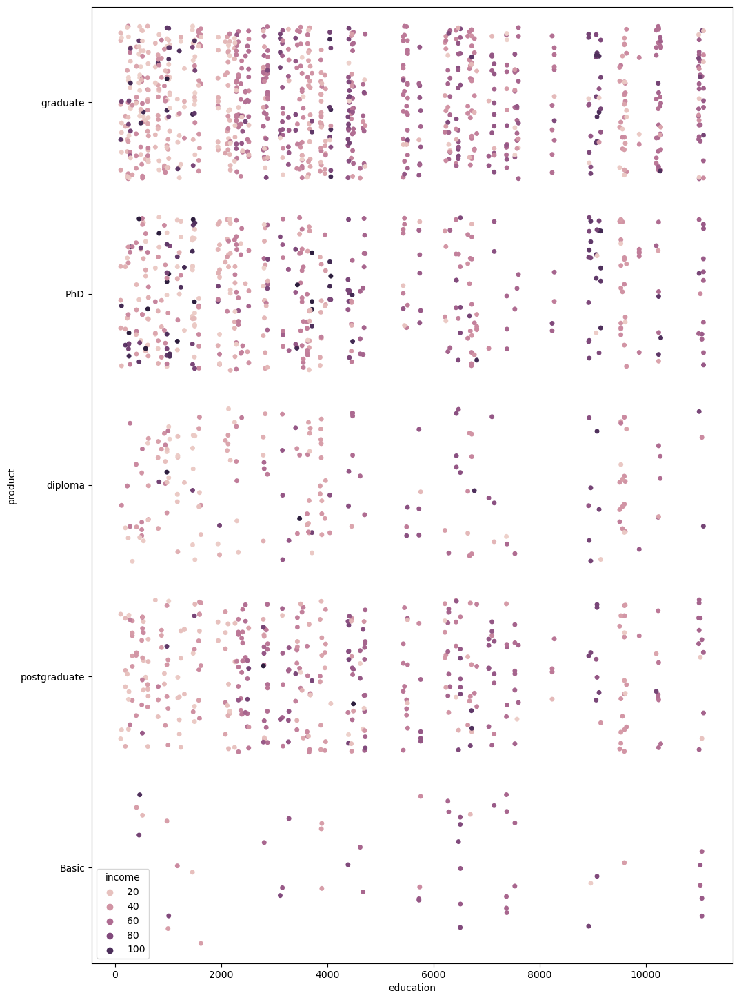

In [552]:
# Create a scatterplot with Seaborn.   Same as above, but reversed axes and taller. 
plt.figure(figsize = (12,18))
sns.stripplot(data = df3, y = 'education', x = 'product', hue='income', jitter = 0.4)
plt.xlabel('education')
plt.ylabel('product')

Text(90.34722222222221, 0.5, 'product')

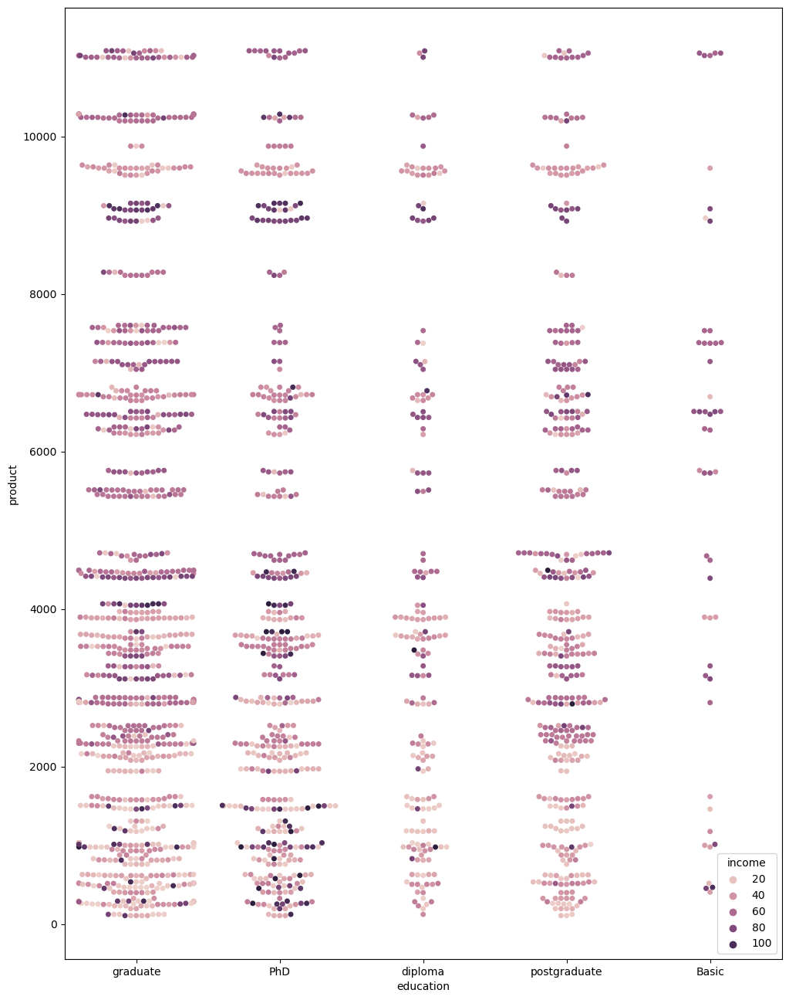

In [553]:
plt.figure(figsize = (12,16))
sns.swarmplot(data = df3, x = 'education', y = 'product', hue='income')
plt.xlabel('education')
plt.ylabel('product')

Text(0, 0.5, 'product')

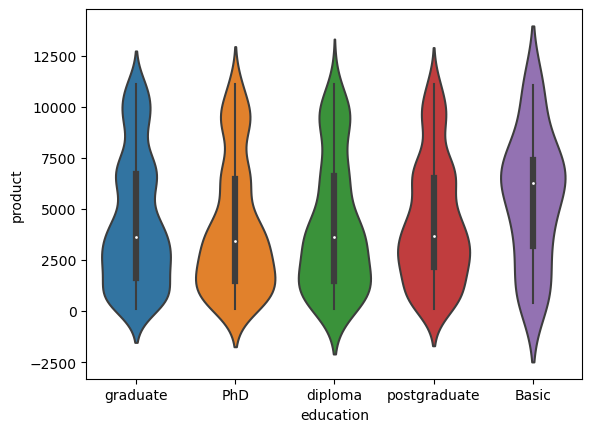

In [554]:
sns.violinplot(data = df3, x = 'education', y = 'product')
plt.xlabel('education')
plt.ylabel('product')

Basic education buys differently

Text(0, 0.5, 'age')

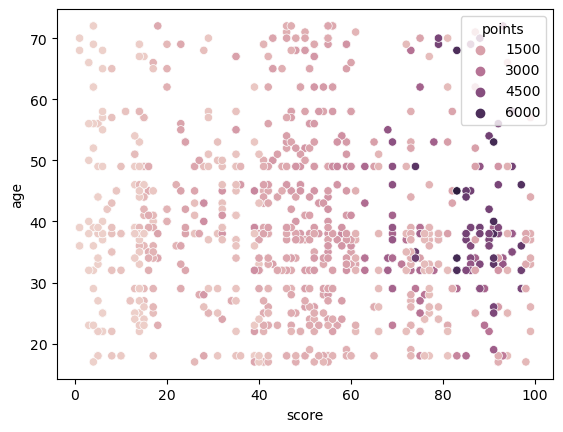

In [555]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = df3, x = 'score', y = 'age', hue='points')
plt.xlabel('score')
plt.ylabel('age')

## 3. Elbow and silhoutte methods

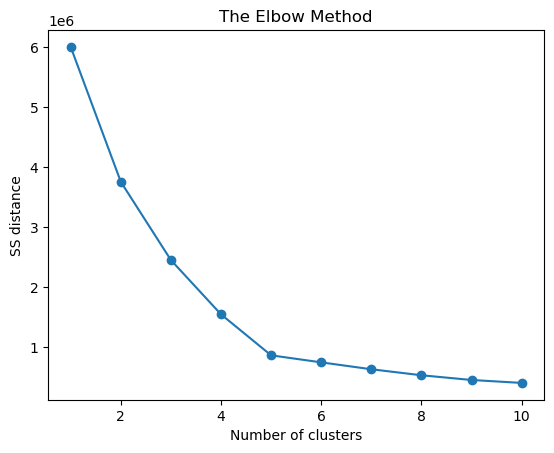

In [569]:
# Determine the number of clusters: Elbow method.

# Store the two columns in a variable. 
x = reviews1N[['income', 'score']]

# Import the KMeans class.
from sklearn.cluster import KMeans 

# Elbow chart for us to decide on the number of optimal clusters.
# Create an empty list (sum of squares)
ss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i,
                    init='k-means++',
                    max_iter=300,
                    n_init=10,
                    random_state=0)
    kmeans.fit(x)
    ss.append(kmeans.inertia_)

# Plot the elbow method.
plt.plot(range(1, 11),
         ss,
         marker='o')

# Insert labels and title.
plt.title("The Elbow Method")
plt.xlabel("Number of clusters")
plt.ylabel("SS distance")

plt.show()

Indeed, the elbow forms at five, indicating five clusters. 

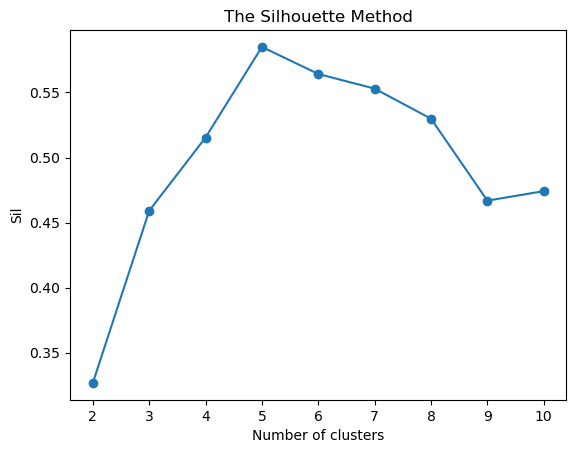

In [570]:
# Determine the number of clusters: Silhouette method.

# Import silhouette_score class from sklearn.
from sklearn.metrics import silhouette_score

# Find the range of clusters to be used using silhouette method.
sil = []
kmax = 10

for k in range(2, kmax+1):
    kmeans_s = KMeans(n_clusters=k).fit(x)
    labels = kmeans_s.labels_
    sil.append(silhouette_score(x,
                                labels,
                                metric='euclidean'))

# Plot the silhouette method.
plt.plot(range(2, kmax+1),
         sil,
         marker='o')

# Insert labels and title.
plt.title("The Silhouette Method")
plt.xlabel("Number of clusters")
plt.ylabel("Sil")

plt.show()

And indeed the peak is at five. 

## 4. Evaluate k-means model at different values of *k*

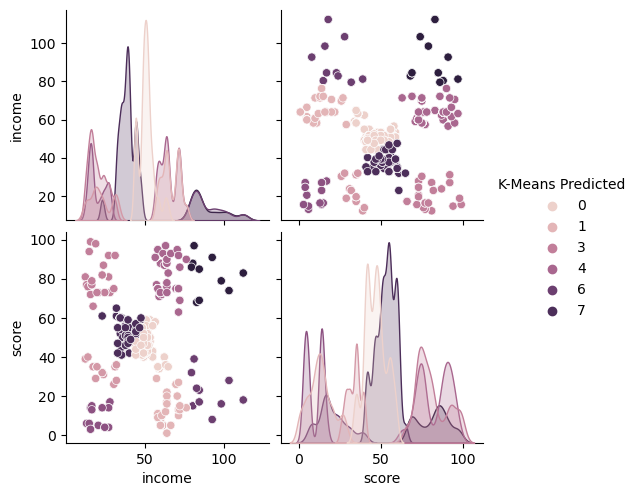

In [571]:
# Use five clusters.
kmeans = KMeans(n_clusters =9, 
                max_iter = 15000,
                init='k-means++',
                random_state=0).fit(x)

clusters = kmeans.labels_

x['K-Means Predicted'] = clusters

# Plot the predicted.
sns.pairplot(x,
             hue='K-Means Predicted',
             diag_kind= 'kde')

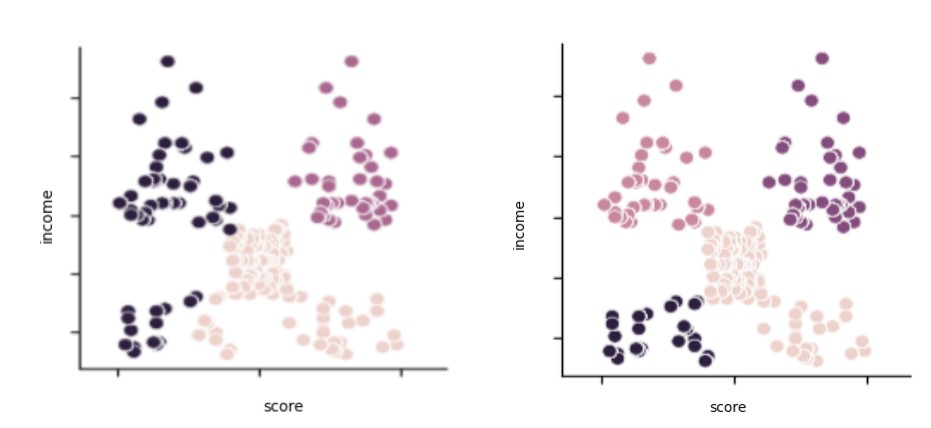
### K = 3, 4 (above)

With only three or four clusters the datasets are nice and large, but the groupings simply aren't accurately matching those we can see in our scatterplot. 




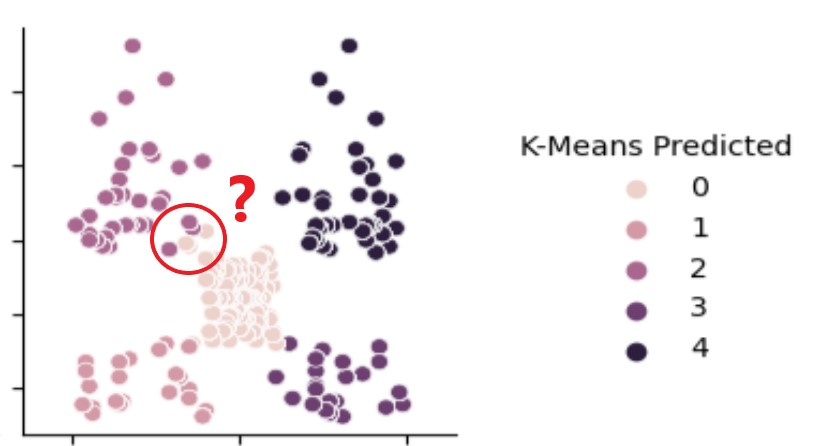

### K = 5 (above)
This K value gives us a reasonably good fit - the five easily obseravle clusters are mostly separated as we'd expect with some very small issues where the clusters aren't perhaps exactly identified as we'd expect("?" on the image).

We get four good sets of two comparison clusters: the two on the right (upper and lower) and the two on the left (also upper and lower) have relatively similar score, but have very different incomes. The other two sets of clusters which will provide an opportunity for comparison are the two lower clusters, and the two upper clusters: these each have similar incomes but are separated into high and low scores.

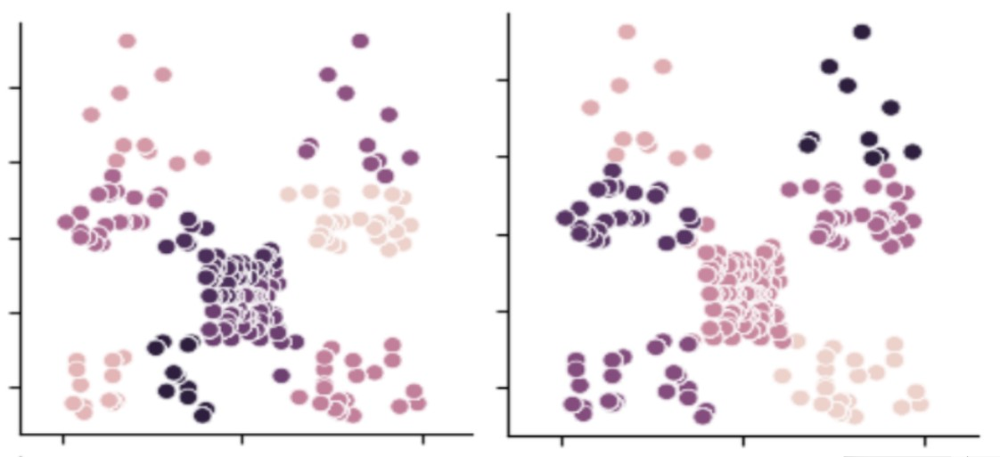


### K = 7, 9 (above)

Here we begin to get better clustering that centre cluster, where with five clusters we had the question mark. Odd number values are better for K for this dataset because of the natural central cluster. 7 defines the quite justifiably different clusters at the high income end. 9 does that too of course but then goes too far and muddles the distinctions elsewhere. 

So the choice becomes a decision between five and seven. A major drawback with assigning K with a value of seven (as opposed to five) is that the datasets become quite small when we cluster that precisely - especially in that high income end. A potential advantage is that the higher income customers may be quite significant regarding the business's goal of increasing overall sales, as they may conveivably have more income. Furthermore, even if the datasets for the very high income groups defined with seven as K's value, are small, so long as the remaining medium / high income clusters are large enough, then the model doesn't lose usefulness in terms of its ability to interpret those customers' behaviour and potential. But the reality is that the higher income clusters aren't large even with a K-value of five. 

So, with the elbow method and the silhouette method supporting this decision, we'll go ahead with five as the K-value. That K-value of 7 is tantalising, but it will still be there if we want to come back to it later. 

## 5. Fit final model and justify your choice

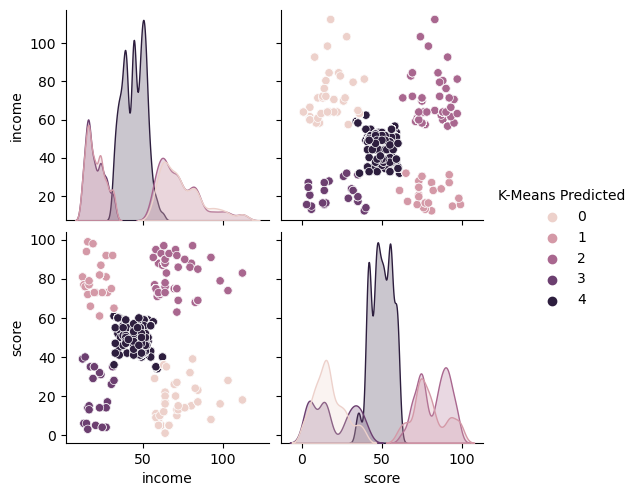

In [572]:
# Apply the final model.
kmeans = KMeans(n_clusters =5, 
                max_iter = 15000,
                init='k-means++',
                random_state=0).fit(x)

clusters = kmeans.labels_

x['K-Means Predicted'] = clusters

# Plot the predicted.
sns.pairplot(x,
             hue='K-Means Predicted',
             diag_kind= 'kde')

In [573]:
# Check the number of observations per predicted class.
x['K-Means Predicted'].value_counts()

4    1876
2     872
0     833
1     656
3     643
Name: K-Means Predicted, dtype: int64

Not ideal, but the dynamics there are really important to understand so let's stay with this for now. 

## 6. Plot and interpret the clusters

In [574]:
# Visualising the clusters.
# View the K-Means predicted.
print(x.tail(10))

      income  score  K-Means Predicted
4870   18.86     98                  1
4871   19.68     35                  3
4872   19.68     73                  1
4873   84.46     85                  2
4874   92.66      8                  0
4875   98.40     16                  0
4876   84.46     17                  0
4877   92.66     91                  2
4878   98.40     16                  0
4879   92.66      8                  0


In [575]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   income  2000 non-null   float64
 1   score   2000 non-null   int64  
dtypes: float64(1), int64(1)
memory usage: 31.4 KB


In [576]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4880 entries, 0 to 4879
Data columns (total 3 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   income             4880 non-null   float64
 1   score              4880 non-null   int64  
 2   K-Means Predicted  4880 non-null   int32  
dtypes: float64(1), int32(1), int64(1)
memory usage: 95.4 KB


In [579]:
# Add the cluster number to each row in a new column. 
# Add the kmeans labels to the DF3_2 datset as a new column. 
reviews1N['cluster'] = clusters


In [583]:
reviews1N.corr()

,index,age,income,score,points,product,customer_id,cluster
index,1.000000,-0.004394,-0.047187,-0.004742,-0.030644,0.030910,-0.029929,-0.056527
age,-0.004394,1.000000,-0.017530,-0.219271,-0.044035,-0.003495,0.055335,0.167097
income,-0.047187,-0.017530,1.000000,-0.004276,0.603374,0.299329,0.487251,-0.338958
score,-0.004742,-0.219271,-0.004276,1.000000,0.677851,-0.013408,-0.024616,0.079797
points,-0.030644,-0.044035,0.603374,0.677851,1.000000,0.168067,0.258521,0.014317
product,0.030910,-0.003495,0.299329,-0.013408,0.168067,1.000000,0.167740,-0.112260
customer_id,-0.029929,0.055335,0.487251,-0.024616,0.258521,0.167740,1.000000,-0.173874
cluster,-0.056527,0.167097,-0.338958,0.079797,0.014317,-0.112260,-0.173874,1.000000


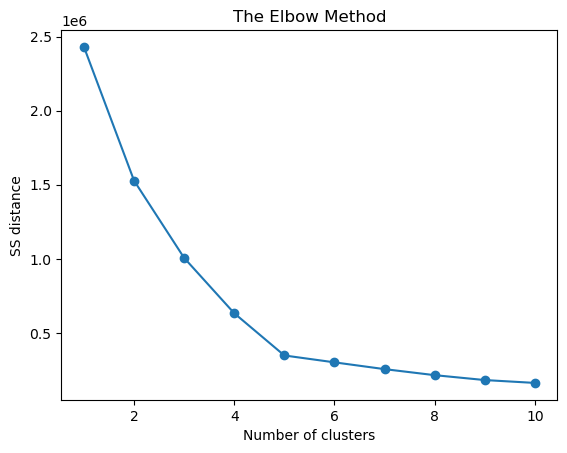

In [584]:
# Do the whoel thing with DF3_2

# Determine the number of clusters: Elbow method.

# Store the two columns in a variable. 
x = DF3_2[['income', 'score']]

# Import the KMeans class.
from sklearn.cluster import KMeans 

# Elbow chart for us to decide on the number of optimal clusters.
# Create an empty list (sum of squares)
ss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i,
                    init='k-means++',
                    max_iter=300,
                    n_init=10,
                    random_state=0)
    kmeans.fit(x)
    ss.append(kmeans.inertia_)

# Plot the elbow method.
plt.plot(range(1, 11),
         ss,
         marker='o')

# Insert labels and title.
plt.title("The Elbow Method")
plt.xlabel("Number of clusters")
plt.ylabel("SS distance")

plt.show()

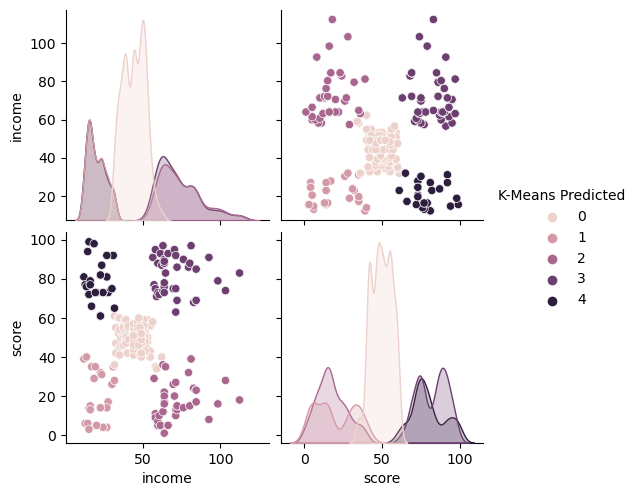

In [585]:
# Use five clusters.
kmeans = KMeans(n_clusters =5, 
                max_iter = 15000,
                init='k-means++',
                random_state=0).fit(x)

clusters = kmeans.labels_

x['K-Means Predicted'] = clusters

# Plot the predicted.
sns.pairplot(x,
             hue='K-Means Predicted',
             diag_kind= 'kde')

In [587]:
# Check the number of observations per predicted class.
x['K-Means Predicted'].value_counts()

0    774
3    356
2    330
1    271
4    269
Name: K-Means Predicted, dtype: int64

In [588]:
# Add the cluster number to each row in a new column. 
# Add the kmeans labels to the DF3_2 datset as a new column. 
DF3_2['cluster'] = clusters
DF3_2.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,cluster
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178,1
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178,4
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2,1
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2,4
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5,1


In [589]:
DF3_2.corr()

,age,income,score,points,product,customer_id,cluster
age,1.000000,-0.005708,-0.224334,-0.042445,0.003081,0.061429,-0.269178
income,-0.005708,1.000000,0.005612,0.616065,0.305309,0.497067,0.105357
score,-0.224334,0.005612,1.000000,0.672310,-0.001649,-0.020297,0.468561
points,-0.042445,0.616065,0.672310,1.000000,0.183600,0.270348,0.297660
product,0.003081,0.305309,-0.001649,0.183600,1.000000,0.173149,0.007638
customer_id,0.061429,0.497067,-0.020297,0.270348,0.173149,1.000000,0.034178
cluster,-0.269178,0.105357,0.468561,0.297660,0.007638,0.034178,1.000000


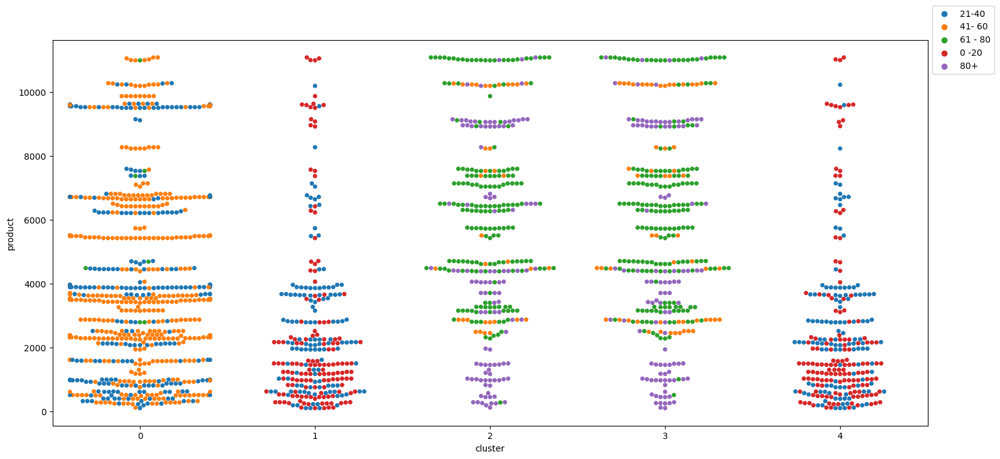

In [590]:
# Create scatterplots with Seaborn showing the clusters and other demographs.
plt.figure(figsize = (18,8))
sns.swarmplot(data = DF3_2, x = 'cluster', y = 'product', hue='income_bracket')
plt.xlabel('cluster')
plt.ylabel('product')
plt.legend(loc='center left', bbox_to_anchor=(1,1))

<Axes: xlabel='cluster', ylabel='age'>

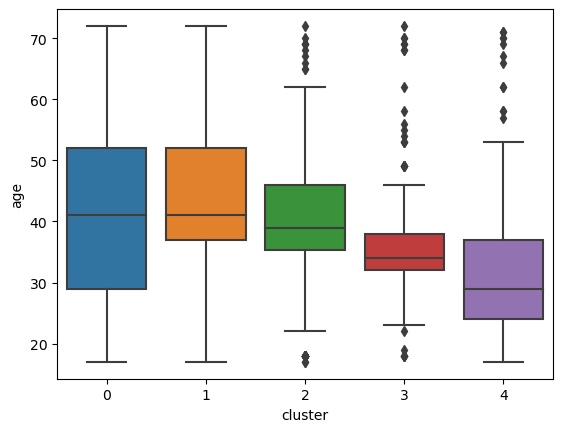

In [597]:
sns.boxplot(data = DF3_2, x = 'cluster', y = 'age')

<Axes: xlabel='cluster', ylabel='income'>

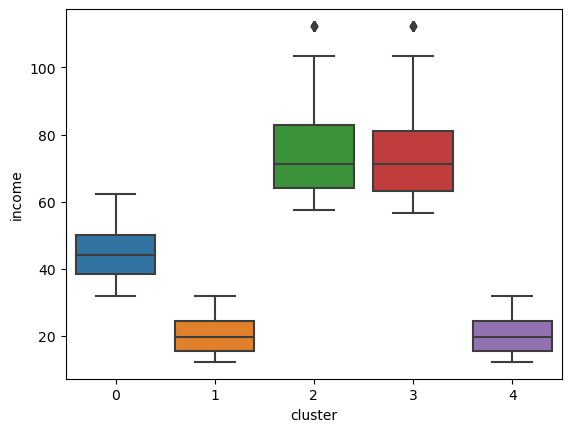

In [598]:
sns.boxplot(data = DF3_2, x = 'cluster', y = 'income')

<Axes: xlabel='cluster', ylabel='education'>

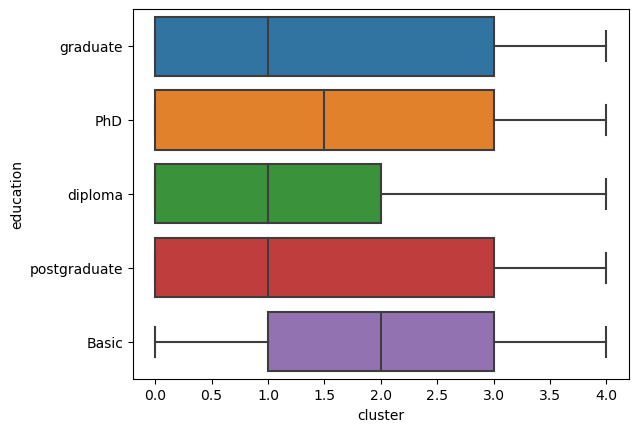

In [599]:
sns.boxplot(data = DF3_2, x = 'cluster', y = 'education')

<Axes: xlabel='cluster', ylabel='product'>

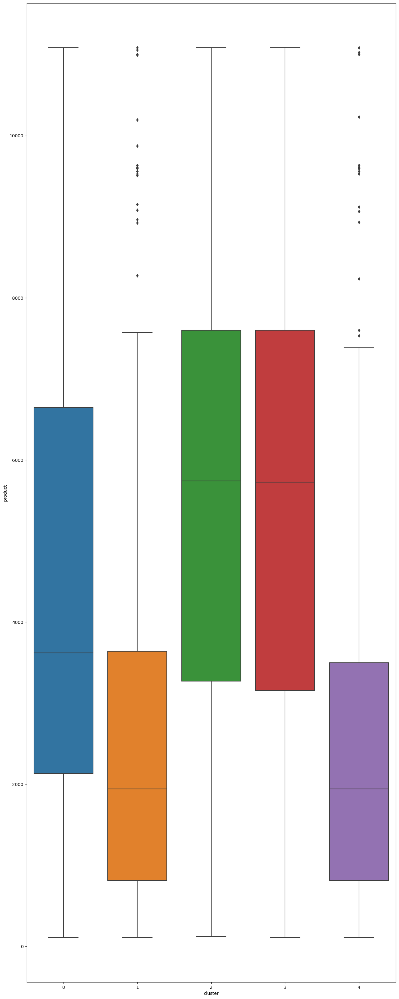

In [602]:
plt.figure(figsize= (15, 40))
sns.boxplot(data = DF3_2, x = 'cluster', y = 'product')

In [603]:
DF3_no_index = DF3_2
DF3_no_index.reset_index(drop = True, inplace  =  True)

In [604]:
all_df = pd.concat([DF3_no_index, t_sales], axis = 1)
all_df.head(355)

,gender,age,income,score,points,education,product,review,summary,score_bracket,...,Year,Genre,Publisher,NA_Sales,EU_Sales,Global_Sales,count,product2,Ranking_Bracket,Other_Sales
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,...,2006.0,Sports,Nintendo,34.02,23.80,67.85,1.0,1070.0,0.0,10.03
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,...,1985.0,Platform,Nintendo,23.85,2.94,33.00,2.0,1230.0,0.0,6.21
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,...,2008.0,Racing,Nintendo,13.00,10.56,29.37,1.0,1950.0,0.0,5.81
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,...,2009.0,Sports,Nintendo,12.92,9.03,27.06,1.0,2310.0,0.0,5.11
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,...,1996.0,Role-Playing,Nintendo,9.24,7.29,25.72,1.0,2490.0,0.0,9.19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,Male,41,63.96,17,780,graduate,7573,I bought this for my 11 year old granddaughter...,Pom Puppies,0-40,...,2007.0,Shooter,Microsoft Game Studios,0.00,0.01,0.02,2.0,47021.0,6.0,0.01
351,Male,39,63.96,88,3973,graduate,7600,Got this for my five-year-old who was looking ...,The crafters in the house love this,61-100,...,2002.0,Action,Take-Two Interactive,0.00,0.01,0.01,2.0,10121.0,6.0,0.00
352,Female,42,63.96,20,925,PhD,4619,My daughter wanted this so badly. So she forke...,"So Excited to Try, Difficult to Execute",0-40,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
353,Female,38,63.96,76,3398,PhD,4673,My almost 9 Year Old loves this pom-pom puppy ...,My almost 9 Year Old Loves it!,61-100,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Axes: xlabel='cluster', ylabel='Platform'>

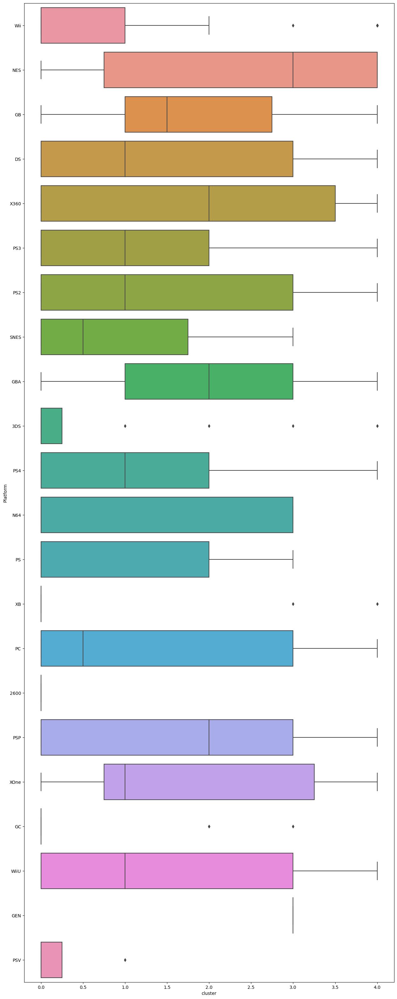

In [605]:
plt.figure(figsize= (15, 40))
sns.boxplot(data = all_df, x = 'cluster', y = 'Platform')

Text(0, 0.5, 'score')

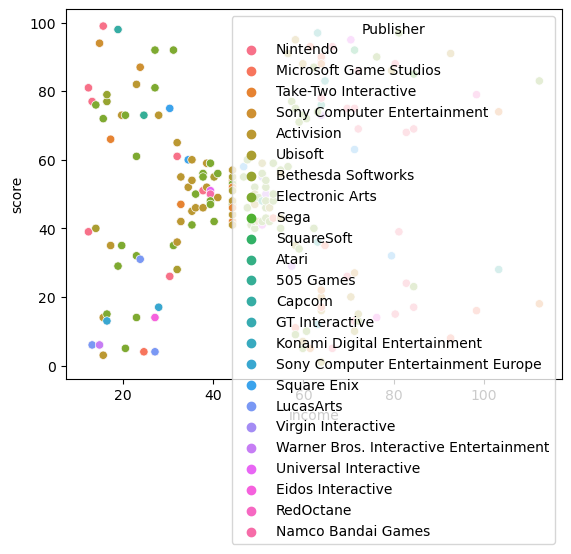

In [606]:
# Create a scatterplot with Seaborn.
sns.scatterplot(data = all_df, x = 'income', y = 'score', hue = "Publisher")
plt.xlabel('income')
plt.ylabel('score')

In [607]:
# Why do only certain datapoints show up here? It's because in the df some of the values are NaN (from rows 352 onwards).

## Two groups? 


Find out if there are two trends within the 'X-shape' of the income / points correlation, ie: 

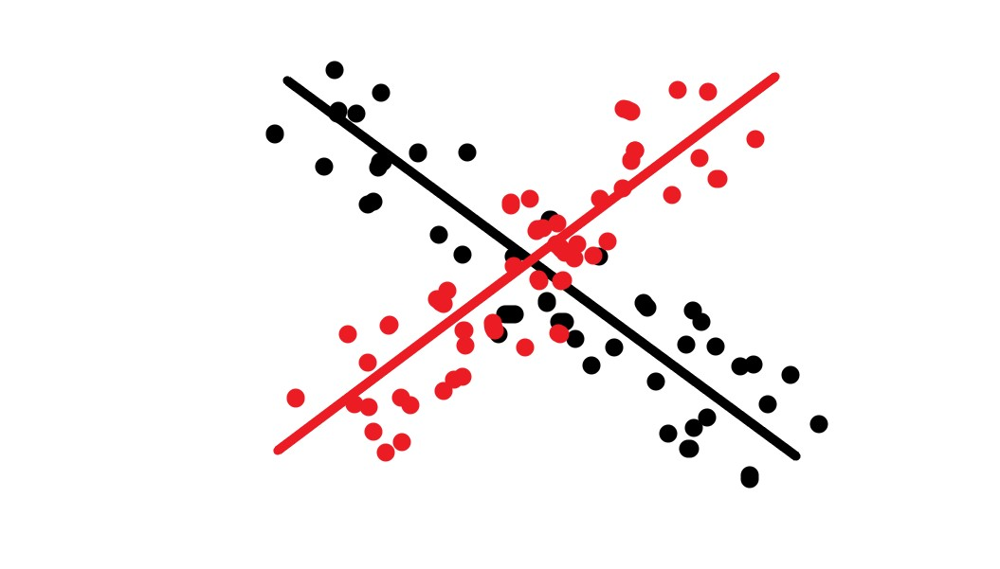



The first step is to isolate these three clusters, and the next is to join them together. Could do that by making a new df which is just clusters 4, 0 and 1. 

Then another df which is clusters 3, 0 and 2. 

Graph each on a scatterplot (income / points) to check that the clusters are correct. 
Perform EDA, corr, and  

Then add a new column to each which is 'group' column and call them A and B respectively. 
Then concatenate the dfs horizontally (ie as more rows).

Then see what dynamics are there to be teased out. 

In [608]:
# Create the first df (clusters 4, 0 and 1).
grp_A = DF3_2[DF3_2['cluster'].isin([4,0,1])]
grp_A.head()
grp_A.describe()

,age,income,score,points,product,customer_id,cluster
count,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000
mean,40.257991,34.543592,49.509132,1092.366819,3565.748858,132.985540,1.025114
std,15.122892,13.524450,21.110964,539.904791,2921.602585,88.365098,1.559720
min,17.000000,12.300000,3.000000,25.000000,107.000000,0.000000,0.000000
25%,28.000000,22.960000,41.000000,715.000000,1183.000000,57.250000,0.000000
50%,38.000000,35.670000,50.000000,1175.000000,2795.000000,106.500000,0.000000
75%,49.000000,46.740000,59.000000,1485.000000,5430.000000,223.000000,1.000000
max,72.000000,62.320000,99.000000,2332.000000,11086.000000,271.000000,4.000000


It's almost half of the total dataset, which is good. Can already see some characteristics of this group re: income (which is however likely be a similar mean to the other), age (mean is 41 yrs), score (mean is 53) and points (mean is nearly 2k).


In [609]:
# Create the first df (clusters 3, 0 and 2).
grp_B = DF3_2[DF3_2['cluster'].isin([3,0,2])]
grp_B.head()
grp_B.describe()

,age,income,score,points,product,customer_id,cluster
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,40.204795,58.320534,50.192466,1931.554795,4974.755479,184.800685,1.183562
std,13.424420,18.215003,23.537713,1313.261279,3115.683621,83.486218,1.303448
min,17.000000,31.980000,1.000000,40.000000,107.000000,56.000000,0.000000
25%,32.000000,44.280000,40.000000,1152.000000,2495.000000,111.000000,0.000000
50%,38.000000,54.940000,50.000000,1463.000000,4452.000000,163.000000,0.000000
75%,49.000000,70.725000,60.000000,2322.000000,7141.000000,266.000000,2.000000
max,72.000000,112.340000,97.000000,6847.000000,11086.000000,324.000000,3.000000


Describe:

Not much difference with age, income. 
Some difference: review polarity and sentiment score. 
Difference: range in points.

In [610]:
grp_A.corr()

,age,income,score,points,product,customer_id,cluster
age,1.000000,0.115572,-0.250222,0.147898,0.073643,0.132972,-0.272309
income,0.115572,1.000000,-0.021660,0.787718,0.271995,0.360352,-0.689415
score,-0.250222,-0.021660,1.000000,0.473995,-0.007977,0.021302,0.557883
points,0.147898,0.787718,0.473995,1.000000,0.219810,0.282894,-0.317511
product,0.073643,0.271995,-0.007977,0.219810,1.000000,0.101033,-0.234427
customer_id,0.132972,0.360352,0.021302,0.282894,0.101033,1.000000,-0.240880
cluster,-0.272309,-0.689415,0.557883,-0.317511,-0.234427,-0.240880,1.000000


In [611]:
grp_B.corr()

,age,income,score,points,product,customer_id,cluster
age,1.000000,-0.130381,-0.117603,-0.077525,-0.055555,0.005944,-0.181001
income,-0.130381,1.000000,-0.003493,0.471617,0.094397,0.358614,0.774576
score,-0.117603,-0.003493,1.000000,0.847473,-0.001312,-0.056991,0.275955
points,-0.077525,0.471617,0.847473,1.000000,0.037527,0.111909,0.610007
product,-0.055555,0.094397,-0.001312,0.037527,1.000000,0.044811,0.229508
customer_id,0.005944,0.358614,-0.056991,0.111909,0.044811,1.000000,0.315362
cluster,-0.181001,0.774576,0.275955,0.610007,0.229508,0.315362,1.000000


Correlation:
- Some difference: Score and points (weaker with B), points and income (much stronger with A)
- Differnce: points and income, sentiment score (though both small), review polarity and points (neg, but both quite small)


Interesting: The INCOME and SCORE correlation is OPPOSITE but equally strong between the two. This makes sense as one 
graph has dots going one way, and one the other

TODO: 
I'd like to figure out the groups where there is a strong correlation with spend score and points. 



Text(0, 0.5, 'points')

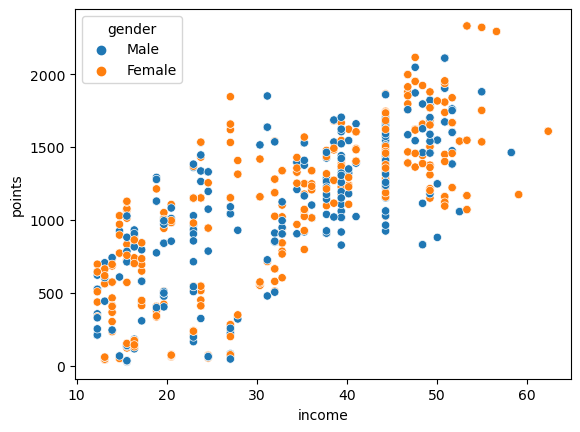

In [612]:
# EDA the df via scatterlpots and boxplots etc. 
# first check the original arguemtns
sns.scatterplot(data = grp_A, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

Obviously a strong correlation appears here (as is seen already in the corr() table above. 
What's even more interesting in the corr table is the strong correlation between those two factors AND spend score. So obviously what someone spends, within this cluster, is not irrelevant. But - is it insightful? Is it independent or dependent? Unkown yet. 

Text(0, 0.5, 'points')

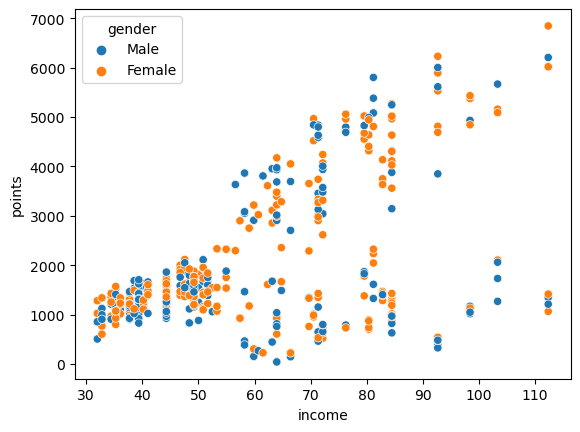

In [613]:
# Gpr B
sns.scatterplot(data = grp_B, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

Clearly there are two gclusters here  - or at least there is one with many outliers. Once the income is over 60 the correlation breaks down. Run again with that subset (income under 60)

Text(0, 0.5, 'points')

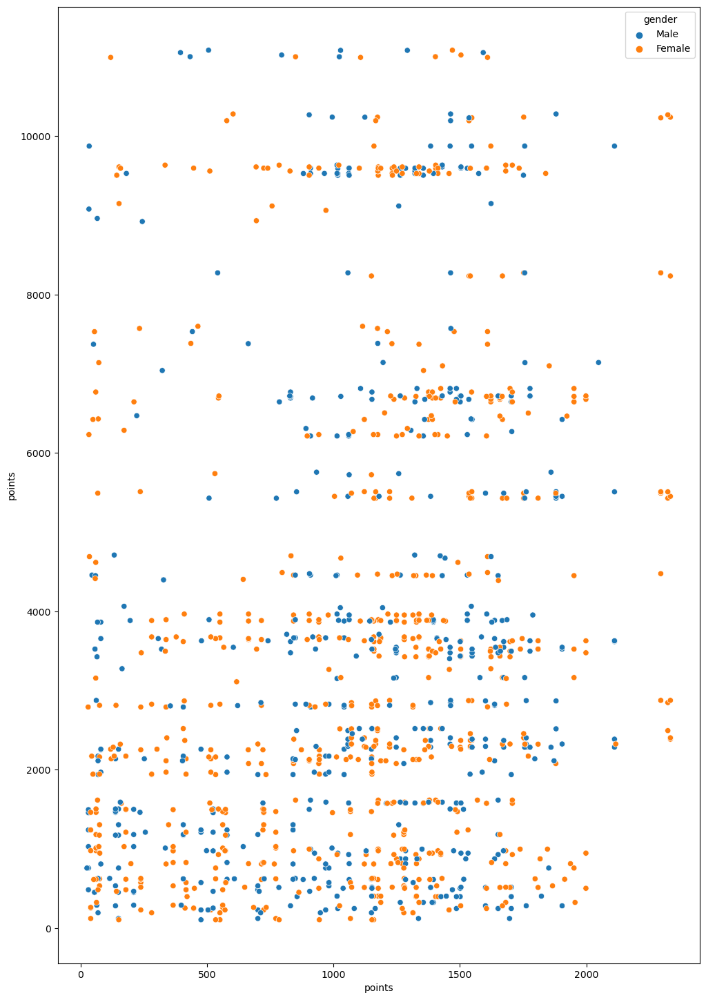

In [614]:

plt.figure(figsize = (12,18))
sns.scatterplot(data = grp_A, x = 'points', y = 'product', hue = 'gender')
plt.xlabel('points')
plt.ylabel('points')

In [615]:
# Clearly only certain products get certain points, here, as we've seen before.  

Text(0, 0.5, 'points')

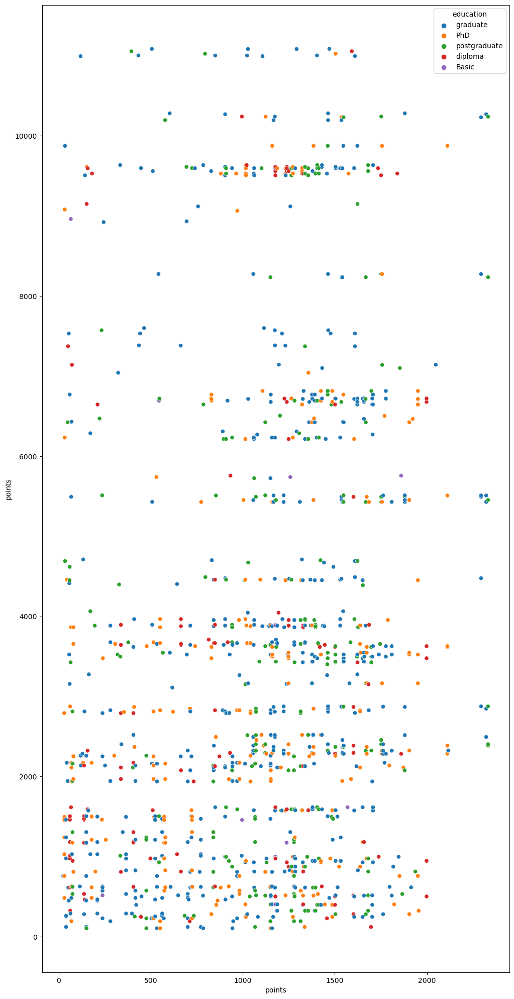

In [616]:
grp_A = grp_A.sort_values('points').reset_index()

plt.figure(figsize = (12,25))
sns.scatterplot(data = grp_A, x = 'points', y = 'product', hue = 'education')
plt.xlabel('points')
plt.ylabel('points')

Text(90.34722222222221, 0.5, 'product')

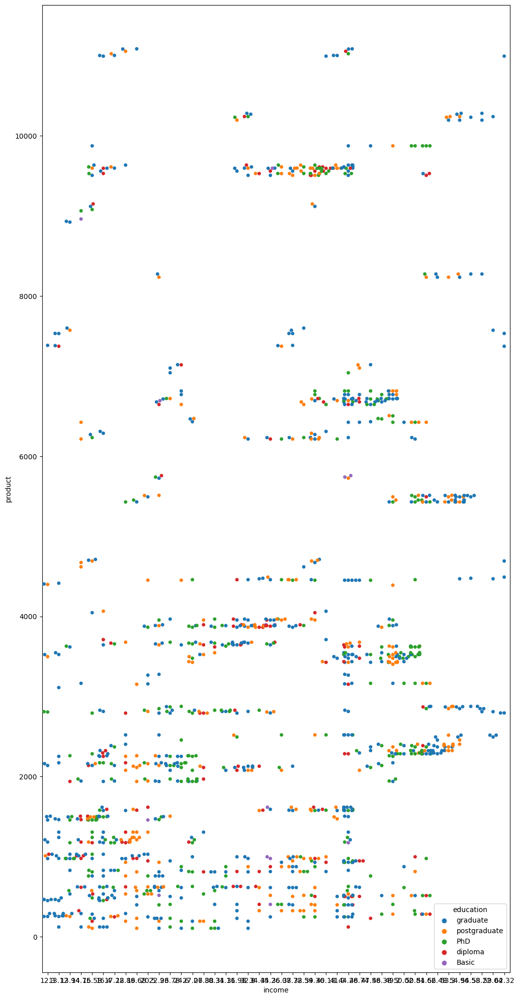

In [617]:

plt.figure(figsize = (12,25))
sns.swarmplot(data = grp_A, x = 'income', y = 'product', hue = 'education')
plt.xlabel('income')
plt.ylabel('product')

In [618]:
# There is a correlation here of some kind, now that the products are sorted for their points
# (althought there are definitey outliers

# Create a new column which is a copy of the index, and is called 'product_2'

In [619]:
# The '0' cluster may be confusing the correlations, if it has datapoints that should really be either 
# be "A " or "B" Remove that value from the groups and rerun code.

In [620]:
# Create the first df (clusters 4, and 1).
grp_A2 = DF3_2[DF3_2['cluster'].isin([4,1])]
# grp_A2.head()
grp_A.describe()

,index,age,income,score,points,product,customer_id,cluster
count,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000,1314.000000
mean,1008.713090,40.257991,34.543592,49.509132,1092.366819,3565.748858,132.985540,1.025114
std,602.744345,15.122892,13.524450,21.110964,539.904791,2921.602585,88.365098,1.559720
min,0.000000,17.000000,12.300000,3.000000,25.000000,107.000000,0.000000,0.000000
25%,476.250000,28.000000,22.960000,41.000000,715.000000,1183.000000,57.250000,0.000000
50%,1026.500000,38.000000,35.670000,50.000000,1175.000000,2795.000000,106.500000,0.000000
75%,1581.750000,49.000000,46.740000,59.000000,1485.000000,5430.000000,223.000000,1.000000
max,1991.000000,72.000000,62.320000,99.000000,2332.000000,11086.000000,271.000000,4.000000


In [621]:
# Create the second df (clusters 3, and 2).
grp_B2 = DF3_2[DF3_2['cluster'].isin([3,2])]
grp_B2.head()
grp_B.describe()

,age,income,score,points,product,customer_id,cluster
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,40.204795,58.320534,50.192466,1931.554795,4974.755479,184.800685,1.183562
std,13.424420,18.215003,23.537713,1313.261279,3115.683621,83.486218,1.303448
min,17.000000,31.980000,1.000000,40.000000,107.000000,56.000000,0.000000
25%,32.000000,44.280000,40.000000,1152.000000,2495.000000,111.000000,0.000000
50%,38.000000,54.940000,50.000000,1463.000000,4452.000000,163.000000,0.000000
75%,49.000000,70.725000,60.000000,2322.000000,7141.000000,266.000000,2.000000
max,72.000000,112.340000,97.000000,6847.000000,11086.000000,324.000000,3.000000


In [622]:
# Massive difference re std deviation re: points. 

In [623]:
# Compare correlation tables
grp_A2.corr()

,age,income,score,points,product,customer_id,cluster
age,1.000000,0.085169,-0.442394,-0.262827,0.061672,0.084242,-0.431729
income,0.085169,1.000000,-0.017250,0.381121,0.051150,0.110045,-0.006180
score,-0.442394,-0.017250,1.000000,0.864246,-0.018872,0.026999,0.932313
points,-0.262827,0.381121,0.864246,1.000000,0.014485,0.065863,0.810998
product,0.061672,0.051150,-0.018872,0.014485,1.000000,0.005166,-0.018184
customer_id,0.084242,0.110045,0.026999,0.065863,0.005166,1.000000,0.065010
cluster,-0.431729,-0.006180,0.932313,0.810998,-0.018184,0.065010,1.000000


In [624]:
grp_B2.corr()

,age,income,score,points,product,customer_id,cluster
age,1.000000,0.054140,-0.232577,-0.143138,-0.087655,0.007575,-0.258924
income,0.054140,1.000000,-0.033683,0.238722,-0.308320,0.152644,-0.058447
score,-0.232577,-0.033683,1.000000,0.938377,-0.014788,-0.116195,0.959995
points,-0.143138,0.238722,0.938377,1.000000,-0.104826,-0.064144,0.899022
product,-0.087655,-0.308320,-0.014788,-0.104826,1.000000,-0.090621,-0.007461
customer_id,0.007575,0.152644,-0.116195,-0.064144,-0.090621,1.000000,-0.089273
cluster,-0.258924,-0.058447,0.959995,0.899022,-0.007461,-0.089273,1.000000


- The relationship between spend score and points is now STRONGER for A2 but WEAKER for B2.
- Income / Score corr is now slightly higher for both (although still neg for one)
- Income / Points is now really high for A2 but weak for B2 (without being negative).
- Same for score / points. 



Text(0, 0.5, 'points')

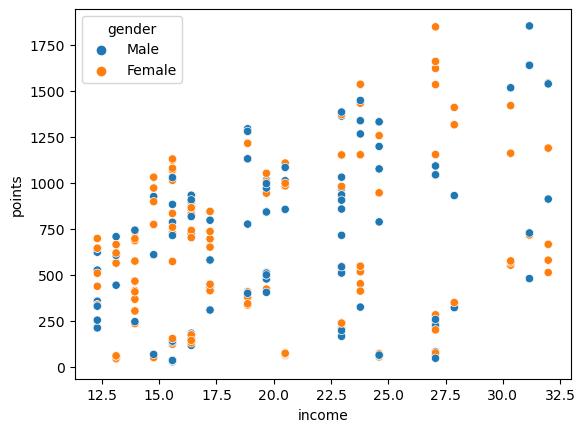

In [625]:
# EDA the df via scatterlpots and boxplots etc. 
# first check the original arguemtns
sns.scatterplot(data = grp_A2, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

Text(0, 0.5, 'points')

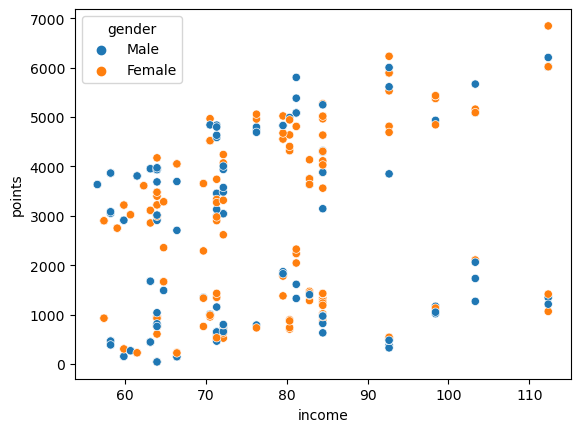

In [626]:
# EDA the df via scatterlpots and boxplots etc. 
# first check the original arguemtns
sns.scatterplot(data = grp_B2, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

In [627]:
# I'd like to do a kmeans on this one to find out what makes these two datasets unique (outisde more / less income)
# There's  positive correlation here for the lower income group. And then again for the higher income group. 
# view B again to compare. 


Text(0, 0.5, 'points')

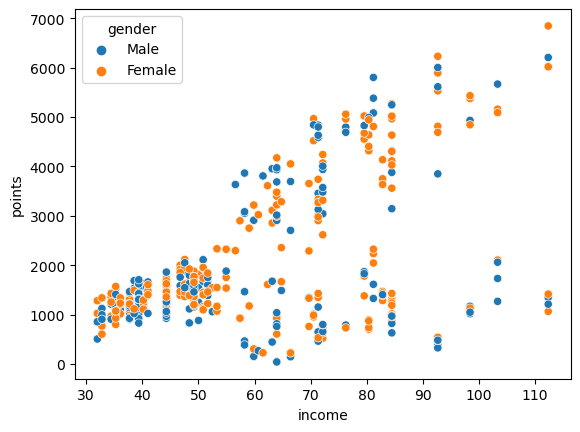

In [628]:
# EDA the df via scatterlpots and boxplots etc. 
# first check the original arguemtns
sns.scatterplot(data = grp_B, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

In [629]:
# Actually the positive correlation could be said to go right up to the 60k mark. 
# A again to compare. 

Text(0, 0.5, 'points')

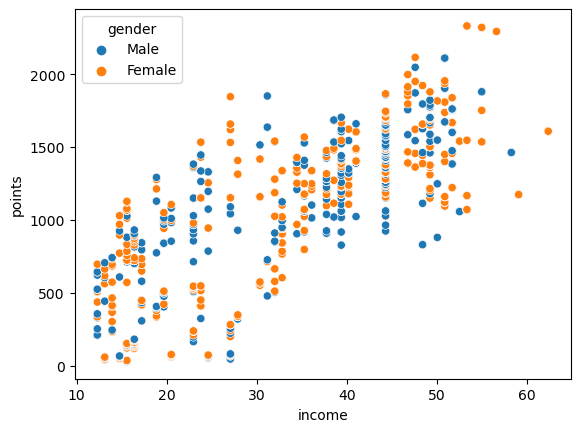

In [630]:
# EDA the df via scatterlpots and boxplots etc. 
# first check the original arguemtns
sns.scatterplot(data = grp_A, x = 'income', y = 'points', hue = 'gender')
plt.xlabel('income')
plt.ylabel('points')

In [639]:

DF3_2.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,cluster
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178,1
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178,4
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2,1
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2,4
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5,1


In [640]:
# print the values of the income_bracket column
print(DF3_2['income_bracket'].unique())

['0 -20' '21-40' '41- 60' '61 - 80' '80+']


In [641]:
# Graph the various variables of this data to show what demographic aspects we have access to, in this group.
# set the order for the income brackets. 
income_order = ['0 -20', '21-40', '41- 60',  '61 - 80', '80+' ]

# Reorder the income brackets in the dataframe
DF3_2['income_bracket'] = pd.Categorical(DF3_2['income_bracket'], categories = income_order, ordered = True)


<Axes: xlabel='income_bracket', ylabel='age'>

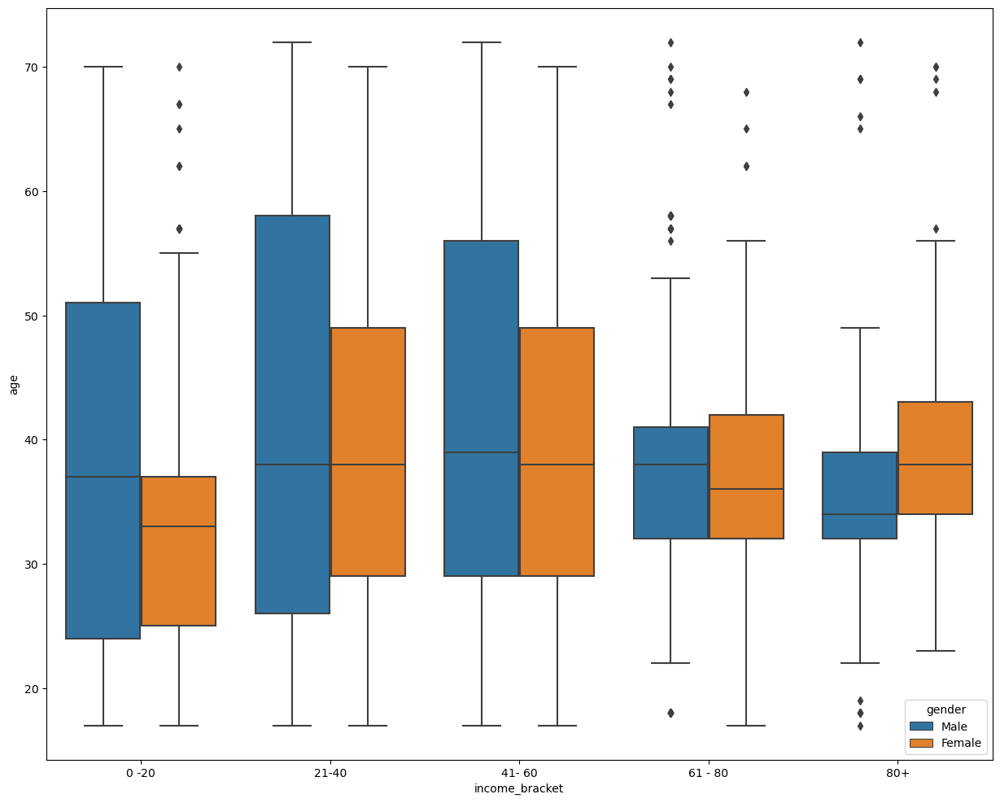

In [642]:
plt.figure(figsize = (15, 12))
sns.boxplot(data = DF3_2, x = 'income_bracket', y = 'age', hue = 'gender')

<Axes: xlabel='gender', ylabel='age'>

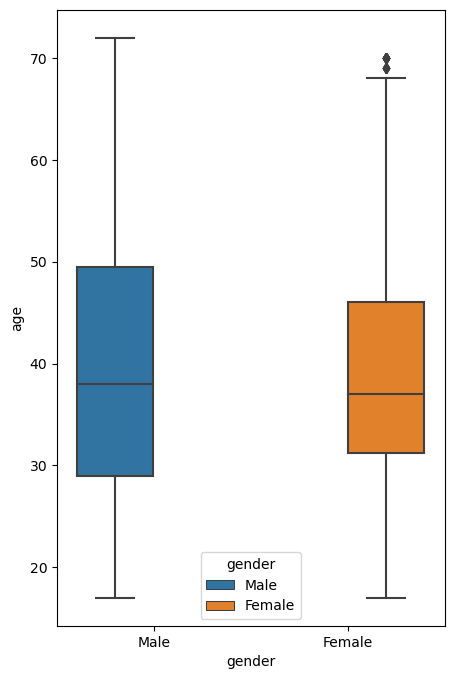

In [643]:
plt.figure(figsize = (5, 8))
sns.boxplot(data = DF3_2, x = 'gender', y = 'age', hue = 'gender')

<Axes: xlabel='gender', ylabel='income'>

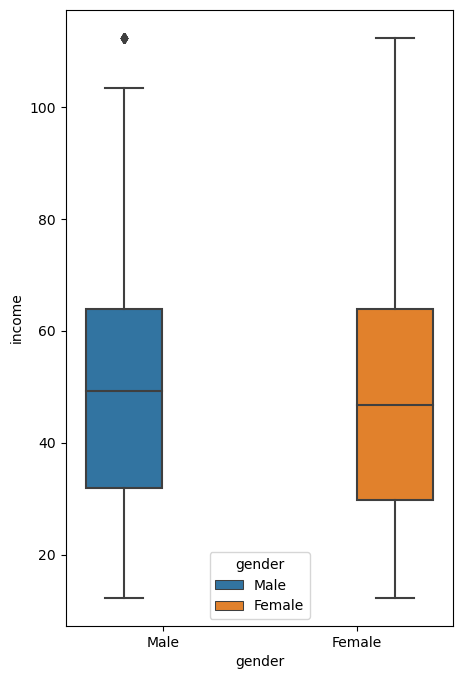

In [644]:
plt.figure(figsize = (5, 8))
sns.boxplot(data = DF3_2, x = 'gender', y = 'income', hue = 'gender')

<Axes: xlabel='education', ylabel='income'>

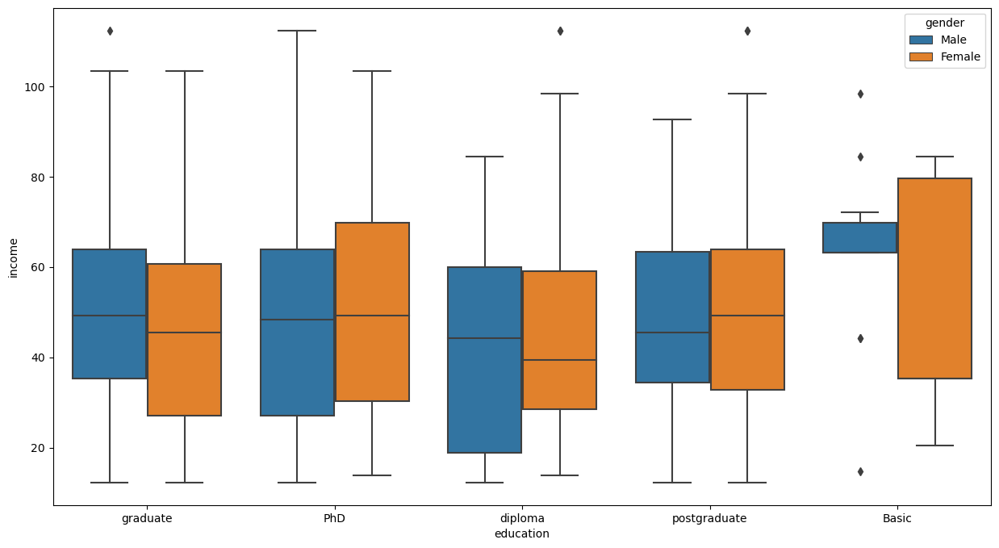

In [645]:
plt.figure(figsize = (15, 8))
sns.boxplot(data = DF3_2, x = 'education', y = 'income', hue = 'gender')

In [646]:
DF3_2['education'].value_counts()

graduate        900
PhD             460
postgraduate    400
diploma         190
Basic            50
Name: education, dtype: int64

In [647]:
income_ed = DF3_2.groupby('education')['income'].mean().reset_index()
print(income_ed)

      education     income
0         Basic  59.581200
1           PhD  51.225043
2       diploma  43.585158
3      graduate  47.302156
4  postgraduate  46.906050


In [648]:
DF3_2.describe()

,age,income,score,points,product,customer_id,cluster
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000,1.537500
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397,1.478745
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000,0.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000,0.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000,1.000000
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000,3.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000,4.000000


This table is useful for the marketing team, but it has too much info - edit this in image editing softeare to remove the nerdier stats. 




<Axes: xlabel='age', ylabel='Density'>

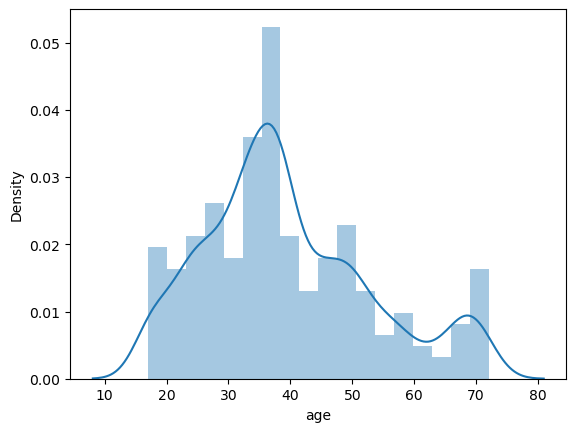

In [649]:
# Check the distribtion of age and income, to check the validity of the recommendations we can make with this dataset.
# Age
sns.distplot(reviews['age'])

The age data is skewed to the right, but we can account for this in part because:
- these are online purchases and people under about 18 or so don't tend to have credit cards (check this assumption)
- there is a leap after 65, which is about retirement age, so more people with free time (verify this)

<Axes: xlabel='income', ylabel='Density'>

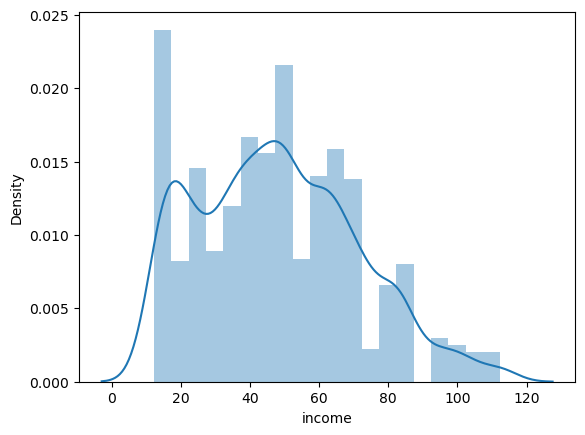

In [650]:
# Income
sns.distplot(reviews['income'], bins = 20)

This appears roughly normally distributed, with some anomalies, but we can check the normalit of thise data set #TODO. 

The dataset is  missing the data on the left because this is annual salary (meta data). The peak at the left end of the dataset is harder to explain. We know that age is relativesly normally distrubuted so it's not because there are lots of young people in teh dataset. 


<Axes: xlabel='product', ylabel='Density'>

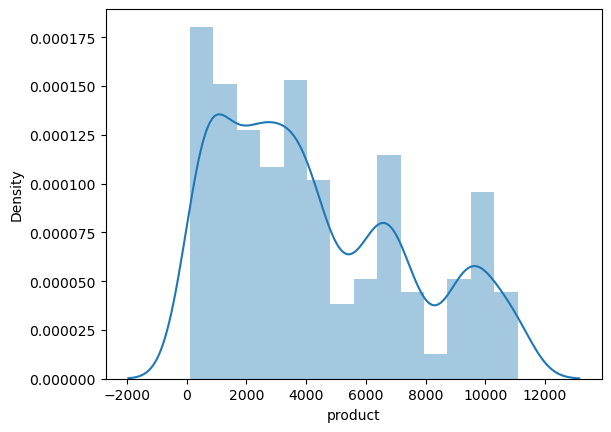

In [651]:
# Products
sns.distplot(reviews['product'])

In [652]:
reviews.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
211,Female,37,15.58,99,1067,postgraduate,1497,Very cute and very well designed. Makes adorab...,Makes adorable puppies.,61-100,0 -20,14
1721,Female,38,15.58,99,1078,graduate,6271,The kids who come to my studio love this,Great toy!!,61-100,0 -20,13
1011,Female,37,15.58,99,1067,postgraduate,577,Great game! Long but that is to be expected w...,Great game! Long but that is to be expected ...,61-100,0 -20,14
1404,Female,33,15.58,99,1012,graduate,2162,Amazing expansion to Lords of Waterdeep. I lov...,Amazing expansion to Lords of Waterdeep,61-100,0 -20,13
811,Female,37,15.58,99,1067,postgraduate,1183,great game,Five Stars,61-100,0 -20,14


In [653]:
# Barplot of how many people are in each other these groups
gender = reviews.groupby('gender').mean()
gender.head()

,age,income,score,points,product,customer_id
gender,,,,,,
Female,38.767857,47.291304,50.691071,1601.166964,4286.818750,88.758036
Male,40.420455,49.081659,49.120455,1548.587500,4363.415909,253.303409


<Axes: xlabel='score', ylabel='Density'>

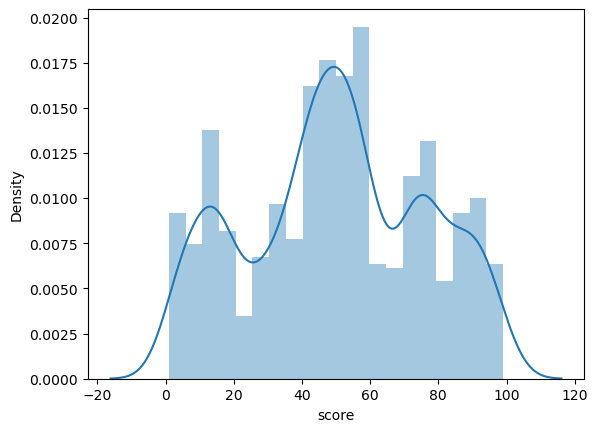

In [654]:
# Score
sns.distplot(reviews['score'], bins = 20)

Score is pretty normal

<Axes: xlabel='points', ylabel='Density'>

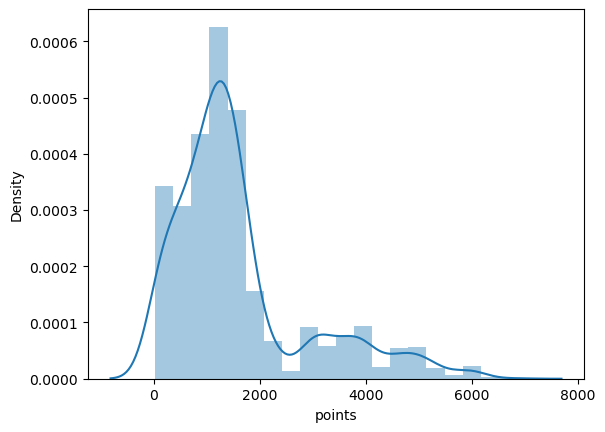

In [656]:
# Score
sns.distplot(reviews['points'], bins = 20)

Massive right tail. We know that points is income x score (approximately), that score does not taper at the right, and that income is right skewed, which is what we are seeing the effect of here.

# Week 3 assignment: NLP using Python
Customer reviews were downloaded from the website of Turtle Games. This data will be used to steer the marketing department on how to approach future campaigns. Therefore, the marketing department asked you to identify the 15 most common words used in online product reviews. They also want to have a list of the top 20 positive and negative reviews received from the website. Therefore, you need to apply NLP on the data set.

## Instructions
1. Load and explore the data. 
    1. Sense-check the DataFrame.
    2. You only need to retain the `review` and `summary` columns.
    3. Determine if there are any missing values.
2. Prepare the data for NLP
    1. Change to lower case and join the elements in each of the columns respectively (`review` and `summary`).
    2. Replace punctuation in each of the columns respectively (`review` and `summary`).
    3. Drop duplicates in both columns (`review` and `summary`).
3. Tokenise and create wordclouds for the respective columns (separately).
    1. Create a copy of the DataFrame.
    2. Apply tokenisation on both columns.
    3. Create and plot a wordcloud image.
4. Frequency distribution and polarity.
    1. Create frequency distribution.
    2. Remove alphanumeric characters and stopwords.
    3. Create wordcloud without stopwords.
    4. Identify 15 most common words and polarity.
5. Review polarity and sentiment.
    1. Plot histograms of polarity (use 15 bins) for both columns.
    2. Review the sentiment scores for the respective columns.
6. Identify and print the top 20 positive and negative reviews and summaries respectively.
7. Include your insights and observations.

## 1. Load and explore the data

In [658]:
# Import all the necessary packages.
import pandas as pd
import numpy as np
import nltk 
import os 
import matplotlib.pyplot as plt

# nltk.download ('punkt').
# nltk.download ('stopwords').

!pip install wordcloud
!pip install textblob

from wordcloud import WordCloud
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from nltk.corpus import stopwords
from textblob import TextBlob
from scipy.stats import norm

# Import Counter.
from collections import Counter

import warnings
warnings.filterwarnings('ignore')

In [659]:
# Load the data set as df3.
DF3=pd.read_csv("reviews.csv")

# View DataFrame.
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"When it comes to a DM's screen, the space on t...",The fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,An Open Letter to GaleForce9*:\n\nYour unpaint...,Another worthless Dungeon Master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"Nice art, nice printing. Why two panels are f...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,Amazing buy! Bought it as a gift for our new d...,Five Stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,As my review of GF9's previous screens these w...,Money trap,0-40,0 -20,5


In [660]:
# Explore data set.
DF3.describe()

,age,income,score,points,product,customer_id
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000


In [661]:
# Keep necessary columns. Drop unnecessary columns.
#DF3 = DF3.drop(['gender', 'age', 'income', 'score', 'points','education','product',], axis=1)
# View DataFrame.
# DF3.head()

In [662]:
# Determine if there are any missing values.
print(DF3.isna().sum())

gender            0
age               0
income            0
score             0
points            0
education         0
product           0
review            0
summary           0
score_bracket     0
income_bracket    0
customer_id       0
dtype: int64


## 2. Prepare the data for NLP
### 2a) Change to lower case and join the elements in each of the columns respectively (review and summary)

In [663]:
# Review: Change all to lower case and join with a space.
DF3['review'] = DF3['review'].apply(lambda x: " ".join(x.lower() for x in x.split()))


In [664]:
# Review: Change all to lower case and join with a space.
DF3['summary'] = DF3['summary'].apply(lambda x: " ".join(x.lower() for x in x.split()))

In [665]:
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,"when it comes to a dm's screen, the space on t...",the fact that 50% of this space is wasted on a...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9*: your unpainted ...,another worthless dungeon master's screen from...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,"nice art, nice printing. why two panels are fi...","pretty, but also pretty useless",0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,amazing buy! bought it as a gift for our new d...,five stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,as my review of gf9's previous screens these w...,money trap,0-40,0 -20,5


### 2b) Replace punctuation in each of the columns respectively (review and summary)

In [666]:
# Replace all the punctuations in review column.
# Remove punctuation.
DF3['review'] = DF3['review'].str.replace('[^\w\s]','')

# Preview the result.
DF3['review'].head()

0    when it comes to a dms screen the space on the...
1    an open letter to galeforce9 your unpainted mi...
2    nice art nice printing why two panels are fill...
3    amazing buy bought it as a gift for our new dm...
4    as my review of gf9s previous screens these we...
Name: review, dtype: object

In [667]:
# Replace all the puncuations in summary column.
# Remove punctuation.
DF3['summary'] = DF3['summary'].str.replace('[^\w\s]','')

# Preview the result.
DF3['summary'].head()

0    the fact that 50 of this space is wasted on ar...
1    another worthless dungeon masters screen from ...
2                       pretty but also pretty useless
3                                           five stars
4                                           money trap
Name: summary, dtype: object

### 2c) Drop duplicates in both columns

In [668]:
# Check the number of duplicate values in the review column.
DF3.review.duplicated().sum()

50

In [669]:
# Check the number of duplicate values in the review column.
DF3.summary.duplicated().sum()

649

In [670]:
DF3.duplicated().sum()

0

## 3. Tokenise and create wordclouds

In [671]:
# Create new DataFrame (copy DataFrame).
DF4 = DF3

# View DataFrame.
DF4.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5


In [672]:
# Apply tokenisation to review column.
DF4['review_tokens'] = DF4['review'].apply(word_tokenize)

# Apply tokenisation to summmary column.
DF4['summary_tokens'] = DF4['summary'].apply(word_tokenize)

# Preview data.
DF4.head()
# View DataFrame.

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was..."
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,..."
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]"
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]"
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]"


In [673]:
# review: Define an empty list of tokens.
review_tokens_list = []

for i in range(DF4.shape[0]):
    # Add each token to the list.
    review_tokens_list = review_tokens_list + DF4['review_tokens'][i]

In [674]:
# summary: Define an empty list of tokens.
summary_tokens_list = []

for i in range(DF4.shape[0]):
    # Add each token to the list.
    summary_tokens_list = summary_tokens_list + DF4['summary_tokens'][i]

In [675]:
!pip install wordcloud

**Review**

In [676]:
# Import the FreqDist class.
from nltk.probability import FreqDist

# Calculate the frequency distribution.
fdist_review = FreqDist(review_tokens_list)

# Preview data.
fdist_review

FreqDist({'the': 5452, 'and': 3234, 'to': 3164, 'a': 3161, 'of': 2488, 'i': 2091, 'it': 2090, 'is': 1782, 'this': 1776, 'game': 1685, ...})

In [677]:
# Filter out tokens that are neither alphabets nor numbers (to eliminate punctuation marks, etc.).
review_tokens_words = [word for word in review_tokens_list if word.isalnum()]

In [678]:
# Download the stopword list.
nltk.download ('stopwords')
from nltk.corpus import stopwords

# Create a set of English stopwords.
english_stopwords = set(stopwords.words('english'))

# Create a filtered list of tokens without stopwords.
tokens3 = [x for x in review_tokens_words if x.lower() not in english_stopwords]

# Define an empty string variable.
tokens3_string = ''

for value in review_tokens_words:
    # Add each filtered token word to the string.
    tokens3_string = tokens3_string + value + ' '

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


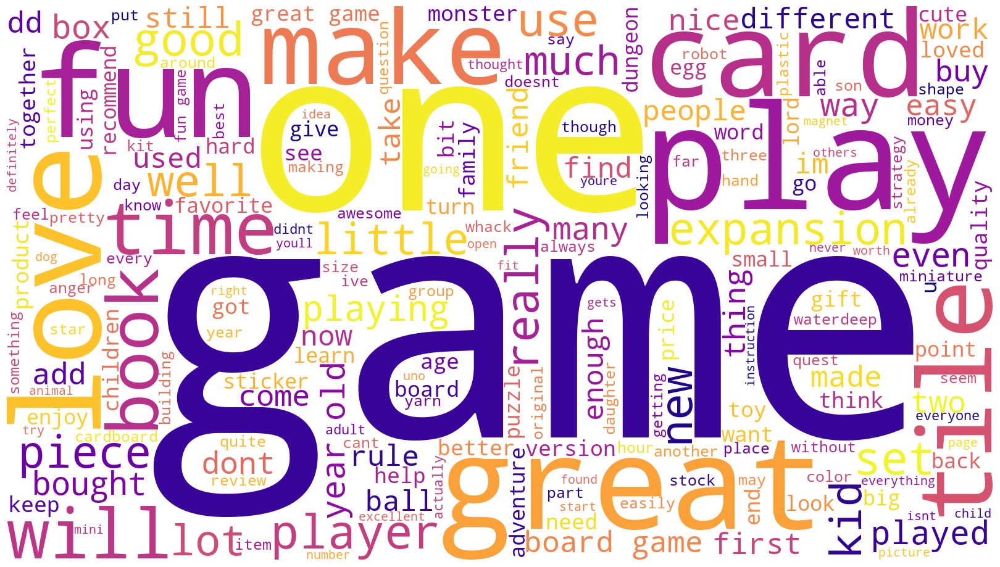

In [679]:
# Create a WordCloud.
wordcloud_review = WordCloud(width = 1600, height = 900, 
                background_color ='white', 
                colormap='plasma', 
                min_font_size = 10).generate(tokens3_string) 

# Plot the WordCloud image.                        
plt.figure(figsize = (16, 9), facecolor = None) 
plt.imshow(wordcloud_review) 
plt.axis('off') 
plt.tight_layout(pad = 0) 
plt.show()

# Note that your word cloud might differ slightly to the one provided.

**Summary**

In [680]:
# Import the FreqDist class.
from nltk.probability import FreqDist

# Calculate the frequency distribution.
fdist_summary = FreqDist(summary_tokens_list)

# Preview data.
fdist_summary

FreqDist({'stars': 466, 'five': 381, 'game': 319, 'great': 295, 'the': 261, 'a': 240, 'for': 232, 'fun': 218, 'to': 192, 'and': 168, ...})

In [681]:
# Filter out tokens that are neither alphabets nor numbers (to eliminate punctuation marks, etc.).
summary_tokens_words = [word for word in summary_tokens_list if word.isalnum()]

In [682]:
# Download the stopword list.
nltk.download ('stopwords')
from nltk.corpus import stopwords

# Create a set of English stopwords.
english_stopwords = set(stopwords.words('english'))

# Create a filtered list of tokens without stopwords.
tokens4 = [x for x in summary_tokens_words if x.lower() not in english_stopwords]

# Define an empty string variable.
tokens4_string = ''

for value in summary_tokens_words:
    # Add each filtered token word to the string.
    tokens4_string = tokens4_string + value + ' '

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


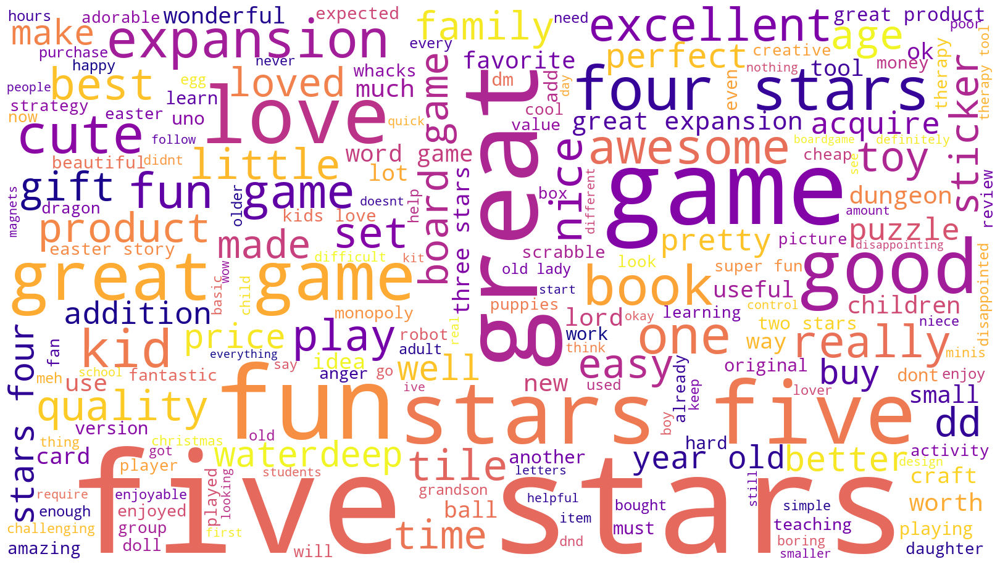

In [683]:
# Create a WordCloud.
wordcloud_summary = WordCloud(width = 1600, height = 900, 
                background_color ='white', 
                colormap='plasma', 
                min_font_size = 10).generate(tokens4_string) 

# Plot the WordCloud image.                        
plt.figure(figsize = (16, 9), facecolor = None) 
plt.imshow(wordcloud_summary) 
plt.axis('off') 
plt.tight_layout(pad = 0) 
plt.show()

# Note that your word cloud might differ slightly to the one provided.

### 4d) Identify 15 most common words and polarity

In [684]:
# Determine the 15 most common words.
# review

# Generate a DataFrame from Counter.
counts_review = pd.DataFrame(Counter(tokens3).most_common(15),
                      columns=['Word', 'Frequency']).set_index('Word')

# Preview data.
counts_review

,Frequency
Word,
game,1685
great,596
fun,553
one,530
play,502
like,414
love,331
really,319
get,319


In [685]:
# Determine the 15 most common words.
# summary

# Generate a DataFrame from Counter.
counts_summary = pd.DataFrame(Counter(tokens4).most_common(15),
                      columns=['Word', 'Frequency']).set_index('Word')

# Preview data.
counts_summary

,Frequency
Word,
stars,466
five,381
game,319
great,295
fun,218
love,93
good,92
four,58
like,54


## 5. Review polarity and sentiment: Plot histograms of polarity (use 15 bins) and sentiment scores for the respective columns.

In [686]:
from textblob import TextBlob

In [687]:
# Provided function.
def get_sentiment_score(text):
    blob = TextBlob(text)
    return blob.sentiment.polarity

### Determine polarity of  columns

In [688]:
 # Import the prebuilt rules and values of the vader lexicon.
nltk.download('vader_lexicon')
# Import the vader class SentimentIntensityAnalyser.
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Create a variable sia to store the SentimentIntensityAnalyser() method.
sia = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [689]:
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was..."
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,..."
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]"
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]"
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]"


In [690]:
DF3['review_polarity'] = DF3['review'].apply(lambda x:
                                            sia.polarity_scores(x)['compound'])
DF3['summary_polarity'] = DF3['summary'].apply(lambda d:
                                            sia.polarity_scores(d)['compound'])
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens,review_polarity,summary_polarity
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was...",-0.6333,-0.0711
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,...",0.9404,-0.4404
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]",-0.0045,0.4019
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]",0.8860,0.0000
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]",-0.6808,-0.3182


In [691]:
# Review: Create a histogram plot with bins = 15.

DF3['review_sentiment_score'] = DF3['review'].apply(get_sentiment_score)


DF3['summary_sentiment_score'] = DF3['summary'].apply(get_sentiment_score)
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was...",-0.6333,-0.0711,-0.036111,0.15
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,...",0.9404,-0.4404,0.035952,-0.80
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]",-0.0045,0.4019,0.116640,0.00
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]",0.8860,0.0000,0.578788,0.00
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]",-0.6808,-0.3182,-0.316667,0.00


Text(0.5, 1.0, 'Polarity of Reviews')

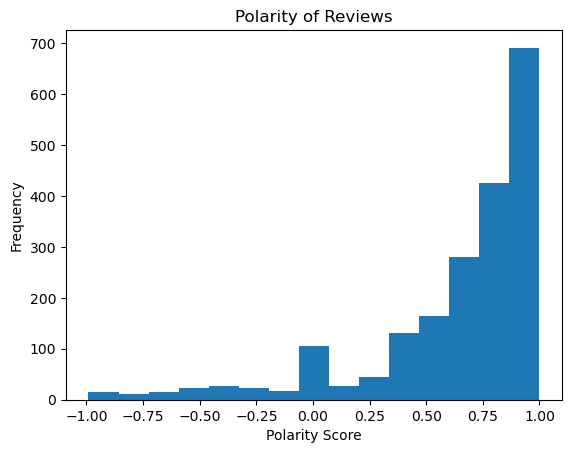

In [692]:
# Review - Histogram of polarity
plt.hist(DF3['review_polarity'], bins = 15)
plt.xlabel('Polarity Score')
plt.ylabel('Frequency')
plt.title('Polarity of Reviews')

Text(0.5, 1.0, 'Sentiment Score of Reviews')

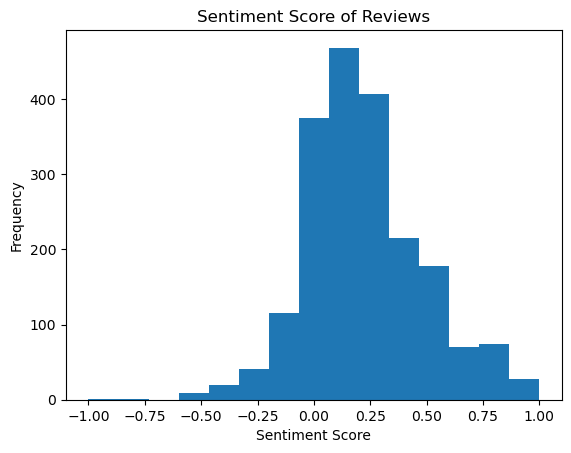

In [693]:
# Review -  Histogram of sentiment score
plt.hist(DF3['review_sentiment_score'], bins = 15)
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.title('Sentiment Score of Reviews')

In [694]:
REview Sentiment Score is the most normally distributed of the four

SyntaxError: invalid syntax (1043310372.py, line 1)

Text(0.5, 1.0, 'Sentiment Score of Summaries')

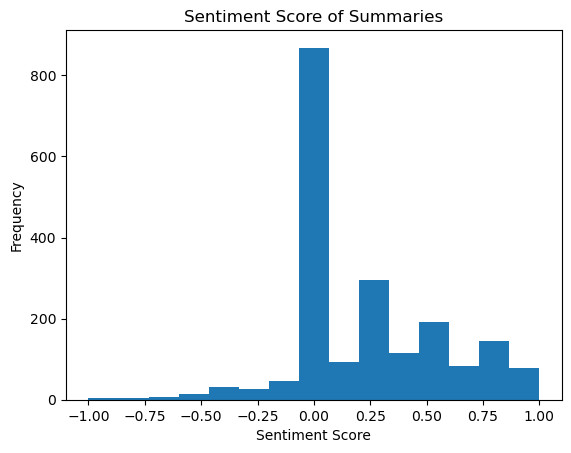

In [695]:
# Summary -  Histogram of sentiment score
plt.hist(DF3['summary_sentiment_score'], bins = 15)
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.title('Sentiment Score of Summaries')

Text(0.5, 1.0, 'Polarity of Summaries')

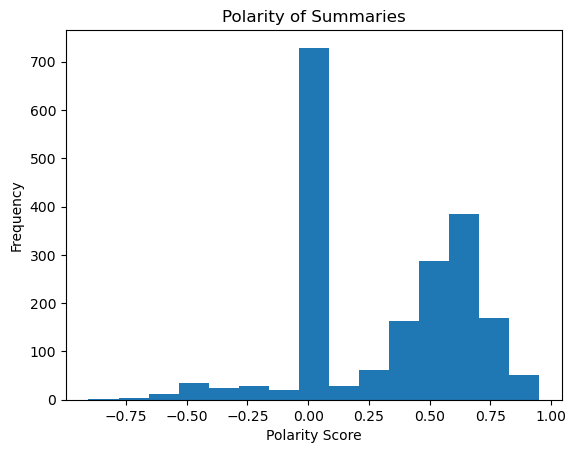

In [696]:
# Summary - Histogram of polarity
plt.hist(DF3['summary_polarity'], bins = 15)
plt.xlabel('Polarity Score')
plt.ylabel('Frequency')
plt.title('Polarity of Summaries')

In [697]:
# How are the reviews and the summaries different?
# Check metadata. 

## 6. Identify top 20 positive and negative reviews and summaries respectively

In [698]:
# Create two new columns: 
# one that combines the review_polarity and the review sentiment, and another for the summaries. 

In [699]:
DF3.describe()

,age,income,score,points,product,customer_id,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000,0.634687,0.306618,0.217688,0.219317
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397,0.397417,0.343110,0.262502,0.335627
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000,-0.991300,-0.905200,-1.000000,-1.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000,0.510600,0.000000,0.049888,0.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000,0.778300,0.421500,0.182258,0.062500
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000,0.906100,0.624900,0.361028,0.451250
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000,0.999600,0.952400,1.000000,1.000000


In [700]:
# Copy the df before dropping duplicates
DF4 = DF3

DF4 = DF4.drop_duplicates(subset='review')
DF4 = DF4.drop_duplicates(subset='summary')

In [701]:
DF4['average_review'] = (DF4['review_polarity'] + DF4['review_sentiment_score'])/2
    
DF4['average_summary'] = (DF4['summary_polarity'] + DF4['summary_sentiment_score'])/2

In [702]:
# Top 20 negative reviews.
top_20_negative_reviews = DF4.sort_values(by = 'average_review', ascending = True)['review'].head(20)
# View output.
top_20_negative_reviews =top_20_negative_reviews.tolist()
top_20_negative_reviews 

# View output.

['incomplete kit very disappointing',
 'booo unles you are patient know how to measure i didnt have the patience neither did my daughter boring unless you are a craft person which i am not',
 'my 8 yearold granddaughter and i were very frustrated and discouraged attempting this craft it is definitely not for a young child i too had difficulty understanding the directions we were very disappointed',
 'a crappy cardboard ghost of the original hard to believe they did this but they did shame on hasbro disgusting',
 'i bought this thinking it would be really fun  but i was disappointed  its really messy and it isnt nearly as easy as it seems also the glue is useless for a 9 year old the instructions are very difficult',
 'its uno with questions about anger its an okay way to discuss anger but it gets repetitive and the students start to get bored after about half a round',
 'this is horrible the directions are very hard for a child to read and comprehend themselves the yarn made a mess my 

In [703]:
# Top 20 positive reviews.
top_20_positive_reviews = DF4.sort_values(by = 'average_review', ascending = False)['review'].head(20)
# View output.
top_20_positive_reviews =top_20_positive_reviews.tolist()
top_20_positive_reviews 

# View output.

['my daughter loves her stickers awesome seller thank you ',
 'the best part i see is the box what a wonderfully diverse and rounded set for the cost i am so happy and as the dm you know that if i am happy my players are happy',
 'this is a great way to get minis and an awesome dungeon crawl system to boot it has inspired me to get into the world of dnd more thoroughly and i have been having a blast painting the minis as well the dungeon cards are great for assembling into just about any sort of underground encounter you could imagine',
 'great quality very cute and perfect for my toddler',
 'grand daughter loves stickers and she loves peppa so this was perfect',
 'the pictures are great  ive done one and gave it to a friend of mine who likes dragons',
 'one of the best and frankly necessary add ons if you like waterdeep you need this its a perfect expansion nonconvoluted adds a great deal and well designed',
 'this is a great tool to have at hand when playing quiddler',
 'love the eas

In [704]:
# Top 20 negative reviews.
top_20_negative_summaries = DF4.sort_values(by = 'average_summary', ascending = True)['summary'].head(20)
# View output.
top_20_negative_summaries =top_20_negative_summaries.tolist()
top_20_negative_summaries 

# View output.

['before this i hated running any rpg campaign dealing with towns because it ',
 'the worst value ive ever seen',
 'boring unless you are a craft person which i am ',
 'boring',
 'then you will find this board game to be dumb and boring',
 'bad qualityall made of paper',
 'too bad this is not what i was expecting',
 'another worthless dungeon masters screen from galeforce9',
 'disappointed',
 'a crappy cardboard ghost of the original hard to believe they did this but they did shame on hasbro disgusting',
 'anger control game',
 'mad dragon',
 'defective poor qc',
 'disappointing',
 'at age 31 i found these very difficult to make ',
 'worst quality adult board game ive even seen',
 'really small disappointed',
 'its uno for the angry',
 'a disappointing coop game',
 '50th anniversary is a sad day for acquire']

In [705]:
# Top 20 positive summaries.

top_20_positive_summaries = DF4.sort_values(by = 'average_summary', ascending = False)['summary'].head(20)
# View output.
top_20_positive_summaries =top_20_positive_summaries.tolist()
top_20_positive_summaries

# View output.

[' loves stickers and she loves peppa so this was perfect',
 'best gift i ever gave the kids',
 'he was very happy with his gift',
 'the perfect gift for preschool construction fans',
 'awesome seller thank you',
 'perfect gift',
 'wonderful gift',
 'wonderful beautiful letters',
 'great tile set excellent starter',
 'great quality very cute and perfect for my toddler',
 'purchased as a gift for my great nephew who is fascinated by equipmenttruckstractors',
 'perfect item i loved it',
 'great party thank you bag addition',
 'sturdy bright colors awesome',
 'best easter teaching tool',
 'one of the best games ever',
 'best orcs from wotc',
 'the best feedback i can have',
 'best dungeon crawler',
 'best expansion ever']

## 7. Explore Sentiment / Polarity and Demographics. 

In two ways, I'm making a  large dataset here: one, by not removing the demographics columns to process the NLP information (and add even more columns), above. Secondly, by merging all the data, as below. The negative here, is that creatng a large dataset may make the code slower and cause other issues like crashing. Hoever: my thinking is that the potential benefit to the client is considerable. Secondly, the presentation is not going to require the code to be run. And although this is going to be a larger dataset, it's still not so big that I expect those issues. In the real world, if the dataset got really unwieldy I could process it on SQL. 

In [706]:
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was...",-0.6333,-0.0711,-0.036111,0.15
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,...",0.9404,-0.4404,0.035952,-0.80
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]",-0.0045,0.4019,0.116640,0.00
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]",0.8860,0.0000,0.578788,0.00
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]",-0.6808,-0.3182,-0.316667,0.00


In [707]:
DF3.describe()

,age,income,score,points,product,customer_id,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,39.495000,48.079060,50.000000,1578.032000,4320.521500,161.158000,0.634687,0.306618,0.217688,0.219317
std,13.573212,23.123984,26.094702,1283.239705,3148.938839,92.895397,0.397417,0.343110,0.262502,0.335627
min,17.000000,12.300000,1.000000,25.000000,107.000000,0.000000,-0.991300,-0.905200,-1.000000,-1.000000
25%,29.000000,30.340000,32.000000,772.000000,1589.250000,88.000000,0.510600,0.000000,0.049888,0.000000
50%,38.000000,47.150000,50.000000,1276.000000,3624.000000,152.500000,0.778300,0.421500,0.182258,0.062500
75%,49.000000,63.960000,73.000000,1751.250000,6654.000000,251.000000,0.906100,0.624900,0.361028,0.451250
max,72.000000,112.340000,99.000000,6847.000000,11086.000000,324.000000,0.999600,0.952400,1.000000,1.000000


<Axes: xlabel='income', ylabel='product'>

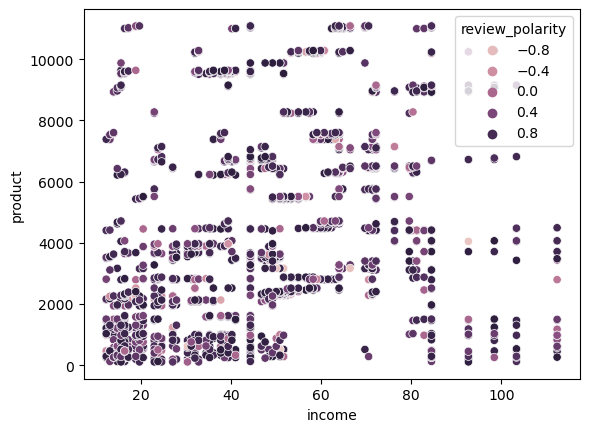

In [708]:
# Viualise the data again with sentiment and polarity. 
# income, product, review polarity
sns.scatterplot(data = DF3, x = 'income', y = 'product', hue='review_polarity')

<Axes: xlabel='income', ylabel='age'>

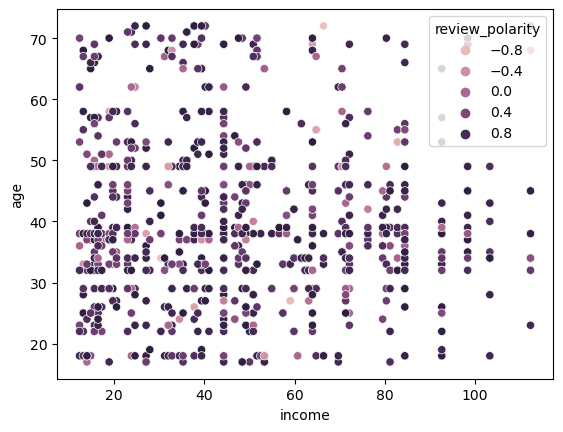

In [709]:
# Viualise the data again with sentiment and polarity. 
sns.scatterplot(data = DF3, x = 'income', y = 'age', hue='review_polarity')

<Axes: xlabel='product', ylabel='age'>

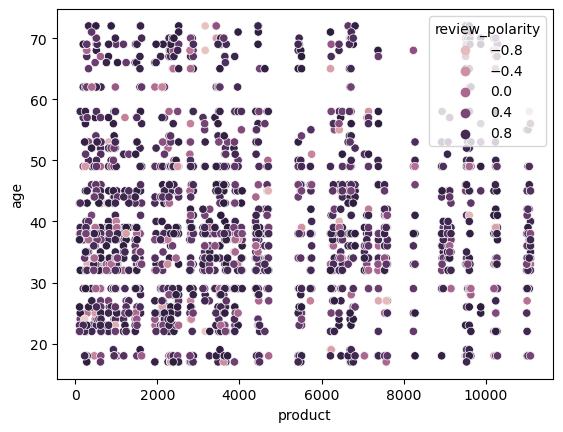

In [710]:
# Viualise the data again with sentiment and polarity. 
sns.scatterplot(data = DF3, x = 'product', y = 'age', hue='review_polarity')

##  reviews of products by gender

In [711]:
# Determine average polarity for each product. 

review_polarity_gender = DF3.groupby(['product', 'gender'])['review_polarity'].mean().reset_index()
review_polarity_gender.head()

,product,gender,review_polarity
0,107,Female,0.591322
1,107,Male,0.836000
2,123,Female,0.722460
3,123,Male,0.771960
4,195,Female,0.748283


In [712]:
review_polarity_gender.describe()

,product,review_polarity
count,399.000000,399.000000
mean,4302.022556,0.638758
std,3140.351567,0.189448
min,107.000000,-0.011367
25%,1586.500000,0.517639
50%,3619.000000,0.667750
75%,6646.000000,0.774625
max,11086.000000,0.989500


<Axes: xlabel='review_polarity', ylabel='product'>

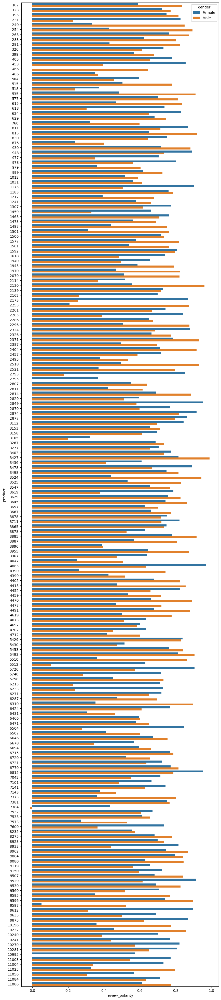

In [713]:
# Review polarity
plt.figure(figsize= (10,50))
sns.barplot(data = review_polarity_gender, x = 'review_polarity', y = 'product', hue='gender', orient = 'horizontal')

Useful and interesting but neds to be processed further eg sorted, filtered, etc. 

<Axes: xlabel='review_sentiment_score', ylabel='product'>

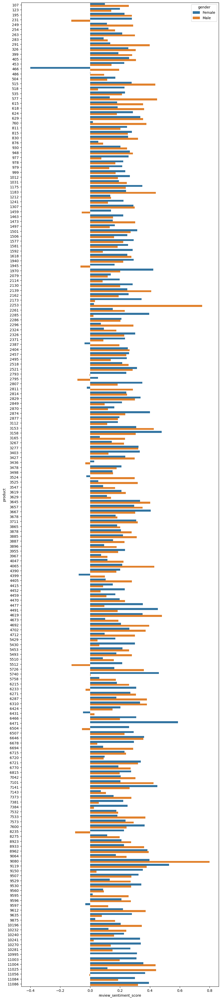

In [714]:
# Review sentiment
review_sentiment_gender = DF3.groupby(['product', 'gender'])['review_sentiment_score'].mean().reset_index()
plt.figure(figsize= (10,50))
sns.barplot(data = review_sentiment_gender, x = 'review_sentiment_score', y = 'product', hue='gender', orient = 'horizontal')

Overall for the reviews of products by gender, we see there is a huge difference in sentiment and polarity for males and females, with some products. It would be good to know a/ how many reviews contribute to each score (scaleable relevance to customer pop), and b/which the ones are with the biggest differenc between M and F

## Summary of products by gender. 

In [715]:
summary_polarity_gender = DF3.groupby(['product', 'gender'])['summary_polarity'].mean().reset_index()
summary_polarity_gender.head()

,product,gender,summary_polarity
0,107,Female,0.369689
1,107,Male,0.000000
2,123,Female,0.401540
3,123,Male,0.138160
4,195,Female,0.448667


In [716]:
summary_polarity_gender.describe()

,product,summary_polarity
count,399.000000,399.000000
mean,4302.022556,0.309683
std,3140.351567,0.164195
min,107.000000,-0.106825
25%,1586.500000,0.208729
50%,3619.000000,0.312600
75%,6646.000000,0.413358
max,11086.000000,0.812600


In [717]:
# How will I know how the summary and review data compare? Look at all four for some products? 

<Axes: xlabel='summary_polarity', ylabel='product'>

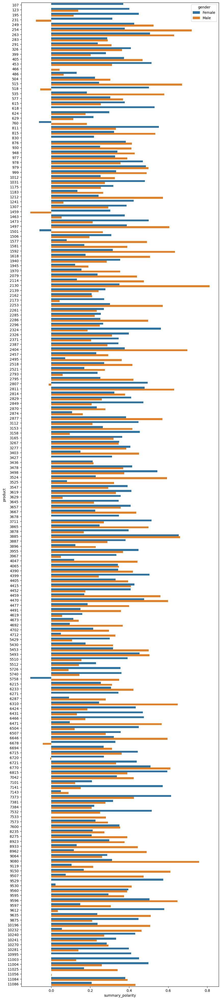

In [718]:
# TODO add white grid
# summary polarity 
plt.figure(figsize= (10,50))
sns.barplot(data = summary_polarity_gender, x = 'summary_polarity', y = 'product', hue='gender', orient = 'horizontal')

In [719]:
summary_sentiment_gender = DF3.groupby(['product', 'gender'])['summary_sentiment_score'].mean().reset_index()
summary_sentiment_gender.describe()

,product,summary_sentiment_score
count,399.000000,399.000000
mean,4302.022556,0.223236
std,3140.351567,0.173025
min,107.000000,-0.220000
25%,1586.500000,0.100911
50%,3619.000000,0.213889
75%,6646.000000,0.315556
max,11086.000000,1.000000


<Axes: xlabel='summary_sentiment_score', ylabel='product'>

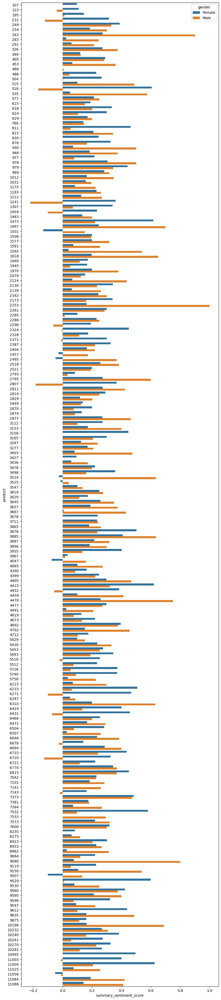

In [720]:
# summary sentiment 
plt.figure(figsize= (10,50))
sns.barplot(data = summary_sentiment_gender, x = 'summary_sentiment_score', y = 'product', hue='gender', orient = 'horizontal')

In [721]:
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was...",-0.6333,-0.0711,-0.036111,0.15
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,...",0.9404,-0.4404,0.035952,-0.80
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]",-0.0045,0.4019,0.116640,0.00
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]",0.8860,0.0000,0.578788,0.00
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]",-0.6808,-0.3182,-0.316667,0.00


In [722]:
# Filter the DF3 dataframe for select columns for a pairplot. 
print(DF3.columns.tolist())

['gender', 'age', 'income', 'score', 'points', 'education', 'product', 'review', 'summary', 'score_bracket', 'income_bracket', 'customer_id', 'review_tokens', 'summary_tokens', 'review_polarity', 'summary_polarity', 'review_sentiment_score', 'summary_sentiment_score']


In [748]:
DF3.head()

,gender,age,income,score,points,education,product,review,summary,score_bracket,income_bracket,customer_id,review_tokens,summary_tokens,review_polarity,summary_polarity,review_sentiment_score,summary_sentiment_score
0,Male,18,12.30,39,210,graduate,453,when it comes to a dms screen the space on the...,the fact that 50 of this space is wasted on ar...,0-40,0 -20,178,"[when, it, comes, to, a, dms, screen, the, spa...","[the, fact, that, 50, of, this, space, is, was...",-0.6333,-0.0711,-0.036111,0.15
1,Male,23,12.30,81,524,graduate,466,an open letter to galeforce9 your unpainted mi...,another worthless dungeon masters screen from ...,61-100,0 -20,178,"[an, open, letter, to, galeforce9, your, unpai...","[another, worthless, dungeon, masters, screen,...",0.9404,-0.4404,0.035952,-0.80
2,Female,22,13.12,6,40,graduate,254,nice art nice printing why two panels are fill...,pretty but also pretty useless,0-40,0 -20,2,"[nice, art, nice, printing, why, two, panels, ...","[pretty, but, also, pretty, useless]",-0.0045,0.4019,0.116640,0.00
3,Female,25,13.12,77,562,graduate,263,amazing buy bought it as a gift for our new dm...,five stars,61-100,0 -20,2,"[amazing, buy, bought, it, as, a, gift, for, o...","[five, stars]",0.8860,0.0000,0.578788,0.00
4,Female,33,13.94,40,366,graduate,291,as my review of gf9s previous screens these we...,money trap,0-40,0 -20,5,"[as, my, review, of, gf9s, previous, screens, ...","[money, trap]",-0.6808,-0.3182,-0.316667,0.00


Compare the clusters for age 

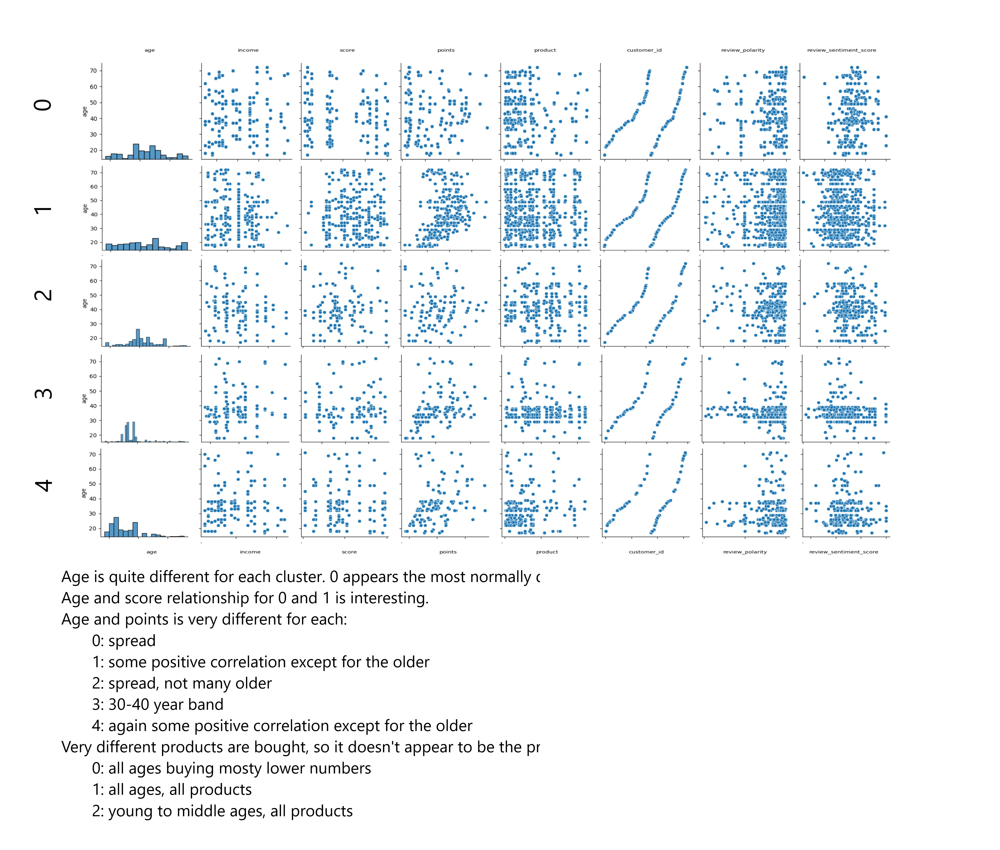

**Income**

Comparing the income pairplot rows of the dfs. 


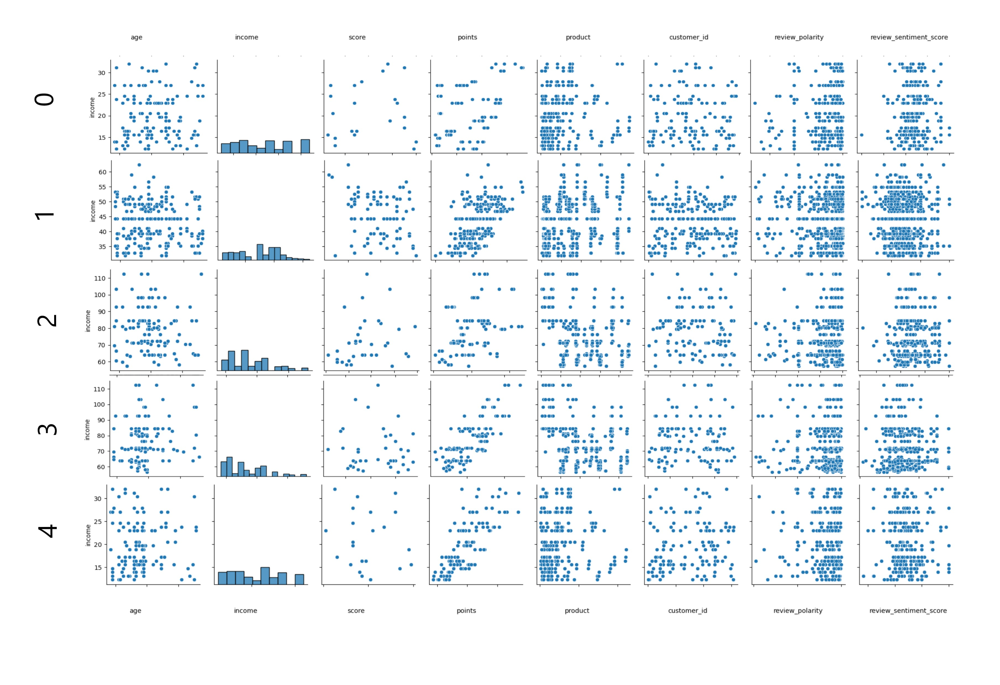

3 and 4, which are both high scoring, appear younger. 

Income tails more (right) for one, two and three. 

Positive correlation between points and income for all three, even cluster 1 (income effecting loyalty points not totally subdued by score). 

Polarity is generally positive except for 1. This may because they're an artifically constrained dataset. 

Lower scoring customers are generally happy with their purchases: is score an indication of willingness to try a new and or lower ranked product? Clusters 0 and 2 (which are the low score customers) are happier with their products than the rest, according to sentiment score of reviews. 

**Score** 
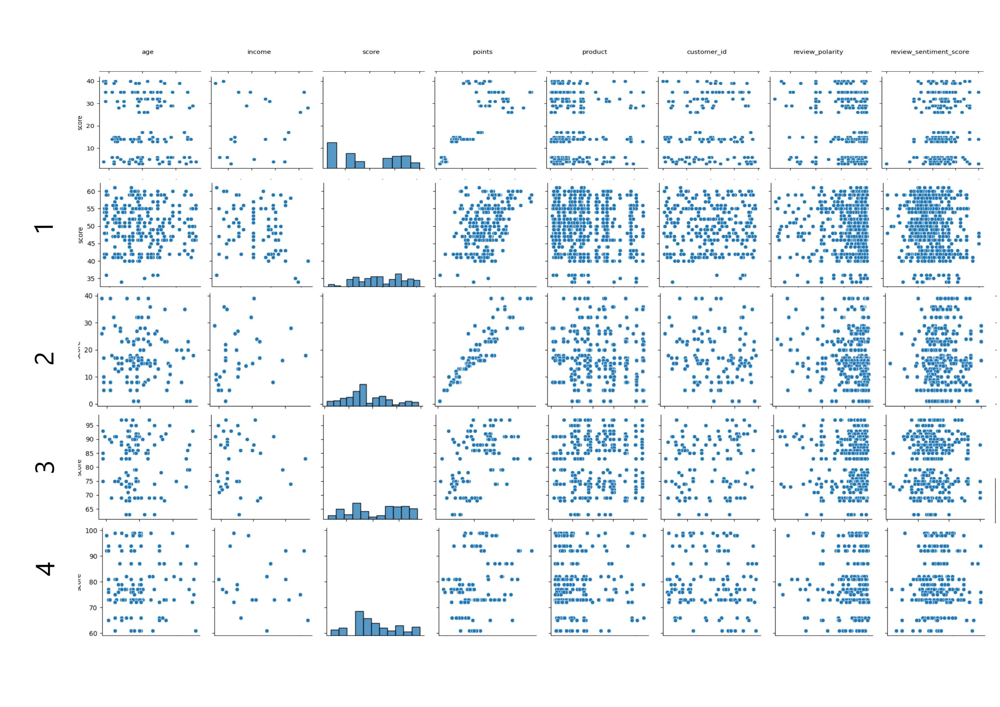

Score
- in 3 and 4, the younger customers have the higher scores.
- 0 and 4 seem to have the lower numbered products (so there may be no relationship between score and product number.The graph below suggests that indeed there is not. 
- Again most are pretty positive, but 1 has that neutral leaning. 

**Points**
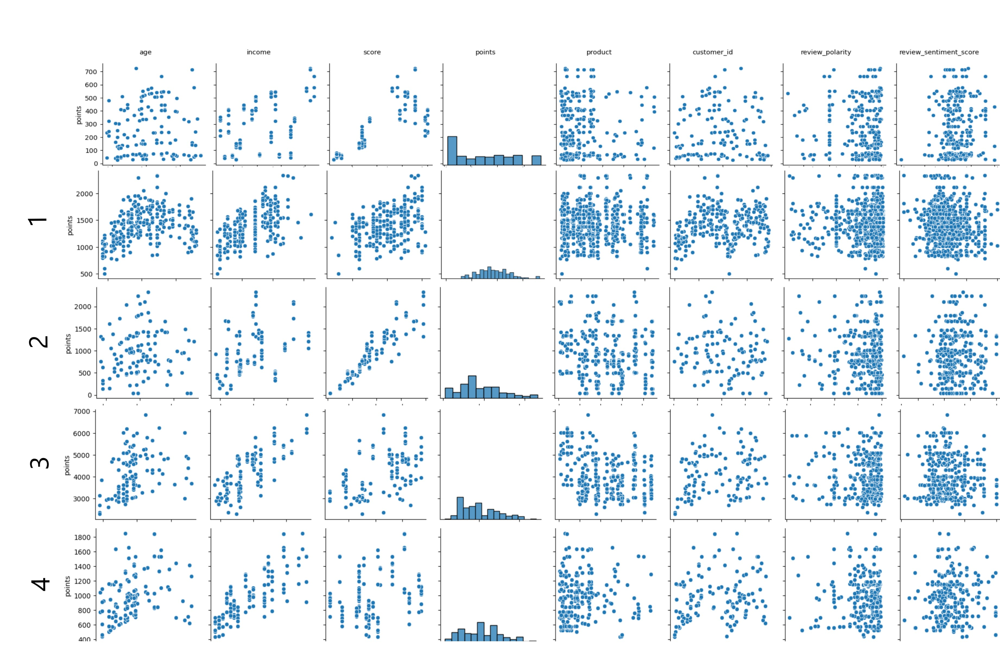
Age: 1, 3 and  4 (which are the three higher scoring clusters) have more of a correlation between points and age. 

Income: Clearest correlation with points are in clusters 3 and 4

Score: There appears to be a stronger correlation between score and points in the three lower scoring clusters. 

Points: seem most normally distributed in cluster one

Product: again, 0 and 4 are buying more lower number products 

**Product**

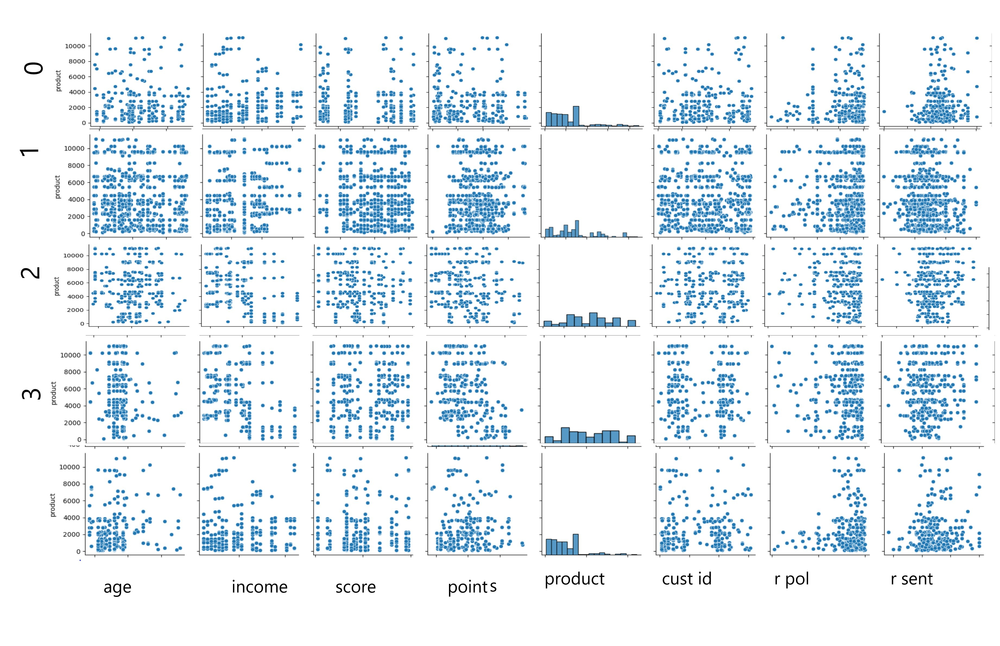


Clusters 3 and 4, which are high points scoring, have many younger reviewers, but whereas 4 buys lower numbered products, 3 seems to buy the full range. In fact 0 and 3, on opposite ends (but on the income spectrum) have products in common. 


# 